<a href="https://colab.research.google.com/github/chloecasserly/Electrifying-Tractors-for-Farming-and-Electricity-Grid-Integration/blob/main/tractoroptimisationvfinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
"""
Optimisation Code v6.1

CODE INSTRUCTIONS:
1. Enter Data into '01. User Input' Section and run the cell.
2. Upload Files following instructions in '02. File Upload' section
3. Run '03. Data Processing' Section, ensure it prints the correct data length value
   (8760) and shows excel output snip it correctly.
4. Run '04. Initialise/Reset Optimisation'
5. Run '05. Structured Optimisation'
6. Run '06. Solve Model', will output total cost and time to optimise
7. Run '01. User Input' again to ensure correct title output
8. Run '07. Print to Excel' to store data in excel
9. Run '08.1 Plot Setup' to setup graph length
10. Run '08.2 Plot Results' to plot all results
11. Run relevant 'V-XX' for testing
12. To change plot length, modify the
    section 'Modify to Change Length of Graph (Year/Day)'
13. To change Optimisation values, modify 'User Input' the run from step 3.

NOTE: If adding new files ensure their names do not end in (x), if they do,
go to 'Runtime' and press 'Disconnect and delete runtime'

"""



# 01. User Input

In [61]:
"""
User Data is to be entered in this cell.
--------------------------------------------------------------------------------
Scenario Name
  Enter the name that will be used to name the output files.

Scenario Inputs
  Enter (1 or 0) to turn (on or off) PV, BESS (Residential or Wholesale), CAPEX
  and FCAS.

Grid Capacity Inputs
  Enter in a postcode for the property along with the grid infrastructure
  connection (either single or three phase)

BESS and PV Sizing
  Enter the chosen size for BESS and PV based on the values available

System Values
  Enter number of tractors, current interest rate, lifetime of proposed system,
  efficicencies, CAPEX and OandM
--------------------------------------------------------------------------------
Calculations for Optimisation
  NOT for data input, DO NOT CHANGE VALUES

"""
# -------------------- TO BE MODIFIED FOR TESTING ------------------------------
# User Input for Optimisation --------------------------------------------------
# Scenario Name
name = "T14.1.3.1"

# Scenario inputs (0 or 1)
# Scenarios:
# A-PVO - PV Only
# A-BO - BESS Only
# A-PVB - PV and BESS
pv = 0
bess_R = 1
bess_W = 0
capex = 0
fcas = 0

# Grid Capacity Inputs
postcode = 2582 # Any Australian Postcode
phase = 1 # Can be either single (1) or three (3) phase (based on home connection)

# BESS and PV sizing
bess_size = 27 # Can be 27,54 or 108 kWh
pv_size = 30 # Can be 30,60 or 90 kW

# Electricity Options
# Choose from -
# ActewAGL = ActewAGL_Plan_1 (Home), ActewAGL_Plan_2 (Home ToU), ActewAGL_Plan_3 (Home Daytime Economy)
# Essential Energy = Essential_Energy_Plan_1 (Res ToU Opt In Demand), Essential_Energy_Plan_2 (Res ToU Sun Soaker)
ele_plan = "ActewAGL_Plan_1"

# Tractor Use Options
# Choose from A->D
# Slashing and Undervine Spraying can be done in 1 day or split over 2 days
# A = 1 day Slashing and Undervine Spraying
# B = 1 day Slashing and 2 days Undervine Spraying
# C = 2 days Slashing and 1 day Undervine Spraying
# D = 2 days Slashing and 2 days Undervine Spraying
tractor_use = "A"

# System Values
no_tractors = 1 # Number of Tractors
no_extra_tractor_batteries = 2 # Number of additional tractor batteries
# -------------------- TO BE MODIFIED FOR TESTING ------------------------------


interest_rate = 0.044 # Interest rate at time
lifetime = 30 # Lifetime of the total system
eff_in = 0.9 # Charge Efficiency of Residential and Wholesale BESS (default - 0.9)
eff_out = 0.9 # Discharge Efficiency of Residential and Wholesale BESS (default - 0.9)
eff_tractor = 0.9 # Tractor Battery Efficiency (default - 0.9)
CAPEX_tractor = 155711
OandM_tractor = 4384
CAPEX_tractor_battery = 25490
CAPEX_battery_swap_system_and_installation = 19375 + 2500
CAPEX_battery_charger = 2086.50
CAPEX_FCAS = 0
rev_share = 0.5 # FCAS Revenue Share %

# Calculations for Optimisation Input ------------------------------------------
# DO NOT CHANGE ----------------------------------------------------------------
# Capital Recover Factor Formula
CRF = (interest_rate * (1 + interest_rate)**lifetime) / ((1 + interest_rate)**lifetime - 1)

# 02. File Upload


In [3]:
from google.colab import files;
uploaded = files.upload()

"""
Upload the following files for the code to run:

Currently Used
 - 'Model RF Tractor Use.xlsx'
 - 'Model NEM Spot Price Full.xlsx'
 - 'Model TOU Cost ActewAGL 2025.xlsx'
 - 'Model TOU Cost Essential Energy 2025.xlsx'
 - 'Model PV Generation.xlsx'
 - 'Model Electricity Profile V1.xlsx'
 - 'Model FCAS Acceptance.xlsx'
 - 'Model Yearly FCAS Prices.xlsx'
 - 'Model Postcode Grid Limitations.xlsx'
 - 'Model Solar and BESS Capex + O&M.xlsx'


Link to all model files
https://anu365.sharepoint.com/:f:/r/sites/2025ENGN4300CapstoneProjectRepository/Project%20Documents/06.%20Deliverables%20and%20Models/Models%20and%20Data/FINAL%20DATA%20FOR%20IMPLEMENTATION?csf=1&web=1&e=79O5do
"""

Saving Model Yearly FCAS Prices kW.xlsx to Model Yearly FCAS Prices kW.xlsx
Saving Model TOU Cost Essential Energy 2025.xlsx to Model TOU Cost Essential Energy 2025.xlsx
Saving Model TOU Cost ActewAGL 2025.xlsx to Model TOU Cost ActewAGL 2025.xlsx
Saving Model Solar and BESS Capex + O&M.xlsx to Model Solar and BESS Capex + O&M.xlsx
Saving Model RF Tractor Use.xlsx to Model RF Tractor Use.xlsx
Saving Model PV Generation.xlsx to Model PV Generation.xlsx
Saving Model Postcode Grid Limitations.xlsx to Model Postcode Grid Limitations.xlsx
Saving Model NEM Spot Price Full.xlsx to Model NEM Spot Price Full.xlsx
Saving Model FCAS Acceptance.xlsx to Model FCAS Acceptance.xlsx
Saving Model Electricity Profile V1.xlsx to Model Electricity Profile V1.xlsx


"\nUpload the following files for the code to run:\n\nCurrently Used\n - 'Model RF Tractor Use.xlsx'\n - 'Model NEM Spot Price Full.xlsx'\n - 'Model TOU Cost ActewAGL 2025.xlsx'\n - 'Model TOU Cost Essential Energy 2025.xlsx'\n - 'Model PV Generation.xlsx'\n - 'Model Electricity Profile V1.xlsx'\n - 'Model FCAS Acceptance.xlsx'\n - 'Model Yearly FCAS Prices.xlsx'\n - 'Model Postcode Grid Limitations.xlsx'\n - 'Model Solar and BESS Capex + O&M.xlsx'\n\n\nLink to all model files\nhttps://anu365.sharepoint.com/:f:/r/sites/2025ENGN4300CapstoneProjectRepository/Project%20Documents/06.%20Deliverables%20and%20Models/Models%20and%20Data/FINAL%20DATA%20FOR%20IMPLEMENTATION?csf=1&web=1&e=79O5do\n"

# 03. Data Processing

In [62]:
import pandas as pd
from pyomo.environ import *
!apt-get update --fix-missing
!apt-get install -y glpk-utils

# Data Import and Processing ---------------------------------------------------
# Tractor Use (Options A -> D)
if tractor_use == "A":
  excel_tractor_use = pd.read_excel("Model RF Tractor Use.xlsx", sheet_name =
                                      'Tractor Load A', usecols = 'I', header=1)
elif tractor_use == "B":
  excel_tractor_use = pd.read_excel("Model RF Tractor Use.xlsx", sheet_name =
                                      'Tractor Load B', usecols = 'I', header=1)
elif tractor_use == "C":
  excel_tractor_use = pd.read_excel("Model RF Tractor Use.xlsx", sheet_name =
                                      'Tractor Load C', usecols = 'I', header=1)
elif tractor_use == "D":
  excel_tractor_use = pd.read_excel("Model RF Tractor Use.xlsx", sheet_name =
                                      'Tractor Load D', usecols = 'I', header=1)
# Note: header=1 is used as document has two header rows

# Wholesale Electricity Prices (SPOT Prices from NEM)
excel_spot_price = pd.read_excel('Model NEM Spot Price Full.xlsx', usecols='I')

# Farm Electricity Profile
excel_ele_profile = pd.read_excel('Model Electricity Profile V1.xlsx', sheet_name='Total Profile' ,usecols='I')

# PV Generation
if pv_size == 30:
  excel_PV = pd.read_excel('Model PV Generation.xlsx', sheet_name = 'PV_Gen_30kW', usecols='I')
  PV_cap = 21
elif pv_size == 60:
  excel_PV = pd.read_excel('Model PV Generation.xlsx', sheet_name = 'PV_Gen_60kW', usecols='I')
  PV_cap = 45
elif pv_size == 90:
  excel_PV = pd.read_excel('Model PV Generation.xlsx', sheet_name = 'PV_Gen_90kW', usecols='I')
  PV_cap = 68

if bess_size == 27:
  bess_max = 30
elif bess_size == 54:
  bess_max = 60
elif bess_size == 108:
  bess_max = 120

# Residential Electricity Costs
if ele_plan == "ActewAGL_Plan_1":
  excel_ele_plan = pd.read_excel('Model TOU Cost ActewAGL 2025.xlsx', usecols='C')
elif ele_plan == "ActewAGL_Plan_2":
  excel_ele_plan = pd.read_excel('Model TOU Cost ActewAGL 2025.xlsx', usecols='D')
elif ele_plan == "ActewAGL_Plan_3":
  excel_ele_plan = pd.read_excel('Model TOU Cost ActewAGL 2025.xlsx', usecols='E')
elif ele_plan == "Essential_Energy_Plan_1":
  excel_ele_plan = pd.read_excel('Model TOU Cost Essential Energy 2025.xlsx', usecols='C')
elif ele_plan == "Essential_Energy_Plan_2":
  excel_ele_plan = pd.read_excel('Model TOU Cost Essential Energy 2025.xlsx', usecols='D')


# FCAS Acceptance
# Raise 1s
acc_raise_1s = pd.read_excel('Model FCAS Acceptance.xlsx', usecols='C')
# Raise 6s
acc_raise_6s = pd.read_excel('Model FCAS Acceptance.xlsx', usecols='D')
# Raise 60s
acc_raise_60s = pd.read_excel('Model FCAS Acceptance.xlsx', usecols='E')
# Raise 5m
acc_raise_5m = pd.read_excel('Model FCAS Acceptance.xlsx', usecols='F')
# Lower 1s
acc_lower_1s = pd.read_excel('Model FCAS Acceptance.xlsx', usecols='H')
# Lower 6s
acc_lower_6s = pd.read_excel('Model FCAS Acceptance.xlsx', usecols='I')
# Lower 60s
acc_lower_60s = pd.read_excel('Model FCAS Acceptance.xlsx', usecols='J')
# Lower 5m
acc_lower_5m = pd.read_excel('Model FCAS Acceptance.xlsx', usecols='K')

# FCAS Market Prices
# Raise 1s
price_raise_1s = pd.read_excel('Model Yearly FCAS Prices kW.xlsx', usecols='I')
# Raise 6s
price_raise_6s = pd.read_excel('Model Yearly FCAS Prices kW.xlsx', usecols='C')
# raise 60s
price_raise_60s = pd.read_excel('Model Yearly FCAS Prices kW.xlsx', usecols='D')
# Raise 5m
price_raise_5m = pd.read_excel('Model Yearly FCAS Prices kW.xlsx', usecols='E')
# Lower 1s
price_lower_1s = pd.read_excel('Model Yearly FCAS Prices kW.xlsx', usecols='J')
# Lower 6s
price_lower_6s = pd.read_excel('Model Yearly FCAS Prices kW.xlsx', usecols='F')
# Lower 60s
price_lower_60s = pd.read_excel('Model Yearly FCAS Prices kW.xlsx', usecols='G')
# Lower 5m
price_lower_5m = pd.read_excel('Model Yearly FCAS Prices kW.xlsx', usecols='H')

# Create index of no. data points (Each hour of a year = 8760)
data_length = list(range(len(excel_tractor_use)))

# BESS and PV sizing
size = pd.read_excel('Model Solar and BESS Capex + O&M.xlsx', sheet_name='Approximations', usecols='A', skiprows=10).squeeze("columns")
capex_bess = pd.read_excel('Model Solar and BESS Capex + O&M.xlsx', sheet_name='Approximations', usecols='B', skiprows=10).squeeze("columns")
oandm_bess = pd.read_excel('Model Solar and BESS Capex + O&M.xlsx', sheet_name='Approximations', usecols='D', skiprows=10).squeeze("columns")
capex_pv = pd.read_excel('Model Solar and BESS Capex + O&M.xlsx', sheet_name='Approximations', usecols='F', skiprows=10).squeeze("columns")
oandm_pv = pd.read_excel('Model Solar and BESS Capex + O&M.xlsx', sheet_name='Approximations', usecols='H', skiprows=10).squeeze("columns")

if pv == 0: # OandM and Capex for PV is 0 when flag not indicated
    OandM_PV = 0
    CAPEX_PV = 0
else:
    match_id_pv = size[size == pv_size].index

    if not match_id_pv.empty: # Find sizes associated OandM and CAPEX
        id_pv = match_id_pv[0]
        OandM_PV = oandm_pv.iloc[id_pv]
        CAPEX_PV = capex_pv.iloc[id_pv]
    else:
      OandM_PV = 0
      CAPEX_PV = 0

if bess_W == 0 or bess_R == 0: # OandM and Capex for BESS is 0 when flag not indicated
    OandM_BESS = 0
    CAPEX_BESS = 0
else:
    match_id_bess = size[size == bess_size].index

    if not match_id_bess.empty: # Find sizes associated OandM and CAPEX
        id_bess = match_id_bess[0]
        OandM_BESS = oandm_bess.iloc[id_bess]
        CAPEX_BESS = capex_bess.iloc[id_bess]
    else:
      OandM_BESS = 0
      CAPEX_BESS = 0

if no_extra_tractor_batteries == 0:
    CAPEX_tractor_battery = 0
    CAPEX_battery_swap_system_and_installation = 0
    CAPEX_battery_charger = 0

if capex == 0:
    CAPEX_tractor = 0
    CAPEX_PV = 0
    CAPEX_BESS = 0
    CAPEX_tractor_battery = 0
    CAPEX_battery_swap_system_and_installation = 0

# Grid Capacity Choosing based on Postcode and Phase input
postcode_ref = pd.read_excel('Model Postcode Grid Limitations.xlsx', sheet_name='Postcode Grid Limitations', usecols='A').squeeze("columns")
grid_cap_imp_1p =  pd.read_excel('Model Postcode Grid Limitations.xlsx', sheet_name='Postcode Grid Limitations', usecols='D').squeeze("columns")
grid_cap_exp_1p =  pd.read_excel('Model Postcode Grid Limitations.xlsx', sheet_name='Postcode Grid Limitations', usecols='E').squeeze("columns")
grid_cap_imp_3p =  pd.read_excel('Model Postcode Grid Limitations.xlsx', sheet_name='Postcode Grid Limitations', usecols='F').squeeze("columns")
grid_cap_exp_3p =  pd.read_excel('Model Postcode Grid Limitations.xlsx', sheet_name='Postcode Grid Limitations', usecols='G').squeeze("columns")

match_id_postcode = postcode_ref[postcode_ref == postcode].index
if phase == 1:
    if not match_id_postcode.empty:
        id_postcode = match_id_postcode[0]
        grid_cap_imp = grid_cap_imp_1p.iloc[id_postcode]
        grid_cap_exp = grid_cap_exp_1p.iloc[id_postcode]
    else:
        grid_cap_imp = 0
        grid_cap_exp = 0
if phase == 3:
    if not match_id_postcode.empty:
        id_postcode = match_id_postcode[0]
        grid_cap_imp = grid_cap_imp_3p.iloc[id_postcode]
        grid_cap_exp = grid_cap_exp_3p.iloc[id_postcode]
    else:
        grid_cap_imp = 0
        grid_cap_exp = 0


# CODE CHECKS
print(len(data_length))
print(excel_tractor_use.head())
print(CAPEX_BESS, CAPEX_PV, CAPEX_tractor)
print(OandM_BESS, OandM_PV, OandM_tractor)



Hit:1 https://cli.github.com/packages stable InRelease
Hit:2 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:4 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:5 http://security.ubuntu.com/ubuntu jammy-security InRelease
Hit:6 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:7 http://archive.ubuntu.com/ubuntu jammy InRelease
Hit:8 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Hit:9 http://archive.ubuntu.com/ubuntu jammy-updates InRelease
Hit:10 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Hit:11 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Reading package lists... Done
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
Reading packag

# 04. Initialise/Reset Optimisation

In [63]:
"""
Structured Optimisation following 'Updated_Optimisation_5.4'
"""
# Optimisation Set Up ------------------------------------------------------

# Create Pyomo model "modelv1"
modelv1 = ConcreteModel()
# Make index for days
modelv1.T = Set(initialize=data_length)

# Make index for SOC Constraints that use [t-1] and [t+1]
T_SOC_indices = data_length[:-1]  # all t where t+1 is valid
modelv1.T_SOC = Set(initialize=T_SOC_indices)

# Set Range for number of tractors
modelv1.N = RangeSet(no_tractors)

# 05. Structured Optimisation

In [64]:
"""
Structured Optimisation following 'Mathematical Formulation V7.3'
"""
from pyomo.environ import inequality
from pyomo.environ import *

# Fixed Variables --------------------------------------------------------------

# 1.0 Variables and Parameters -------------------------------------------------

# 1.1 Decision Variables (Decided by optimisation)
# Status: DONE
# Variables are non-negative and part of indexed set "modelv1.T"
modelv1.grid_imp_W = Var(modelv1.T, domain=NonNegativeReals)
modelv1.grid_exp_W = Var(modelv1.T, domain=NonNegativeReals)
modelv1.grid_imp_R = Var(modelv1.T, domain=NonNegativeReals)

modelv1.BESS_in_W = Var(modelv1.T, domain=NonNegativeReals)
modelv1.BESS_out_W = Var(modelv1.T, domain=NonNegativeReals)
modelv1.BESS_in_R = Var(modelv1.T, domain=NonNegativeReals)
modelv1.BESS_out_R = Var(modelv1.T, domain=NonNegativeReals)

modelv1.tractor_in = Var(modelv1.T, modelv1.N, domain=NonNegativeReals)
modelv1.tractor_out = Var(modelv1.T, modelv1.N, domain=NonNegativeReals)
modelv1.tractor_work = Var(modelv1.T, modelv1.N, domain=NonNegativeReals)
modelv1.z_work = Var(modelv1.T, modelv1.N, bounds=(0,1))

modelv1.PV_W = Var(modelv1.T, domain=NonNegativeReals)
modelv1.PV_R = Var(modelv1.T, domain=NonNegativeReals)
modelv1.extra_battery_in_PV = Var(modelv1.T, domain=NonNegativeReals)
modelv1.tractor_in_PV = Var(modelv1.T, modelv1.N, domain=NonNegativeReals)

modelv1.farm = Var(modelv1.T, domain=NonNegativeReals)

modelv1.SOC_BESS_W = Var(modelv1.T, domain=NonNegativeReals)
modelv1.SOC_BESS_R = Var(modelv1.T, domain=NonNegativeReals)
modelv1.SOC_tractor = Var(modelv1.T, modelv1.N, domain=NonNegativeReals)

modelv1.f_R1s = Var(modelv1.T, domain=NonNegativeReals)
modelv1.f_R6s = Var(modelv1.T, domain=NonNegativeReals)
modelv1.f_R60s = Var(modelv1.T, domain=NonNegativeReals)
modelv1.f_R5m = Var(modelv1.T, domain=NonNegativeReals)
modelv1.f_L1s = Var(modelv1.T, domain=NonNegativeReals)
modelv1.f_L6s = Var(modelv1.T, domain=NonNegativeReals)
modelv1.f_L60s = Var(modelv1.T, domain=NonNegativeReals)
modelv1.f_L5m = Var(modelv1.T, domain=NonNegativeReals)

modelv1.z_fcas = Var(modelv1.T, domain=Binary)

modelv1.grid_dir = Var(modelv1.T, bounds=(0,1))

modelv1.PV_curt = Var(modelv1.T, domain=NonNegativeReals)

modelv1.SOC_extra_battery = Var(modelv1.T, domain=NonNegativeReals)
modelv1.extra_battery_in  = Var(modelv1.T, domain=NonNegativeReals)
modelv1.extra_battery_out = Var(modelv1.T, domain=NonNegativeReals)
modelv1.swap_in = Var(modelv1.T, modelv1.N, domain=NonNegativeReals)
modelv1.z_swap = Var(modelv1.T, modelv1.N, domain=Binary)

# 1.2 Model Parameters and Inputs (Should be assigned a value immediately from imported models or elsewhere
# Status: DONE
modelv1.PV_cap = Param(initialize=PV_cap) # kW (KWp) (doc ref - Model PV Generation)

modelv1.BESS_cap_W = Param(initialize=bess_size) # kWh (doc ref - Research Battery BESS)
modelv1.BESS_cap_R = Param(initialize=bess_size) # kWh

modelv1.tractor_cap = Param(initialize=100) #kWh (doc ref - Research Tractor and Battery)
# modelv1.tractor_battery_size = Param(initialize=100) # Same as tractor
modelv1.extra_tractor_batteries = Param(initialize=no_extra_tractor_batteries) # Input no_extra_batteries

modelv1.BESS_max_W = Param(initialize=bess_max) # kWh (doc ref - Research Battery BESS)
modelv1.BESS_max_R = Param(initialize=bess_max) # kWh

modelv1.tractor_max_charge = Param(initialize=22) # kWh (doc ref - Research Battery BESS (Fendt tractor chosen))
modelv1.tractor_max_discharge = Param(initialize=22) # kWh (doc ref - Research Battery BESS (Fendt tractor chosen))

modelv1.grid_max_imp = Param(initialize=grid_cap_imp) # kW (doc ref - Model Postcode Grid Limitations)
modelv1.grid_max_exp = Param(initialize=grid_cap_exp)

modelv1.tractor_load = Param(modelv1.T, initialize=excel_tractor_use) # Tractor Usage Profile A (Can choose A-D)
modelv1.farm_load = Param(modelv1.T, initialize=excel_ele_profile) # Farm Load
modelv1.PV = Param(modelv1.T, initialize=excel_PV) # kWh

modelv1.price_W = Param(modelv1.T, initialize=excel_spot_price) # NEM SPOT Prices
modelv1.price_R = Param(modelv1.T, initialize=excel_ele_plan)

modelv1.price_R1s = Param(modelv1.T, initialize=price_raise_1s) # $ (doc ref - Model Yearly FCAS Prices)
modelv1.price_R6s = Param(modelv1.T, initialize=price_raise_6s)
modelv1.price_R60s = Param(modelv1.T, initialize=price_raise_60s)
modelv1.price_R5m = Param(modelv1.T, initialize=price_raise_5m)
modelv1.price_L1s = Param(modelv1.T, initialize=price_lower_1s)
modelv1.price_L6s = Param(modelv1.T, initialize=price_lower_6s)
modelv1.price_L60s = Param(modelv1.T, initialize=price_lower_60s)
modelv1.price_L5m = Param(modelv1.T, initialize=price_lower_5m)

modelv1.e_R1s = Param(modelv1.T, initialize=acc_raise_1s) # kW (doc ref - Model FCAS Acceptance)
modelv1.e_R6s = Param(modelv1.T, initialize=acc_raise_6s)
modelv1.e_R60s = Param(modelv1.T, initialize=acc_raise_60s)
modelv1.e_R5m = Param(modelv1.T, initialize=acc_raise_5m)
modelv1.e_L1s = Param(modelv1.T, initialize=acc_lower_1s)
modelv1.e_L6s = Param(modelv1.T, initialize=acc_lower_6s)
modelv1.e_L60s = Param(modelv1.T, initialize=acc_lower_60s)
modelv1.e_L5m = Param(modelv1.T, initialize=acc_lower_5m)

modelv1.VPP = Param(initialize=rev_share) # % Revenue Share

modelv1.CRF = Param(initialize=CRF) # The following are entered in 'User Input'
modelv1.CAPEX_tractor = Param(initialize=CAPEX_tractor)
modelv1.CAPEX_tractor_battery = Param(initialize=CAPEX_tractor_battery)
modelv1.CAPEX_battery_swap_system_and_installation = Param(initialize=CAPEX_battery_swap_system_and_installation)
modelv1.CAPEX_battery_charger = Param(initialize=CAPEX_battery_charger)
modelv1.CAPEX_PV = Param(initialize=CAPEX_PV)
modelv1.CAPEX_BESS = Param(initialize=CAPEX_BESS)
modelv1.CAPEX_FCAS = Param(initialize=CAPEX_FCAS)
modelv1.OandM_tractor = Param(initialize=OandM_tractor)
modelv1.OandM_PV = Param(initialize=OandM_PV)
modelv1.OandM_BESS = Param(initialize=OandM_BESS)
modelv1.eff_in = Param(initialize=eff_in)
modelv1.eff_out = Param(initialize=eff_out)
modelv1.eff_tractor = Param(initialize=eff_tractor)


# 1.3 Scenario Flags (Binary Values)
# Status: DONE
# Flags = 1 indicates using PV,BESS (W or R),CAPEX or FCAS
delta_PV = pv
delta_BESS_W = bess_W
delta_BESS_R = bess_R
delta_CAPEX = capex
delta_FCAS = fcas
if no_extra_tractor_batteries > 0:
  delta_extra_tractor_batteries = 1
else:
  delta_extra_tractor_batteries = 0

# Fixing Values for Scenarios
if delta_BESS_W == 0:
    modelv1.BESS_out_W.fix(0)
    modelv1.BESS_in_W.fix(0)
    modelv1.SOC_BESS_W.fix(0)
else:
    modelv1.BESS_in_W.unfix()
    modelv1.BESS_out_W.unfix()
    modelv1.SOC_BESS_W.unfix()

if delta_BESS_R == 0:
    modelv1.BESS_out_R.fix(0)
    modelv1.BESS_in_R.fix(0)
else:
    modelv1.BESS_in_R.unfix()
    modelv1.BESS_out_R.unfix()
    modelv1.SOC_BESS_R.unfix()

if delta_PV == 0:
    modelv1.PV_W.fix(0)
    modelv1.PV_R.fix(0)
    modelv1.extra_battery_in_PV.fix(0)
    modelv1.tractor_in_PV.fix(0)
    modelv1.PV_curt.fix(0)
else:
    modelv1.PV_W.unfix()
    modelv1.PV_R.unfix()
    modelv1.extra_battery_in_PV.unfix()
    modelv1.tractor_in_PV.unfix()
    modelv1.PV_curt.unfix()

if delta_FCAS == 0:
    modelv1.f_R1s.fix(0)
    modelv1.f_R6s.fix(0)
    modelv1.f_R60s.fix(0)
    modelv1.f_R5m.fix(0)
    modelv1.f_L1s.fix(0)
    modelv1.f_L6s.fix(0)
    modelv1.f_L60s.fix(0)
    modelv1.f_L5m.fix(0)
    modelv1.z_fcas.fix(0)
else:
    modelv1.f_R1s.unfix()
    modelv1.f_R6s.unfix()
    modelv1.f_R60s.unfix()
    modelv1.f_R5m.unfix()
    modelv1.f_L1s.unfix()
    modelv1.f_L6s.unfix()
    modelv1.f_L60s.unfix()
    modelv1.f_L5m.unfix()
    modelv1.z_fcas.unfix()

if delta_extra_tractor_batteries == 0:
    modelv1.SOC_extra_battery.fix(0)
    modelv1.extra_battery_in.fix(0)
    modelv1.extra_battery_out.fix(0)
    modelv1.extra_battery_in_PV.fix(0)
    modelv1.swap_in.fix(0)
    modelv1.z_swap.fix(0)
else:
    modelv1.SOC_extra_battery.unfix()
    modelv1.extra_battery_in.unfix()
    modelv1.extra_battery_out.unfix()
    modelv1.extra_battery_in_PV.unfix()
    modelv1.swap_in.unfix()
    modelv1.z_swap.unfix()


# 2.0 Objective Function -------------------------------------------------------
# Status: DONE
# Define Objective in function
def obj_rule(m):
    grid_cost = sum(modelv1.price_W[t] * (modelv1.grid_imp_W[t] -
                                          modelv1.grid_exp_W[t]) +
                    modelv1.price_R[t] * (modelv1.grid_imp_R[t]-modelv1.farm[t])
                    - delta_FCAS *((1 - modelv1.VPP)*((modelv1.e_R1s[t] * modelv1.price_R1s[t] *
                                      modelv1.f_R1s[t]) +
                    (modelv1.e_R6s[t] * modelv1.price_R6s[t] * modelv1.f_R6s[t]) +
                    (modelv1.e_R60s[t] * modelv1.price_R60s[t] * modelv1.f_R60s[t]) +
                    (modelv1.e_R5m[t] * modelv1.price_R5m[t] * modelv1.f_R5m[t]) +
                    (modelv1.e_L1s[t] * modelv1.price_L1s[t] * modelv1.f_L1s[t]) +
                    (modelv1.e_L6s[t] * modelv1.price_L6s[t] * modelv1.f_L6s[t]) +
                    (modelv1.e_L60s[t] * modelv1.price_L60s[t] * modelv1.f_L60s[t]) +
                    (modelv1.e_L5m[t] * modelv1.price_L5m[t] * modelv1.f_L5m[t])))
                    for t in m.T)
    return (grid_cost + delta_CAPEX *
            modelv1.CRF * (no_tractors * modelv1.CAPEX_tractor + modelv1.CAPEX_battery_swap_system_and_installation +
                           no_extra_tractor_batteries * (modelv1.CAPEX_tractor_battery + modelv1.CAPEX_battery_charger)
                           + modelv1.CAPEX_PV + modelv1.CAPEX_BESS + modelv1.CAPEX_FCAS)
            + (modelv1.OandM_PV)
            + (modelv1.OandM_BESS)
            + (no_tractors * modelv1.OandM_tractor))
# Set Model OBJECTIVE function
modelv1.obj = Objective(rule=obj_rule, sense=minimize)


# 3.0 Constraints --------------------------------------------------------------
# These should be based on 1.1 and 1.2

# 3.1 Energy Balance
# Status: DONE

def energy_balance(m, t):
    return ((
        modelv1.grid_imp_W[t] + modelv1.grid_imp_R[t]
        + delta_PV * (modelv1.PV[t] - modelv1.PV_curt[t])
        + delta_BESS_R * modelv1.BESS_out_R[t]
        + delta_BESS_W * modelv1.BESS_out_W[t]
        + modelv1.extra_battery_out[t]
        + sum(modelv1.tractor_out[t,n] for n in modelv1.N))
        ==
        (modelv1.farm[t]
        + delta_BESS_R * modelv1.BESS_in_R[t]
        + delta_BESS_W * modelv1.BESS_in_W[t]
        + modelv1.extra_battery_in[t]
        + modelv1.grid_exp_W[t]
        + sum(modelv1.tractor_in[t,n] for n in modelv1.N)
        + sum(modelv1.tractor_in_PV[t,n] for n in modelv1.N)
        + modelv1.extra_battery_in_PV[t])
    )
modelv1.energy_constraint = Constraint(modelv1.T, rule=energy_balance)

# 3.2 Wholesale System Dynamics
# Status: DONE
def power_imp_balance_W(m, t):
  if delta_BESS_W == 1:
    return modelv1.grid_imp_W[t] + modelv1.PV_W[t]  == modelv1.BESS_in_W[t]
  else:
    return Constraint.Skip
modelv1.power_exp_W_constraint = Constraint(modelv1.T, rule=power_imp_balance_W)

def power_exp_balance_W(m, t):
  if delta_BESS_W == 1:
    return modelv1.grid_exp_W[t] == modelv1.BESS_out_W[t]
  elif delta_PV == 1 and delta_BESS_W == 0:
    return modelv1.grid_exp_W[t] == modelv1.PV_W[t]
  else:
    return Constraint.Skip
modelv1.power_imp__W_constraint = Constraint(modelv1.T, rule=power_exp_balance_W)

def battery_soc_W(m, t):
  if delta_BESS_W == 1:
    return (modelv1.SOC_BESS_W[t+1] == modelv1.SOC_BESS_W[t] +
           (modelv1.eff_in * modelv1.BESS_in_W[t]) - ((1/modelv1.eff_out)*modelv1.BESS_out_W[t]))
  else:
    return Constraint.Skip
modelv1.battery_soc_W_constraint = Constraint(modelv1.T_SOC, rule=battery_soc_W)

def battery_cap_range_W(m, t):
  if delta_BESS_W == 1:
    return (modelv1.SOC_BESS_W[t] <= modelv1.BESS_cap_W)
  else:
    return Constraint.Skip
modelv1.battery_cap_range_W_constraint = Constraint(modelv1.T, rule=battery_cap_range_W)

# 3.3 Residential System Dynamics
# Status: DONE
def power_exp_balance_R(m, t):
    return (modelv1.farm[t] == modelv1.BESS_out_R[t] + modelv1.extra_battery_out[t]
            + sum(modelv1.tractor_out[t,n] for n in modelv1.N))
modelv1.power_exp_R_constraint = Constraint(modelv1.T, rule=power_exp_balance_R)

def power_imp_balance_R(m, t):
    return (modelv1.PV_R[t] + modelv1.grid_imp_R[t] == modelv1.BESS_in_R[t]
            + modelv1.extra_battery_in[t] + sum(modelv1.tractor_in[t,n] for n in modelv1.N))
modelv1.power_imp_R_constraint = Constraint(modelv1.T, rule=power_imp_balance_R)

def battery_soc_R(m, t):
  if delta_BESS_R == 1:
    return (modelv1.SOC_BESS_R[t+1] == modelv1.SOC_BESS_R[t] +
           (eff_in * modelv1.BESS_in_R[t]) - ((1/eff_out)*modelv1.BESS_out_R[t]))
  else:
    return Constraint.Skip
modelv1.battery_soc_R_constraint = Constraint(modelv1.T_SOC, rule=battery_soc_R)

def battery_cap_range_R(m, t):
  if delta_BESS_R == 1:
    return (modelv1.SOC_BESS_R[t] <= modelv1.BESS_cap_R)
  else:
    return Constraint.Skip
modelv1.battery_cap_range_R_constraint = Constraint(modelv1.T, rule=battery_cap_range_R)

# 3.4 Tractor Battery SOC Dynamics
# Status: DONE
def tractor_soc(m, t, n):
    return (modelv1.SOC_tractor[t+1, n] == modelv1.SOC_tractor[t, n] + (eff_in * modelv1.tractor_in_PV[t, n])
     + (eff_in * modelv1.tractor_in[t, n]) - ((1/eff_out)*modelv1.tractor_out[t,n])
     - (modelv1.tractor_work[t,n]) + modelv1.swap_in[t,n])
modelv1.tractor_soc_constraint = Constraint(modelv1.T_SOC, modelv1.N, rule=tractor_soc)

def tractor_cap_range(m, t, n):
    return (modelv1.SOC_tractor[t,n] <= modelv1.tractor_cap)
modelv1.tractor_cap_range_constraint = Constraint(modelv1.T, modelv1.N, rule=tractor_cap_range)

# 3.5 Power Limits
# Status: DONE
def PV_cap_limit(m, t):
    if pv == 1:
        return (modelv1.PV_W[t] + modelv1.PV_R[t] + modelv1.extra_battery_in_PV[t] +
                sum(modelv1.tractor_in_PV[t,n] for n in modelv1.N) <= PV_cap)
    else:
        return Constraint.Skip
modelv1.PV_cap_limit = Constraint(modelv1.T, rule=PV_cap_limit)

def PV_limit(m, t):
  if pv == 1:
    return (modelv1.PV_W[t] + modelv1.PV_R[t] + modelv1.extra_battery_in_PV[t] +
            sum(modelv1.tractor_in_PV[t,n] for n in modelv1.N) + modelv1.PV_curt[t] == modelv1.PV[t])
  else:
    return Constraint.Skip
modelv1.PV_limit = Constraint(modelv1.T, rule=PV_limit)

def charge_limit_W(m, t):
  if delta_BESS_W == 1:
    return inequality(-1 * modelv1.BESS_max_W, modelv1.BESS_in_W[t] -
                      modelv1.BESS_out_W[t], modelv1.BESS_max_W)
  else:
    return Constraint.Skip
modelv1.charge_limit_W_constraint = Constraint(modelv1.T, rule=charge_limit_W)

def charge_limit_R(m, t):
  if delta_BESS_R == 1:
    return inequality(-1 * modelv1.BESS_max_R, modelv1.BESS_in_R[t] -
                      modelv1.BESS_out_R[t], modelv1.BESS_max_R)
  else:
    return Constraint.Skip
modelv1.charge_limit_R_constraint = Constraint(modelv1.T, rule=charge_limit_R)

def charge_limit_tractor(m, t, n):
    return inequality(-1 * modelv1.tractor_max_discharge, modelv1.tractor_in[t,n] + modelv1.tractor_in_PV[t,n]
                      - modelv1.tractor_out[t,n], modelv1.tractor_max_charge)
modelv1.charge_limit_tractor_constraint = Constraint(modelv1.T, modelv1.N, rule=charge_limit_tractor)

def grid_limit_imp_tractor(m, t):
    return inequality(0, modelv1.grid_imp_W[t] +
                      modelv1.grid_imp_R[t], modelv1.grid_max_imp)
modelv1.grid_limit_imp_tractor_constraint = Constraint(modelv1.T, rule=grid_limit_imp_tractor)

def grid_limit_exp_tractor(m, t):
    return inequality(0, modelv1.grid_exp_W[t],
                      modelv1.grid_max_exp)
modelv1.grid_limit_exp_tractor_constraint = Constraint(modelv1.T, rule=grid_limit_exp_tractor)

# 3.6 Grid Import/Export Constraints
# Status: DONE
def grid_imp_limit_rule(m, t):
    return modelv1.grid_imp_W[t]+ modelv1.grid_imp_R[t] <= modelv1.grid_max_imp * modelv1.grid_dir[t]
modelv1.imp_limit_constraint = Constraint(modelv1.T, rule=grid_imp_limit_rule)

def grid_exp_limit_rule(m, t):
    return modelv1.grid_exp_W[t] <= modelv1.grid_max_exp * (1-modelv1.grid_dir[t])
modelv1.exp_limit_constraint = Constraint(modelv1.T, rule=grid_exp_limit_rule)

# 3.7 Tractor Usage/Load Constraint
# Status: DONE
def farm_load(m, t):
    return modelv1.farm[t] <= modelv1.farm_load[t]
modelv1.farm_load_constraint = Constraint(modelv1.T, rule=farm_load)

def tractor_load(m, t):
    return sum(modelv1.SOC_tractor[t, n] for n in modelv1.N) >= modelv1.tractor_load[t]
modelv1.tractor_load_constraint = Constraint(modelv1.T, rule=tractor_load)

def tractor_load_balance(m, t):
    return sum(modelv1.tractor_work[t, n] for n in modelv1.N) == modelv1.tractor_load[t]
modelv1.tractor_load_balance_constraint = Constraint(modelv1.T, rule=tractor_load_balance)

def work_only_if_active(m, t, n):
    return modelv1.tractor_work[t,n] == modelv1.tractor_load[t] * modelv1.z_work[t,n]
modelv1.work_only_if_active_constraint = Constraint(modelv1.T, modelv1.N, rule=work_only_if_active)

def no_charge_under_load(m, t, n):
    return modelv1.tractor_in[t,n] + modelv1.tractor_in_PV[t,n] <= modelv1.tractor_max_charge * (1 - modelv1.z_work[t,n])
modelv1.no_charge_under_load_constraint = Constraint(modelv1.T, modelv1.N, rule=no_charge_under_load)

def no_discharge_under_load(m, t, n):
    return modelv1.tractor_out[t,n] <= modelv1.tractor_max_discharge * (1 - modelv1.z_work[t,n])
modelv1.no_discharge_under_load_constraint = Constraint(modelv1.T, modelv1.N, rule=no_discharge_under_load)

# 3.8 FCAS Power Availability
# Status: DONE
def raise_power_availability(m, t):
    return (modelv1.BESS_out_W[t] + modelv1.f_R1s[t] + modelv1.f_R6s[t]
            + modelv1.f_R60s[t] + modelv1.f_R5m[t] <= modelv1.BESS_max_W)
modelv1.raise_availability_constraint = Constraint(modelv1.T, rule=raise_power_availability)

def lower_power_availability(m, t):
    return (modelv1.BESS_in_W[t] + modelv1.f_L1s[t] + modelv1.f_L6s[t]
            + modelv1.f_L60s[t] + modelv1.f_L5m[t] <= modelv1.BESS_max_W)
modelv1.lower_availability_constraint = Constraint(modelv1.T, rule=lower_power_availability)

# 3.9 FCAS SoC Availability Constraints
# Status: DONE
def raise_activation_logic(m, t):
  if delta_FCAS == 1:
    return modelv1.SOC_BESS_W[t] >= 0.2 * modelv1.BESS_cap_W * modelv1.z_fcas[t]
  else:
    return Constraint.Skip
modelv1.raise_activation_constraint = Constraint(modelv1.T, rule=raise_activation_logic)

def lower_activation_logic(m, t):
  if delta_FCAS == 1:
    return modelv1.SOC_BESS_W[t] <= 0.8 * modelv1.BESS_cap_W + 0.2* modelv1.BESS_cap_W * modelv1.z_fcas[t]
  else:
    return Constraint.Skip
modelv1.lower_activation_constraint = Constraint(modelv1.T, rule=lower_activation_logic)

def raise_disable_logic_R1s(m, t):
    return modelv1.f_R1s[t] <= modelv1.BESS_max_W * modelv1.z_fcas[t]
modelv1.raise_disable_R1s_constraint = Constraint(modelv1.T, rule=raise_disable_logic_R1s)

def raise_disable_logic_R6s(m, t):
    return modelv1.f_R6s[t] <= modelv1.BESS_max_W * modelv1.z_fcas[t]
modelv1.raise_disable_R6s_constraint = Constraint(modelv1.T, rule=raise_disable_logic_R6s)

def raise_disable_logic_R60s(m, t):
    return modelv1.f_R60s[t] <= modelv1.BESS_max_W * modelv1.z_fcas[t]
modelv1.raise_disable_R60s_constraint = Constraint(modelv1.T, rule=raise_disable_logic_R60s)

def raise_disable_logic_R5m(m, t):
    return modelv1.f_R5m[t] <= modelv1.BESS_max_W * modelv1.z_fcas[t]
modelv1.raise_disable_R5m_constraint = Constraint(modelv1.T, rule=raise_disable_logic_R5m)

def lower_disable_logic_L1s(m, t):
    return modelv1.f_L1s[t] <= modelv1.BESS_max_W * (1 - modelv1.z_fcas[t])
modelv1.lower_disable_L1s_constraint = Constraint(modelv1.T, rule=lower_disable_logic_L1s)

def lower_disable_logic_L6s(m, t):
    return modelv1.f_L6s[t] <= modelv1.BESS_max_W * (1 - modelv1.z_fcas[t])
modelv1.lower_disable_L6s_constraint = Constraint(modelv1.T, rule=lower_disable_logic_L6s)

def lower_disable_logic_L60s(m, t):
    return modelv1.f_L60s[t] <= modelv1.BESS_max_W * (1 - modelv1.z_fcas[t])
modelv1.lower_disable_L60s_constraint = Constraint(modelv1.T, rule=lower_disable_logic_L60s)

def lower_disable_logic_L5m(m, t):
    return modelv1.f_L5m[t] <= modelv1.BESS_max_W * (1 - modelv1.z_fcas[t])
modelv1.lower_disable_L5m_constraint = Constraint(modelv1.T, rule=lower_disable_logic_L5m)

# 3.10 FCAS Total Capacity Constraint
# Status: DONE
def raise_fcas_capacity(m, t):
    return (modelv1.f_R1s[t] + modelv1.f_R6s[t] + modelv1.f_R60s[t] + modelv1.f_R5m[t] +
            modelv1.f_L1s[t] + modelv1.f_L6s[t] + modelv1.f_L60s[t] + modelv1.f_L5m[t] <= modelv1.BESS_max_W)
modelv1.raise_fcas_capacity_constraint = Constraint(modelv1.T, rule=raise_fcas_capacity)

# 3.11 Extra Battery Constraints
def extra_battery_soc(m, t):
    return (modelv1.SOC_extra_battery[t+1] == modelv1.SOC_extra_battery[t] +
            modelv1.eff_in * modelv1.extra_battery_in[t] - (1/modelv1.eff_out) * modelv1.extra_battery_out[t] -
            sum(modelv1.swap_in[t,n] for n in modelv1.N) + (modelv1.eff_in * modelv1.extra_battery_in_PV[t]))
modelv1.extra_battery_soc_constraint = Constraint(modelv1.T_SOC, rule=extra_battery_soc)

def extra_battery_cap(m, t):
    return modelv1.SOC_extra_battery[t] <= modelv1.extra_tractor_batteries * modelv1.tractor_cap
modelv1.extra_battery_cap_constraint = Constraint(modelv1.T, rule=extra_battery_cap)

def charge_limit_extra_battery(m, t):
    return inequality(-1 * modelv1.tractor_max_discharge * no_extra_tractor_batteries, (modelv1.extra_battery_in[t] + modelv1.extra_battery_in_PV[t]) -
                      modelv1.extra_battery_out[t], modelv1.tractor_max_charge * no_extra_tractor_batteries)
modelv1.charge_limit_extra_battery_constraint = Constraint(modelv1.T, rule=charge_limit_extra_battery)

def swap_in_upper_limit(m, t, n):
    return modelv1.swap_in[t,n] <= modelv1.tractor_cap * modelv1.z_swap[t,n]
modelv1.swap_in_upper_limit_constraint = Constraint(modelv1.T, modelv1.N, rule=swap_in_upper_limit)

def swap_in_lower_limit(m, t, n):
    return modelv1.swap_in[t,n] >= 0.5 * modelv1.tractor_max_charge * modelv1.z_swap[t,n]
modelv1.swap_in_lower_limit_constraint = Constraint(modelv1.T, modelv1.N, rule=swap_in_lower_limit)

# 3.12 Battery continuity constraints

def bess_w_end_soc(m):
  if delta_BESS_W == 1:
    return modelv1.SOC_BESS_W[modelv1.T_SOC.last()] == modelv1.SOC_BESS_W[modelv1.T_SOC.first()]
  else:
    return Constraint.Skip
modelv1.bess_w_end_soc_constraint = Constraint(rule=bess_w_end_soc)

def bess_r_end_soc(m):
    if delta_BESS_R == 1:
        return modelv1.SOC_BESS_R[modelv1.T_SOC.last()] == modelv1.SOC_BESS_R[modelv1.T_SOC.first()]
    else:
        return Constraint.Skip
modelv1.bess_r_end_soc_constraint = Constraint(rule=bess_r_end_soc)

def tractor_end_soc(m, n):
    return modelv1.SOC_tractor[modelv1.T_SOC.last(), n] == modelv1.SOC_tractor[modelv1.T_SOC.first(), n]
modelv1.tractor_end_soc_constraint = Constraint(modelv1.N, rule=tractor_end_soc)

def extra_battery_end_soc(m):
    if delta_extra_tractor_batteries == 1:
        return modelv1.SOC_extra_battery[modelv1.T_SOC.last()] == modelv1.SOC_extra_battery[modelv1.T_SOC.first()]
    else:
        return Constraint.Skip
modelv1.extra_battery_end_soc_constraint = Constraint(rule=extra_battery_end_soc)


# 06. Solve Model

In [65]:
import time
t0 = time.time()
# Solve the model
solver = SolverFactory('highs')
results = solver.solve(modelv1, tee= True, options={
        "mip_rel_gap": 0.02,   # stop when within 2% of optimal
        "time_limit": 120,     # stop after 2 minutes
        "run_crossover": "off" # Helps stop solver from going over
    })

# Output total cost and first few values
print('Optimisation complete')
print("Total annual cost: $", round(value(modelv1.obj), 2))
t1 = time.time()
print("Total time to solve optimisation:",(t1-t0),'s')

Running HiGHS 1.11.0 (git hash: 364c83a): Copyright (c) 2025 HiGHS under MIT licence terms
MIP  has 306600 rows; 289080 cols; 569514 nonzeros; 17520 integer variables (8760 binary)
Coefficient ranges:
  Matrix [9e-01, 1e+02]
  Cost   [7e-06, 2e+01]
  Bound  [1e+00, 1e+00]
  RHS    [2e-01, 2e+02]
Presolving model
122513 rows, 146581 cols, 450337 nonzeros  0s
81539 rows, 112195 cols, 391737 nonzeros  1s
63038 rows, 100207 cols, 318070 nonzeros  1s
56487 rows, 93524 cols, 278280 nonzeros  2s

Solving MIP model with:
   56487 rows
   93524 cols (8759 binary, 0 integer, 0 implied int., 84765 continuous, 0 domain fixed)
   278280 nonzeros

Src: B => Branching; C => Central rounding; F => Feasibility pump; J => Feasibility jump;
     H => Heuristic; L => Sub-MIP; P => Empty MIP; R => Randomized rounding; Z => ZI Round;
     I => Shifting; S => Solve LP; T => Evaluate node; U => Unbounded; X => User solution;
     z => Trivial zero; l => Trivial lower; u => Trivial upper; p => Trivial point

 

# 07. Print to Excel

In [58]:
# Print out Solution to Excel
from pyomo.environ import value
import pandas as pd
import numpy as np

# Extract time steps (x-axis)
timesteps = list(modelv1.T)

# Start building your data dictionary with 'Time Step' always included
data = {
    'Time Step': timesteps
}

# Conditionally add columns matching plotting logic
if bess_R == 1:
    data.update({
        'SOC_BESS_R': [value(modelv1.SOC_BESS_R[t]) for t in timesteps],
        'BESS_in_R': [value(modelv1.BESS_in_R[t]) for t in timesteps],
        'BESS_out_R': [value(modelv1.BESS_out_R[t]) for t in timesteps],
    })

if bess_W == 1:
    data.update({
        'SOC_BESS_W': [value(modelv1.SOC_BESS_W[t]) for t in timesteps],
        'BESS_in_W': [value(modelv1.BESS_in_W[t]) for t in timesteps],
        'BESS_out_W': [value(modelv1.BESS_out_W[t]) for t in timesteps],
    })

# Grid flows are always included (no condition on your plotting)
data.update({
    'grid_imp_W': [value(modelv1.grid_imp_W[t]) for t in timesteps],
    'grid_exp_W': [value(modelv1.grid_exp_W[t]) for t in timesteps],
    'grid_imp_R': [value(modelv1.grid_imp_R[t]) for t in timesteps],
})

# Tractor flows always included as well
for n in modelv1.N:
    data[f'tractor_in_{n}'] = [value(modelv1.tractor_in[t, n]) for t in timesteps]
    data[f'tractor_out_{n}'] = [value(modelv1.tractor_out[t, n]) for t in timesteps]
    data[f'SOC_tractor_{n}'] = [value(modelv1.SOC_tractor[t, n]) for t in timesteps]

if pv == 1:
    data.update({
        'PV_W': [value(modelv1.PV_W[t]) for t in timesteps],
        'PV_R': [value(modelv1.PV_R[t]) for t in timesteps],
    })

# Farm data always included
data['farm'] = [value(modelv1.farm[t]) for t in timesteps]

# Create DataFrame with the filtered columns
df = pd.DataFrame(data)

# Build summary dataframe
summary = pd.DataFrame({
    "Metric": ["Total Cost", "Total Time (s)"],
    "Value": [round(value(modelv1.obj), 2), round(t1 - t0, 2)]
})

# Write both to Excel (two sheets)
output_path = f"{name}_results.xlsx"
with pd.ExcelWriter(output_path) as writer:
    df.to_excel(writer, sheet_name="TimeSeries", index=False)
    summary.to_excel(writer, sheet_name="Summary", index=False)

print(f"Results exported to {output_path}")

from google.colab import files
files.download(output_path)


Results exported to Scenario 3_results.xlsx


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# 08. Plot Setup

In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from pyomo.environ import value
from google.colab import files

# Define timesteps and dates
timesteps = list(modelv1.T)
start_date = '2025-01-01'
dates = pd.date_range(start=start_date, periods=len(timesteps), freq='h')

# Select months to plot
Year = [1,2,3,4,5,6,7,8,9,10,11,12,13]
Summer = [12,1,2]
Autumn = [3,4,5]
Winter = [6,7,8]
Spring = [9,10,11]
Growing_Season = [1,2,3,9,10,11,12,13]

#------------------ Modify to Change Length of Graph (Year/Day) ----------------
months_to_plot = Year # Use the above defined seasons here if plotting seasons

# Below in 'mask': Comment out '& (dates.day <= 5)' to plot for ALL days of month/year
# Use '& (dates.day <= 5)' for the 1st 5 days of the month/year
# Use '& (dates.day == 5)' for the 5th day of the month/year i.e. (5th April)
mask = dates.month.isin(months_to_plot) #& (dates.day <= 1)
# ------------------------------------------------------------------------------

filtered_dates = dates[mask]


# Use window = None for no Moving Average and window = 24 for Moving Average
def plot_series(dates, series_dict, title, ylabel='kWh', window=None):
    # --- Plot actual data ---
    plt.figure(figsize=(12,5))
    if len(pd.Series(dates).dt.normalize().unique()) == 1:
        x_vals = np.arange(1, len(dates)+1)
        x_label = "Hour of Day"
    else:
        x_vals = dates
        x_label = "Date"

    for label, data in series_dict.items():
        plt.plot(x_vals, data, label=label)
    plt.xlabel(x_label)
    plt.ylabel(ylabel)
    plt.title(f'{title} (Actual)')
    plt.legend()
    plt.grid(True)
    if x_label == "Date":
        plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b'))
    else:
        plt.xticks(np.arange(1, 25))  # show 1–24 ticks
    plt.tight_layout()
    plt.savefig(f"{title}_Actual.png", dpi=300)
    plt.show()
    files.download(f"{title}_Actual.png")

    # --- Plot moving average if requested ---
    if window is not None:
        plt.figure(figsize=(12,5))
        if len(pd.Series(dates).dt.normalize().unique()) == 1:
            x_vals = np.arange(1, len(dates)+1)
            x_label = "Hour of Day"
        else:
            x_vals = dates
            x_label = "Date"
        for label, data in series_dict.items():
            ma = pd.Series(data).rolling(window=window).mean()
            plt.plot(x_vals, ma, label=f'{label} MA')
        plt.xlabel(x_label)
        plt.ylabel(ylabel)
        plt.title(f'{title} (Moving Average, window={window})')
        plt.legend()
        plt.grid(True)
        if x_label == "Date":
            plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
            plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b'))
        else:
            plt.xticks(np.arange(1, 25))
        plt.tight_layout()
        plt.savefig(f"{title}_MA.png", dpi=300)
        plt.show()
        files.download(f"{title}_MA.png")

# 8.1 Plot Results

In [ ]:
# --- Residential Battery (BESS_W) ---
if bess_R == 1:
    soc_r_vals = np.array([value(modelv1.SOC_BESS_R[t]) for t in timesteps])[mask]
    bess_in_r_vals = np.array([value(modelv1.BESS_in_R[t]) for t in timesteps])[mask]
    bess_out_r_vals = np.array([value(modelv1.BESS_out_R[t]) for t in timesteps])[mask]

    plot_series(
        filtered_dates,
        {'SOC_BESS_R': soc_r_vals, 'BESS_in_R': bess_in_r_vals, 'BESS_out_R': bess_out_r_vals},
        f'{name} Residential Battery SOC and Energy Flows Over Time',
        window=24  # optional moving average
    )

In [ ]:
# --- Wholesale Battery (BESS_W) ---
if bess_W == 1:
    soc_w_vals = np.array([value(modelv1.SOC_BESS_W[t]) for t in timesteps])[mask]
    bess_in_w_vals = np.array([value(modelv1.BESS_in_W[t]) for t in timesteps])[mask]
    bess_out_w_vals = np.array([value(modelv1.BESS_out_W[t]) for t in timesteps])[mask]

    plot_series(
        filtered_dates,
        {'SOC_BESS_W': soc_w_vals, 'BESS_in_W': bess_in_w_vals, 'BESS_out_W': bess_out_w_vals},
        f'{name} Wholesale Battery SOC and Energy Flows Over Time',
        window=24  # optional moving average
    )

In [ ]:
# --- Grid In/Out Flows ---
grid_imp_W_vals = np.array([value(modelv1.grid_imp_W[t]) for t in timesteps])[mask]
grid_exp_W_vals = np.array([value(modelv1.grid_exp_W[t]) for t in timesteps])[mask]
grid_imp_R_vals = np.array([value(modelv1.grid_imp_R[t]) for t in timesteps])[mask]

plot_series(
    filtered_dates,
    {'grid_imp_W': grid_imp_W_vals, 'grid_exp_W': grid_exp_W_vals, 'grid_imp_R': grid_imp_R_vals},
    f'{name} Grid In and Out Flows (Residential and Wholesale)',
    window = 24
)

In [ ]:
# --- Tractor Batteries ---
tractor_series = {}
for n in modelv1.N:
    tractor_series[f'tractor_in_{n}'] = np.array([value(modelv1.tractor_in[t,n]) for t in timesteps])[mask]
    tractor_series[f'tractor_out_{n}'] = np.array([value(modelv1.tractor_out[t,n]) for t in timesteps])[mask]
    tractor_series[f'SOC_tractor_{n}'] = np.array([value(modelv1.SOC_tractor[t,n]) for t in timesteps])[mask]

plot_series(
    filtered_dates,
    tractor_series,
    f'{name} Tractor Battery SOC and Energy Flows Over Time',
    window=24
)

In [ ]:
# --- PV Energy Flows ---
if pv == 1:
    pv_W_vals = np.array([value(modelv1.PV_W[t]) for t in timesteps])[mask]
    pv_R_vals = np.array([value(modelv1.PV_R[t]) for t in timesteps])[mask]

    plot_series(
        filtered_dates,
        {'PV_W': pv_W_vals, 'PV_R': pv_R_vals},
        f'{name} PV Energy Flows Over Time',
        window=24
    )


In [ ]:
# --- Farm Energy ---
farm_vals = np.array([value(modelv1.farm[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'farm': farm_vals}, f'{name} Farm Energy Flows Over Time', window=24)

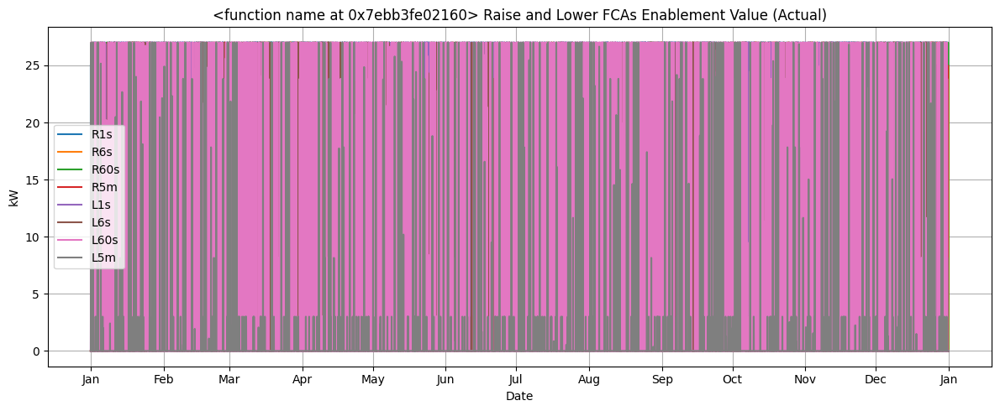

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

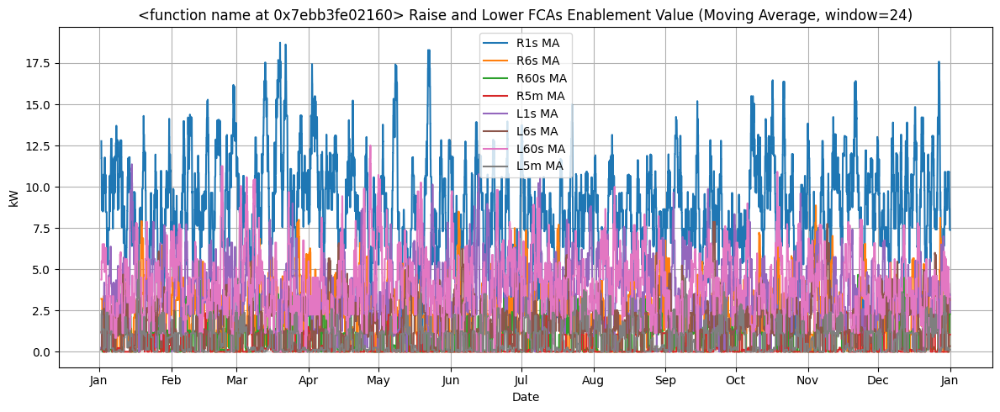

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

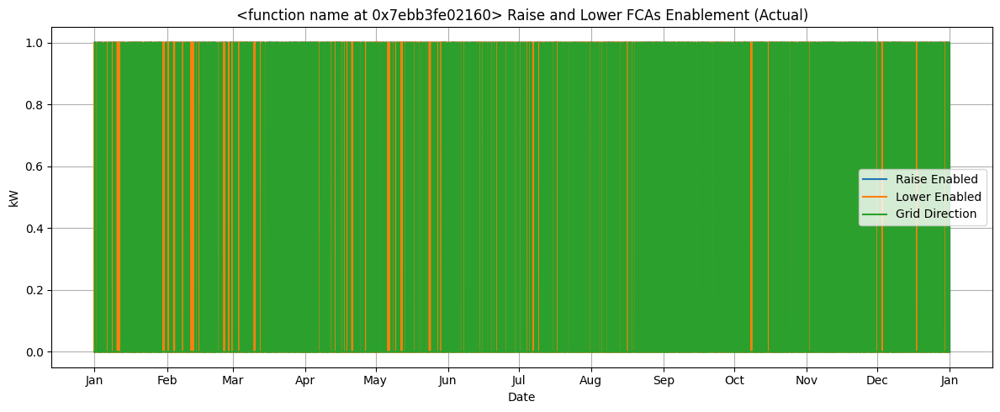

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

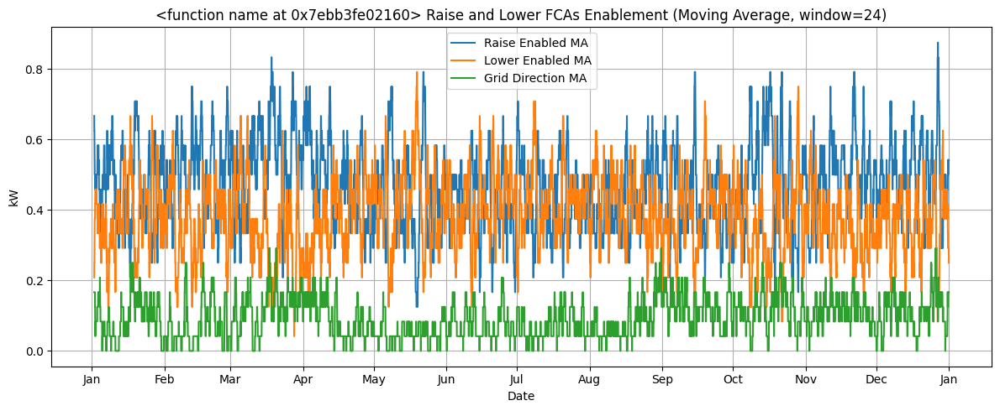

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# --- FCAS Enablement ---
if fcas == 1:
    fcas_series = {
        'R1s': np.array([value(modelv1.f_R1s[t]) for t in timesteps])[mask],
        'R6s': np.array([value(modelv1.f_R6s[t]) for t in timesteps])[mask],
        'R60s': np.array([value(modelv1.f_R60s[t]) for t in timesteps])[mask],
        'R5m': np.array([value(modelv1.f_R5m[t]) for t in timesteps])[mask],
        'L1s': np.array([value(modelv1.f_L1s[t]) for t in timesteps])[mask],
        'L6s': np.array([value(modelv1.f_L6s[t]) for t in timesteps])[mask],
        'L60s': np.array([value(modelv1.f_L60s[t]) for t in timesteps])[mask],
        'L5m': np.array([value(modelv1.f_L5m[t]) for t in timesteps])[mask]
    }
    plot_series(filtered_dates, fcas_series, f'{name} Raise and Lower FCAs Enablement Value', ylabel='kW', window=24)

    z_series = {
        'Raise Enabled': np.array([value(modelv1.z_fcas[t]) for t in timesteps])[mask],
        'Lower Enabled': np.array([value((1 - modelv1.z_fcas[t])) for t in timesteps])[mask],
        'Grid Direction': np.array([value(modelv1.grid_dir[t]) for t in timesteps])[mask]
    }
    plot_series(filtered_dates, z_series, f'{name} Raise and Lower FCAs Enablement', ylabel='kW',window=24)

# V-01

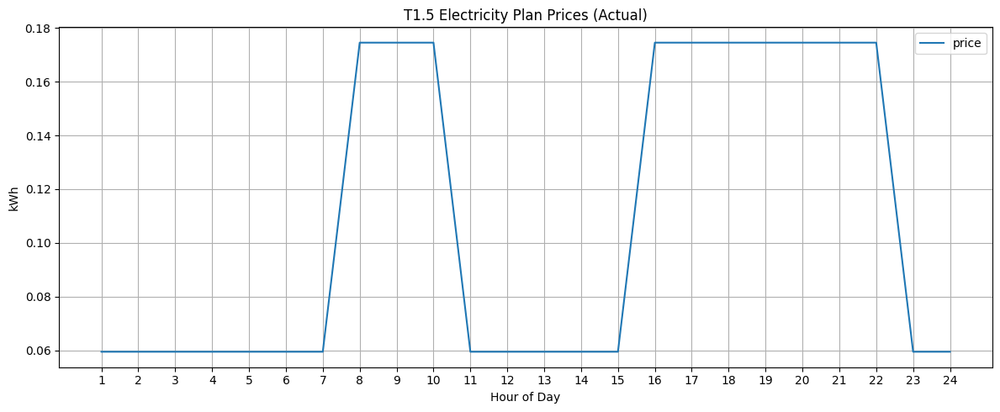

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

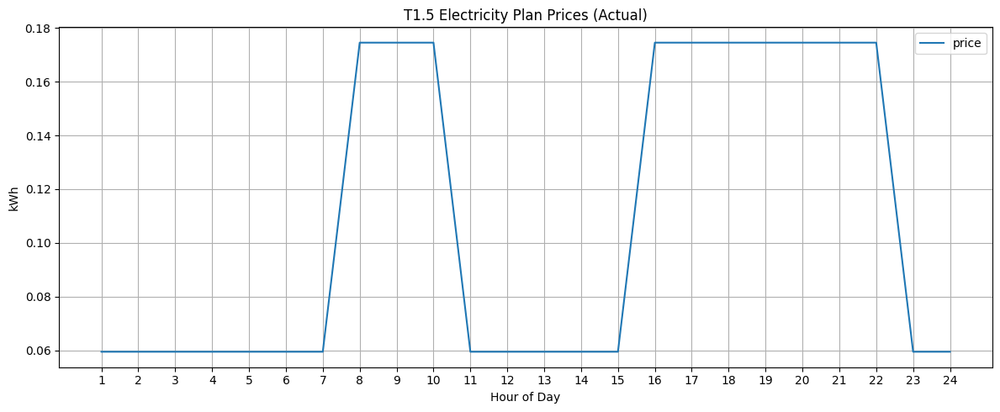

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

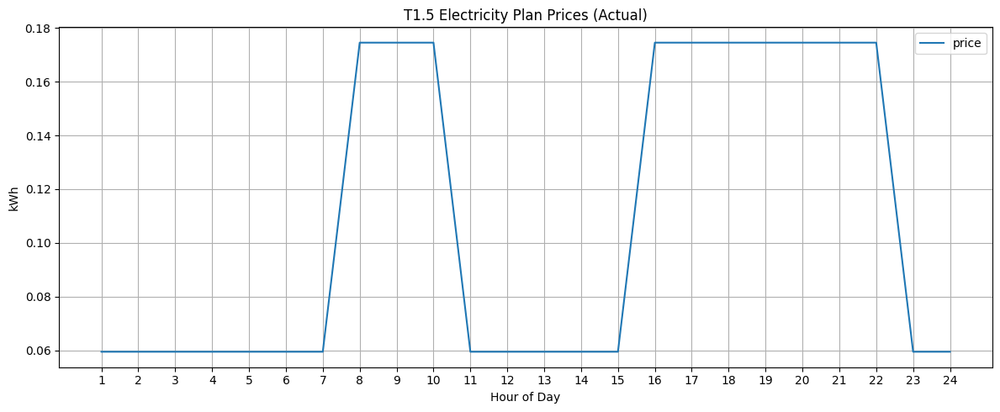

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

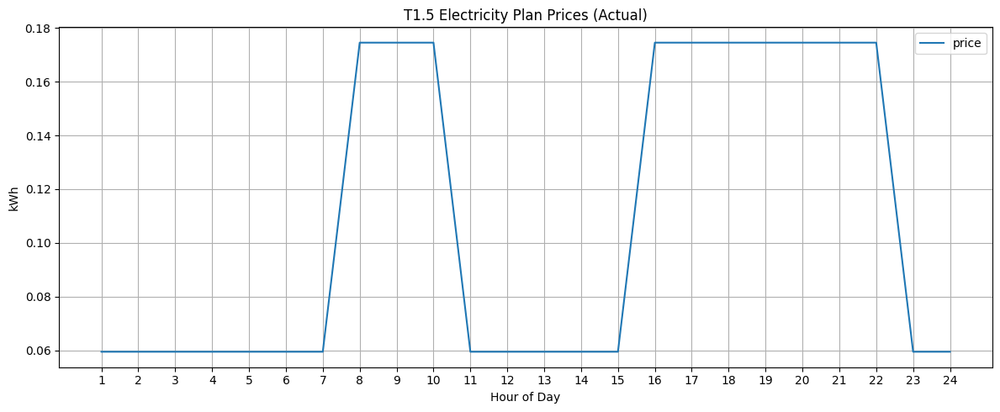

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

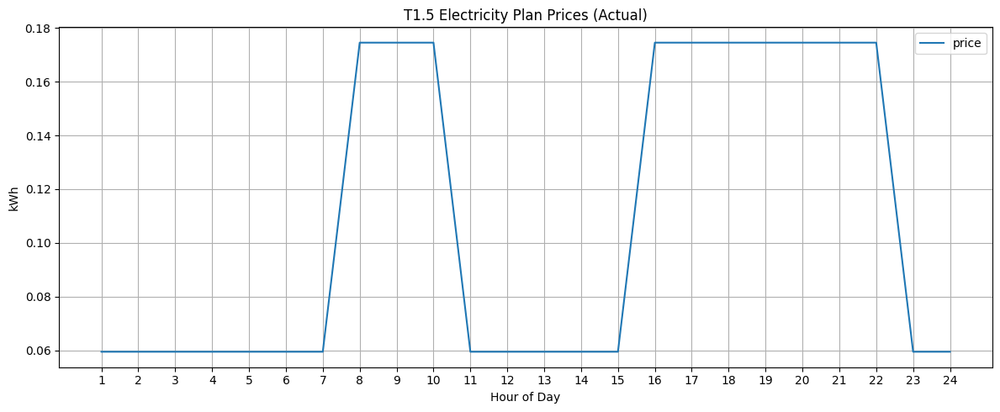

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

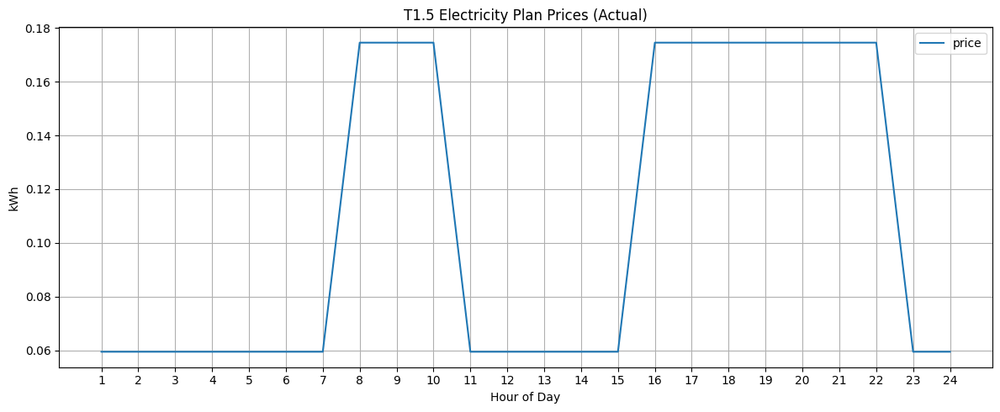

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

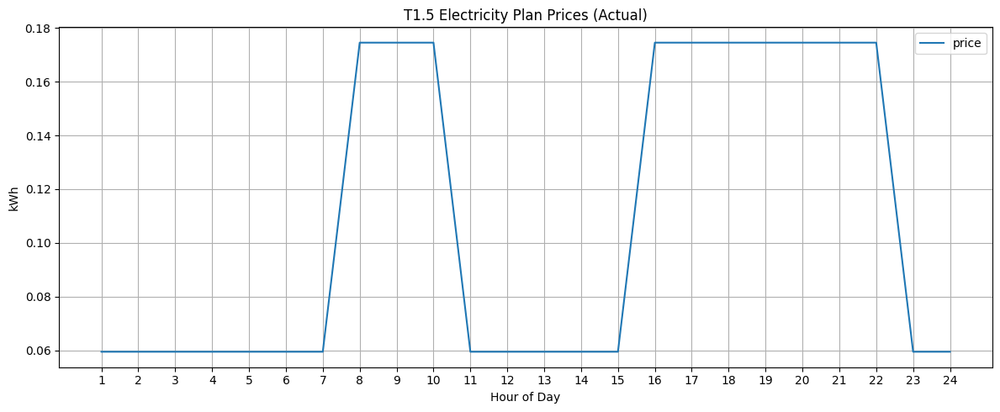

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

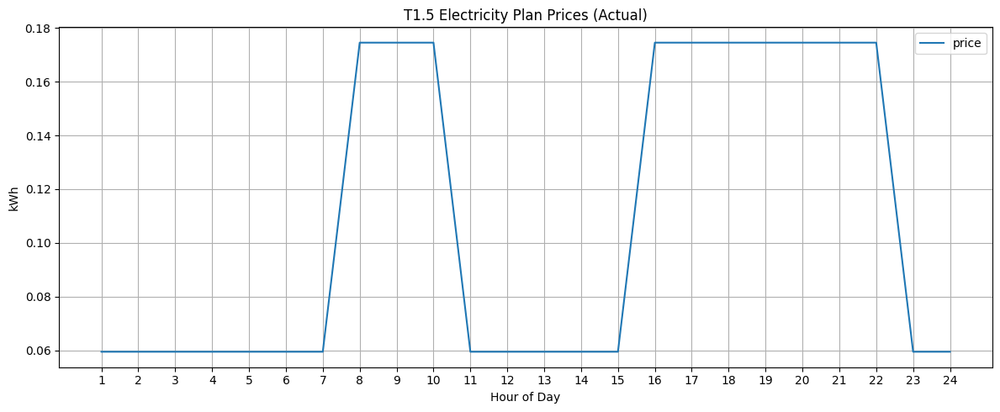

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

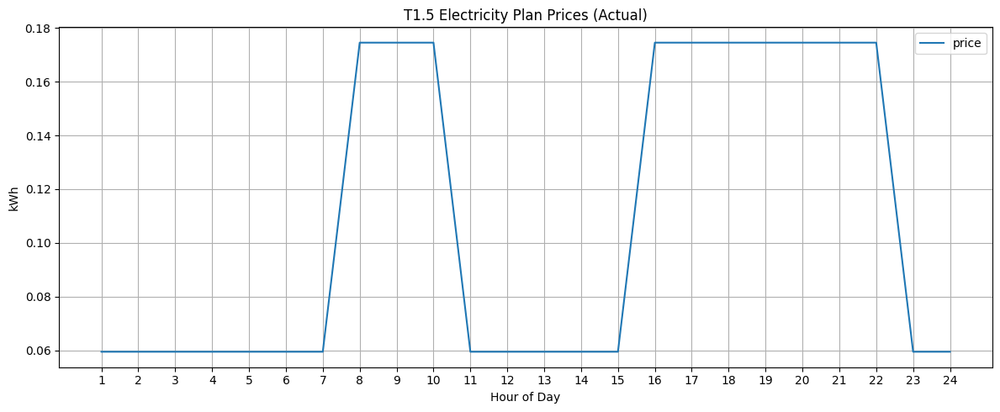

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

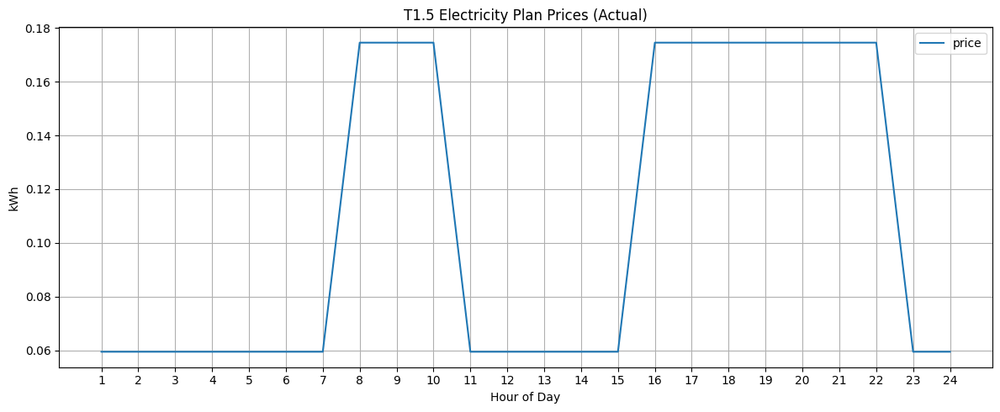

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

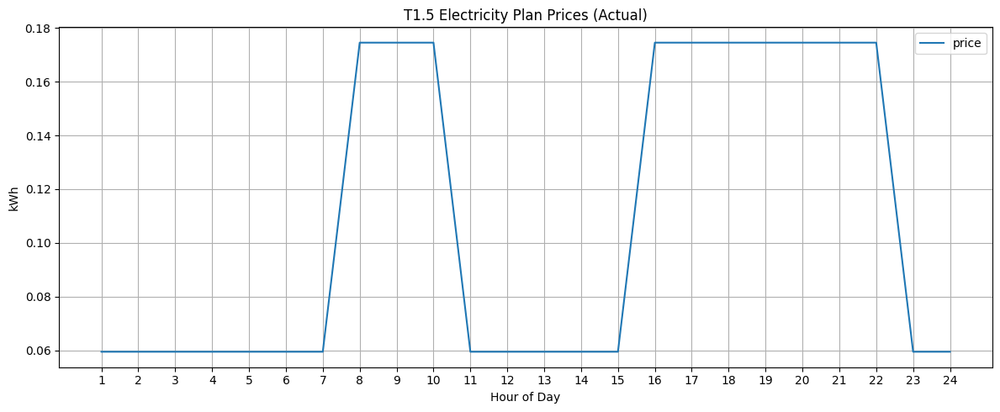

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

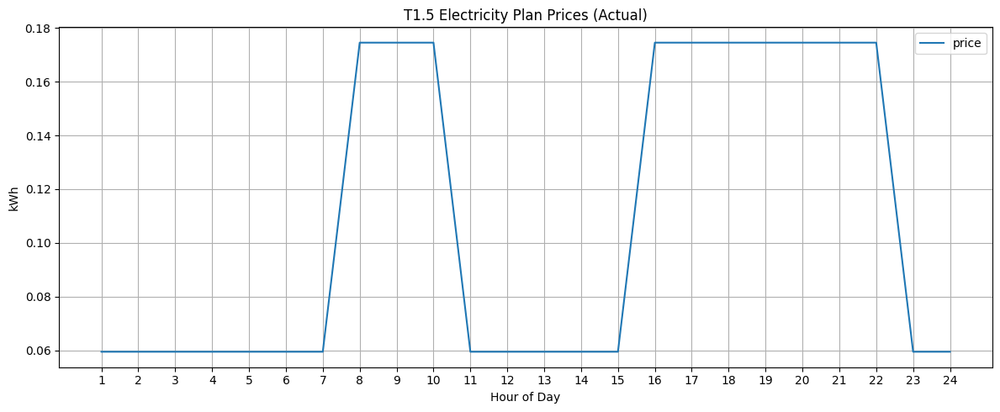

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [110]:
# Testing for V-01
for i in range(1, 13):
  months_to_plot = [i]
  mask = dates.month.isin(months_to_plot) & (dates.day <= 1)
  filtered_dates = dates[mask]

  ele_plan_vals = excel_ele_plan.iloc[:len(timesteps), 0].to_numpy()[mask]
  plot_series(filtered_dates, {'price': ele_plan_vals}, f'{name} Electricity Plan Prices', window=None)

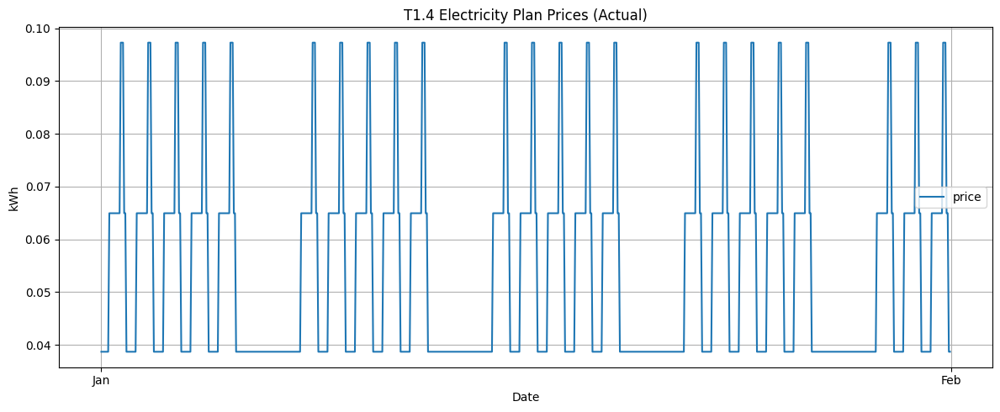

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

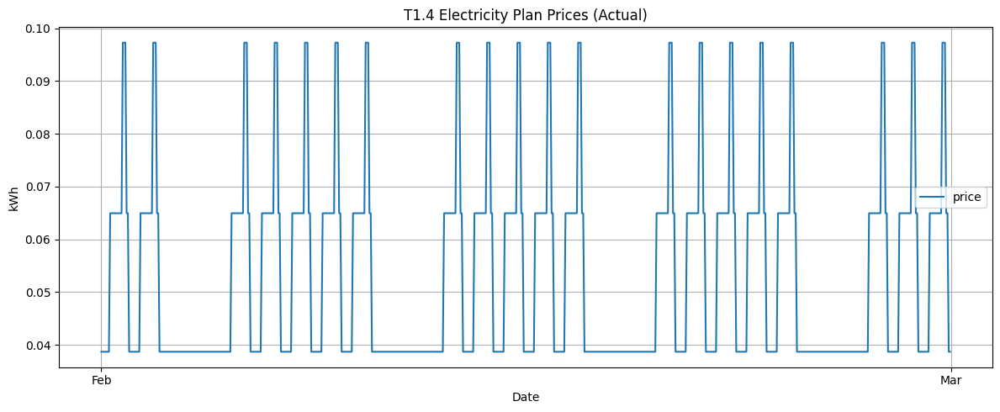

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

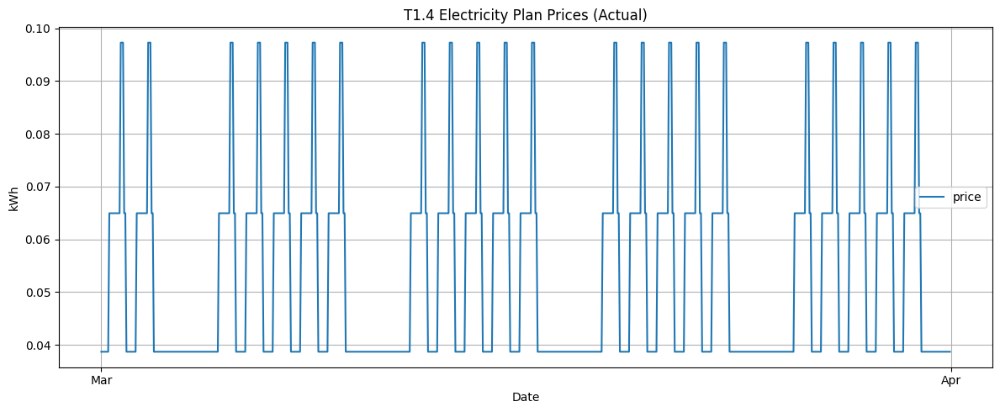

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

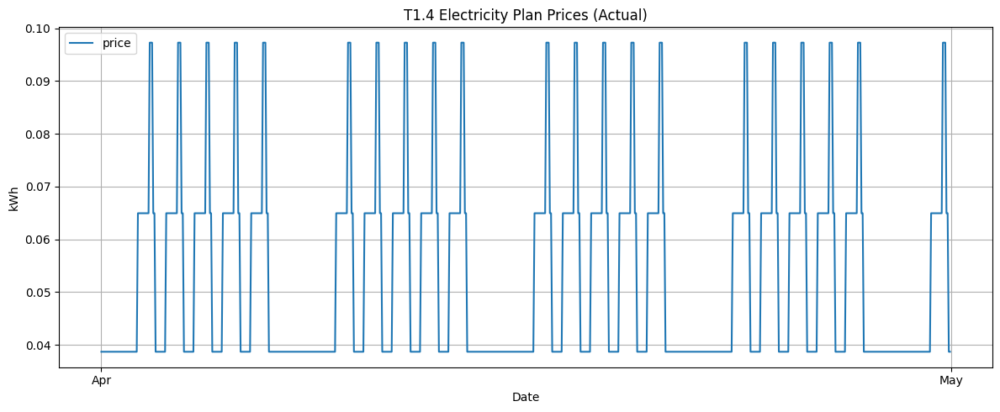

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

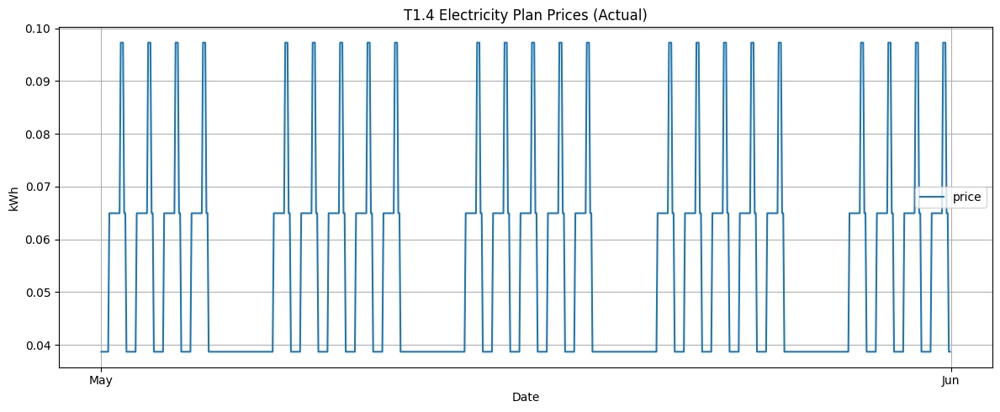

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

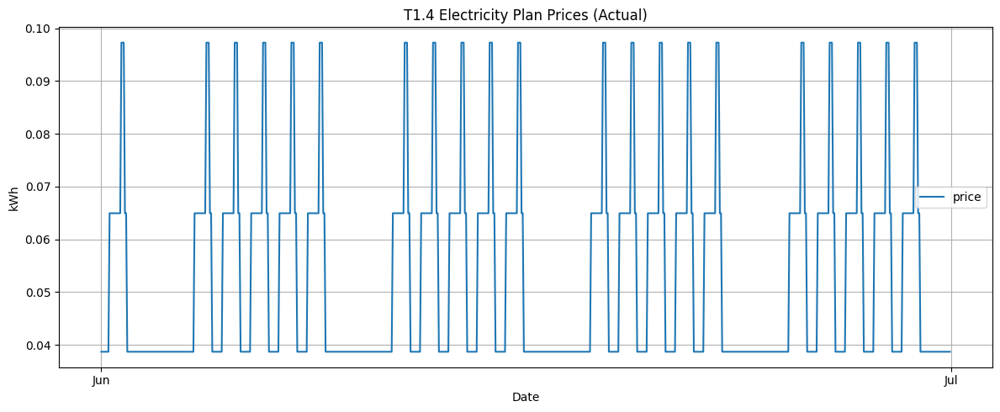

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

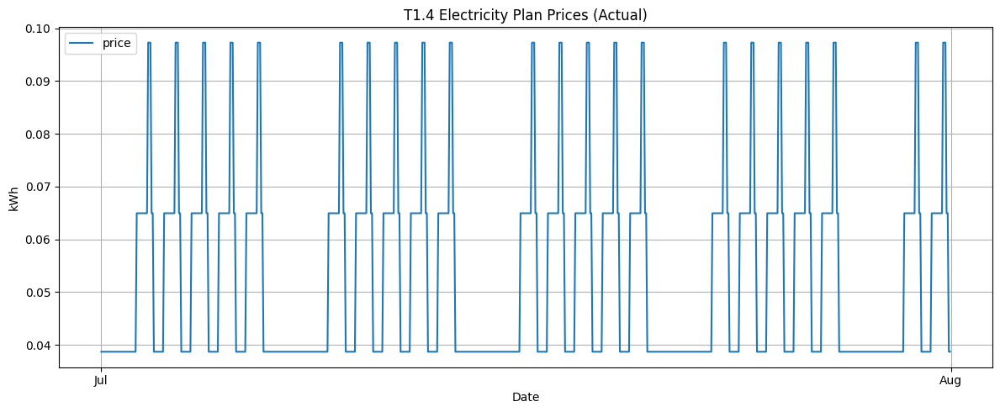

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

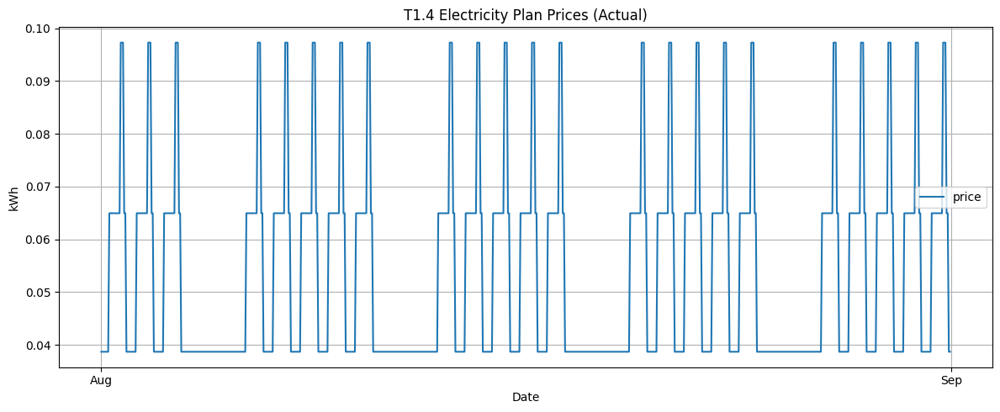

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

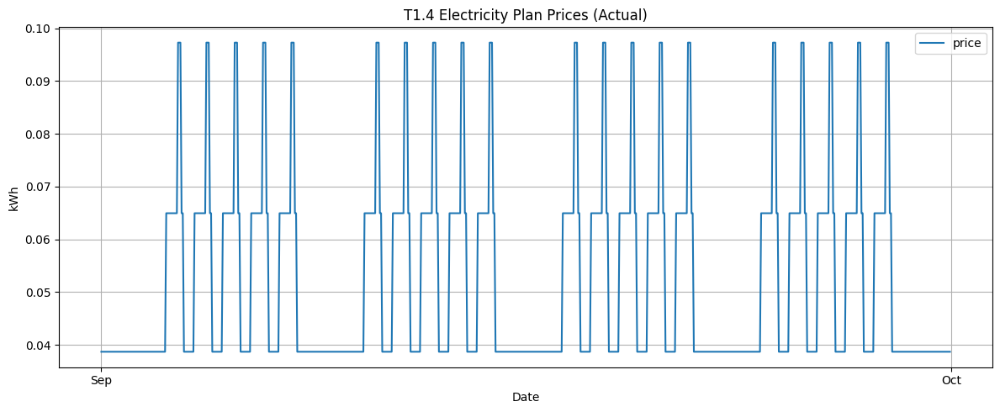

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

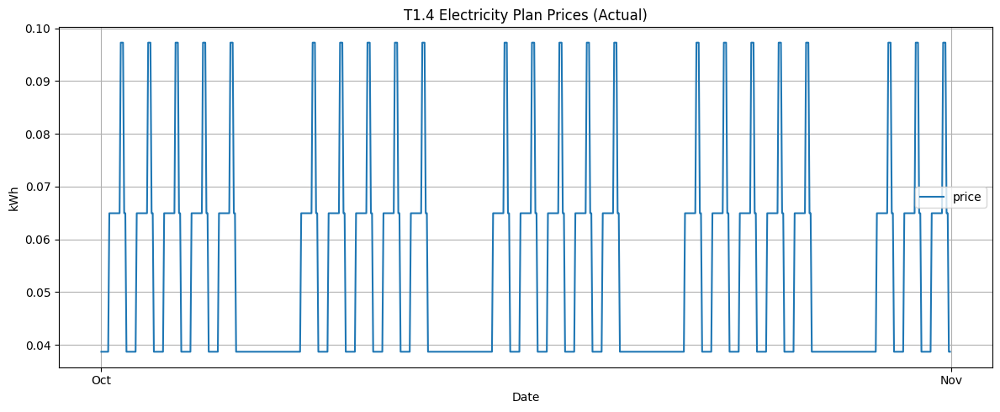

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

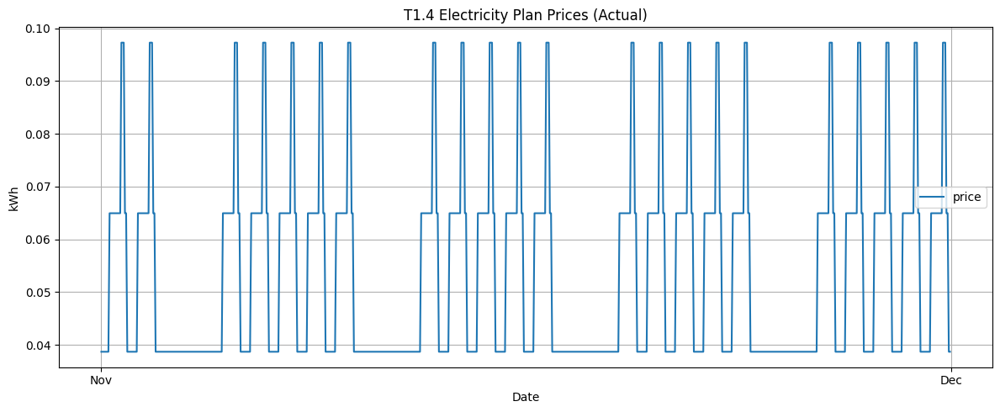

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

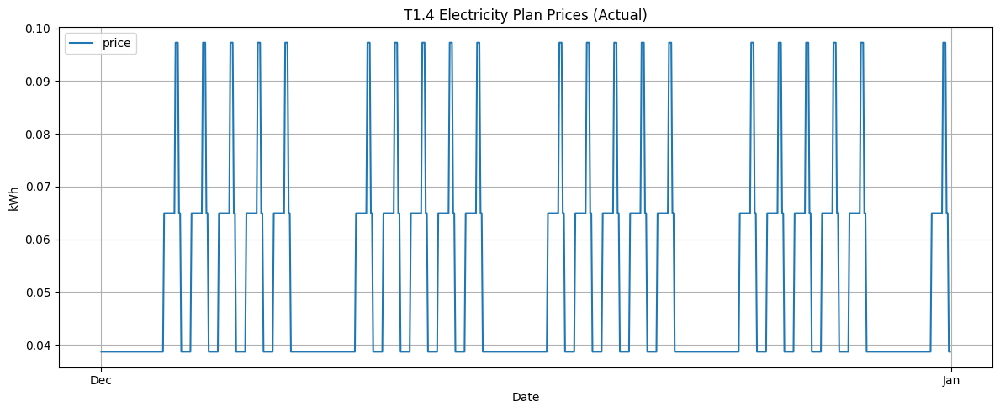

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [102]:
# T1.4
for i in range(1, 13):
  months_to_plot = [i]
  mask = dates.month.isin(months_to_plot)
  filtered_dates = dates[mask]

  ele_plan_vals = excel_ele_plan.iloc[:len(timesteps), 0].to_numpy()[mask]
  plot_series(filtered_dates, {'price': ele_plan_vals}, f'{name} Electricity Plan Prices', window=None)

# V-03

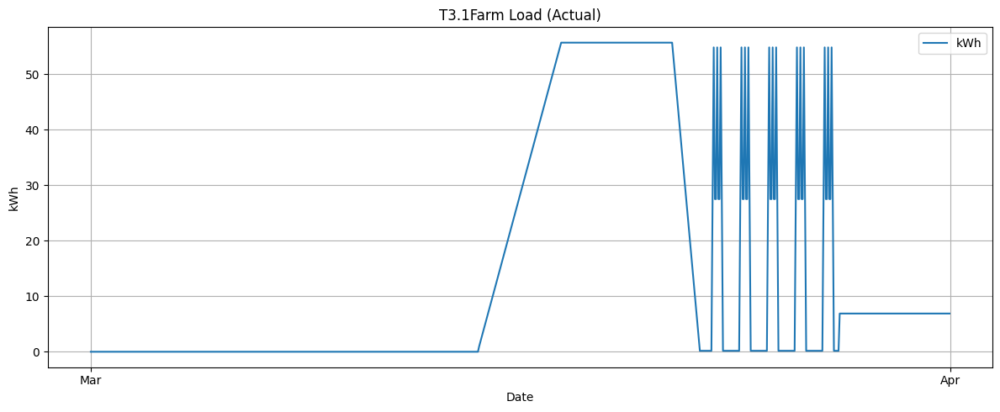

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

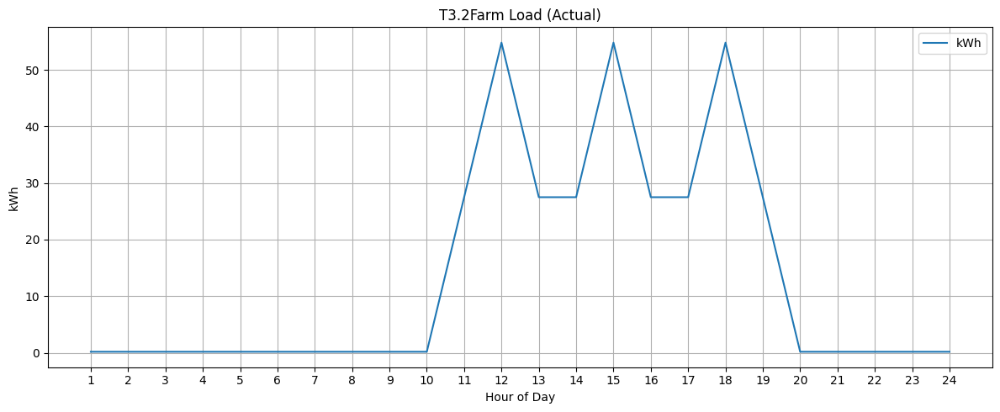

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

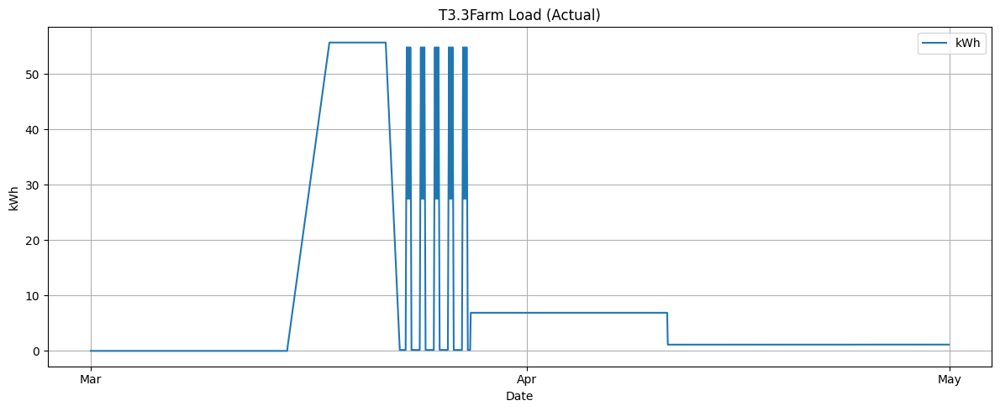

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

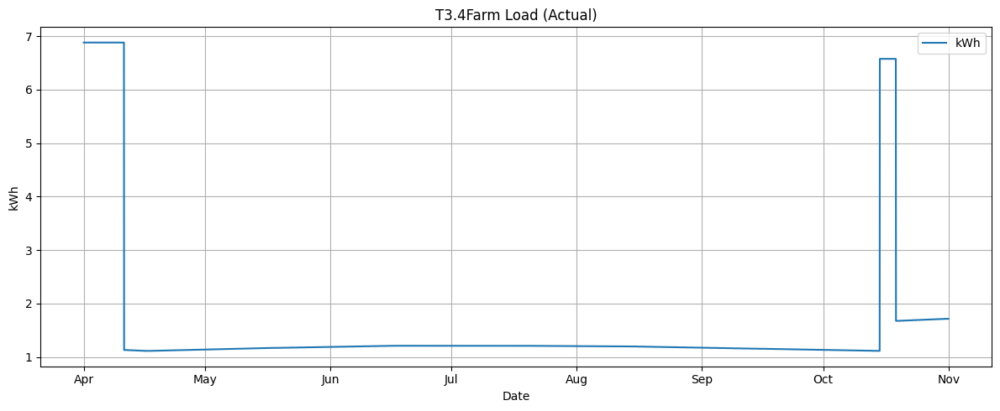

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

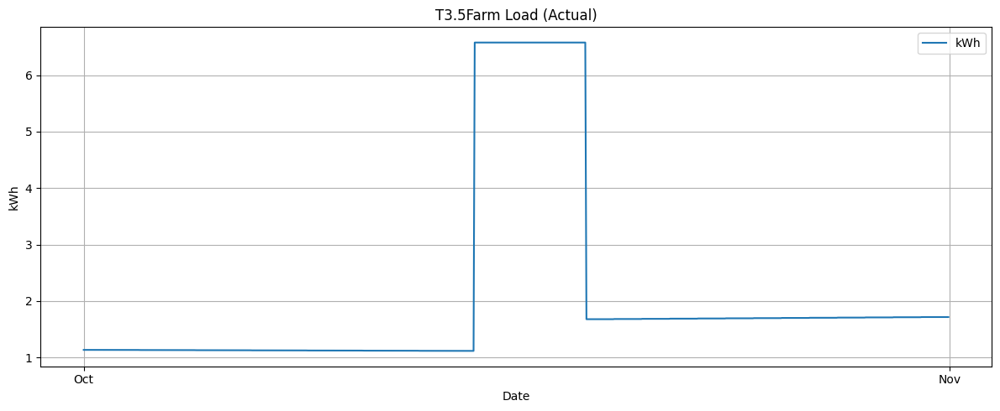

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

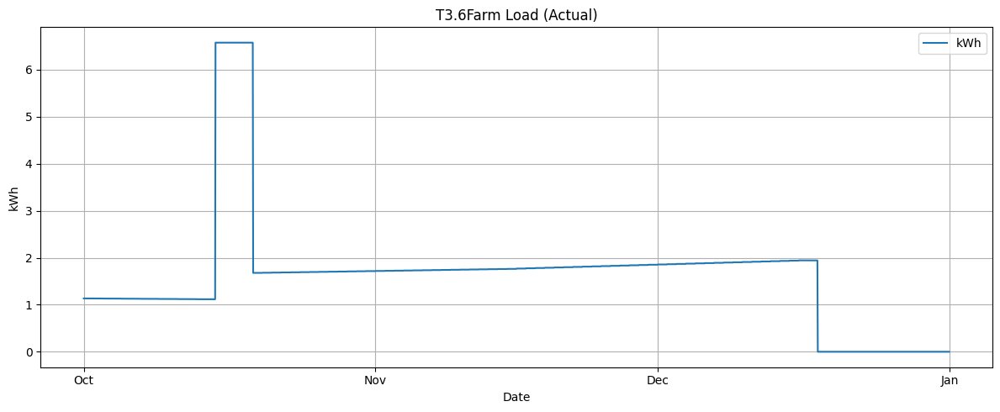

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

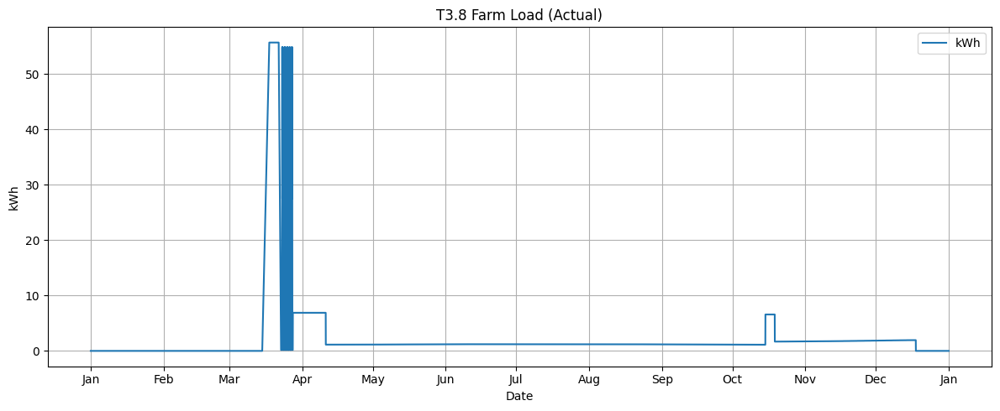

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

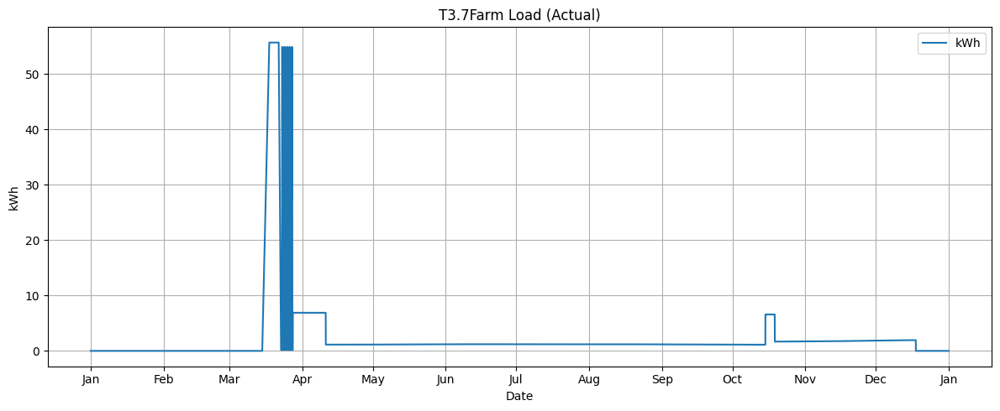

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [14]:
# Testing for V-03
for i in range(1, 8):
  if i == 1:
    months_to_plot = [3]
    mask = dates.month.isin(months_to_plot) #& (dates.day <= 1)
    filtered_dates = dates[mask]
  if i == 2:
    months_to_plot = [3]
    mask = dates.month.isin(months_to_plot) & (dates.day == 23)
    filtered_dates = dates[mask]
  if i == 3:
    months_to_plot = [3,4]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 4:
    months_to_plot = [4,5,6,7,8,9,10]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 5:
    months_to_plot = [10]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 6:
    months_to_plot = [10,11,12]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 7:
    months_to_plot = Year
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
    farm_load_vals = np.array([value(modelv1.farm_load[t]) for t in timesteps])[mask]
    plot_series(filtered_dates, {'kWh': farm_load_vals}, f'{name}.8 Farm Load', window=None)

  ele_profile_vals = excel_ele_profile.iloc[:len(timesteps), 0].to_numpy()[mask]
  plot_series(filtered_dates, {'kWh': ele_profile_vals}, f'{name}''.'f'{i}' 'Farm Load', window=None)

# V-04

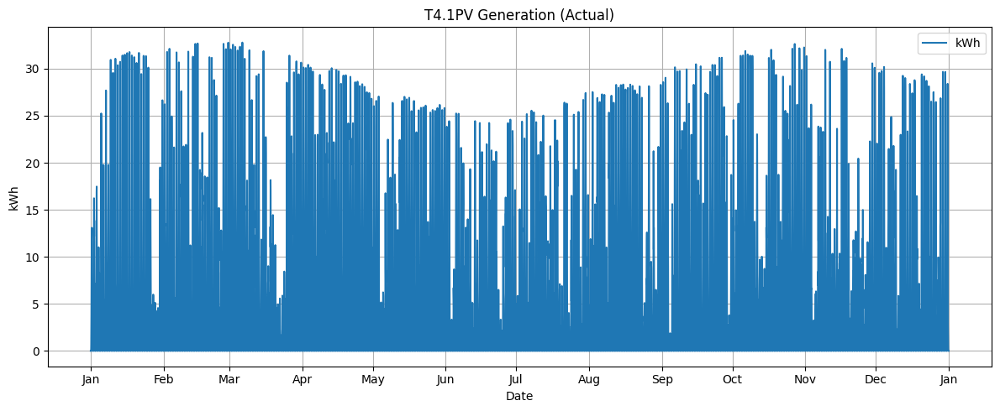

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

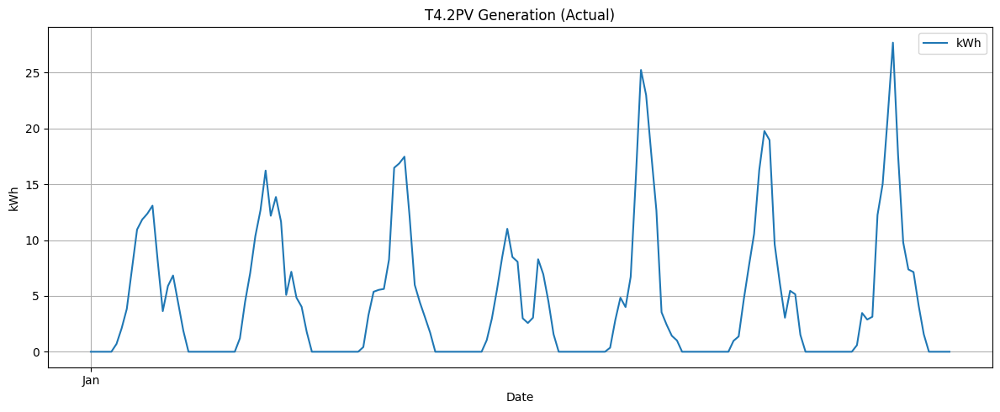

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

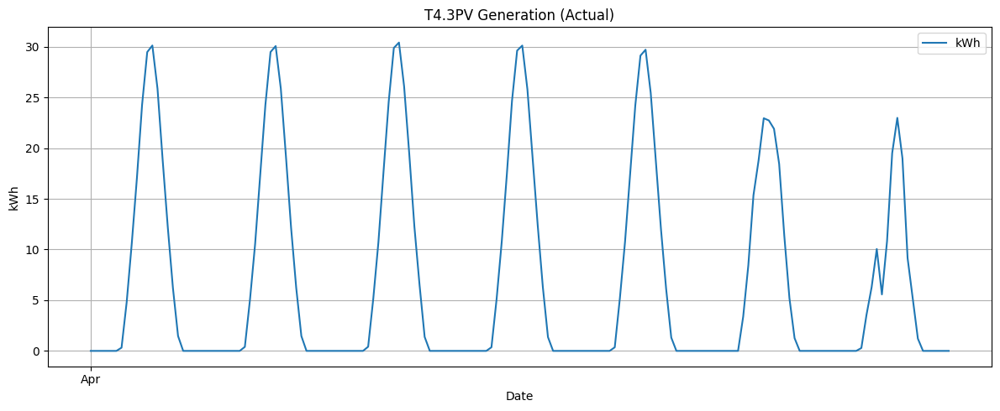

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

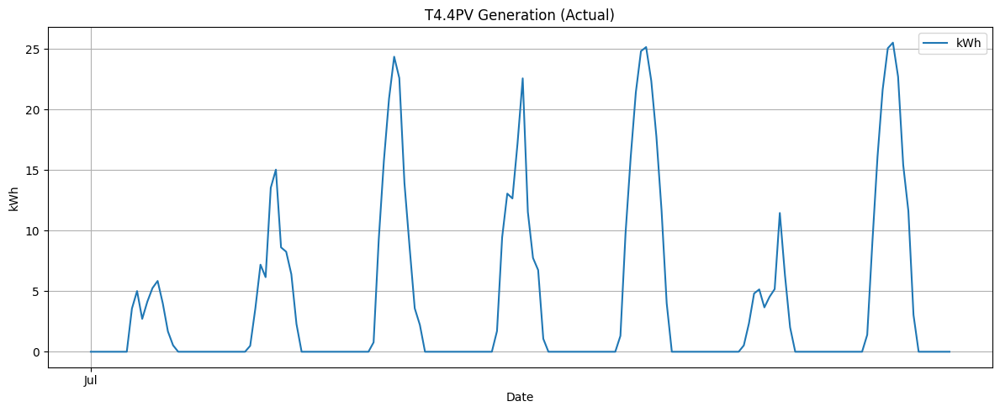

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

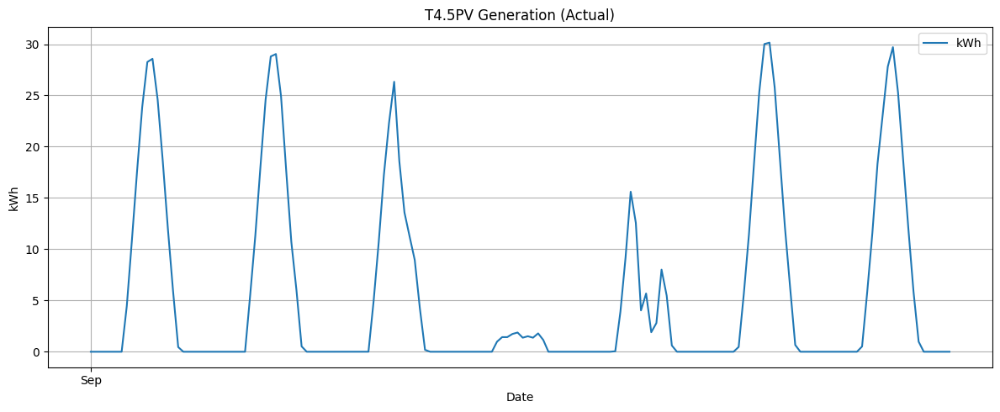

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [17]:
# Testing for V-04
for i in range(1, 6):
  if i == 1:
    months_to_plot = Year
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 2:
    months_to_plot = [1]
    mask = dates.month.isin(months_to_plot) & (dates.day <= 7)
    filtered_dates = dates[mask]
  if i == 3:
    months_to_plot = [4]
    mask = dates.month.isin(months_to_plot) & (dates.day <= 7)
    filtered_dates = dates[mask]
  if i == 4:
    months_to_plot = [7]
    mask = dates.month.isin(months_to_plot) & (dates.day <= 7)
    filtered_dates = dates[mask]
  if i == 5:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day <= 7)
    filtered_dates = dates[mask]

  PV_gen_vals = excel_PV.iloc[:len(timesteps), 0].to_numpy()[mask]
  plot_series(filtered_dates, {'kWh': PV_gen_vals}, f'{name}''.'f'{i}' 'PV Generation', window=None)

# V-06.1

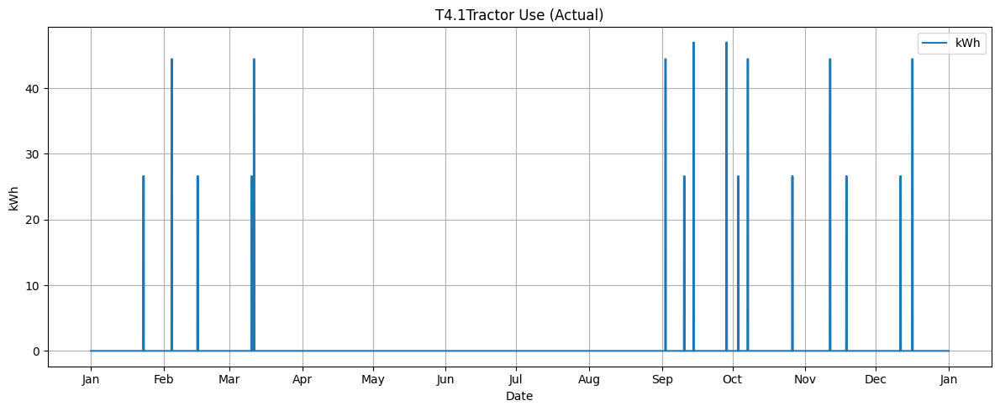

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

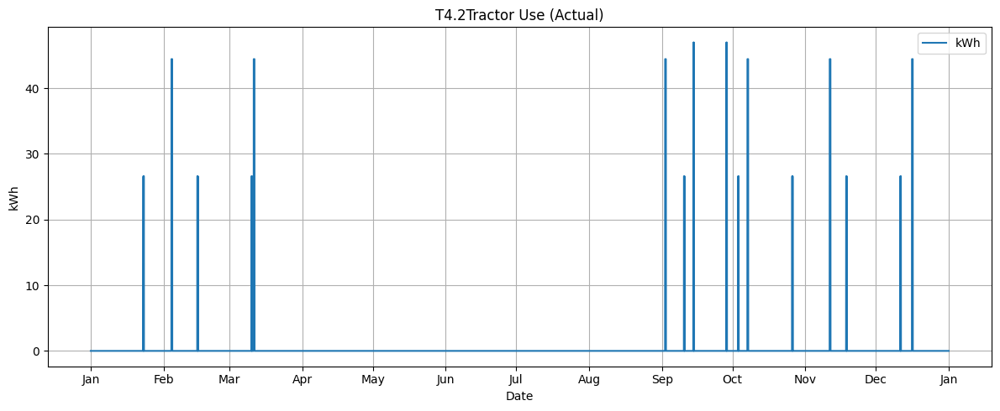

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

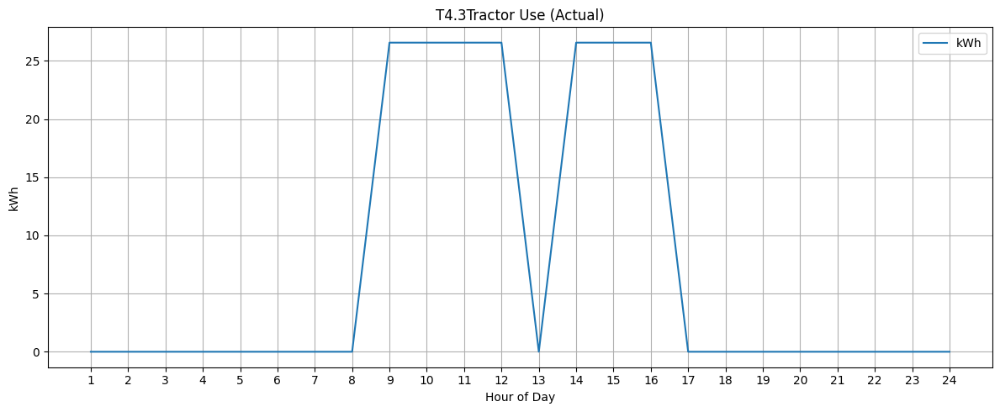

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

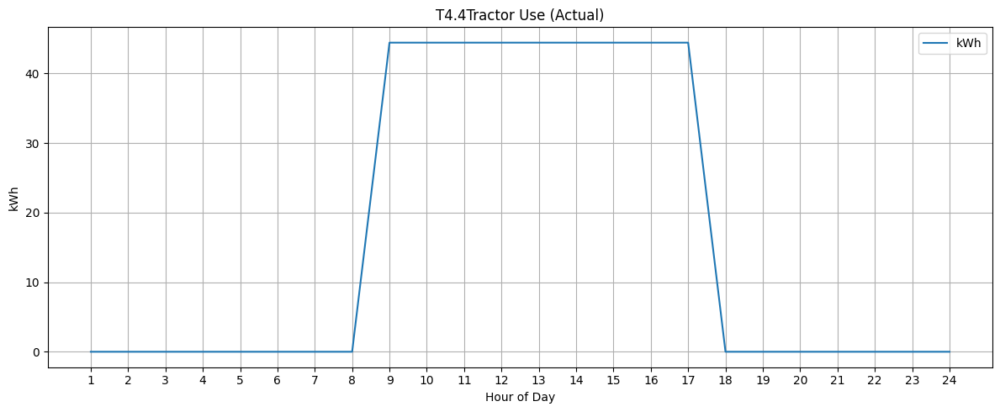

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

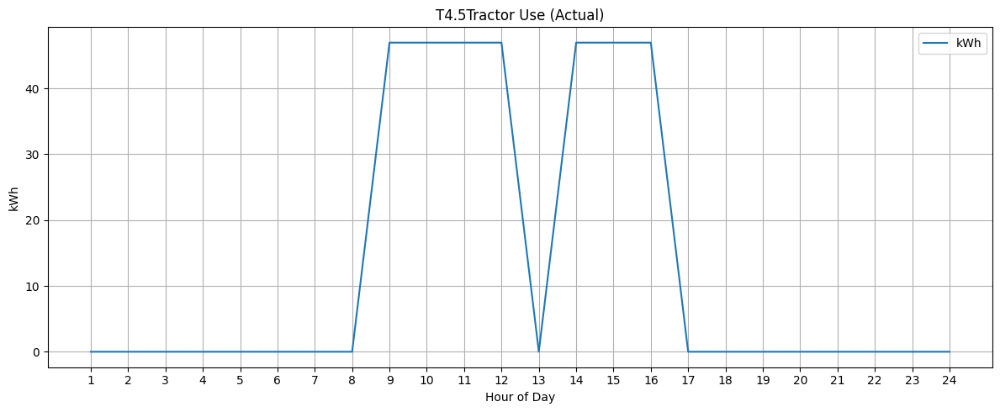

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [18]:
# Testing for V-06.1
for i in range(1, 6):
  if i == 1:
    months_to_plot = Year
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 2:
    months_to_plot = [1,2,3,9,10,11,12]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 3:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 10)
    filtered_dates = dates[mask]
  if i == 4:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 2)
    filtered_dates = dates[mask]
  if i == 5:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 28)
    filtered_dates = dates[mask]

  tractor_use_vals = excel_tractor_use.iloc[:len(timesteps), 0].to_numpy()[mask]
  plot_series(filtered_dates, {'kWh': tractor_use_vals}, f'{name}''.'f'{i}' 'Tractor Use', window=None)

# V-06.2

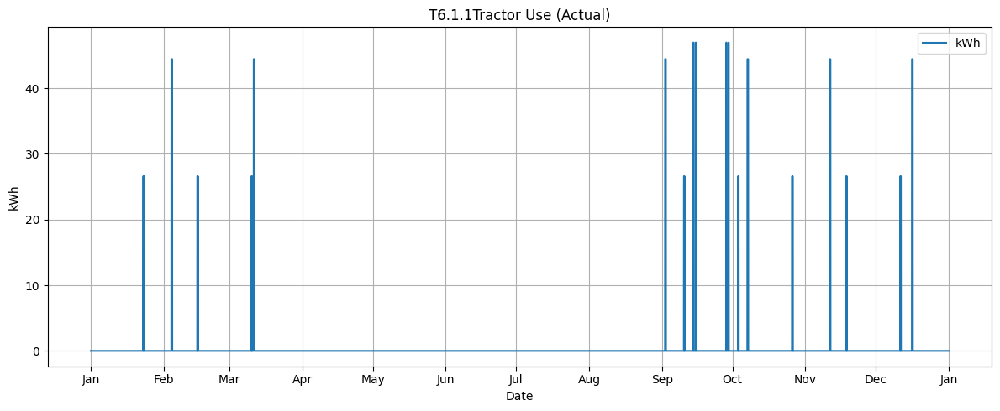

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

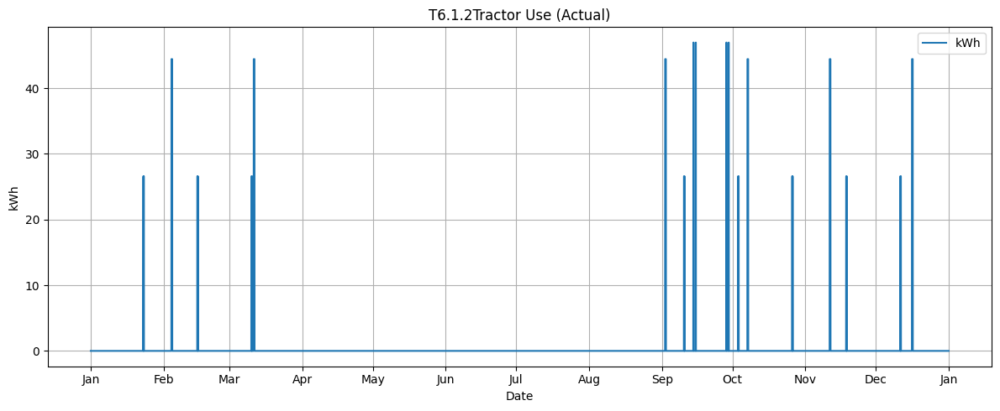

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

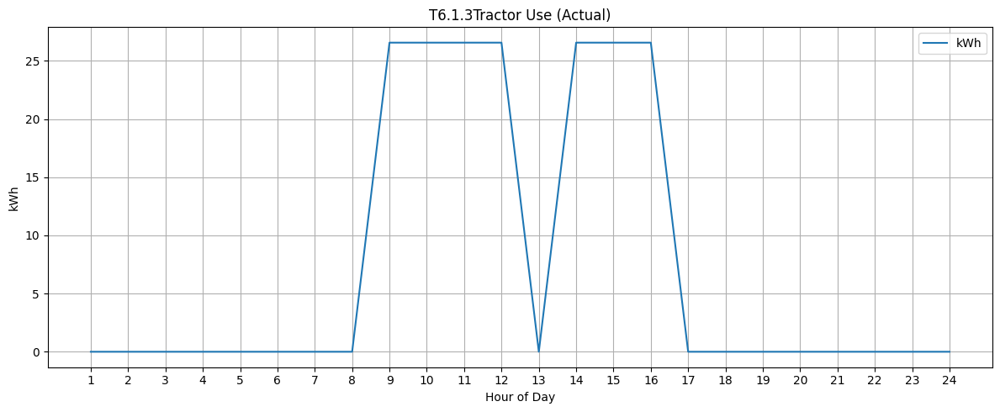

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

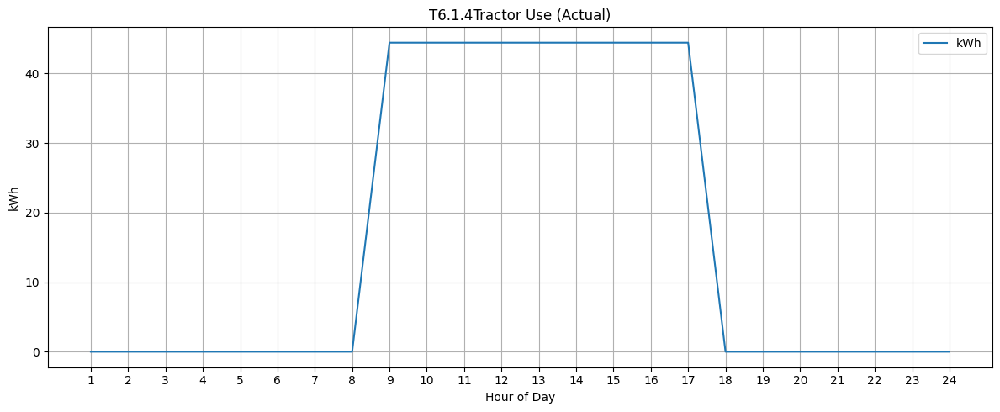

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

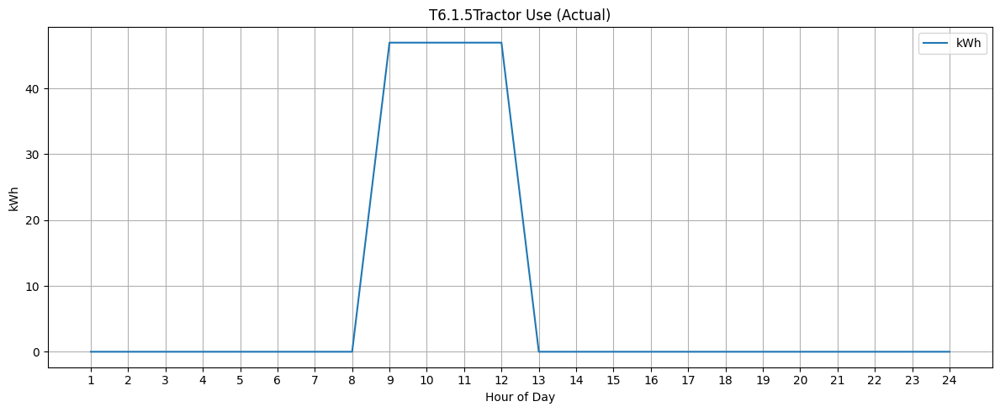

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

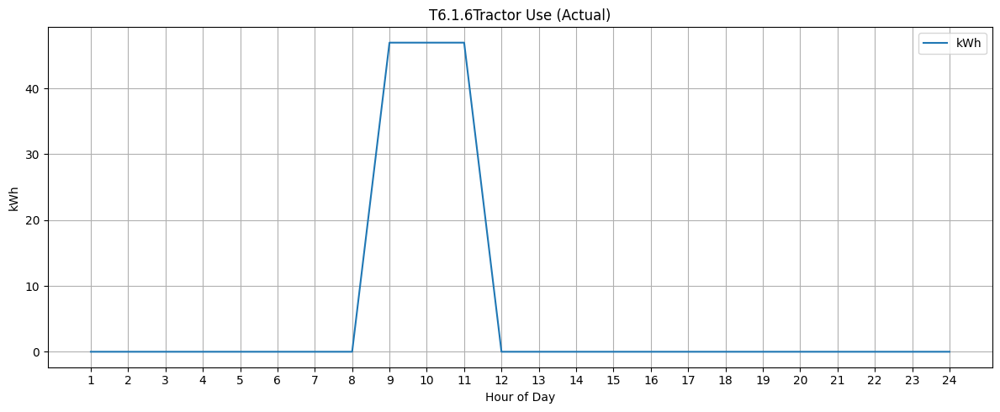

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [52]:
# Testing for V-06.2
for i in range(1, 7):
  if i == 1:
    months_to_plot = Year
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 2:
    months_to_plot = [1,2,3,9,10,11,12]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 3:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 10)
    filtered_dates = dates[mask]
  if i == 4:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 2)
    filtered_dates = dates[mask]
  if i == 5:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 28)
    filtered_dates = dates[mask]
  if i == 6:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 29)
    filtered_dates = dates[mask]

  tractor_use_vals = excel_tractor_use.iloc[:len(timesteps), 0].to_numpy()[mask]
  plot_series(filtered_dates, {'kWh': tractor_use_vals}, f'{name}''.'f'{i}' 'Tractor Use', window=None)

# V-06.3

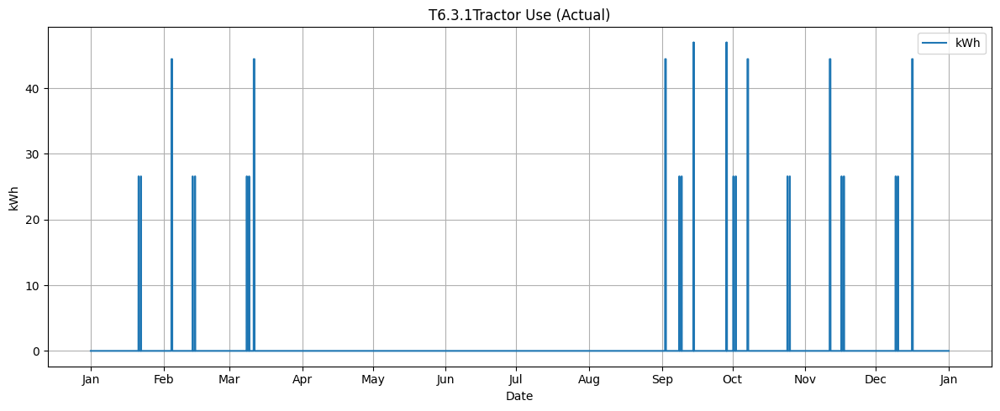

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

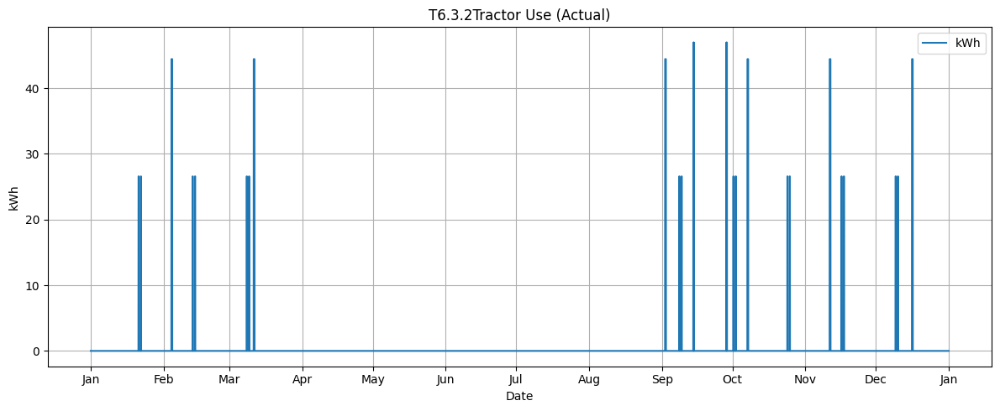

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

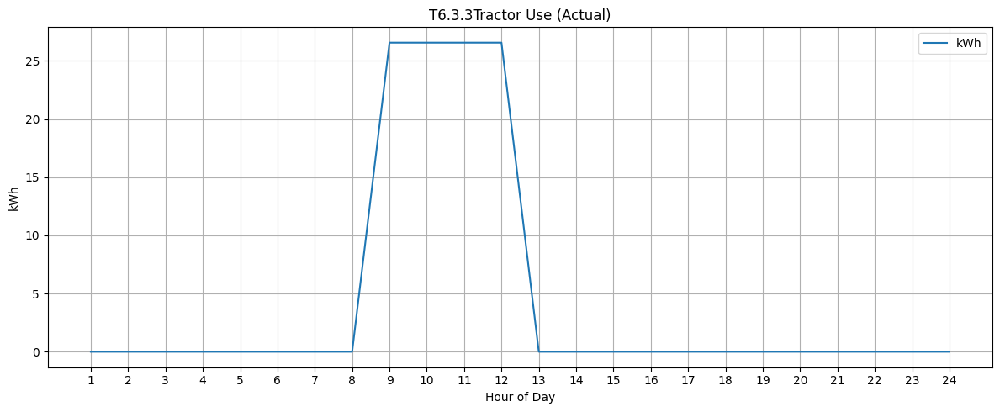

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

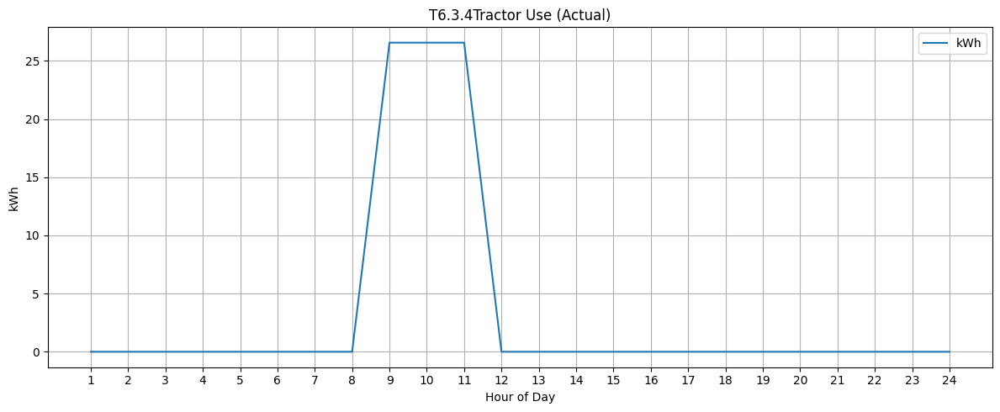

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

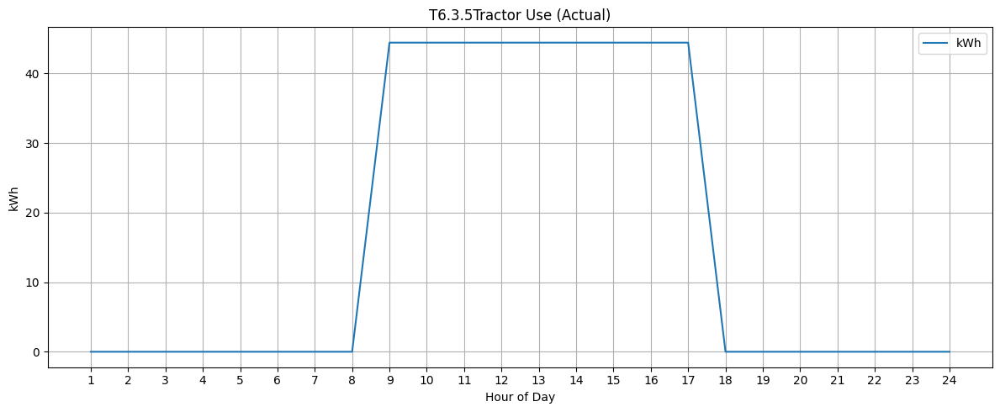

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

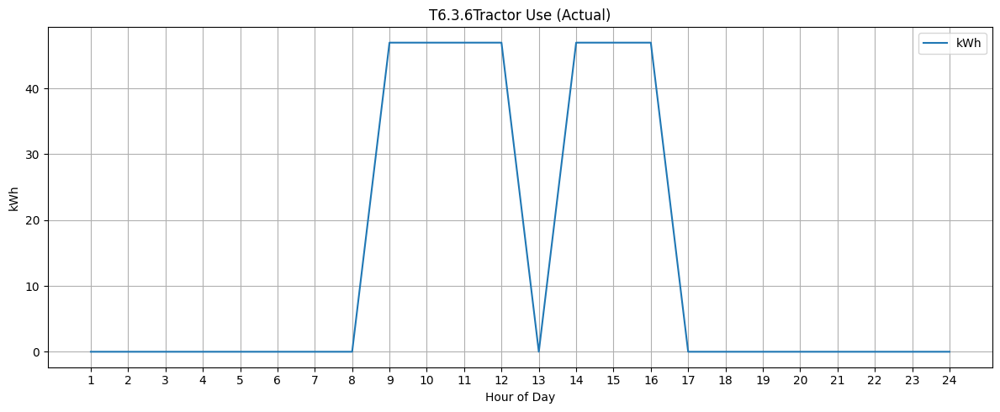

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [63]:
# Testing for V-06.3
for i in range(1, 7):
  if i == 1:
    months_to_plot = Year
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 2:
    months_to_plot = [1,2,3,9,10,11,12]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 3:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 8)
    filtered_dates = dates[mask]
  if i == 4:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 9)
    filtered_dates = dates[mask]
  if i == 5:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 2)
    filtered_dates = dates[mask]
  if i == 6:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 28)
    filtered_dates = dates[mask]

  tractor_use_vals = excel_tractor_use.iloc[:len(timesteps), 0].to_numpy()[mask]
  plot_series(filtered_dates, {'kWh': tractor_use_vals}, f'{name}''.'f'{i}' 'Tractor Use', window=None)

# V-06.4

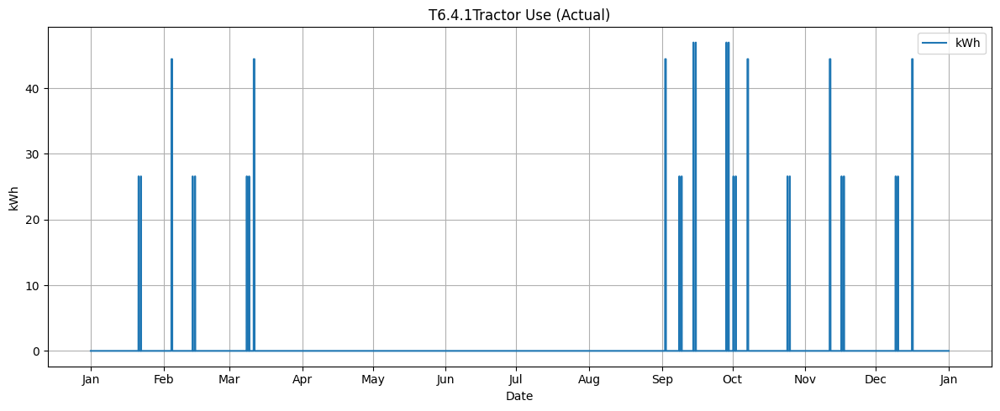

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

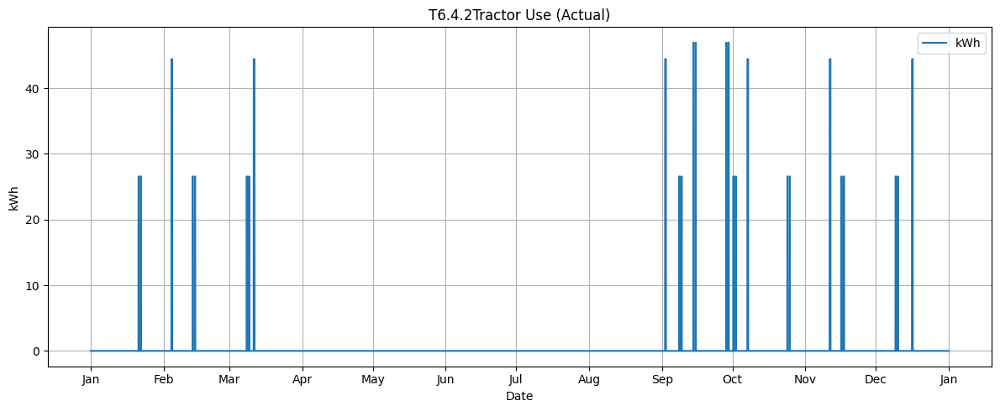

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

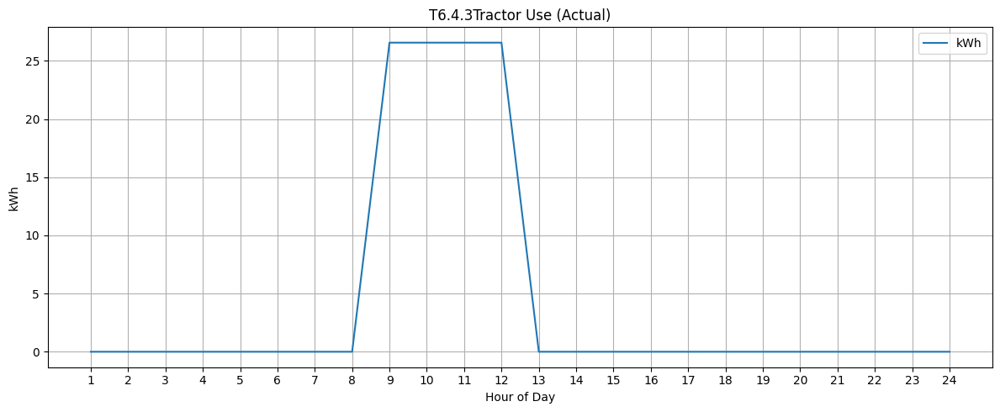

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

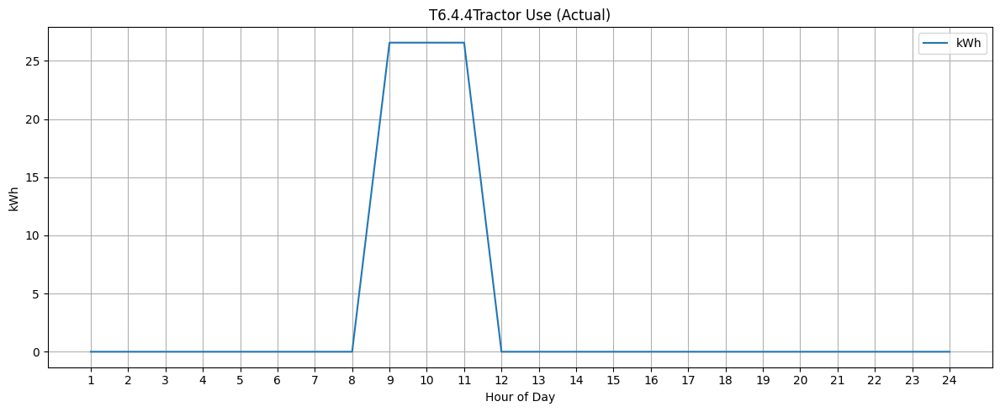

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

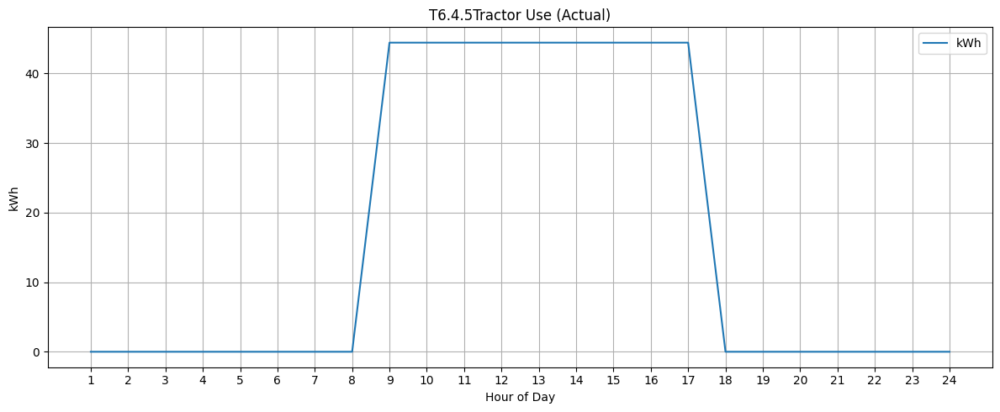

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

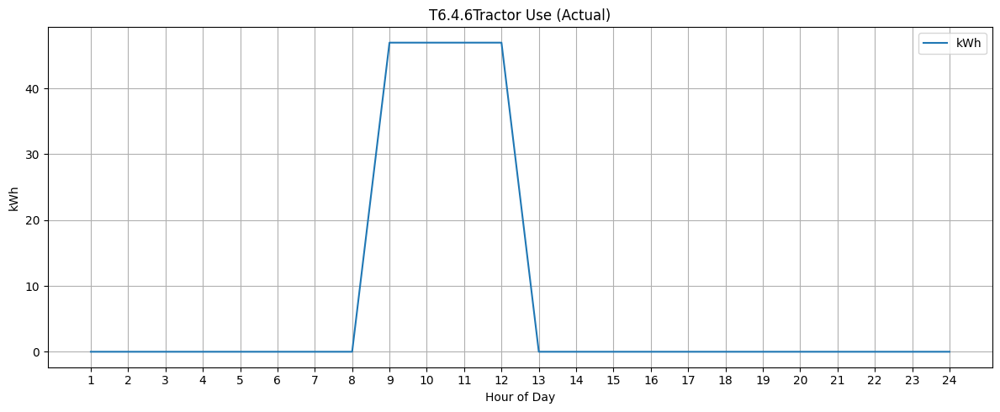

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

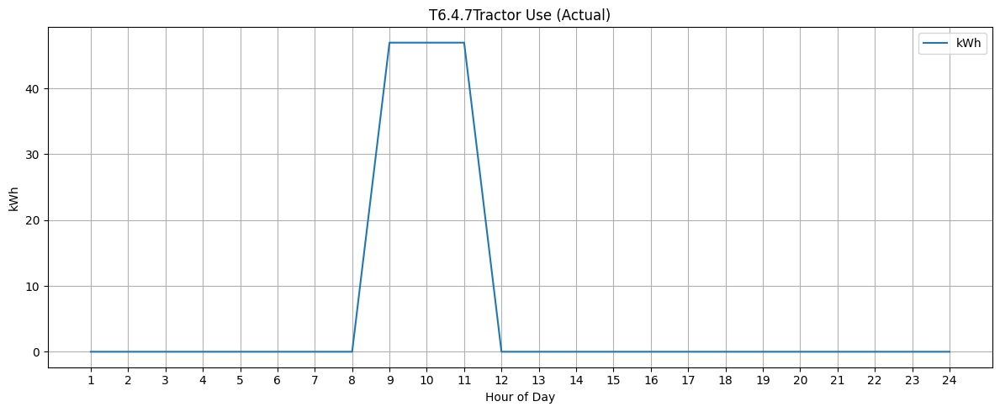

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [74]:
# Testing for V-06.3
for i in range(1, 8):
  if i == 1:
    months_to_plot = Year
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 2:
    months_to_plot = [1,2,3,9,10,11,12]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 3:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 8)
    filtered_dates = dates[mask]
  if i == 4:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 9)
    filtered_dates = dates[mask]
  if i == 5:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 2)
    filtered_dates = dates[mask]
  if i == 6:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 28)
    filtered_dates = dates[mask]
  if i == 7:
    months_to_plot = [9]
    mask = dates.month.isin(months_to_plot) & (dates.day == 29)
    filtered_dates = dates[mask]

  tractor_use_vals = excel_tractor_use.iloc[:len(timesteps), 0].to_numpy()[mask]
  plot_series(filtered_dates, {'kWh': tractor_use_vals}, f'{name}''.'f'{i}' 'Tractor Use', window=None)

# V-07

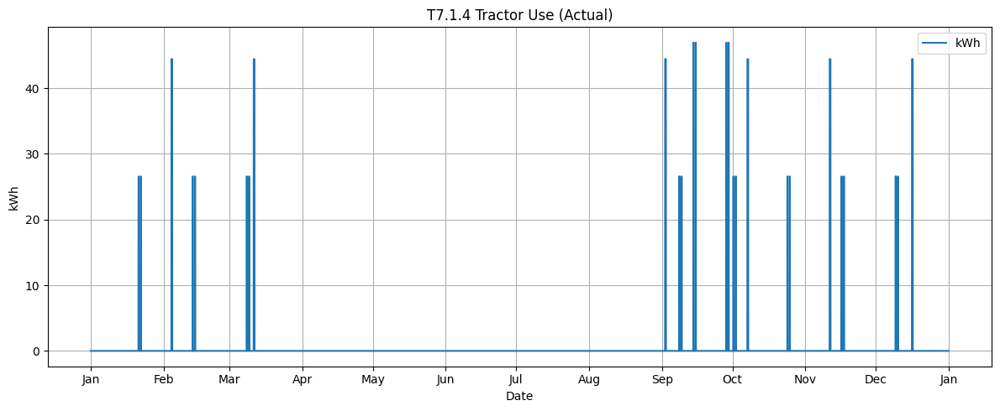

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

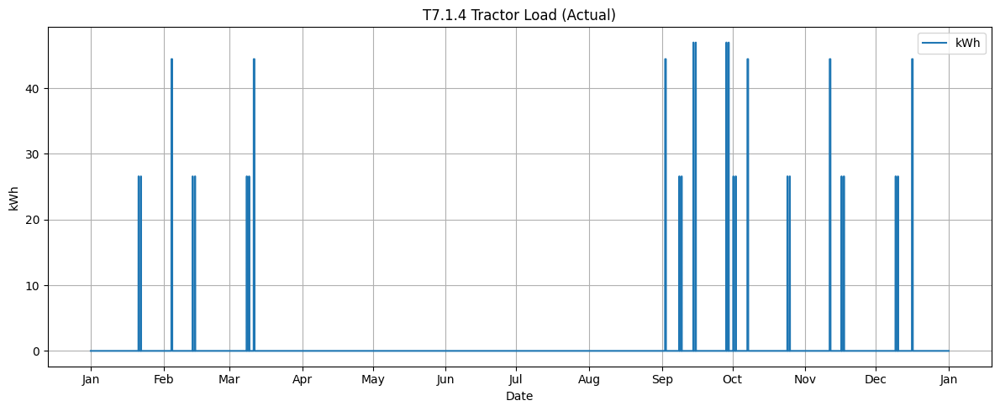

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [77]:
# Testing for V-07
# T7.1
months_to_plot = Year
mask = dates.month.isin(months_to_plot)
filtered_dates = dates[mask]

tractor_use_vals = excel_tractor_use.iloc[:len(timesteps), 0].to_numpy()[mask]
plot_series(filtered_dates, {'kWh': tractor_use_vals}, f'{name} Tractor Use', window=None)
tractor_load_vals = np.array([value(modelv1.tractor_load[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': tractor_load_vals}, f'{name} Tractor Load', window=None)


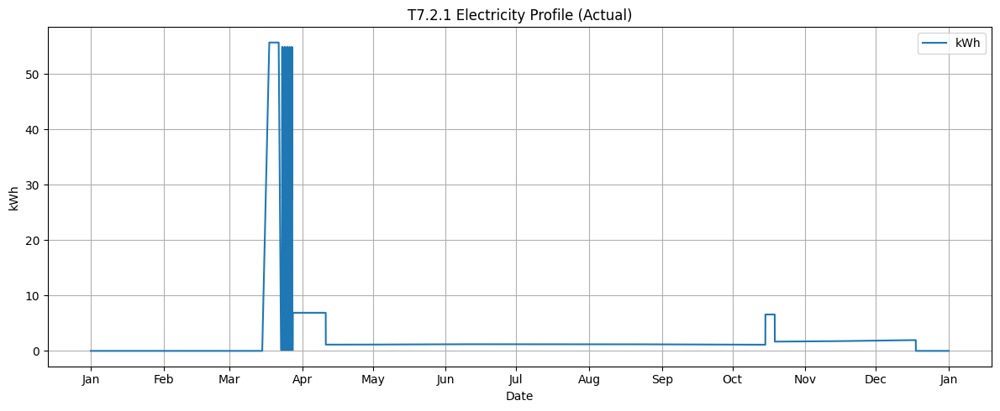

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

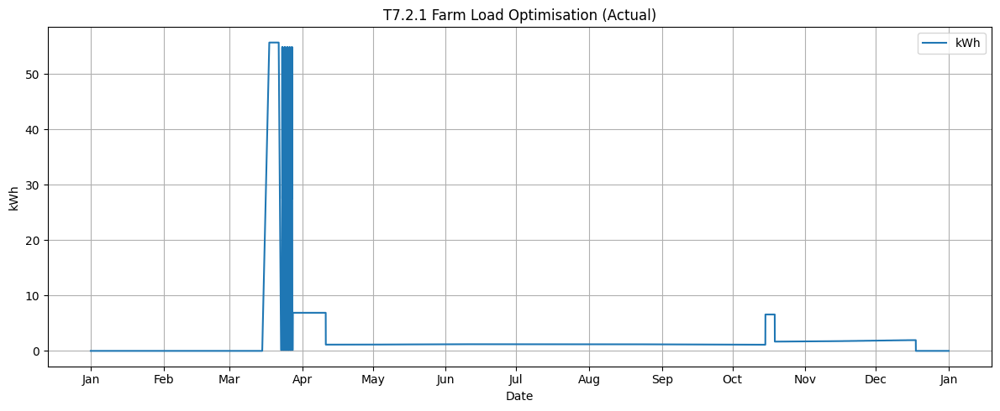

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

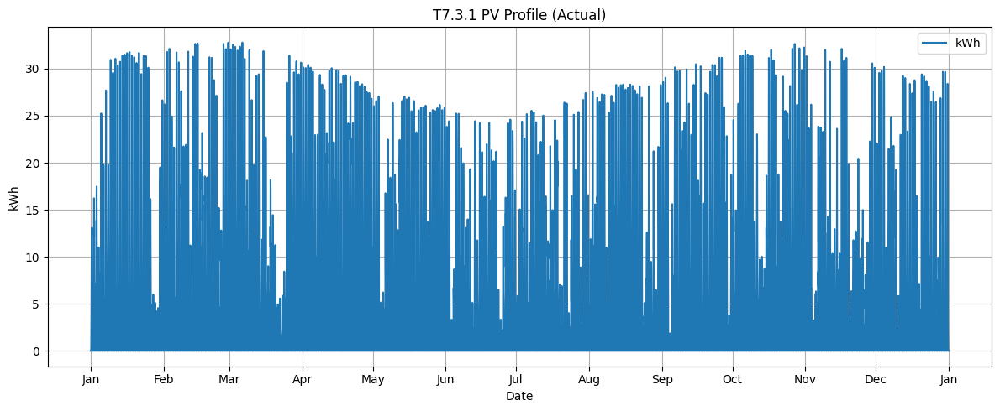

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

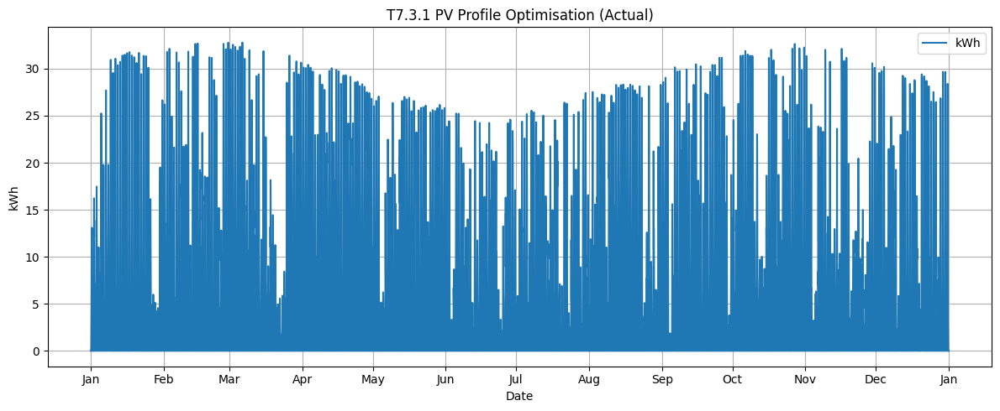

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

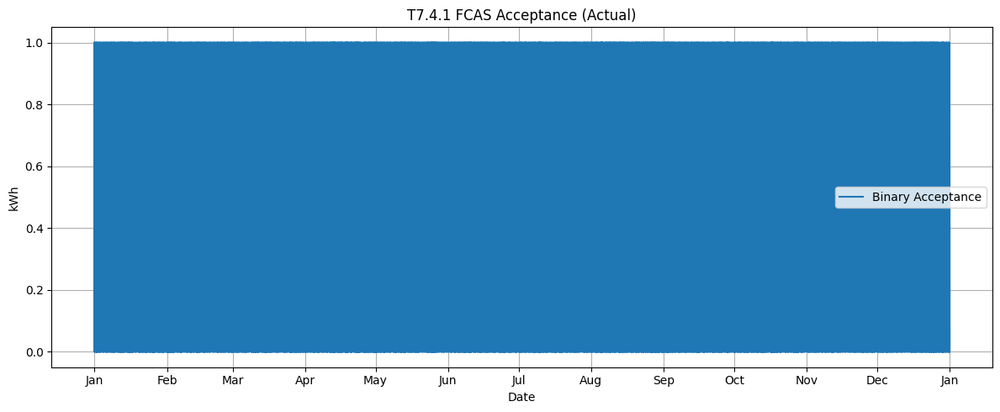

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

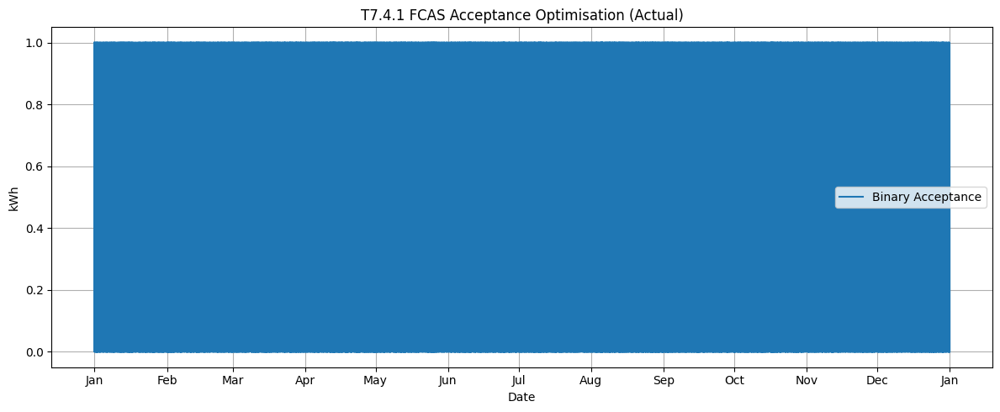

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

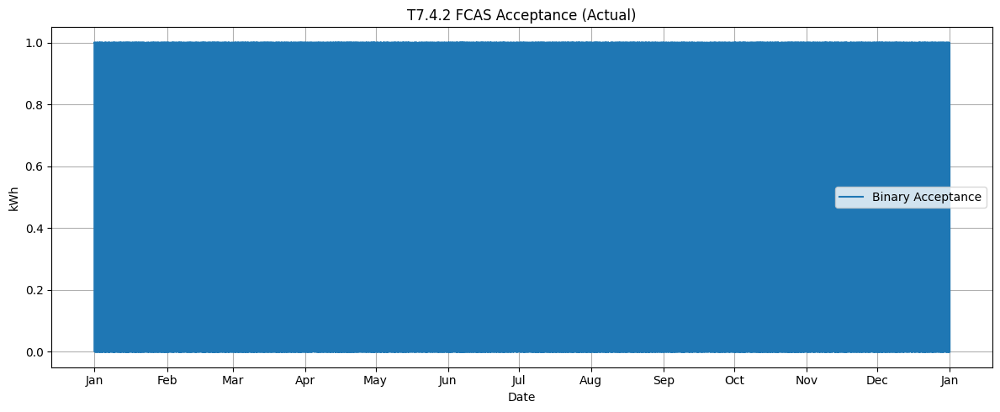

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

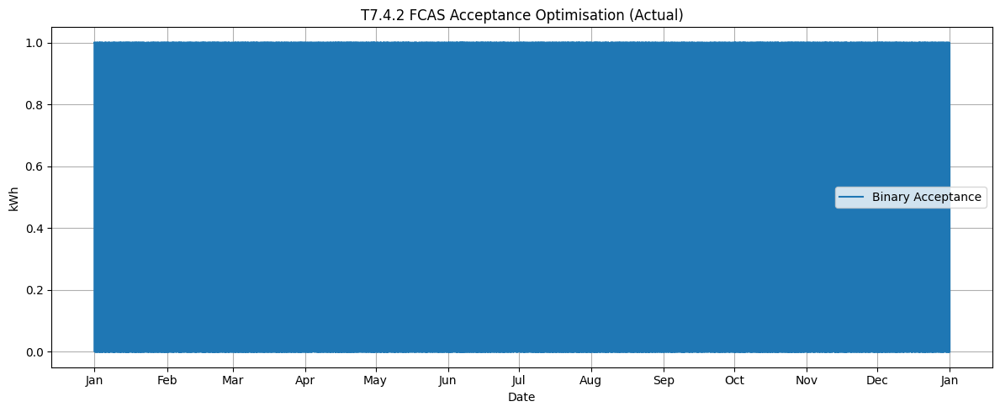

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

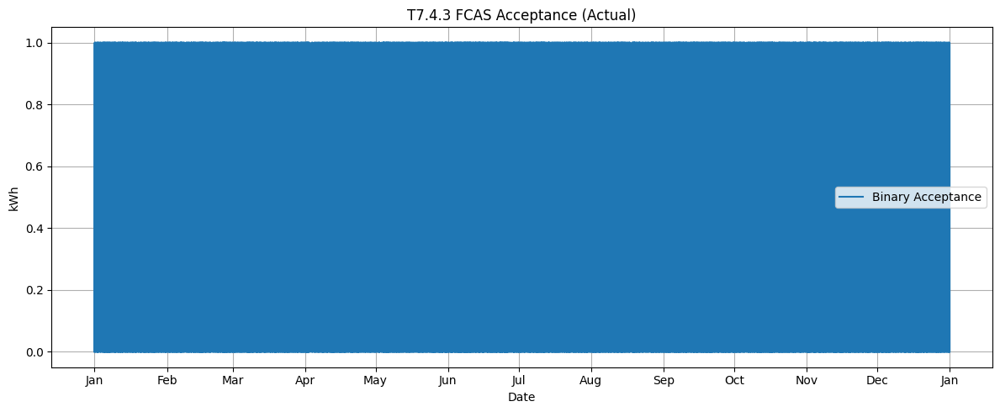

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

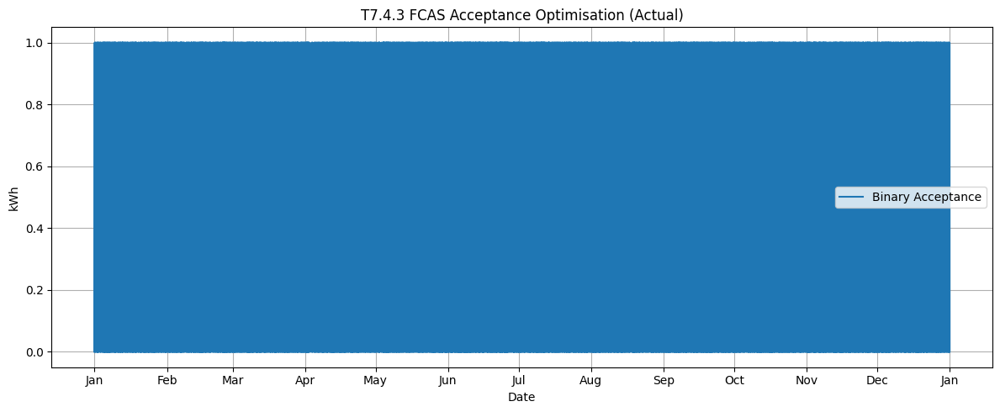

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

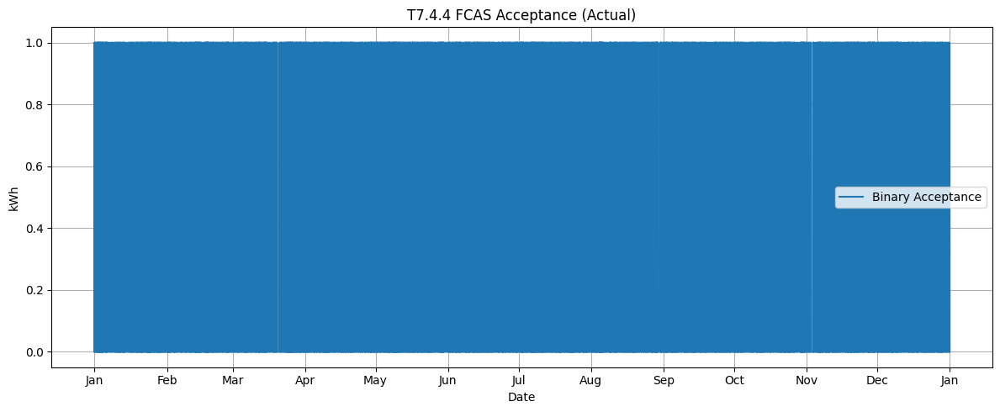

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

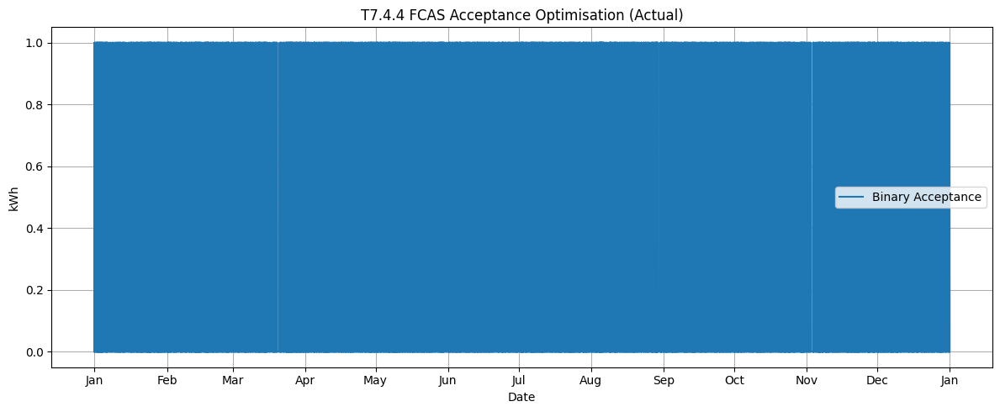

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

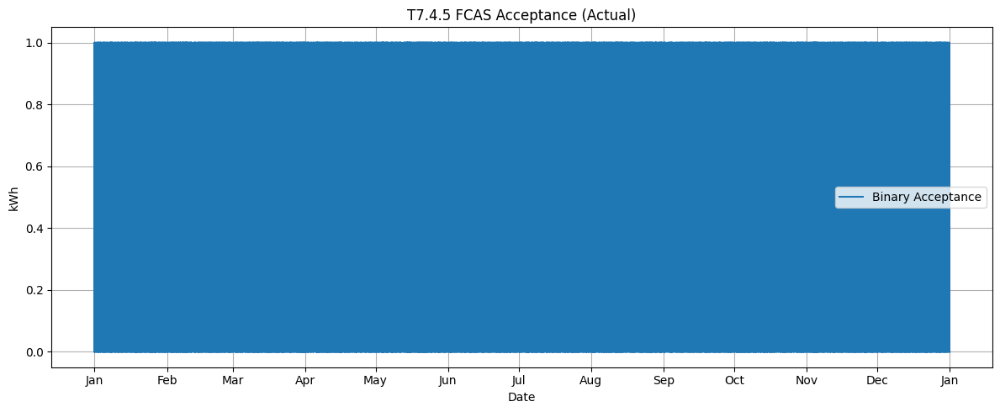

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

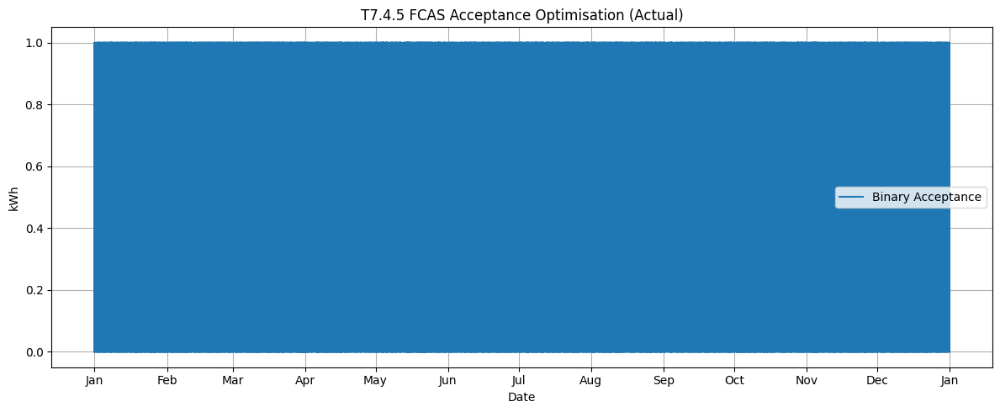

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

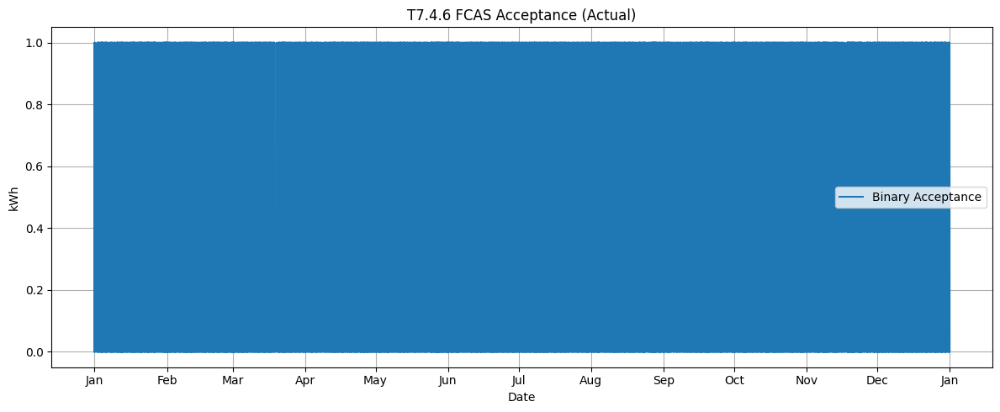

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

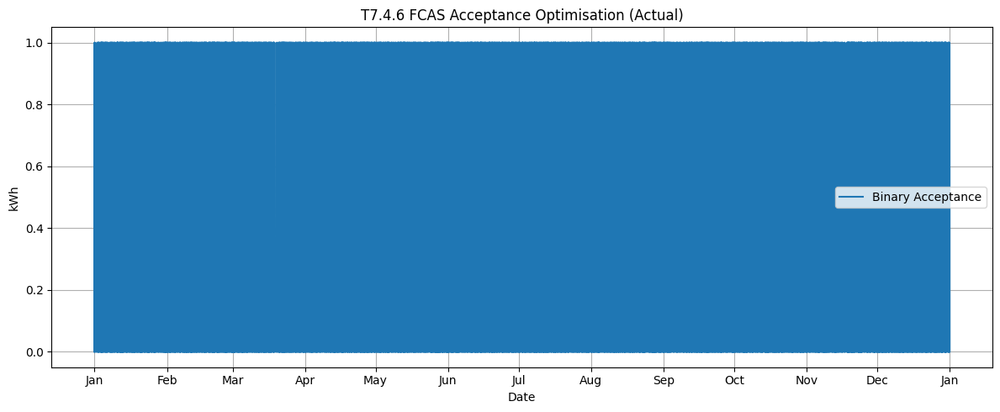

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

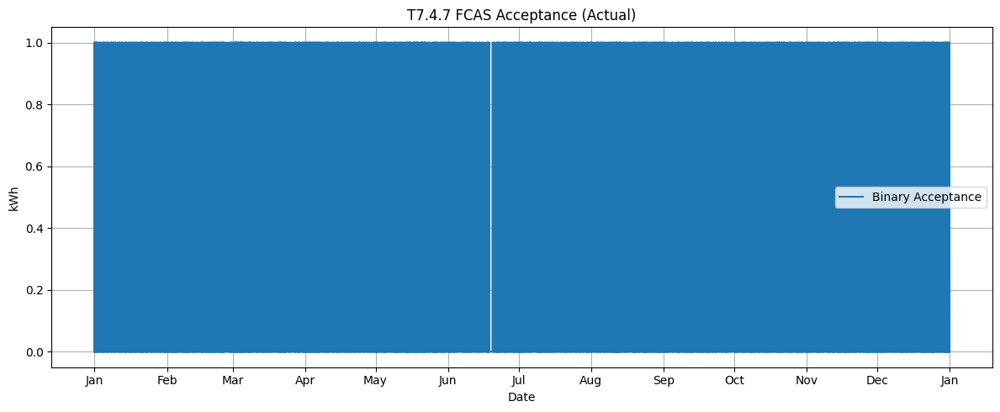

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

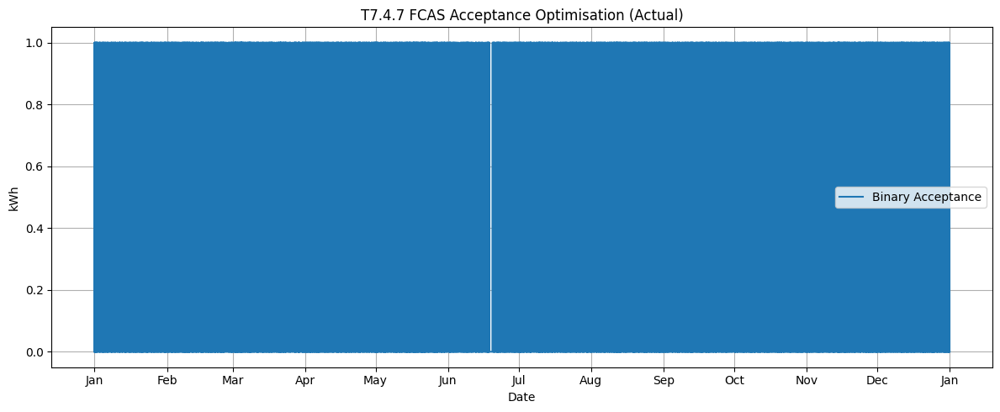

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

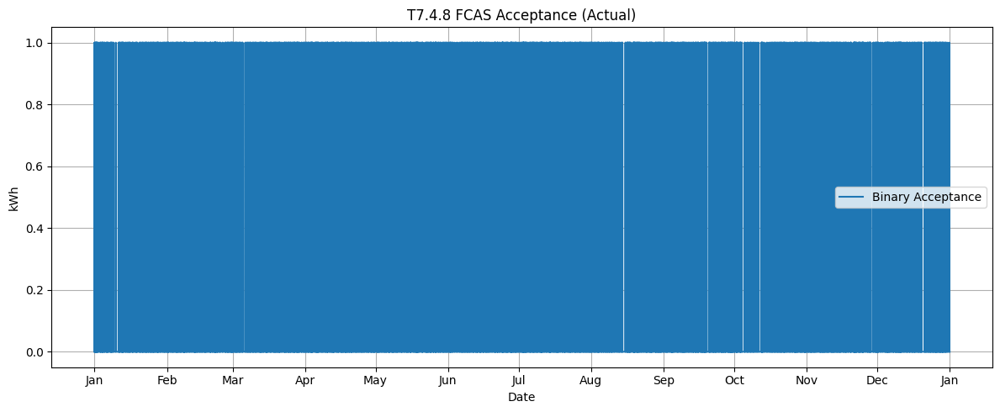

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

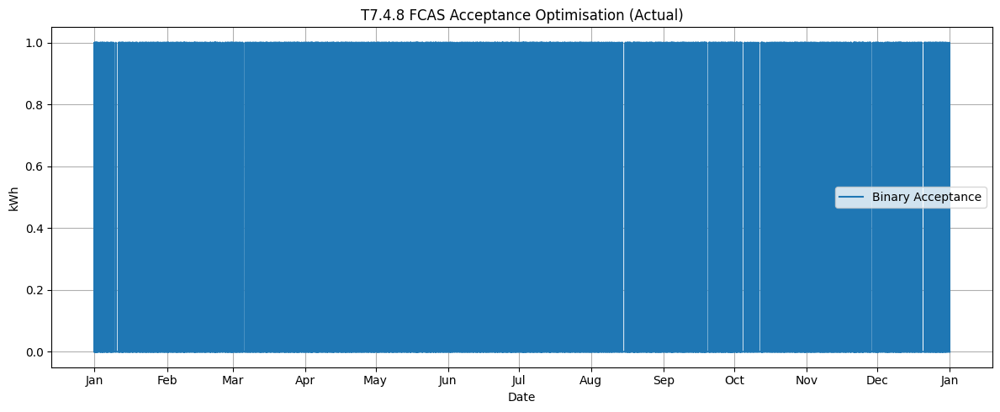

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [22]:
months_to_plot = Year
mask = dates.month.isin(months_to_plot)
filtered_dates = dates[mask]

# T7.2
ele_profile_vals = excel_ele_profile.iloc[:len(timesteps), 0].to_numpy()[mask]
plot_series(filtered_dates, {'kWh': ele_profile_vals}, f'{name}.2.1 Electricity Profile', window=None)
farm_load_vals = np.array([value(modelv1.farm_load[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': farm_load_vals}, f'{name}.2.1 Farm Load Optimisation', window=None)

# T7.3
PV_profile_vals = excel_PV.iloc[:len(timesteps), 0].to_numpy()[mask]
plot_series(filtered_dates, {'kWh': PV_profile_vals}, f'{name}.3.1 PV Profile', window=None)
PV_vals = np.array([value(modelv1.PV[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': PV_vals}, f'{name}.3.1 PV Profile Optimisation', window=None)

# T7.4
acc_R1_vals = acc_raise_1s.iloc[:len(timesteps), 0].to_numpy()[mask]
plot_series(filtered_dates, {'Binary Acceptance': acc_R1_vals}, f'{name}.4.1 FCAS Acceptance', window=None)
e_R1_vals = np.array([value(modelv1.e_R1s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'Binary Acceptance': e_R1_vals}, f'{name}.4.1 FCAS Acceptance Optimisation', window=None)
acc_R6_vals = acc_raise_6s.iloc[:len(timesteps), 0].to_numpy()[mask]
plot_series(filtered_dates, {'Binary Acceptance': acc_R6_vals}, f'{name}.4.2 FCAS Acceptance', window=None)
e_R6_vals = np.array([value(modelv1.e_R6s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'Binary Acceptance': e_R6_vals}, f'{name}.4.2 FCAS Acceptance Optimisation', window=None)
acc_R60_vals = acc_raise_60s.iloc[:len(timesteps), 0].to_numpy()[mask]
plot_series(filtered_dates, {'Binary Acceptance': acc_R60_vals}, f'{name}.4.3 FCAS Acceptance', window=None)
e_R60_vals = np.array([value(modelv1.e_R60s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'Binary Acceptance': e_R60_vals}, f'{name}.4.3 FCAS Acceptance Optimisation', window=None)
acc_R5_vals = acc_raise_5m.iloc[:len(timesteps), 0].to_numpy()[mask]
plot_series(filtered_dates, {'Binary Acceptance': acc_R5_vals}, f'{name}.4.4 FCAS Acceptance', window=None)
e_R5_vals = np.array([value(modelv1.e_R5m[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'Binary Acceptance': e_R5_vals}, f'{name}.4.4 FCAS Acceptance Optimisation', window=None)

acc_L1_vals = acc_lower_1s.iloc[:len(timesteps), 0].to_numpy()[mask]
plot_series(filtered_dates, {'Binary Acceptance': acc_L1_vals}, f'{name}.4.5 FCAS Acceptance', window=None)
e_L1_vals = np.array([value(modelv1.e_L1s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'Binary Acceptance': e_L1_vals}, f'{name}.4.5 FCAS Acceptance Optimisation', window=None)
acc_L6_vals = acc_lower_6s.iloc[:len(timesteps), 0].to_numpy()[mask]
plot_series(filtered_dates, {'Binary Acceptance': acc_L6_vals}, f'{name}.4.6 FCAS Acceptance', window=None)
e_L6_vals = np.array([value(modelv1.e_L6s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'Binary Acceptance': e_L6_vals}, f'{name}.4.6 FCAS Acceptance Optimisation', window=None)
acc_L60_vals = acc_lower_60s.iloc[:len(timesteps), 0].to_numpy()[mask]
plot_series(filtered_dates, {'Binary Acceptance': acc_L60_vals}, f'{name}.4.7 FCAS Acceptance', window=None)
e_L60_vals = np.array([value(modelv1.e_L60s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'Binary Acceptance': e_L60_vals}, f'{name}.4.7 FCAS Acceptance Optimisation', window=None)
acc_L5_vals = acc_lower_5m.iloc[:len(timesteps), 0].to_numpy()[mask]
plot_series(filtered_dates, {'Binary Acceptance': acc_L5_vals}, f'{name}.4.8 FCAS Acceptance', window=None)
e_L5_vals = np.array([value(modelv1.e_L5m[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'Binary Acceptance': e_L5_vals}, f'{name}.4.8 FCAS Acceptance Optimisation', window=None)



# V-09

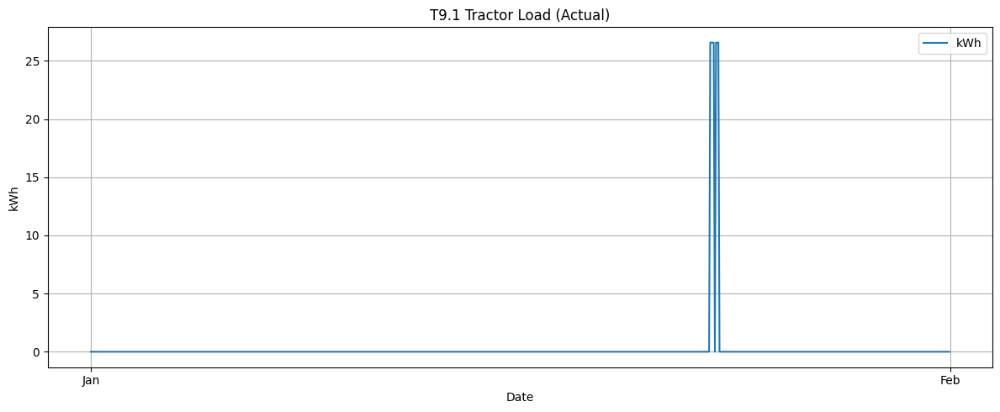

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

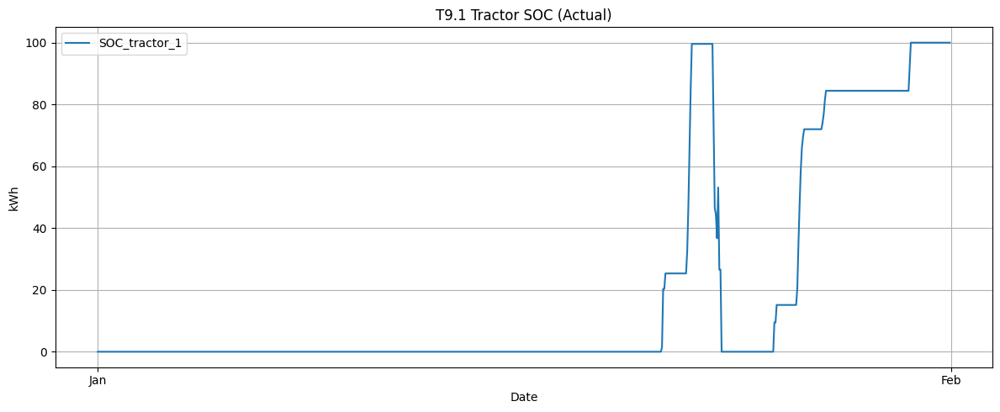

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

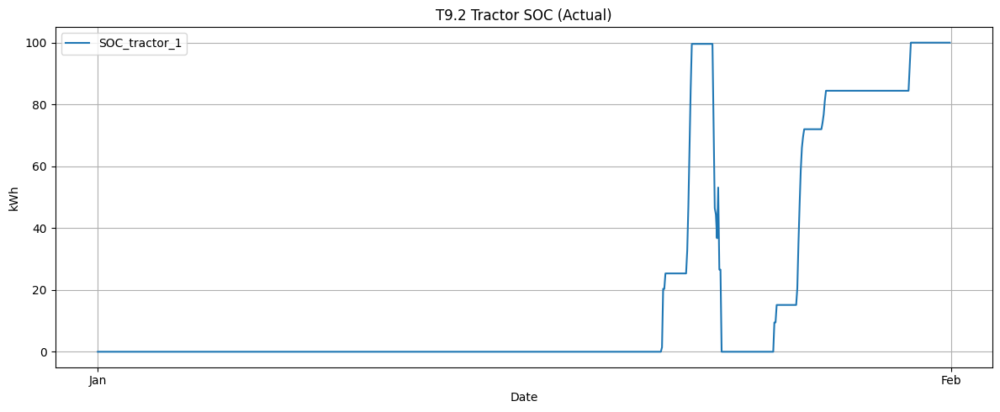

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

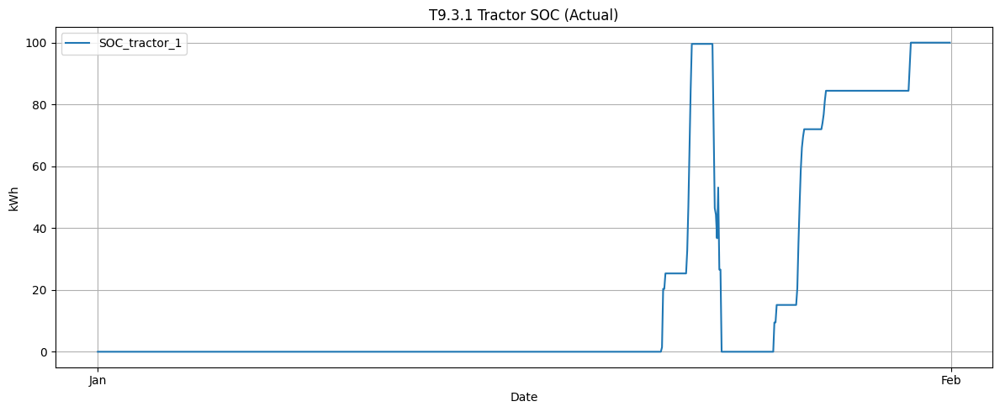

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

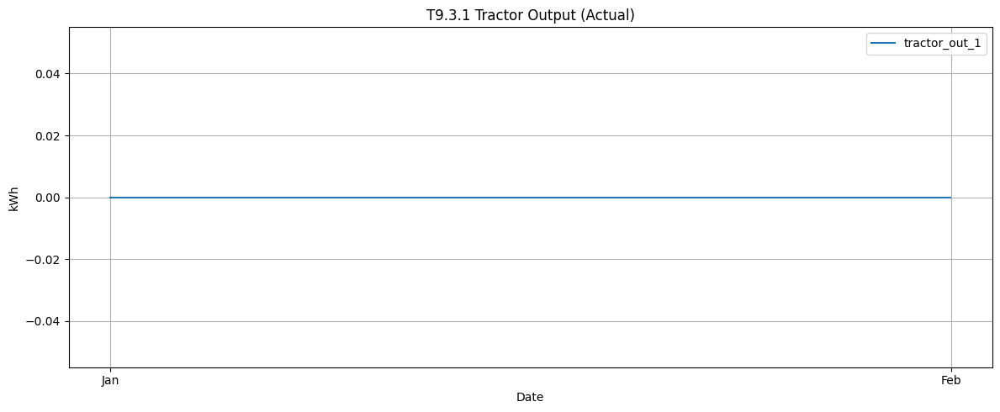

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

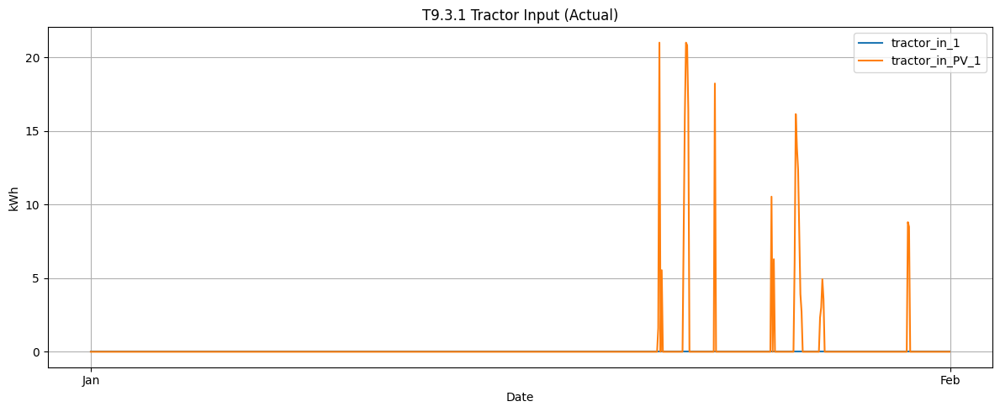

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

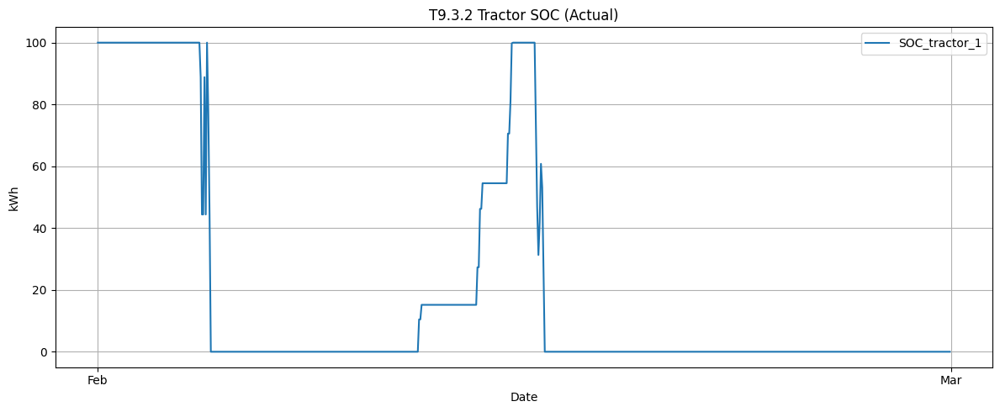

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

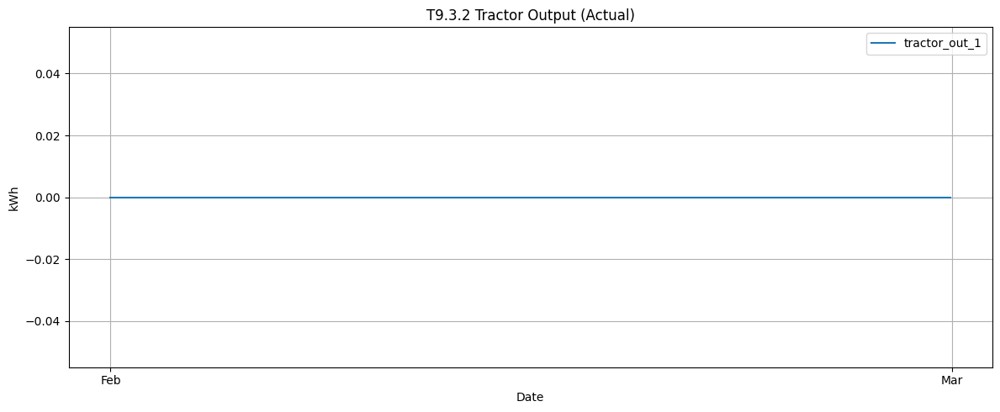

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

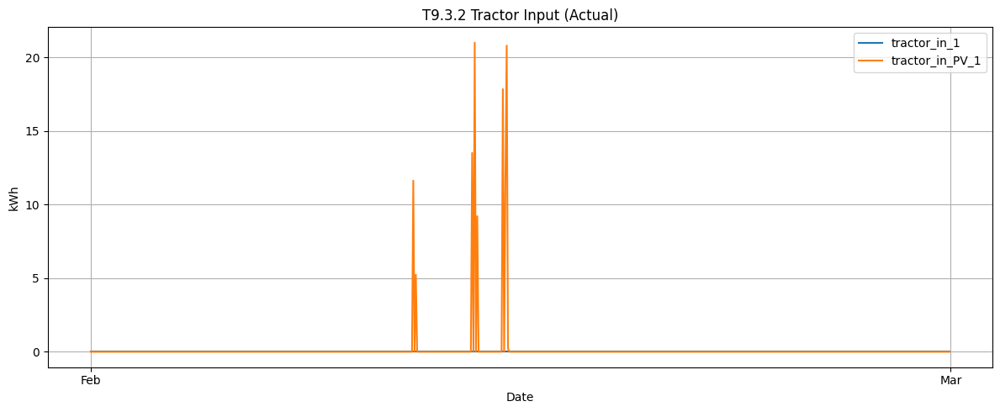

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

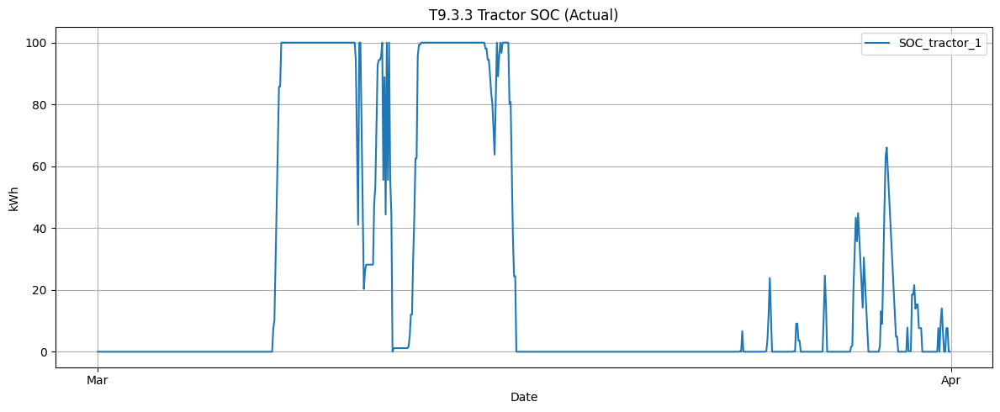

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

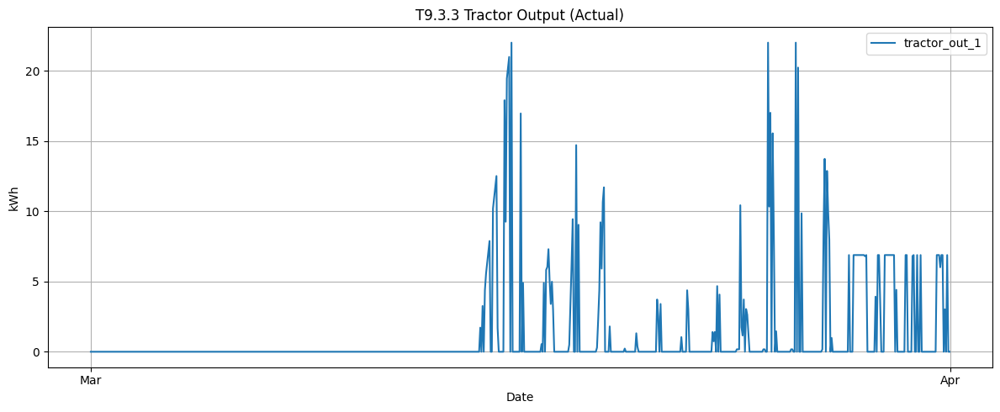

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

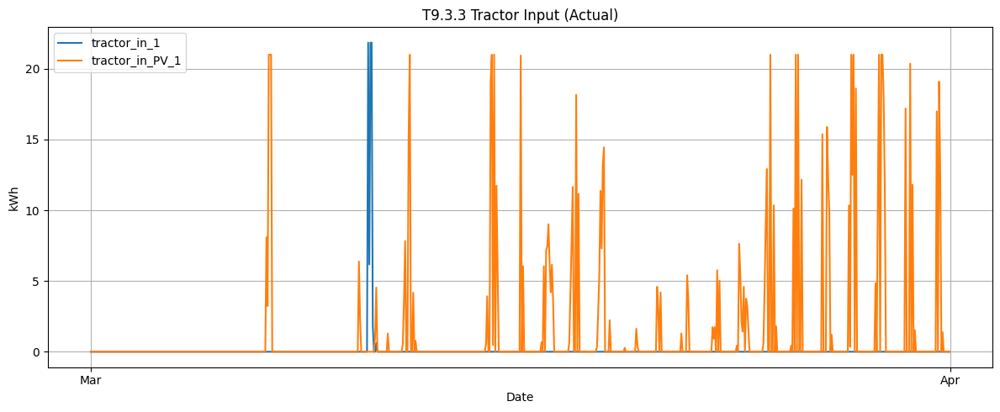

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

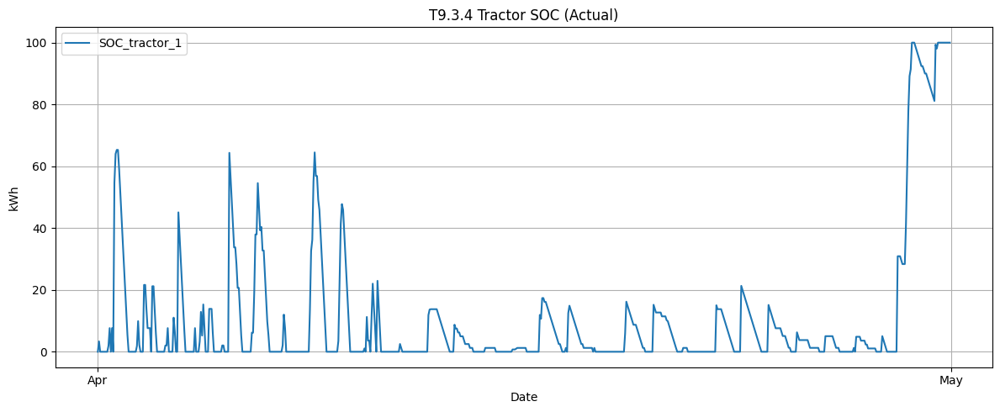

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

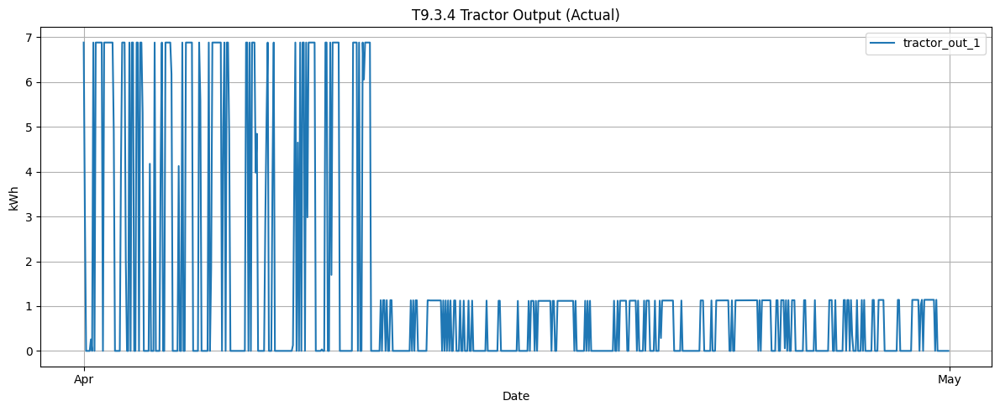

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

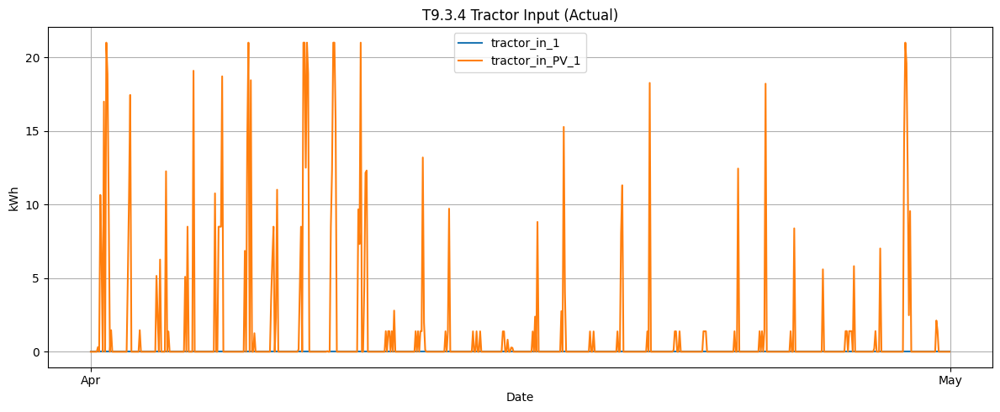

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

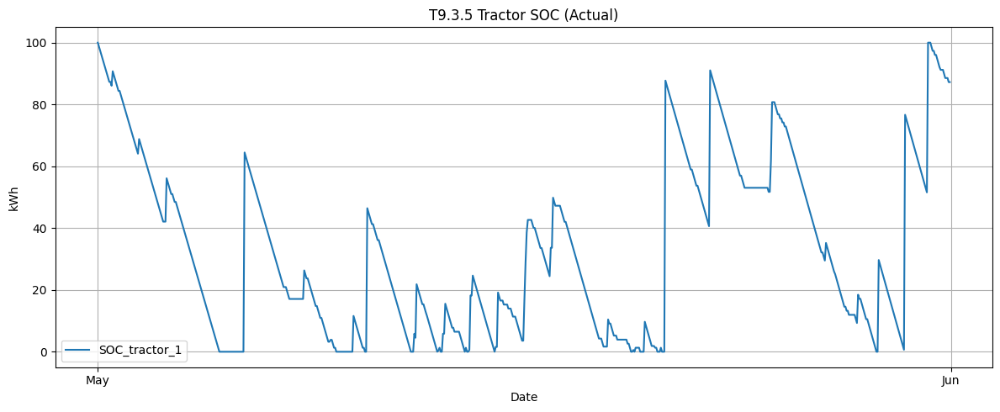

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

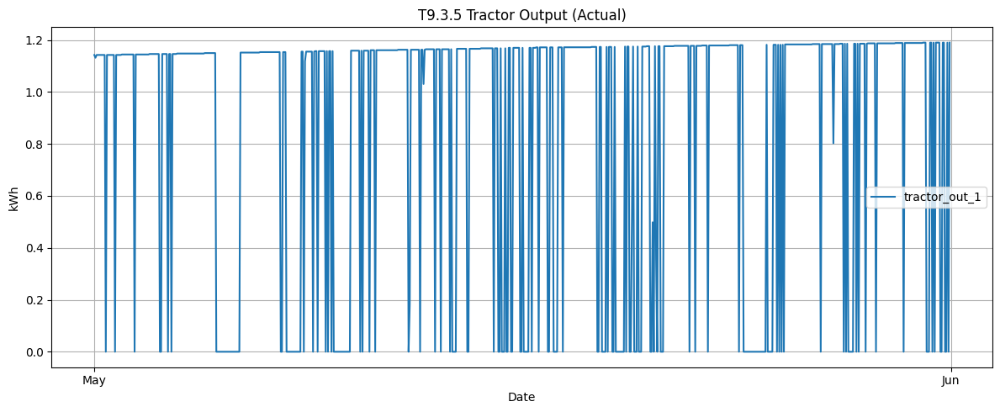

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

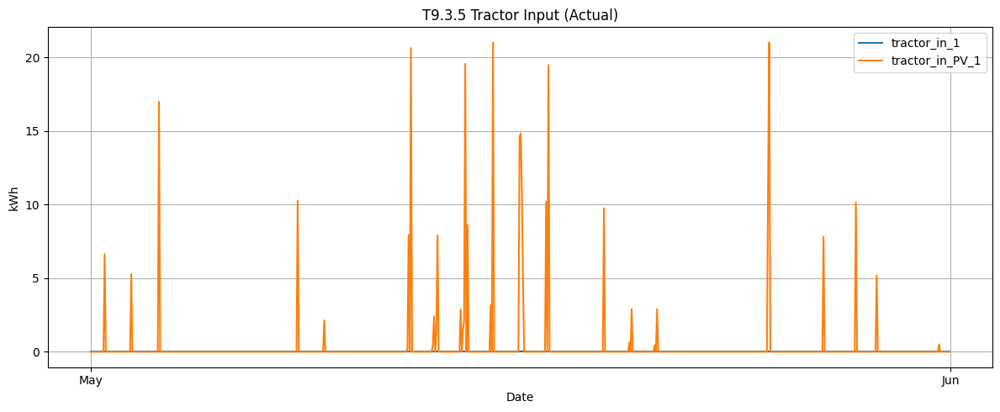

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

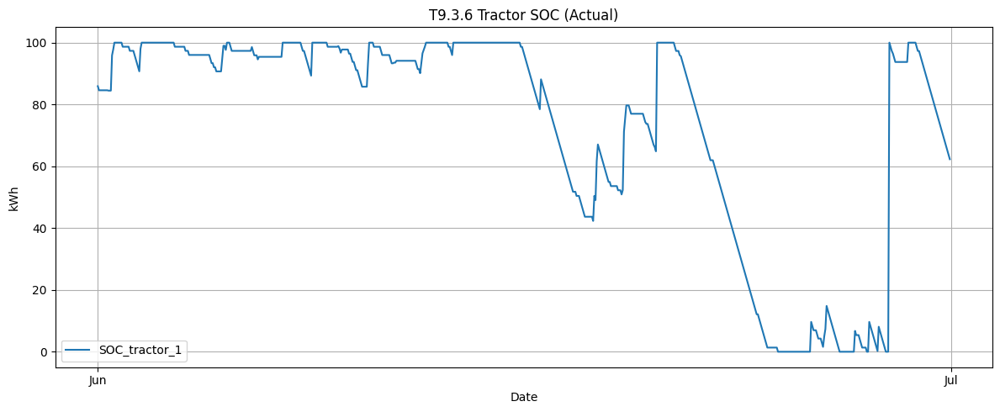

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

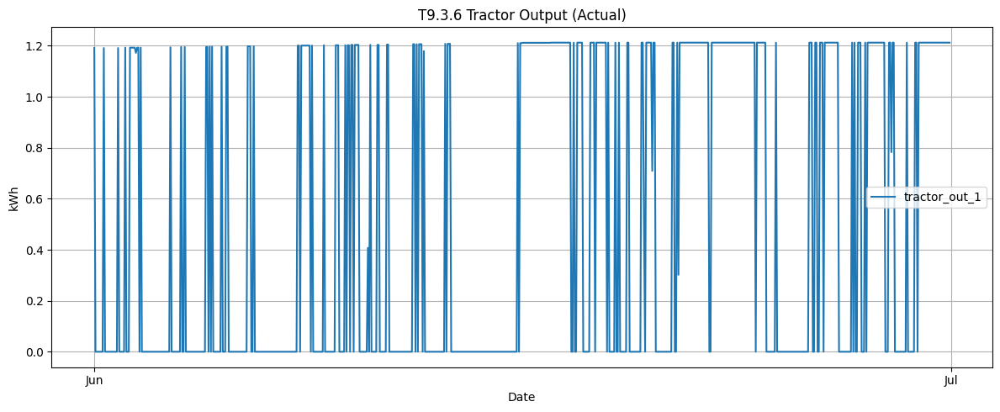

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

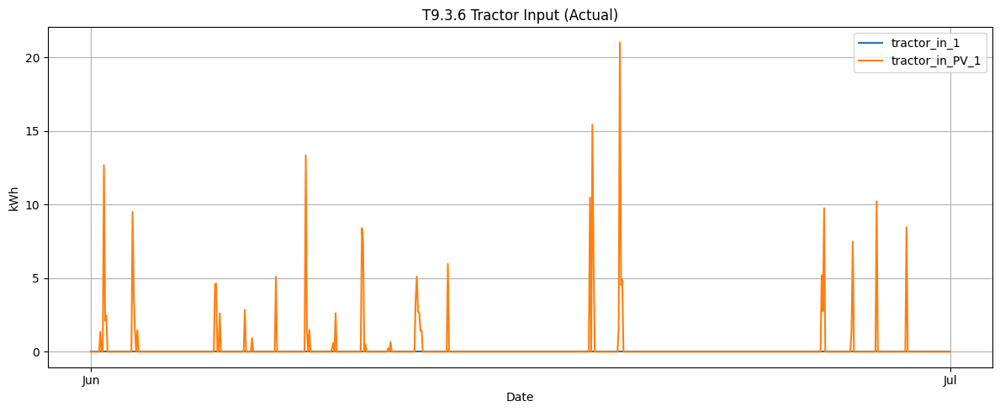

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

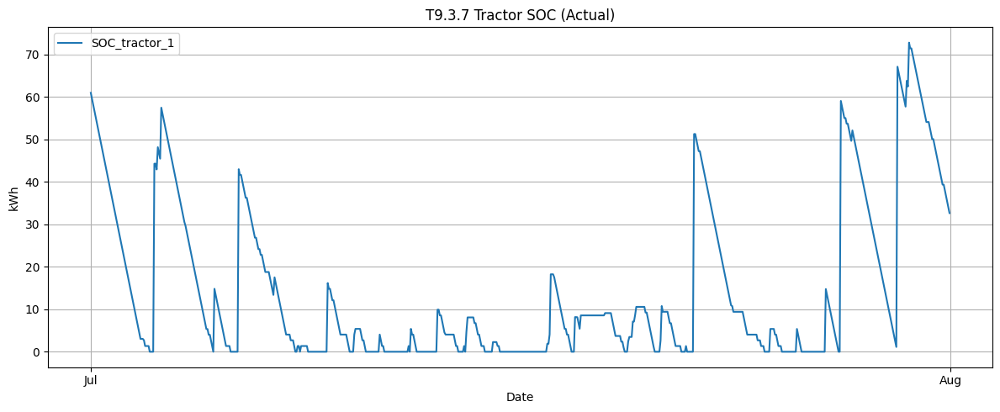

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

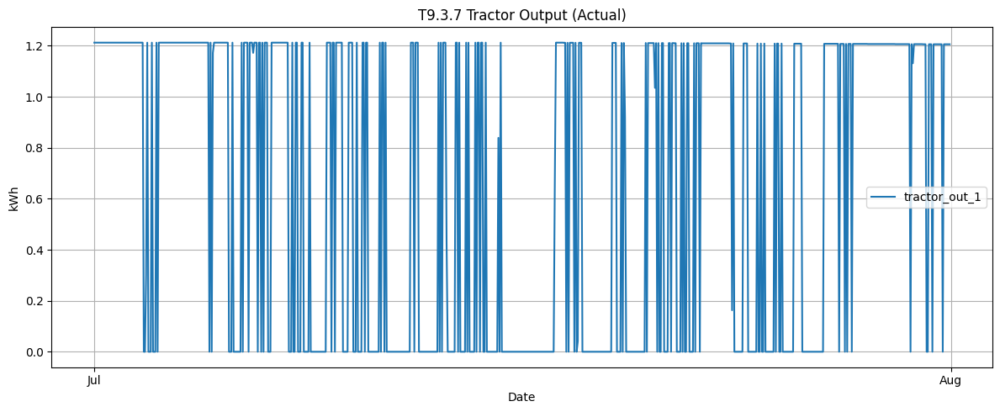

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

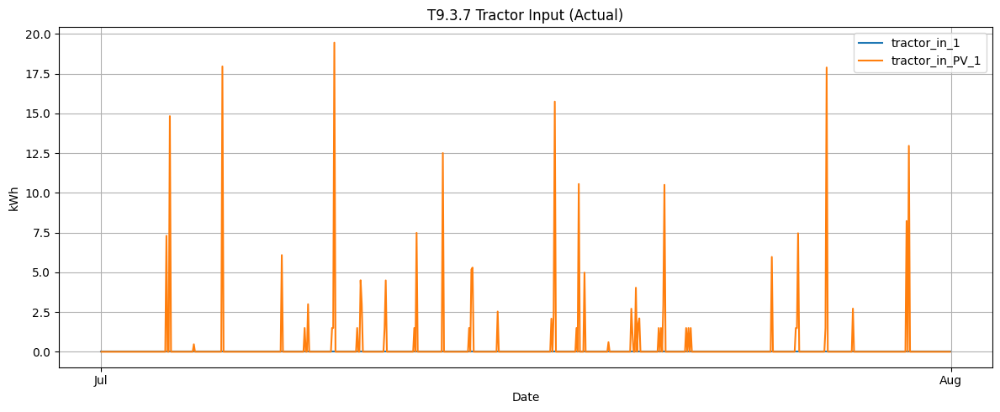

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

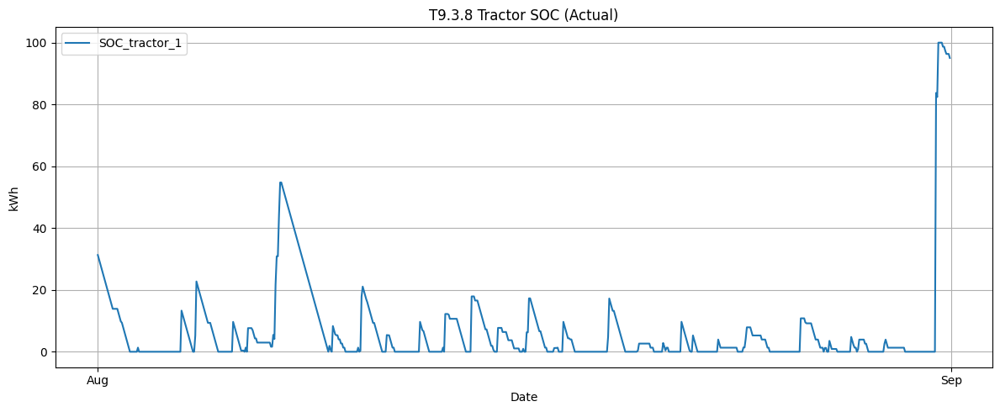

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

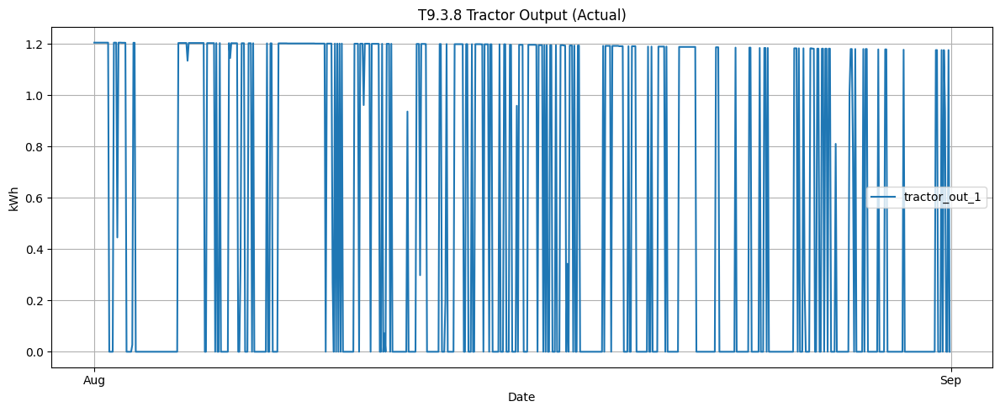

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

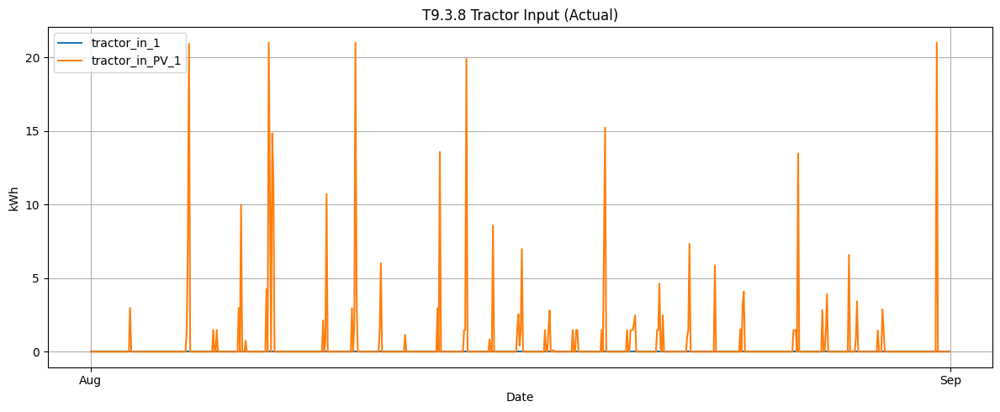

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

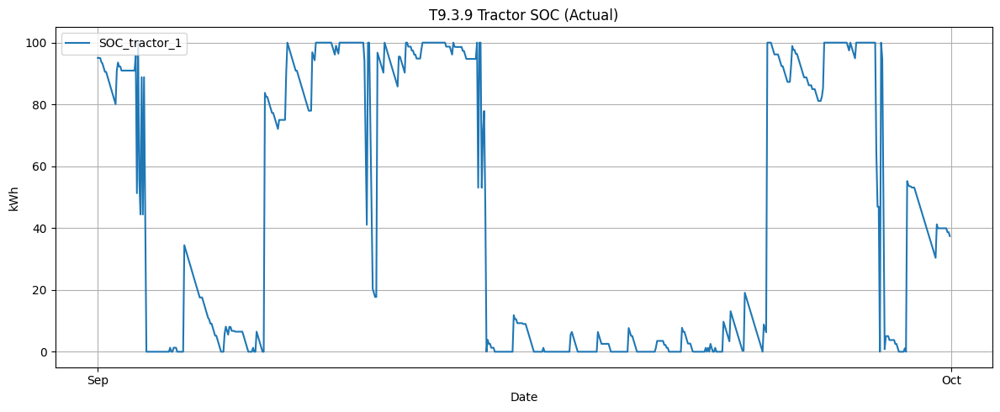

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

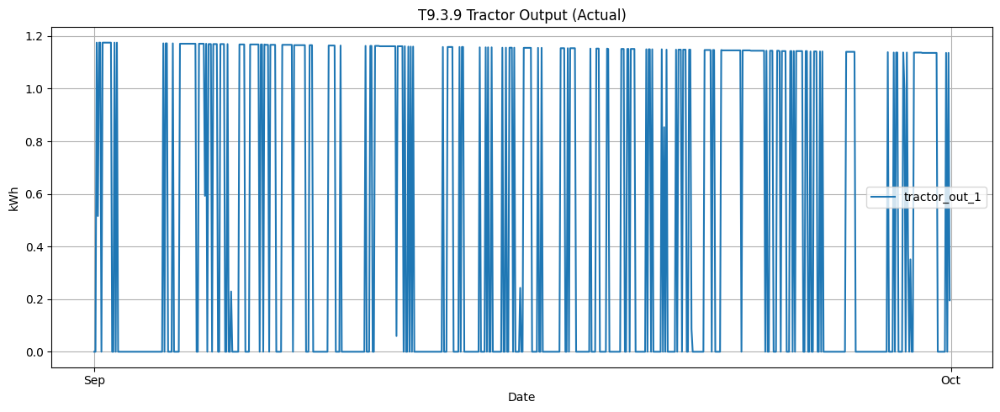

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

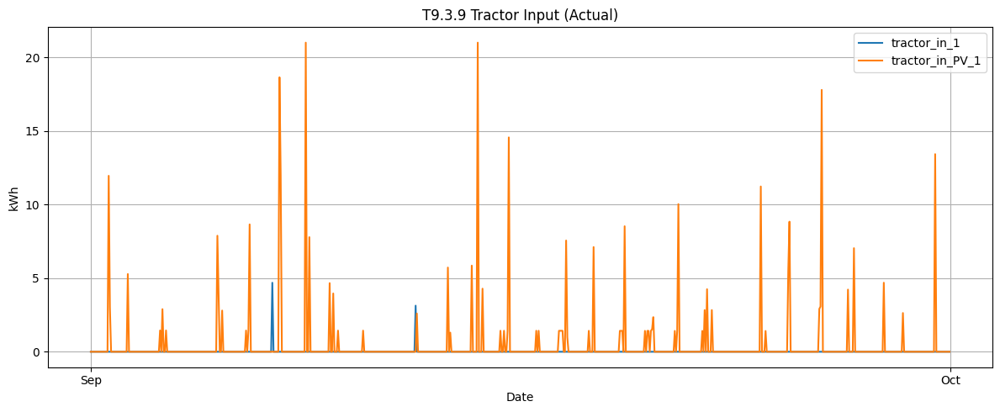

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

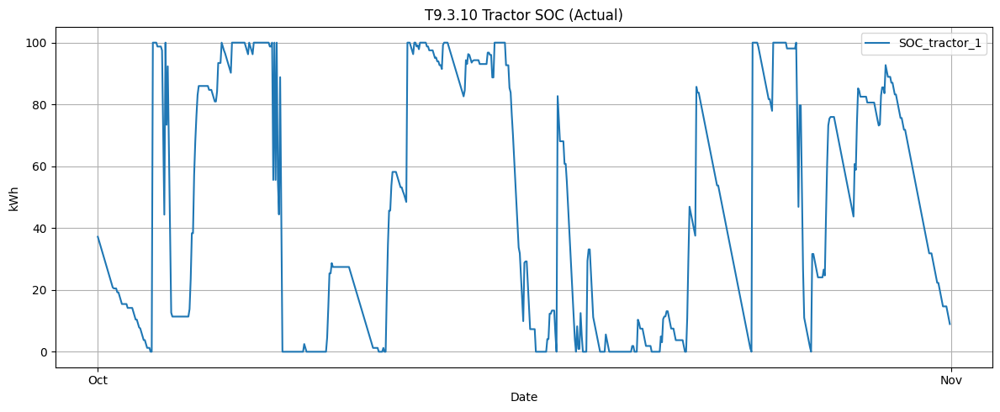

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

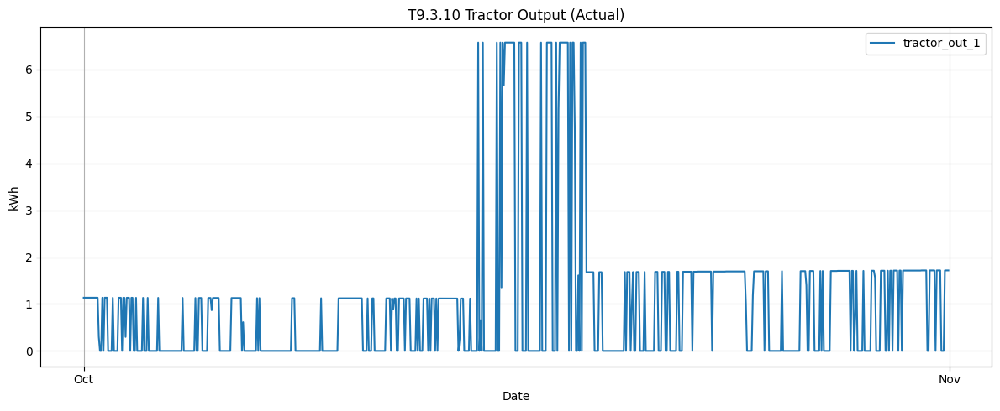

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

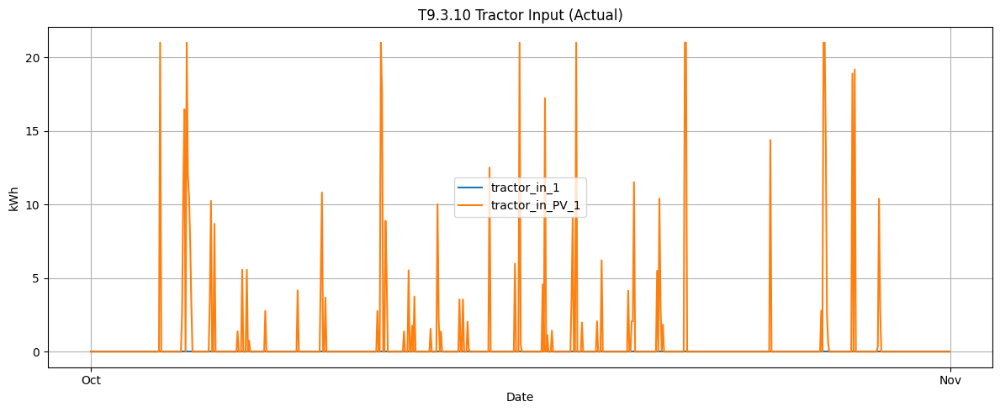

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

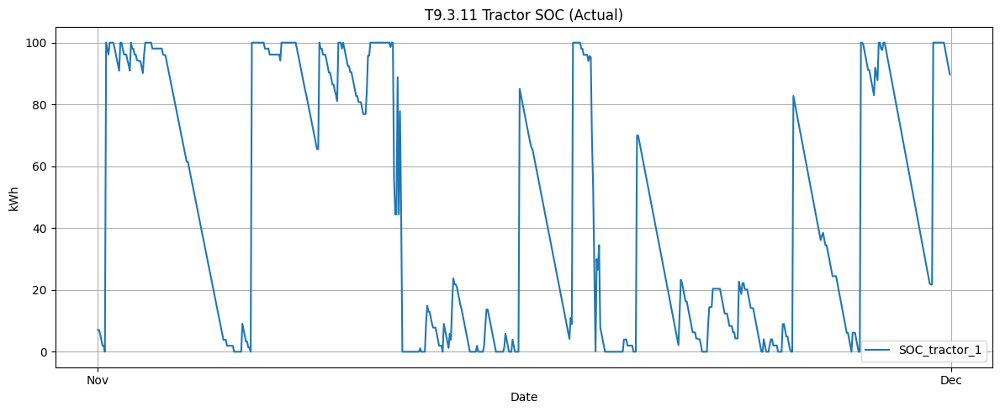

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

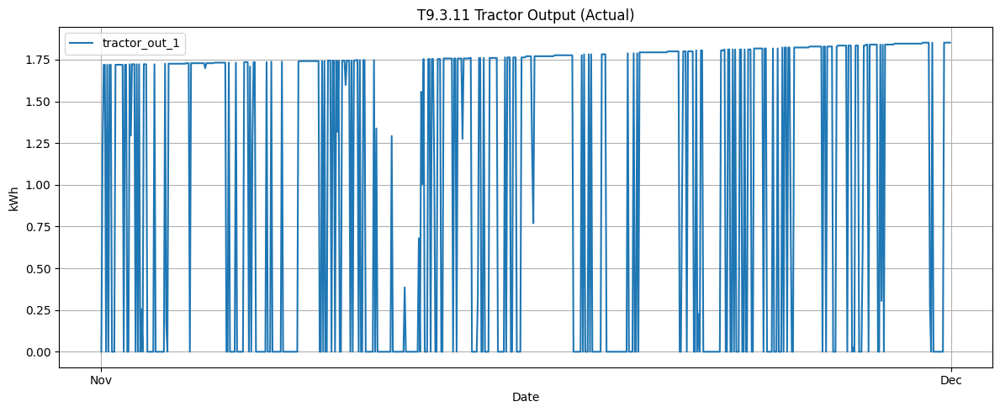

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

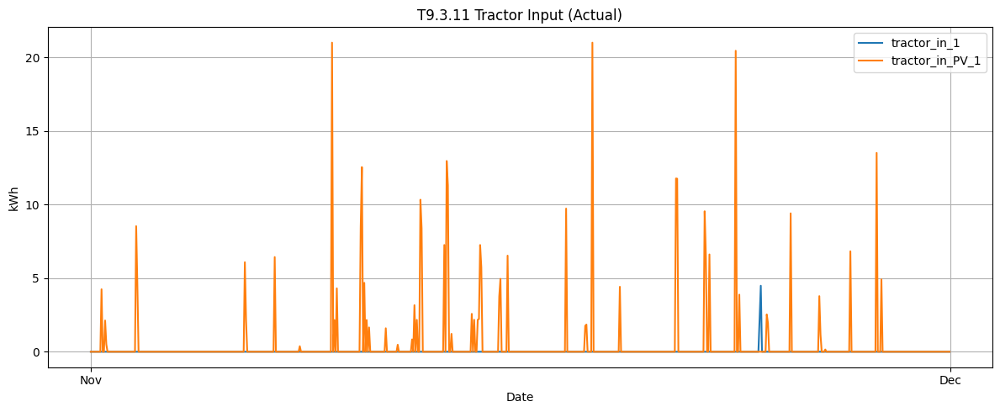

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

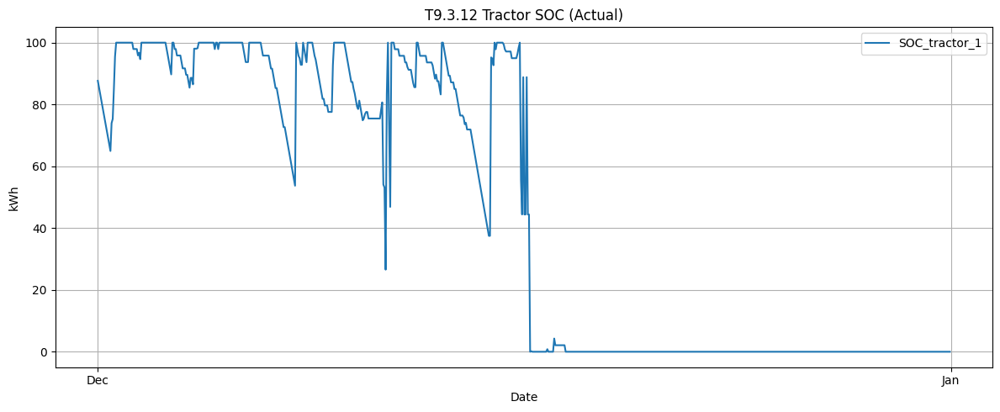

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

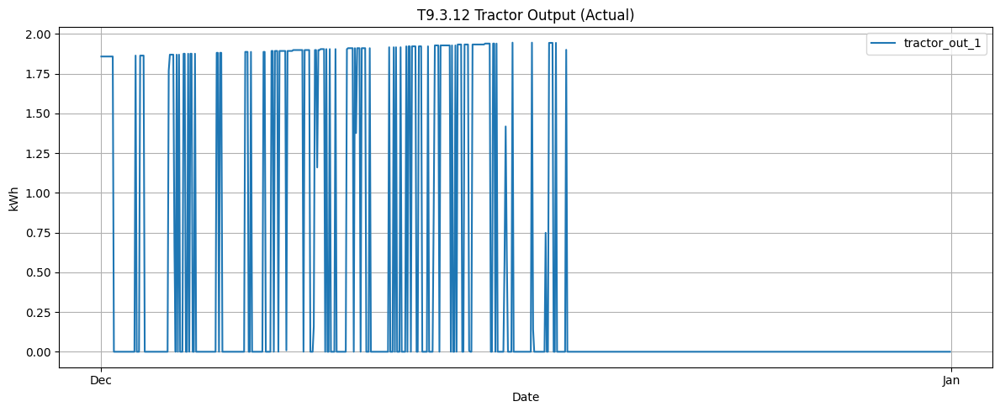

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

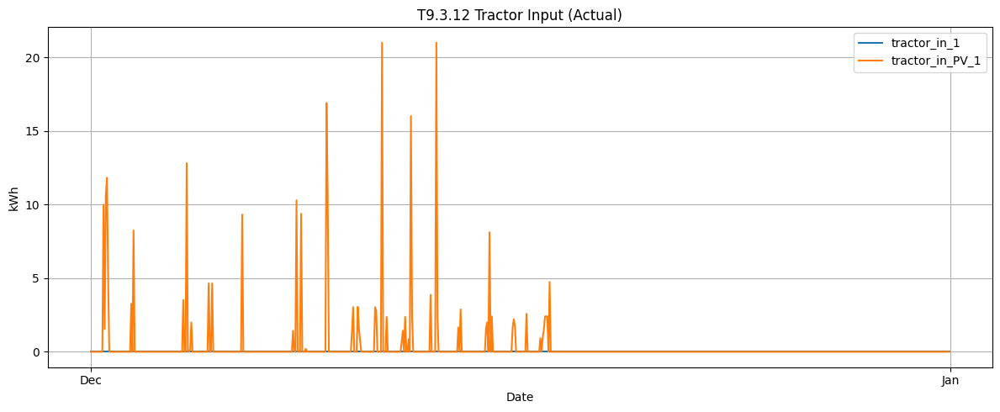

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

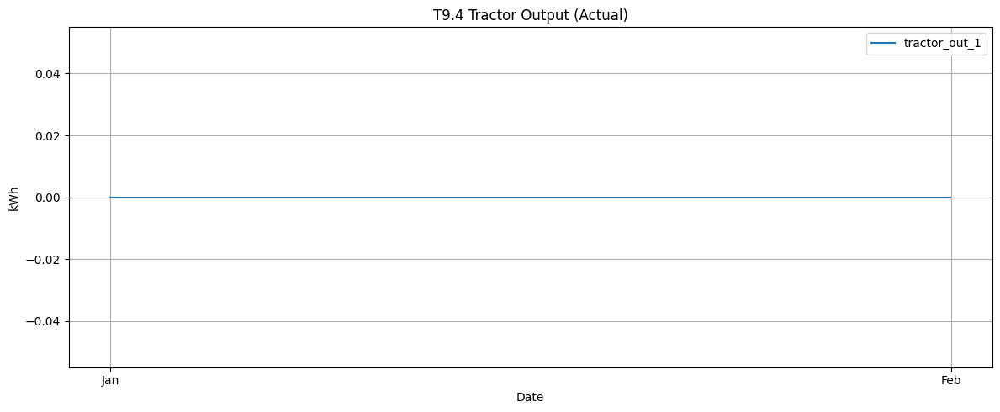

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

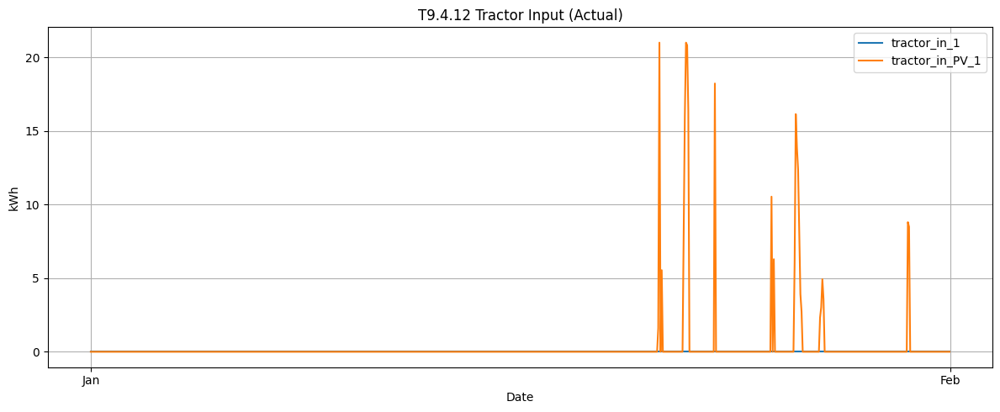

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

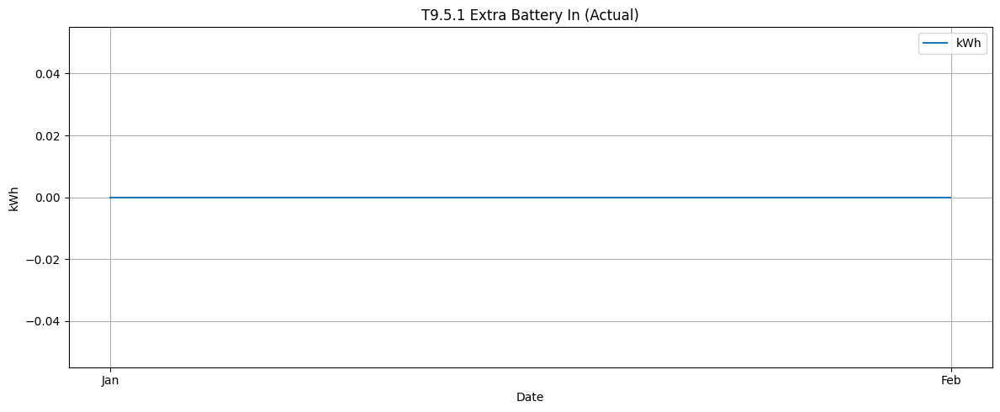

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

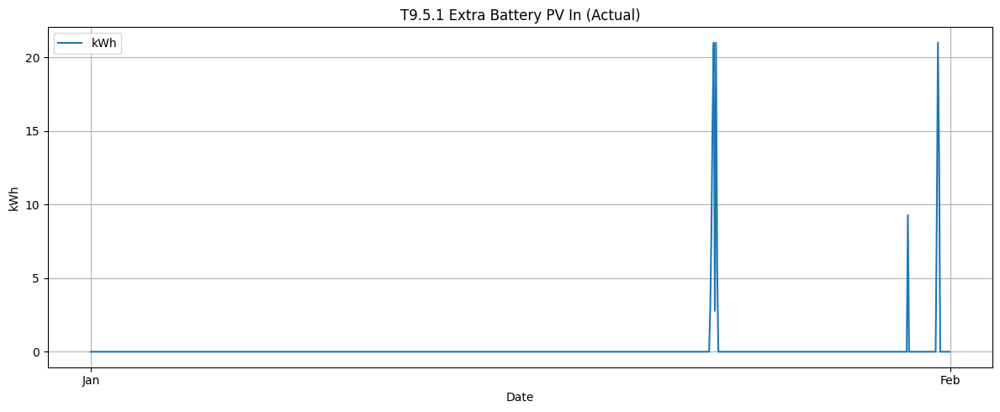

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

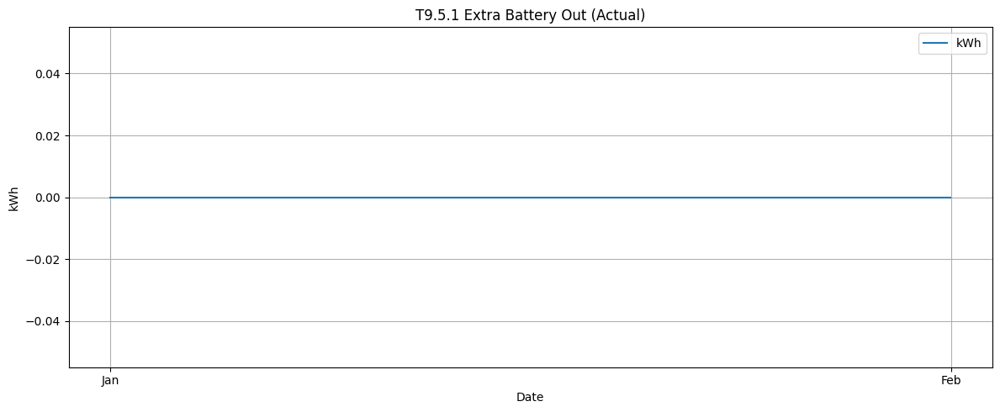

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

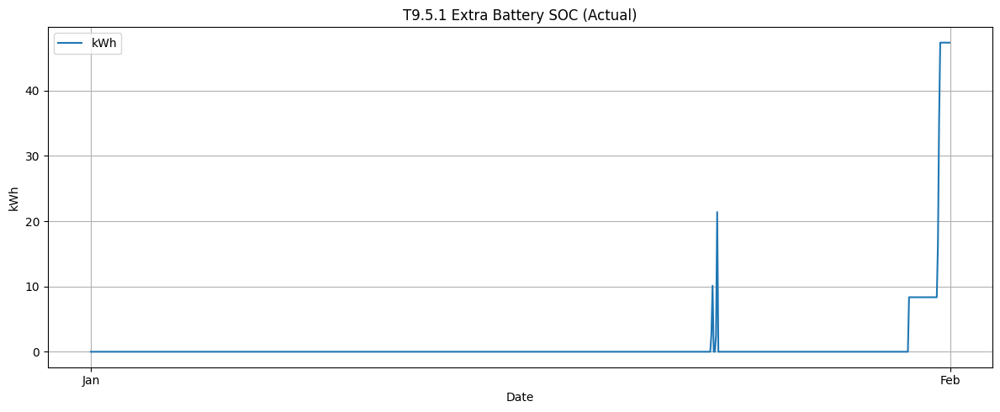

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

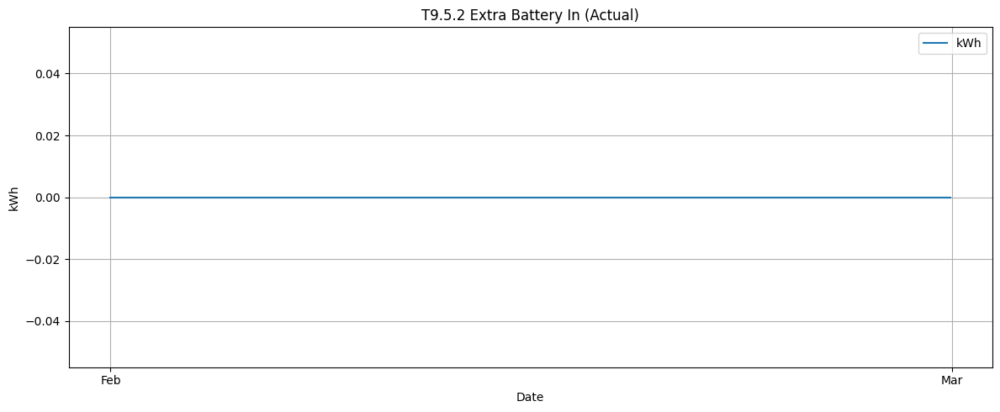

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

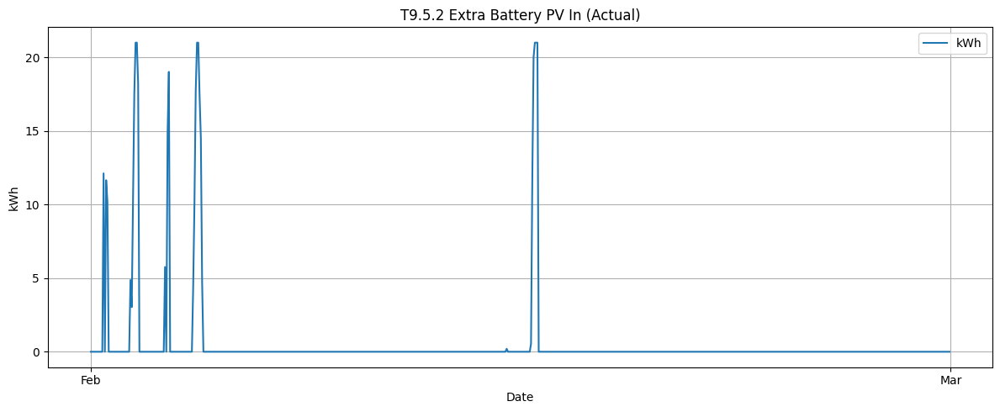

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

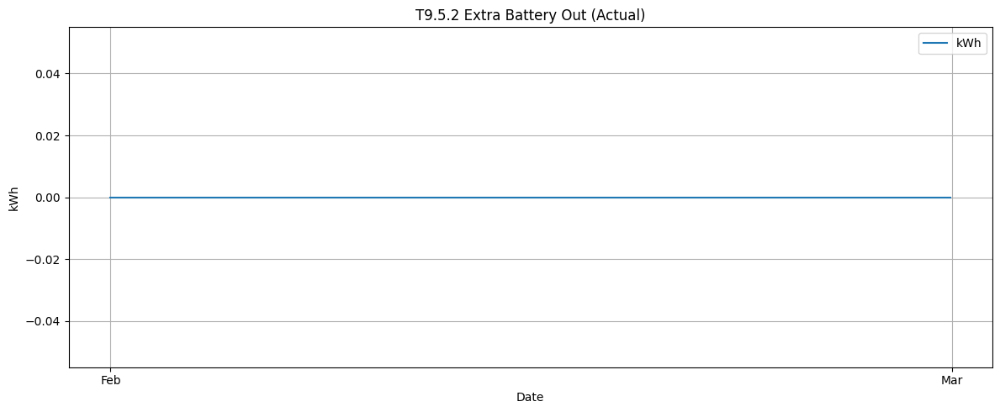

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

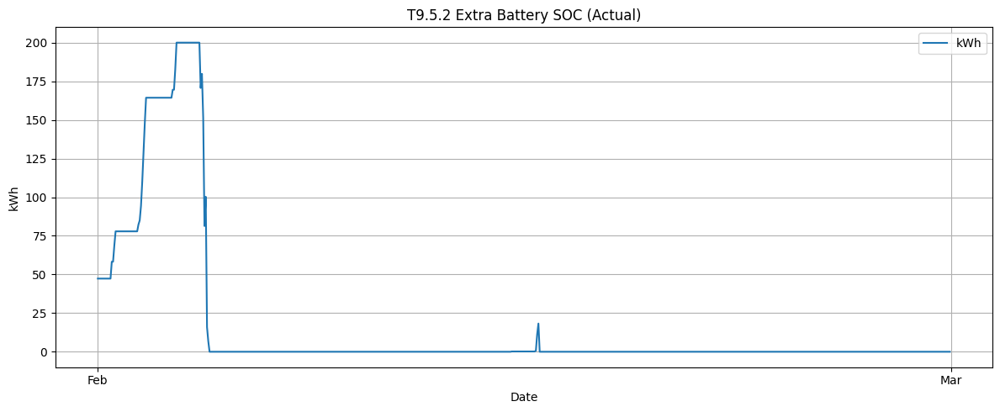

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

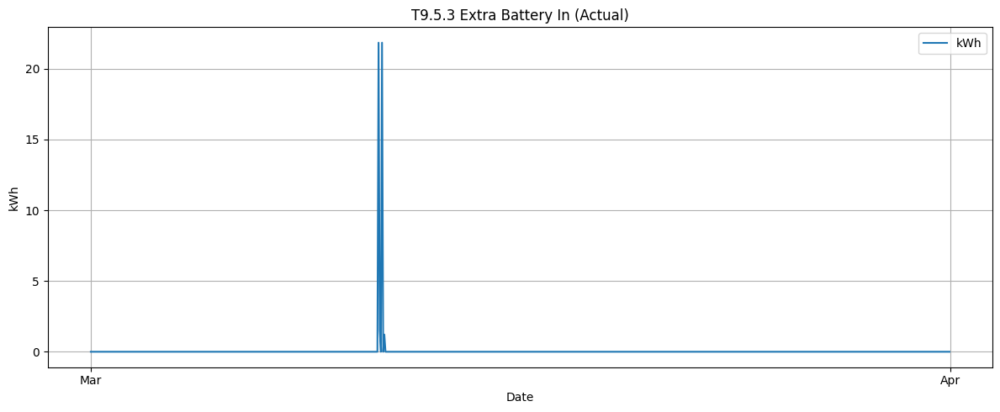

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

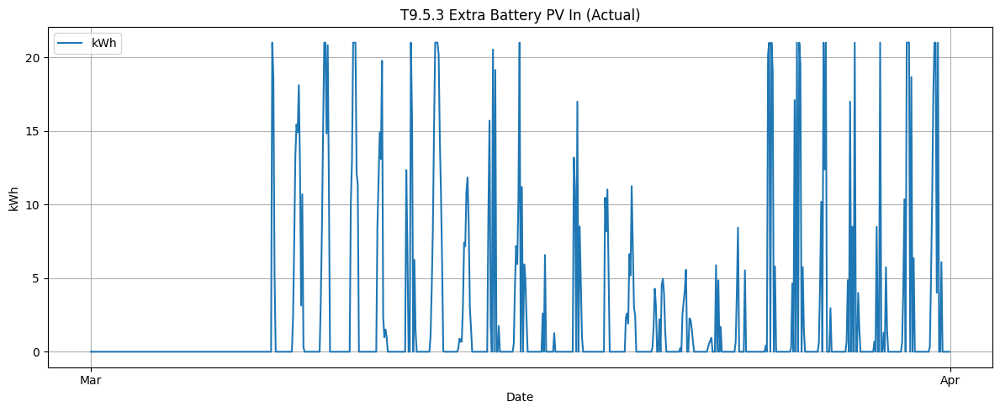

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

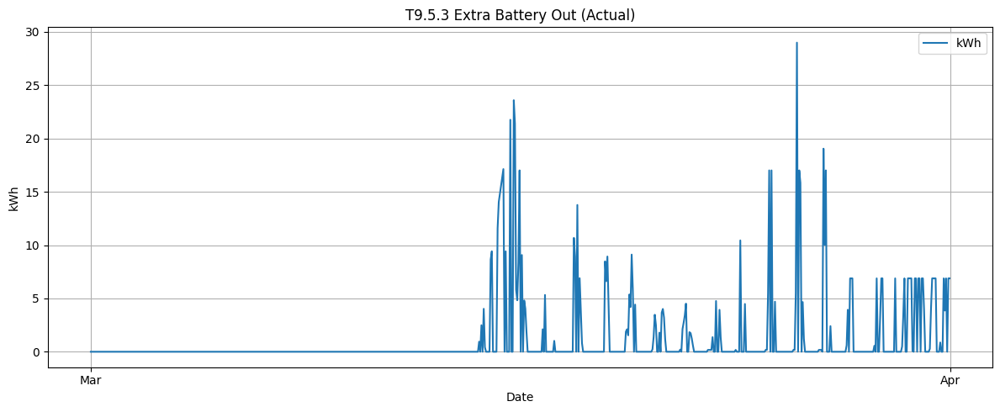

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

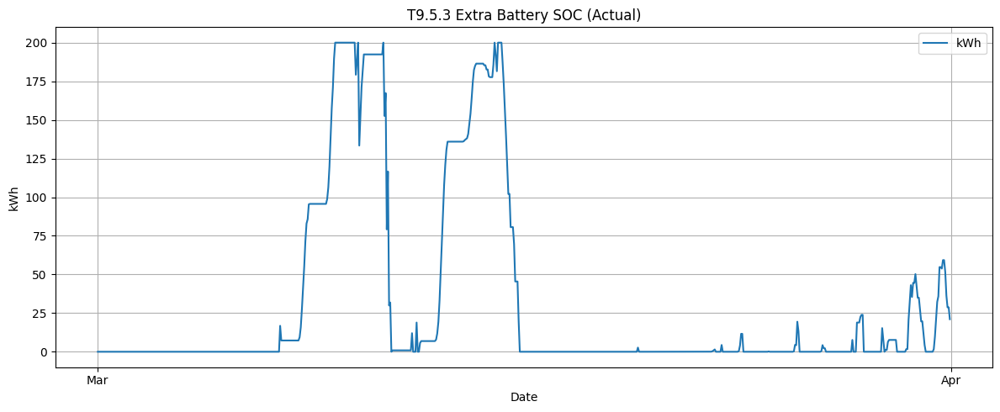

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

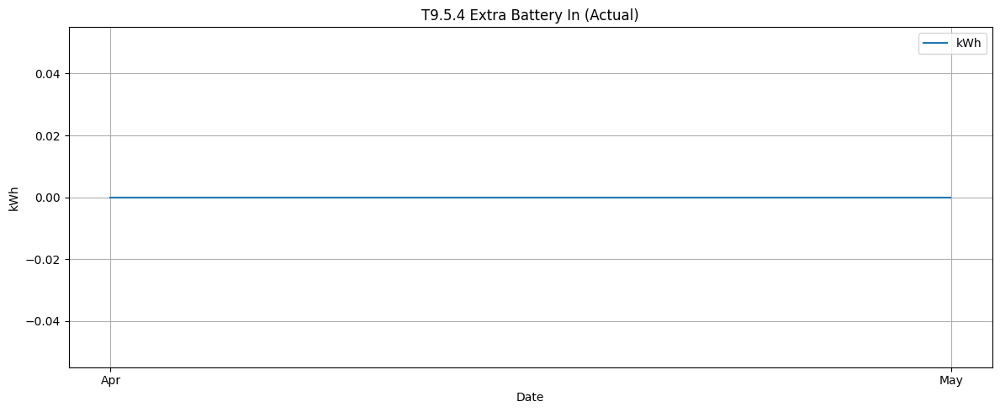

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

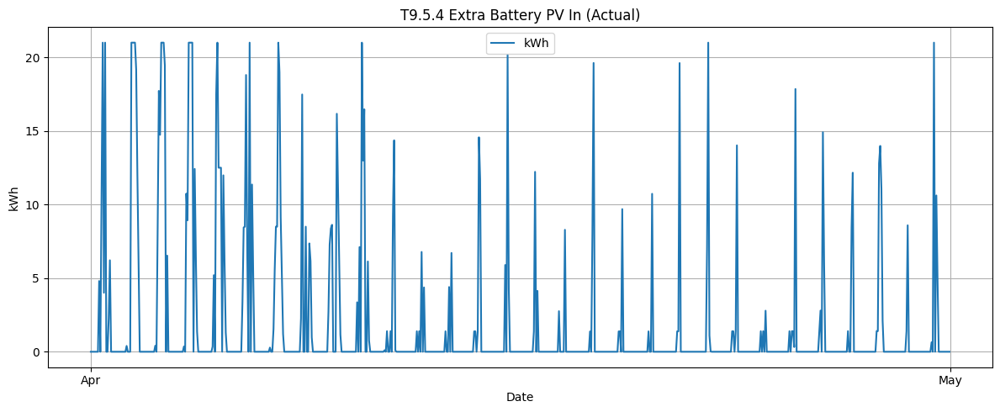

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

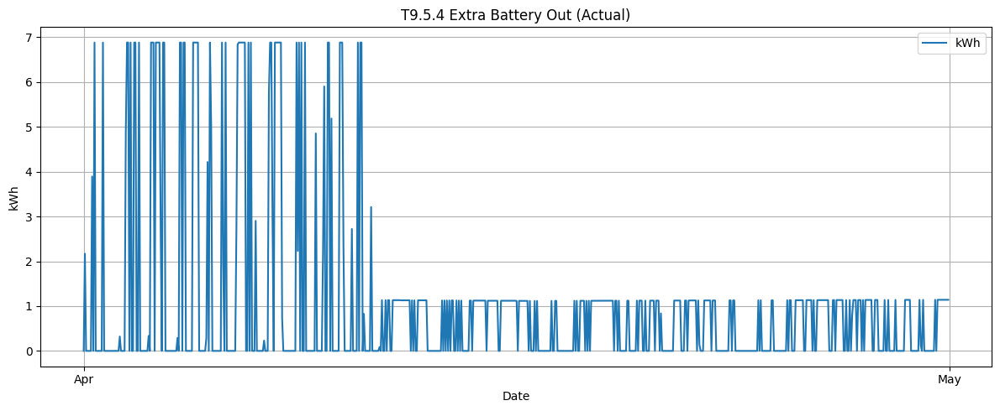

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

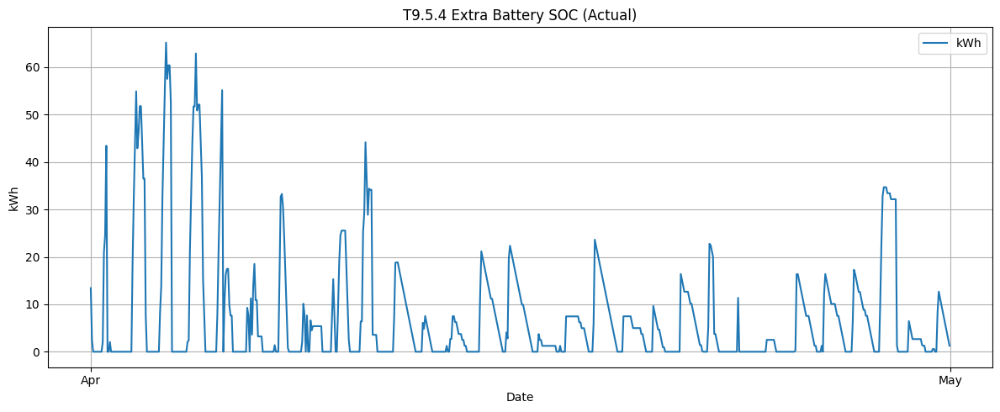

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

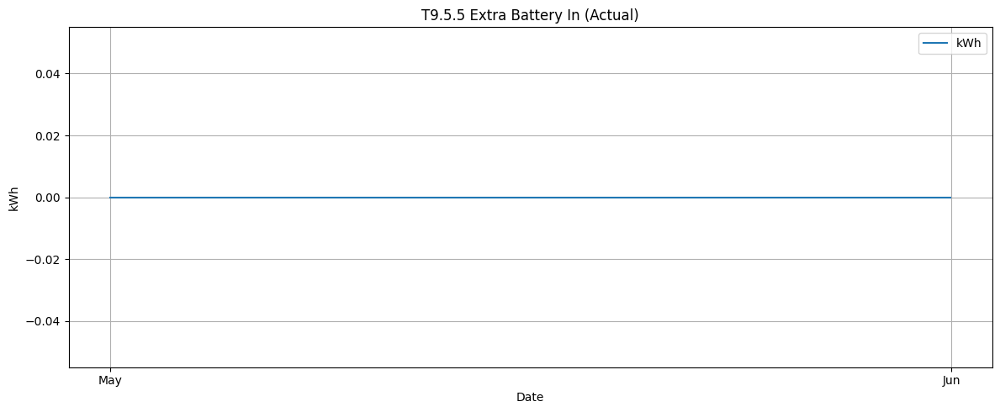

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

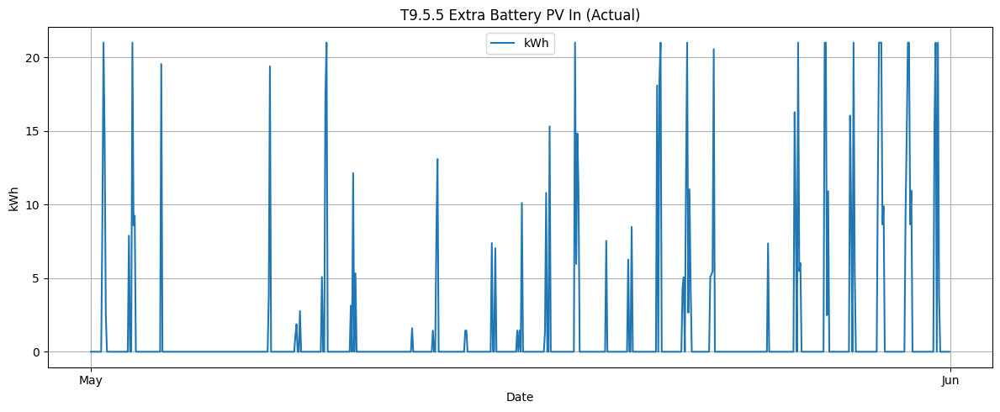

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

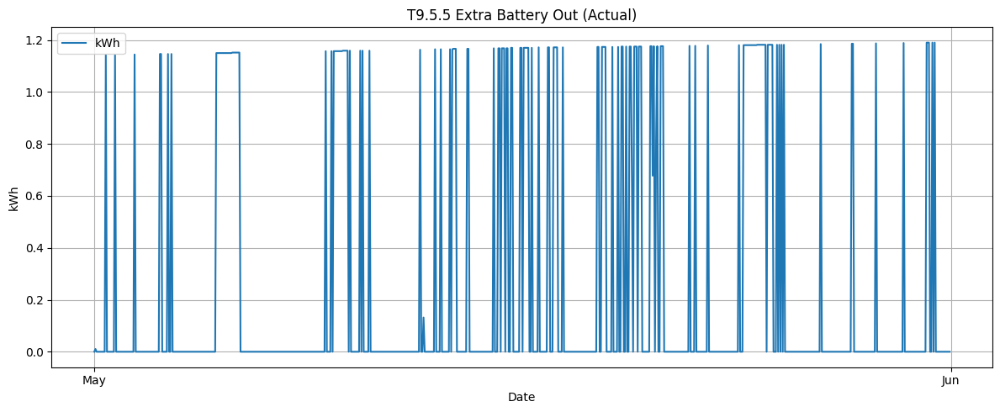

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

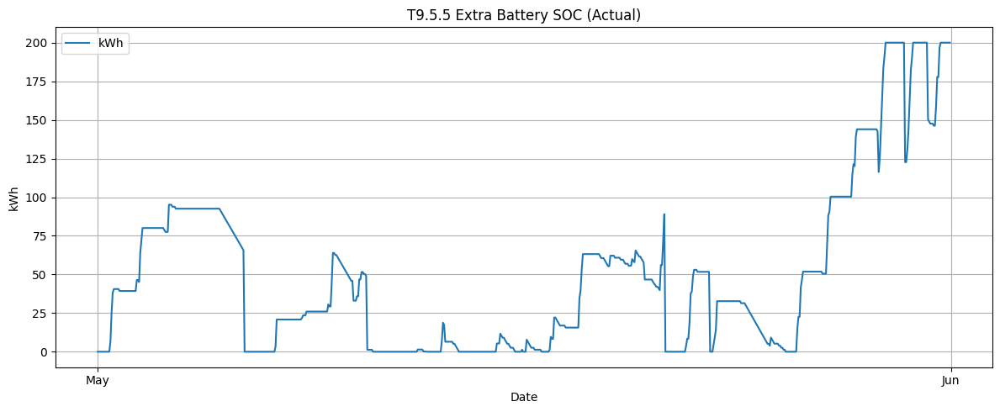

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

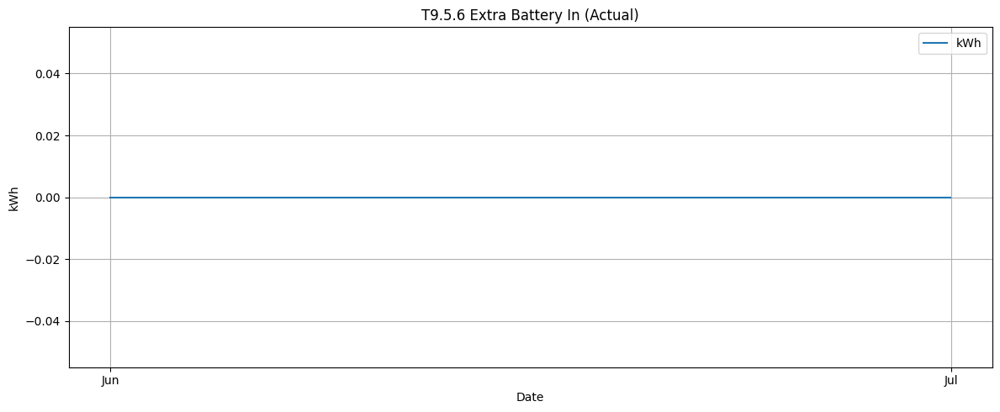

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

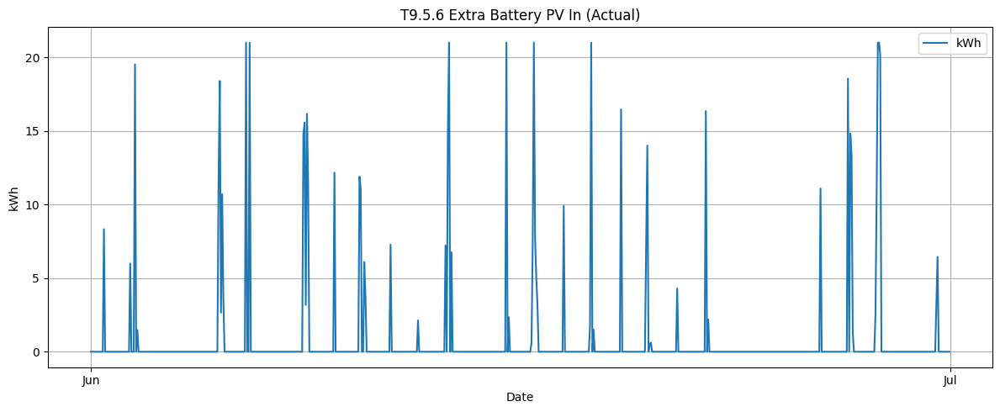

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

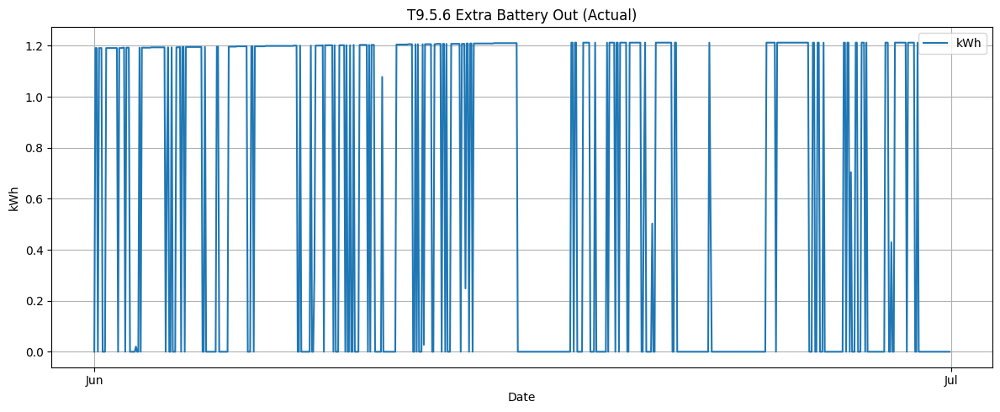

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

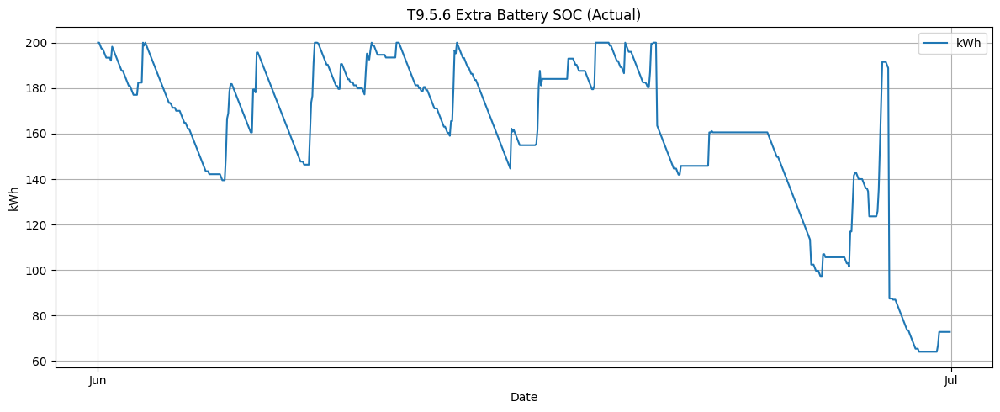

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

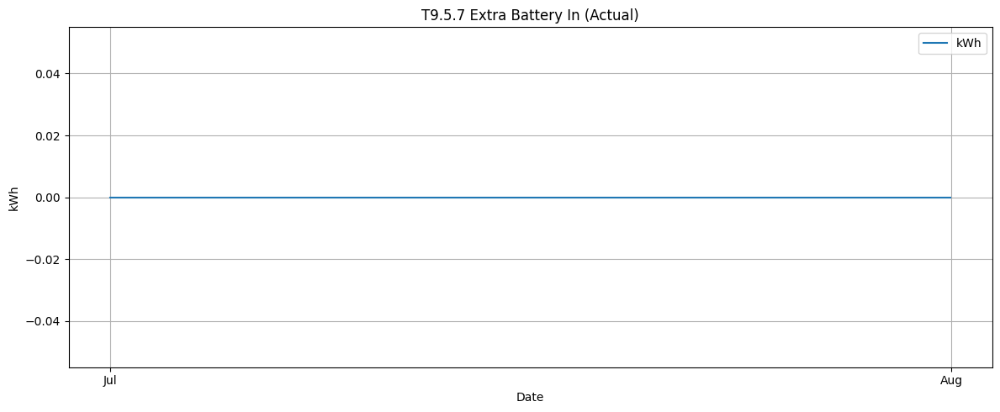

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

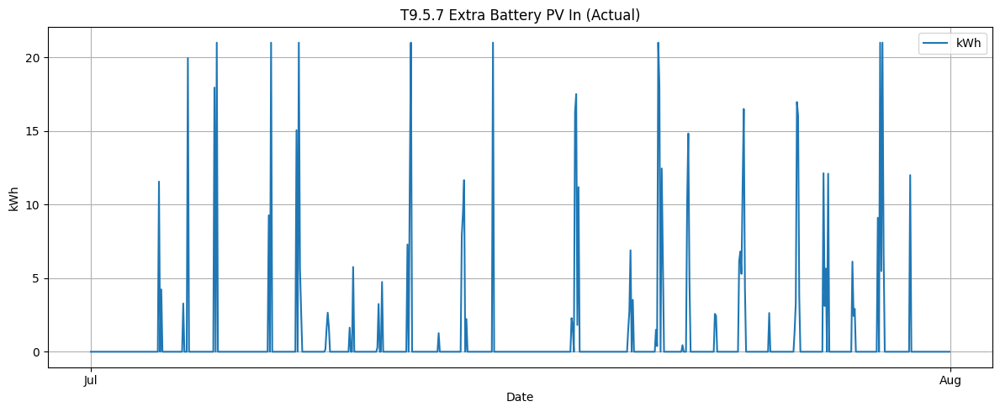

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

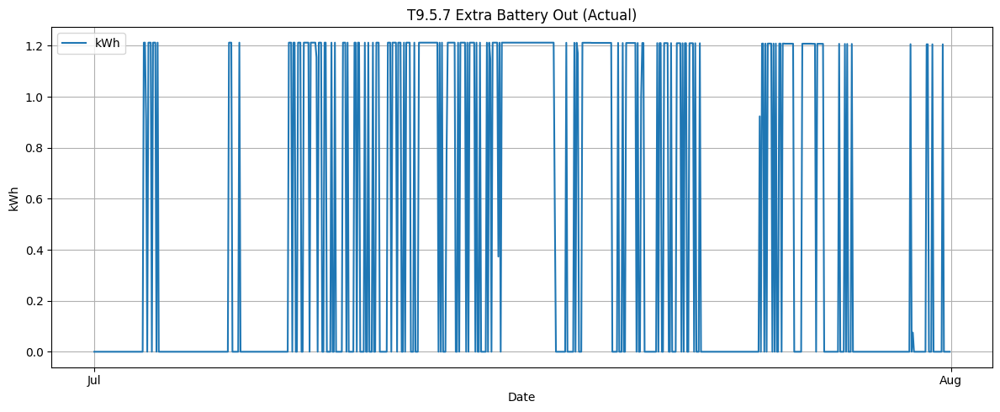

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

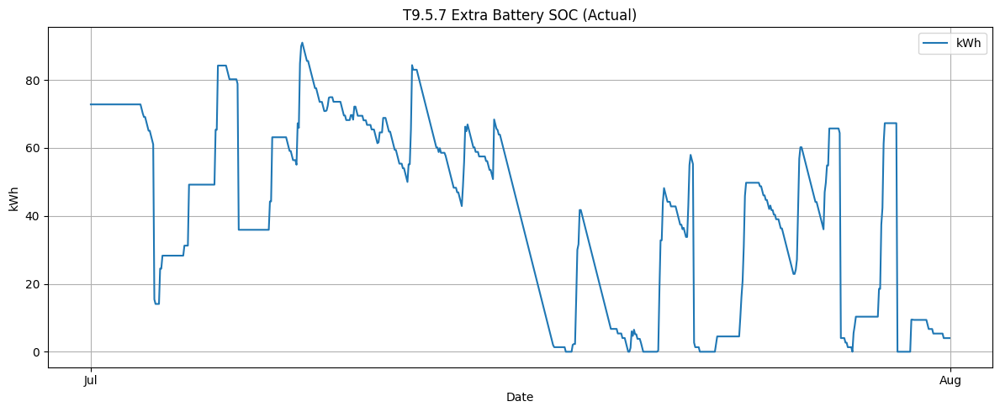

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

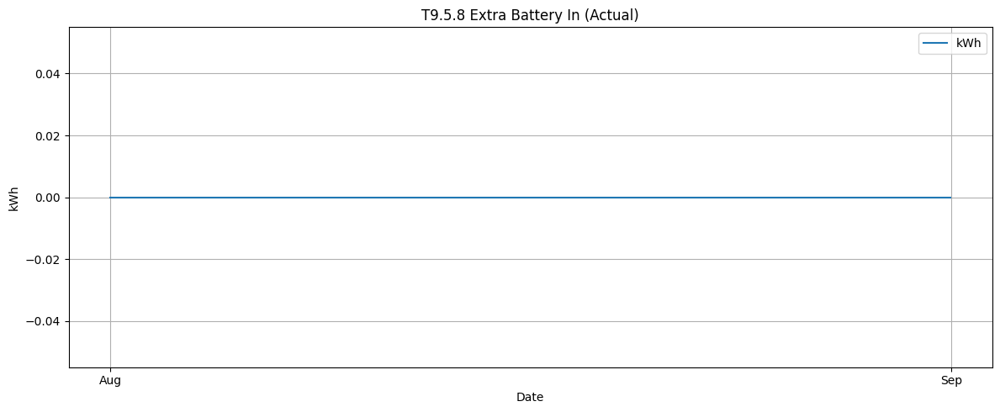

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

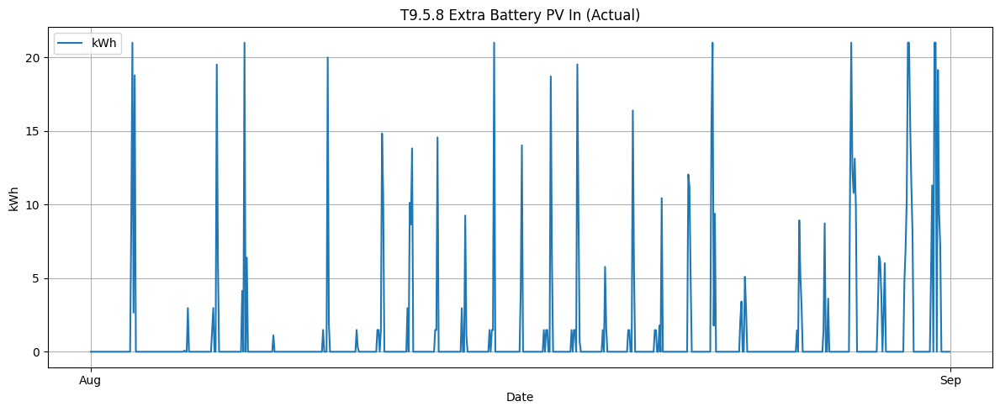

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

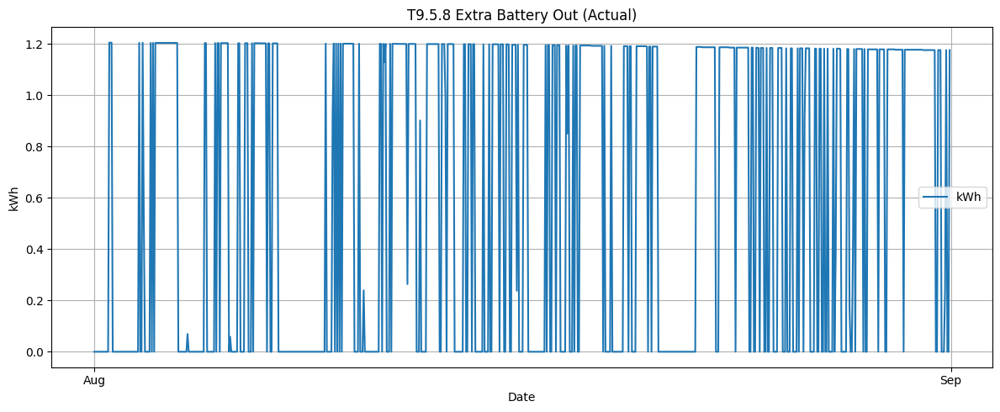

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

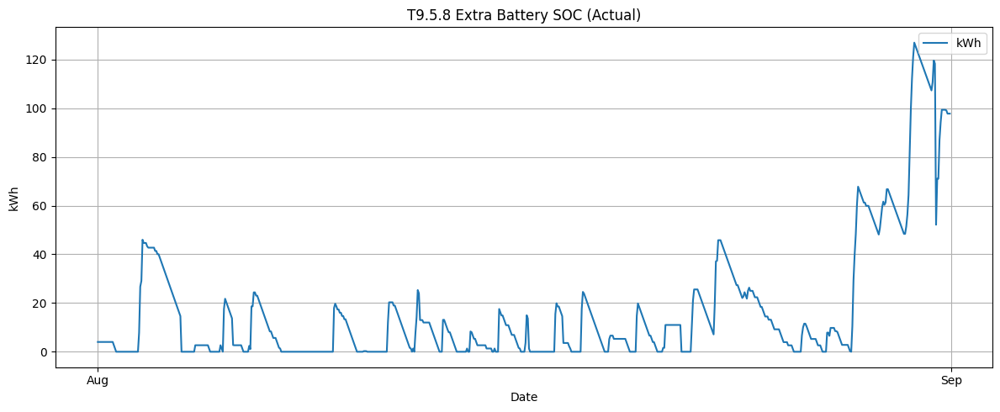

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

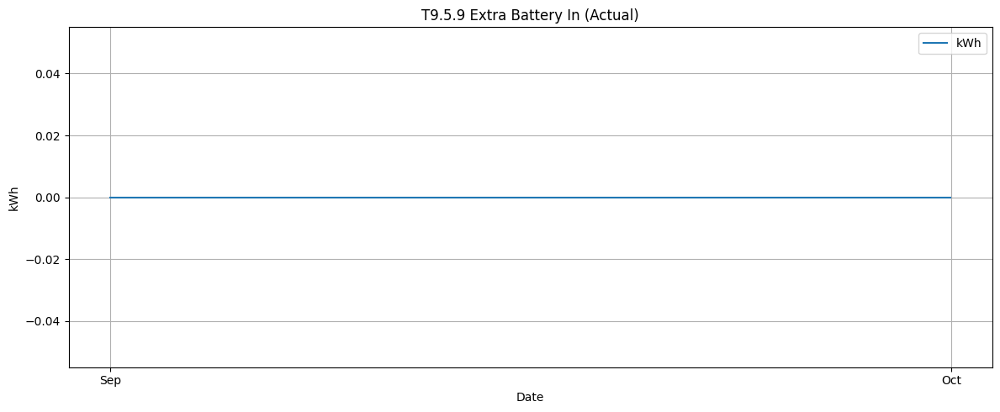

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

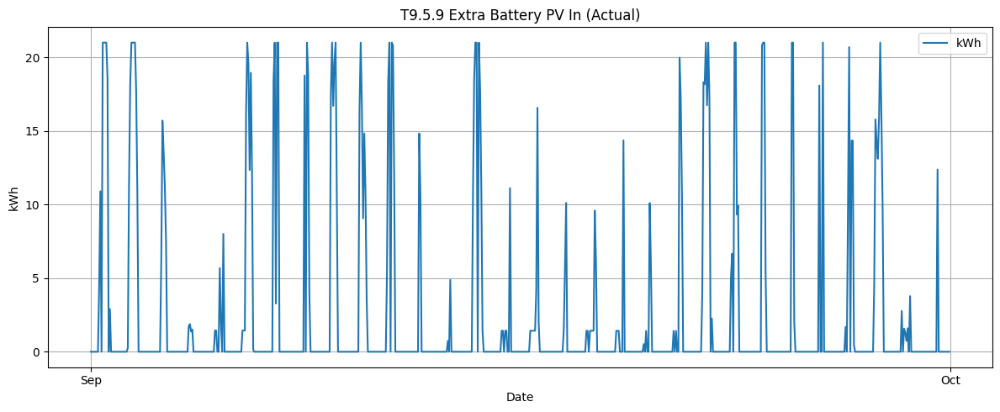

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

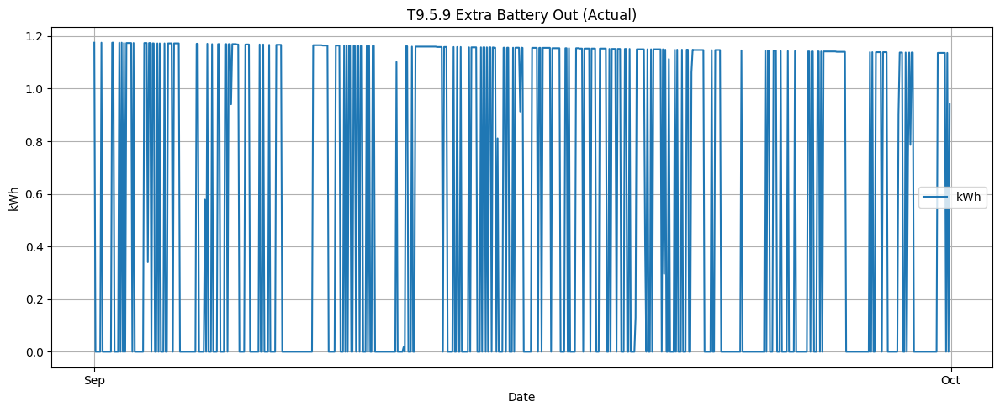

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

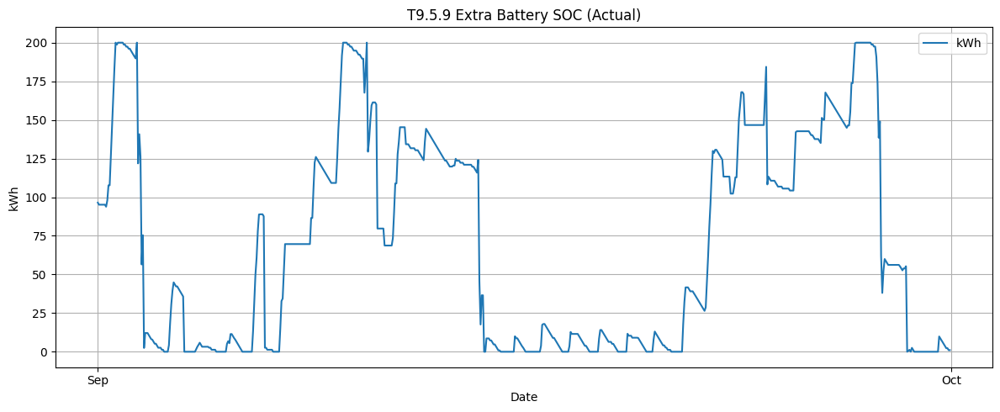

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

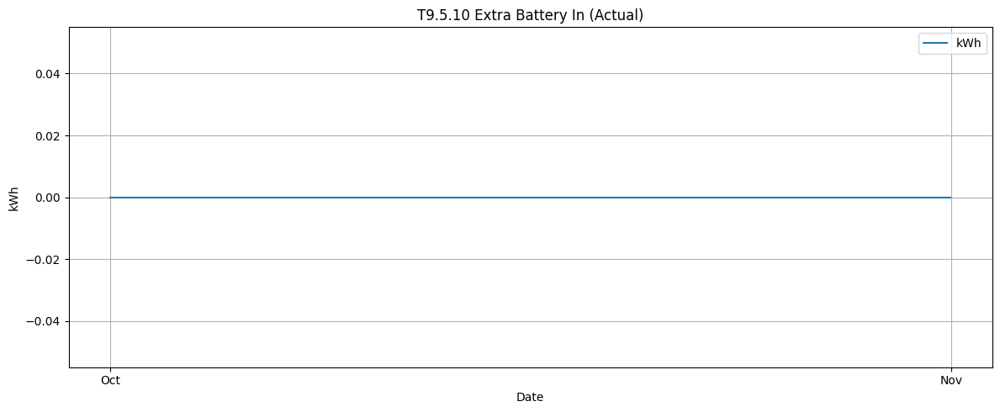

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

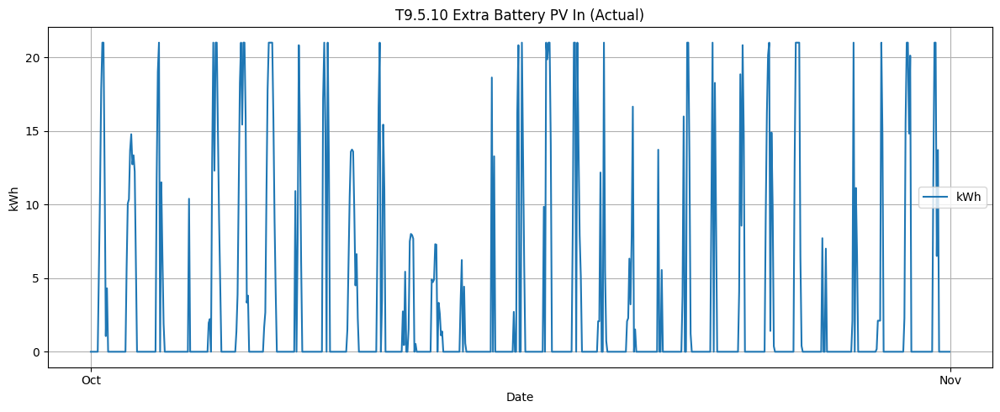

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

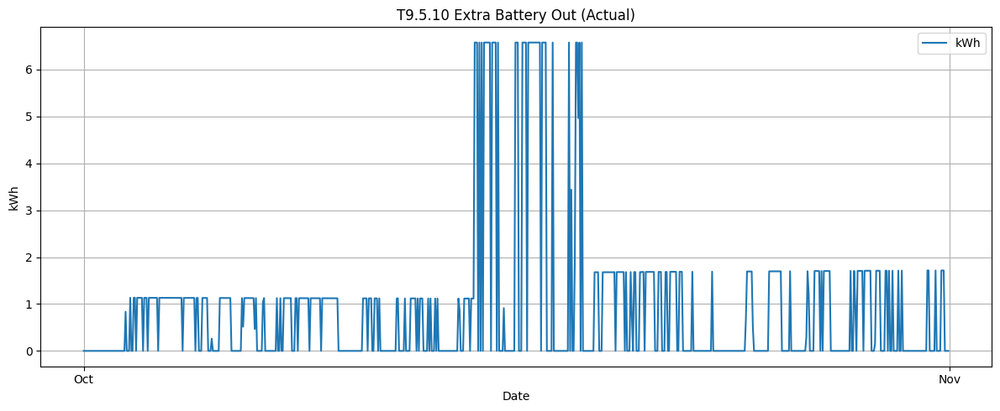

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

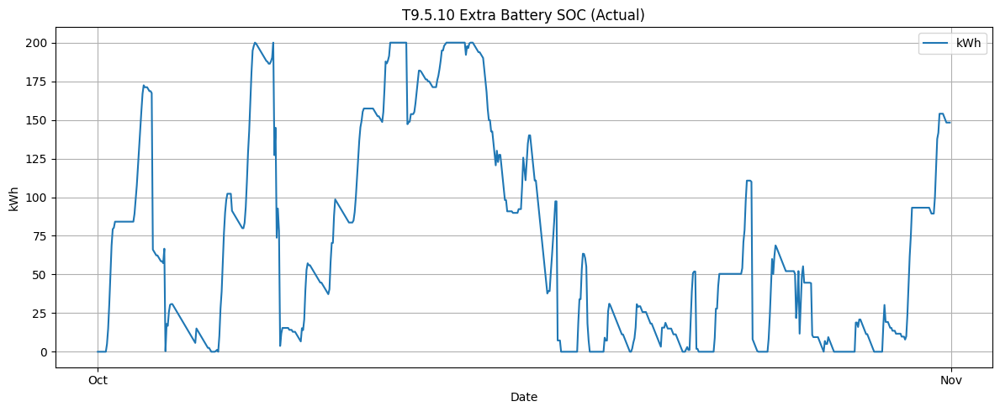

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

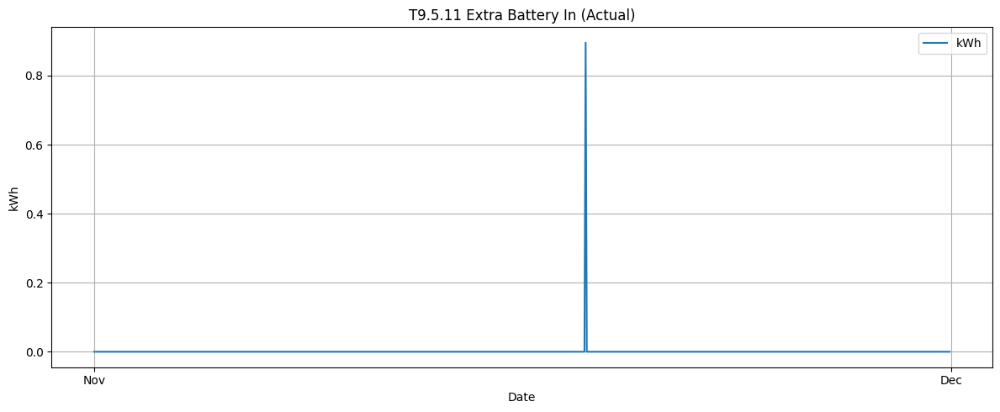

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

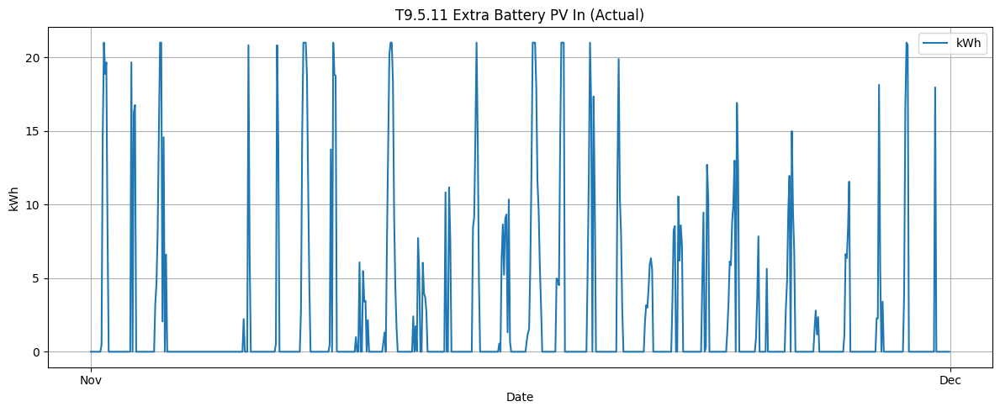

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

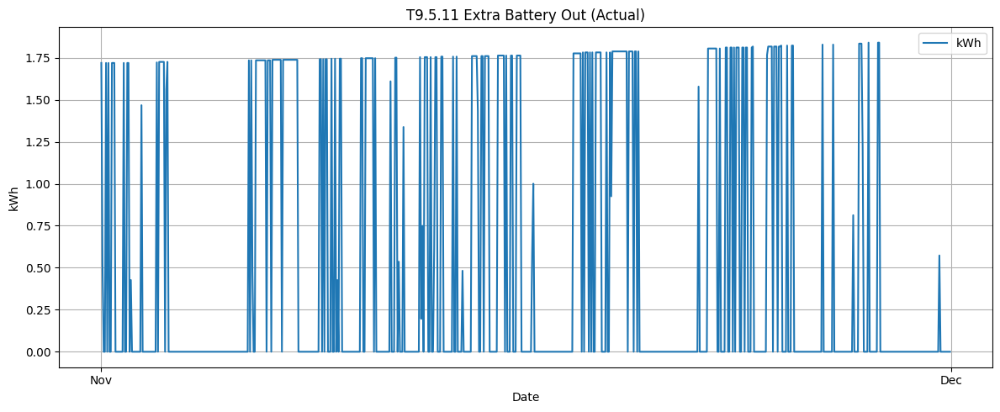

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

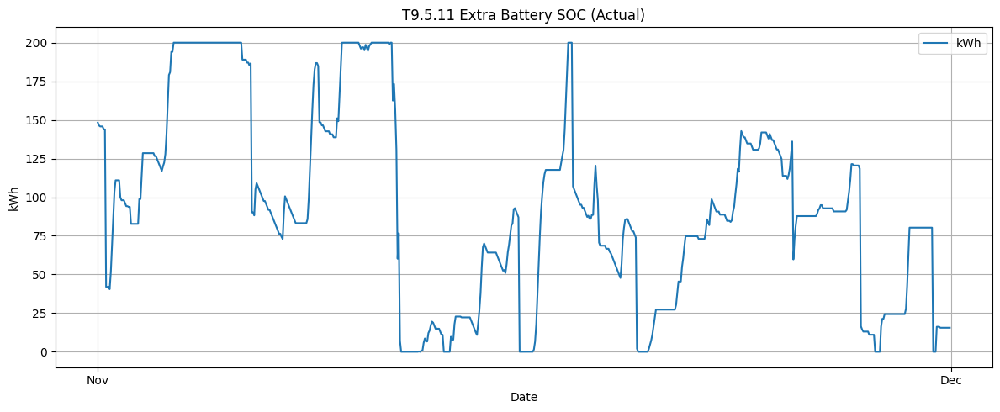

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

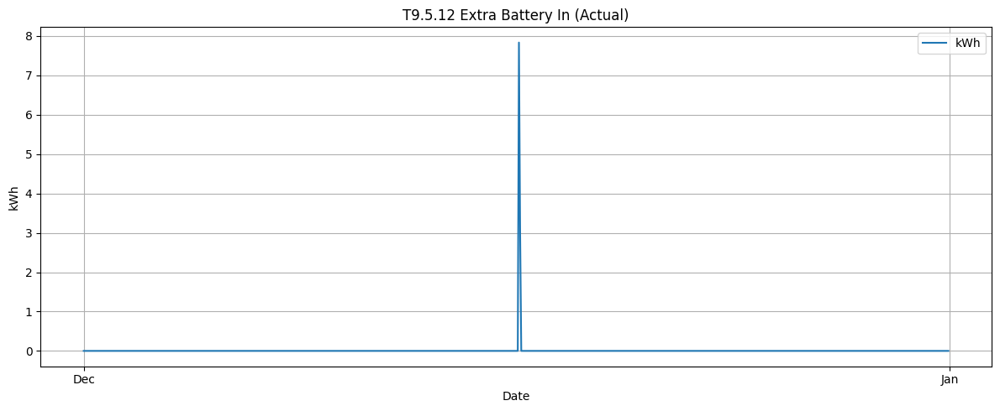

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

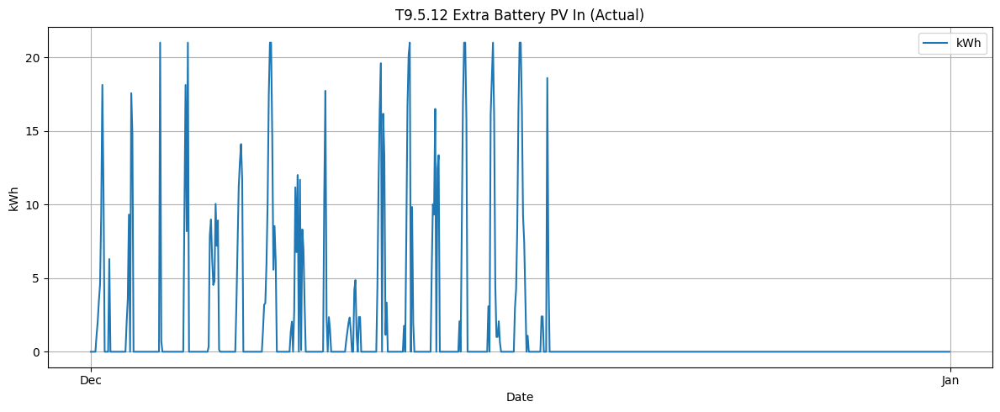

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

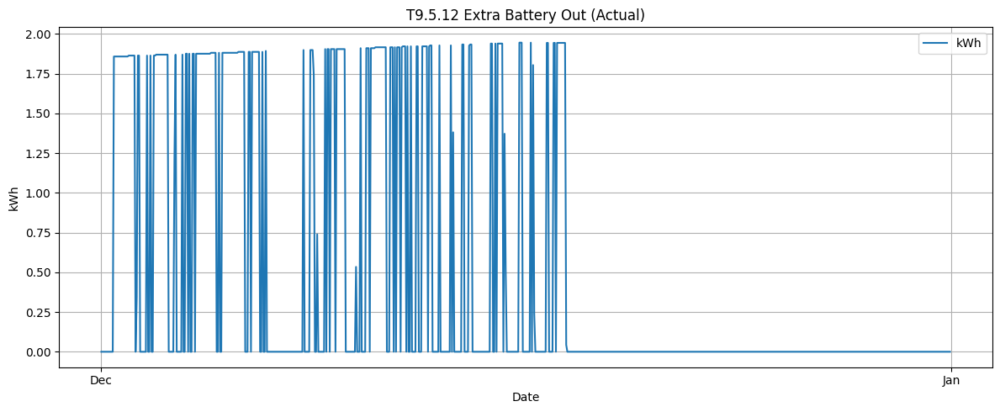

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

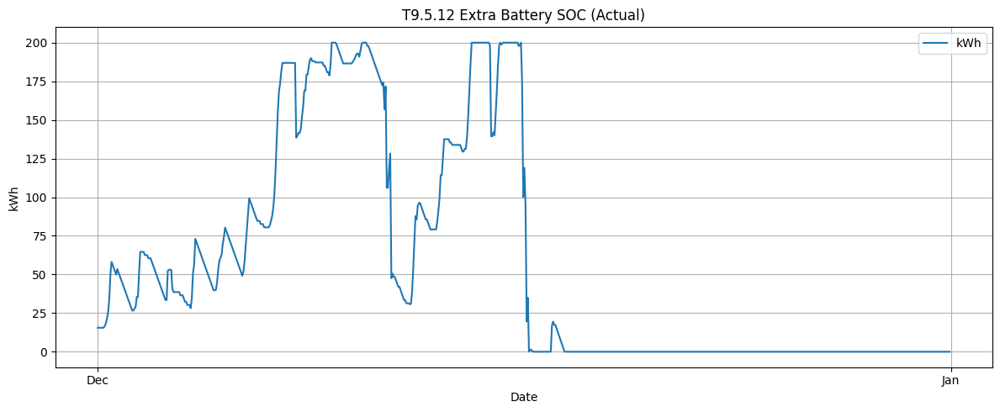

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

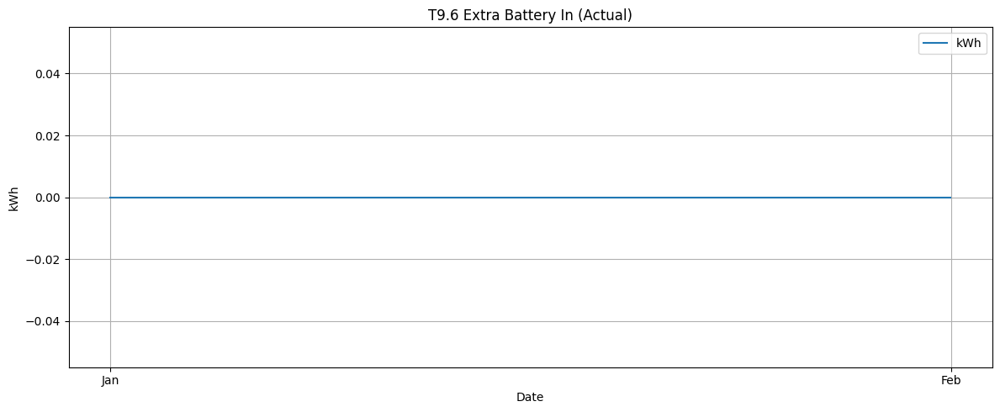

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

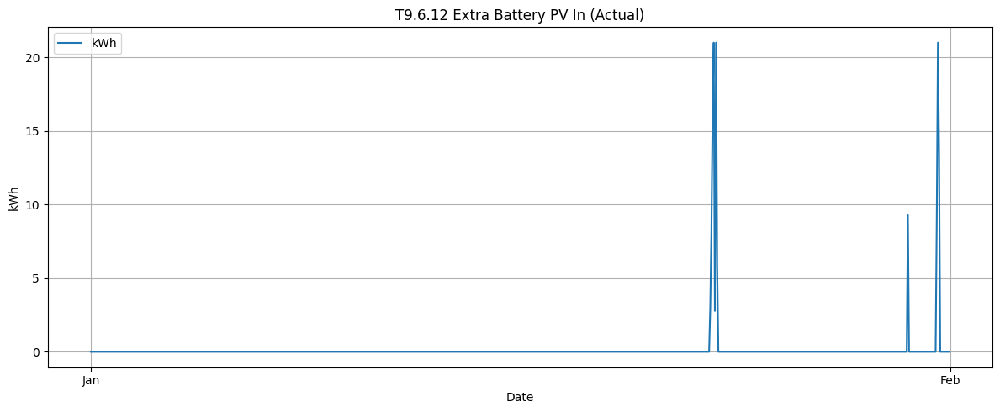

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

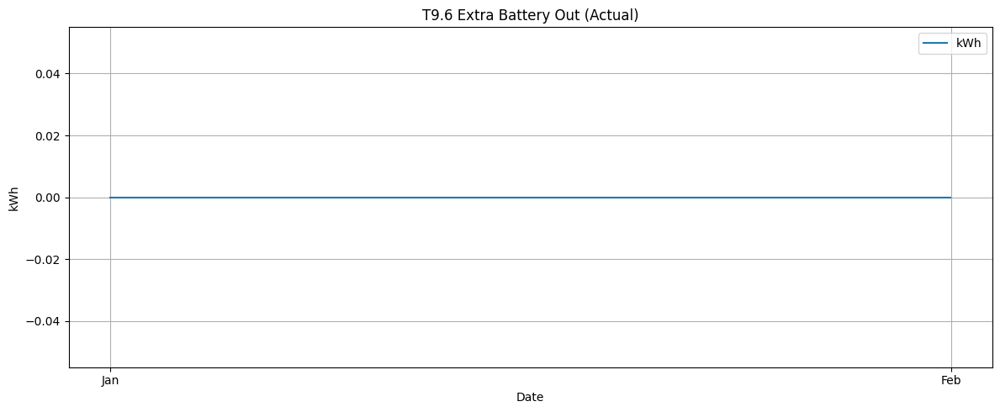

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [25]:
tractor_soc_series = {}
tractor_out_series = {}
tractor_in_series = {}
tractor_in_PV_series = {}
for n in modelv1.N:
    tractor_soc_series[f'SOC_tractor_{n}'] = np.array([value(modelv1.SOC_tractor[t,n]) for t in timesteps])[mask]
    tractor_out_series[f'tractor_out_{n}'] = np.array([value(modelv1.tractor_out[t,n]) for t in timesteps])[mask]
    tractor_in_series[f'tractor_in_{n}'] = np.array([value(modelv1.tractor_in[t,n]) for t in timesteps])[mask]


# Testing for V-09
for i in range(1, 7):
  if i == 1:
    months_to_plot = [1]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
    # T9.1
    tractor_load_vals = np.array([value(modelv1.tractor_load[t]) for t in timesteps])[mask]
    plot_series(filtered_dates, {'kWh': tractor_load_vals}, f'{name}.{i} Tractor Load', window=None)
    for n in modelv1.N:
      tractor_soc_series[f'SOC_tractor_{n}'] = np.array([value(modelv1.SOC_tractor[t,n]) for t in timesteps])[mask]
    plot_series(filtered_dates, tractor_soc_series, f'{name}.{i} Tractor SOC', window=None)
  if i == 2:
    months_to_plot = [1]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
    # T9.2
    for n in modelv1.N:
      tractor_soc_series[f'SOC_tractor_{n}'] = np.array([value(modelv1.SOC_tractor[t,n]) for t in timesteps])[mask]
    plot_series(filtered_dates, tractor_soc_series, f'{name}.{i} Tractor SOC', window=None)
  if i == 3:
    for j in range(1, 13):
      months_to_plot = [j]
      mask = dates.month.isin(months_to_plot)
      filtered_dates = dates[mask]
      # T9.3
      for n in modelv1.N:
        tractor_soc_series[f'SOC_tractor_{n}'] = np.array([value(modelv1.SOC_tractor[t,n]) for t in timesteps])[mask]
        tractor_out_series[f'tractor_out_{n}'] = np.array([value(modelv1.tractor_out[t,n]) for t in timesteps])[mask]
        tractor_in_series[f'tractor_in_{n}'] = np.array([value(modelv1.tractor_in[t,n]) for t in timesteps])[mask]
        tractor_in_PV_series[f'tractor_in_PV_{n}'] = np.array([value(modelv1.tractor_in_PV[t,n]) for t in timesteps])[mask]
      tractor_in = {**tractor_in_series, **tractor_in_PV_series}
      plot_series(filtered_dates, tractor_soc_series, f'{name}.{i}.{j} Tractor SOC', window=None)
      plot_series(filtered_dates, tractor_out_series, f'{name}.{i}.{j} Tractor Output', window=None)
      plot_series(filtered_dates, tractor_in, f'{name}.{i}.{j} Tractor Input', window=None)
  if i == 4:
    months_to_plot = [1]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
    for n in modelv1.N:
        tractor_out_series[f'tractor_out_{n}'] = np.array([value(modelv1.tractor_out[t,n]) for t in timesteps])[mask]
        tractor_in_series[f'tractor_in_{n}'] = np.array([value(modelv1.tractor_in[t,n]) for t in timesteps])[mask]
        tractor_in_PV_series[f'tractor_in_PV_{n}'] = np.array([value(modelv1.tractor_in_PV[t,n]) for t in timesteps])[mask]
    tractor_in = {**tractor_in_series, **tractor_in_PV_series}
    plot_series(filtered_dates, tractor_out_series, f'{name}.{i} Tractor Output', window=None)
    plot_series(filtered_dates, tractor_in, f'{name}.{i}.{j} Tractor Input', window=None)
  if i == 5:
    for j in range(1, 13):
      months_to_plot = [j]
      mask = dates.month.isin(months_to_plot)
      filtered_dates = dates[mask]
      extra_in_vals = np.array([value(modelv1.extra_battery_in[t]) for t in timesteps])[mask]
      plot_series(filtered_dates, {'kWh': extra_in_vals}, f'{name}.{i}.{j} Extra Battery In', window=None)
      extra_in_PV_vals = np.array([value(modelv1.extra_battery_in_PV[t]) for t in timesteps])[mask]
      plot_series(filtered_dates, {'kWh': extra_in_PV_vals}, f'{name}.{i}.{j} Extra Battery PV In', window=None)
      extra_out_vals = np.array([value(modelv1.extra_battery_out[t]) for t in timesteps])[mask]
      plot_series(filtered_dates, {'kWh': extra_out_vals}, f'{name}.{i}.{j} Extra Battery Out', window=None)
      extra_SOC_vals = np.array([value(modelv1.SOC_extra_battery[t]) for t in timesteps])[mask]
      plot_series(filtered_dates, {'kWh': extra_SOC_vals}, f'{name}.{i}.{j} Extra Battery SOC', window=None)
  if i == 6:
    months_to_plot = [1]
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
    extra_in_vals = np.array([value(modelv1.extra_battery_in[t]) for t in timesteps])[mask]
    plot_series(filtered_dates, {'kWh': extra_in_vals}, f'{name}.{i} Extra Battery In', window=None)
    extra_in_PV_vals = np.array([value(modelv1.extra_battery_in_PV[t]) for t in timesteps])[mask]
    plot_series(filtered_dates, {'kWh': extra_in_PV_vals}, f'{name}.{i}.{j} Extra Battery PV In', window=None)
    extra_out_vals = np.array([value(modelv1.extra_battery_out[t]) for t in timesteps])[mask]
    plot_series(filtered_dates, {'kWh': extra_out_vals}, f'{name}.{i} Extra Battery Out', window=None)



# V-10

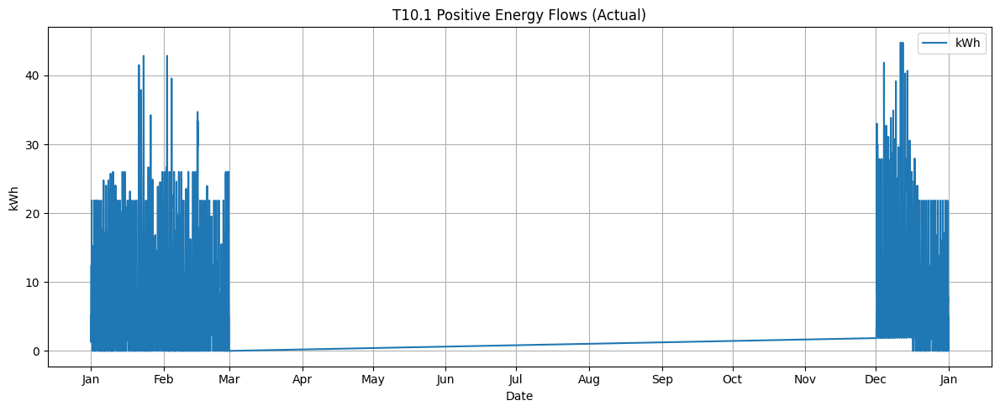

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

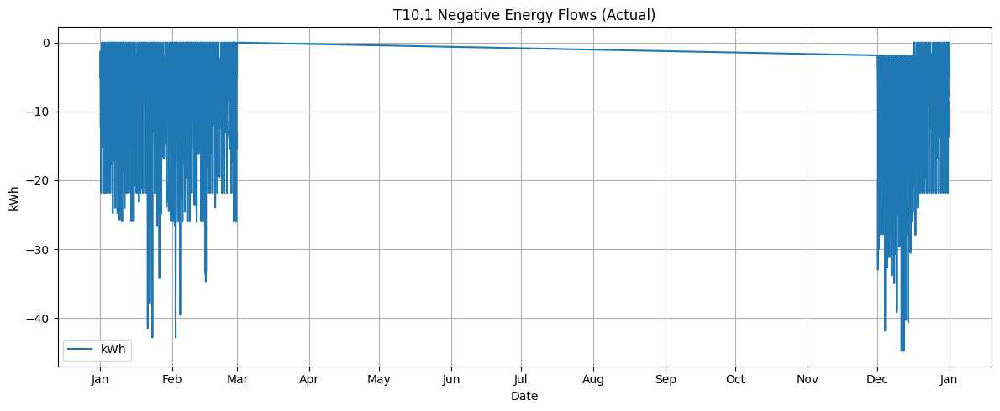

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

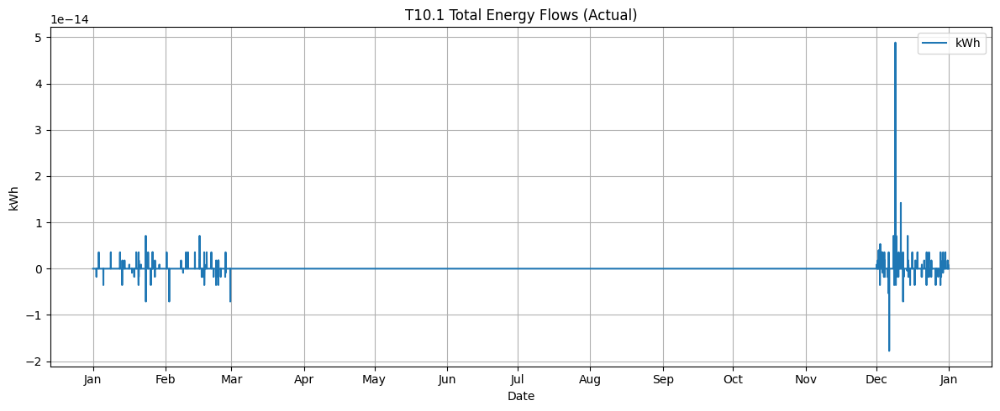

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

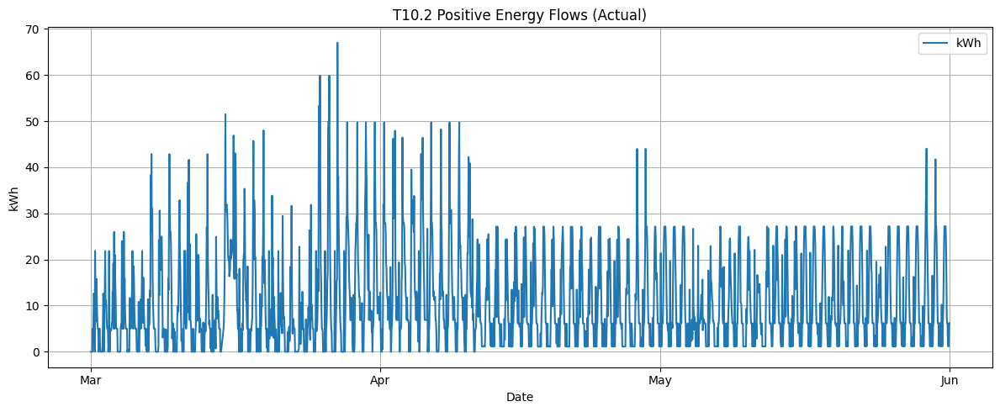

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

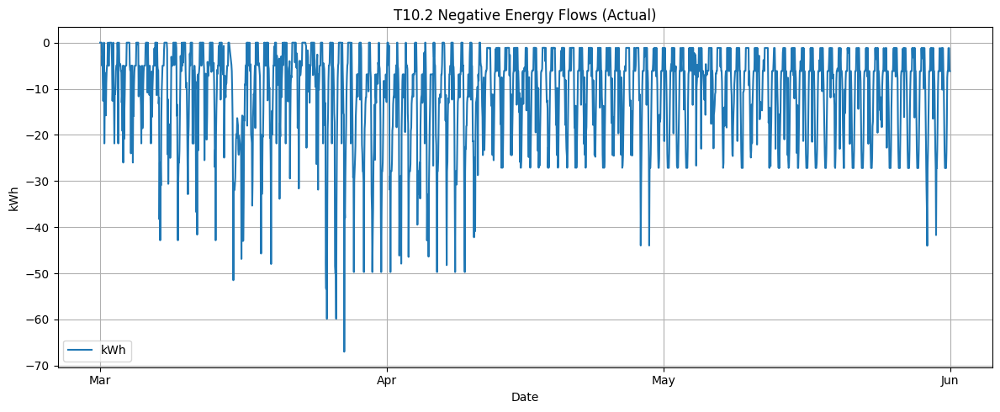

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

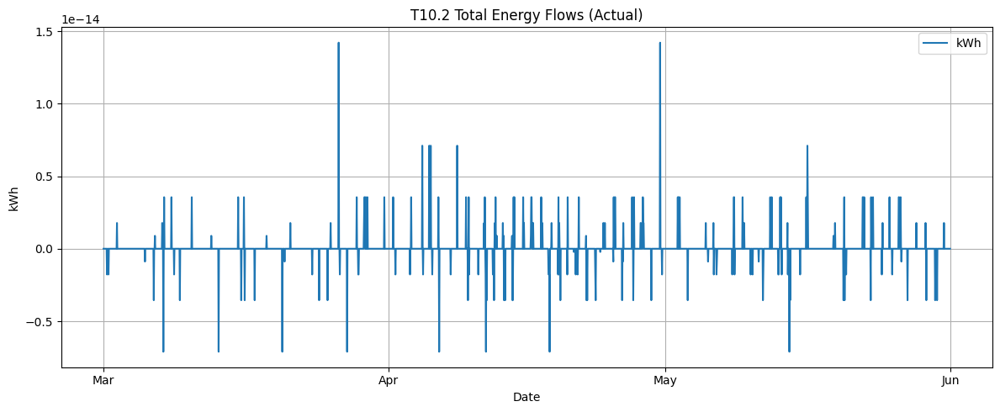

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

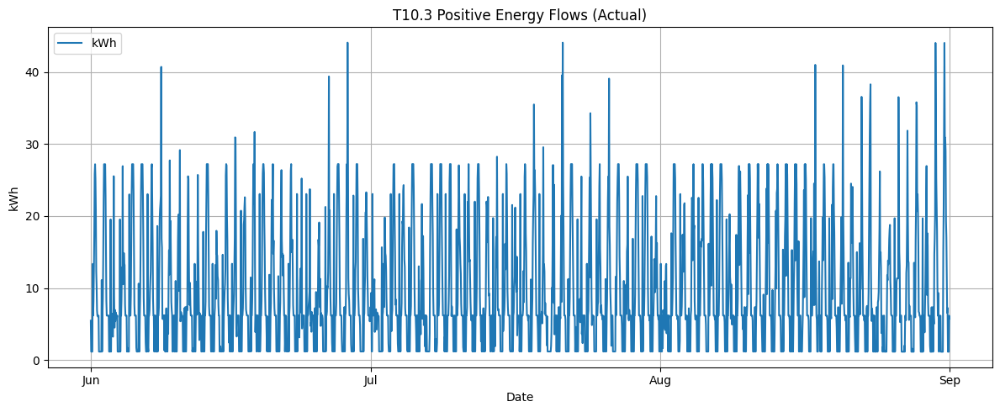

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

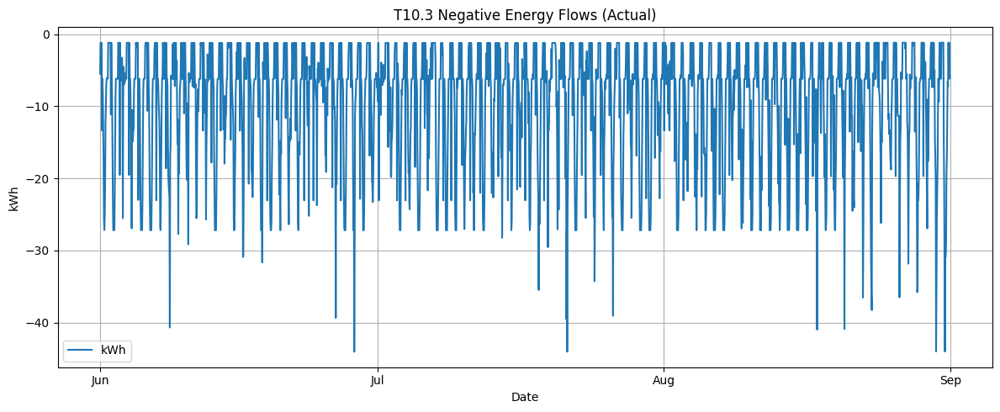

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

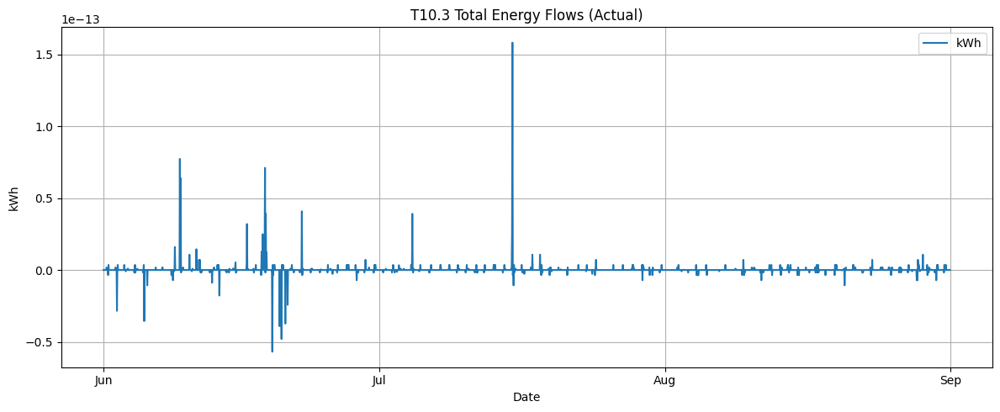

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

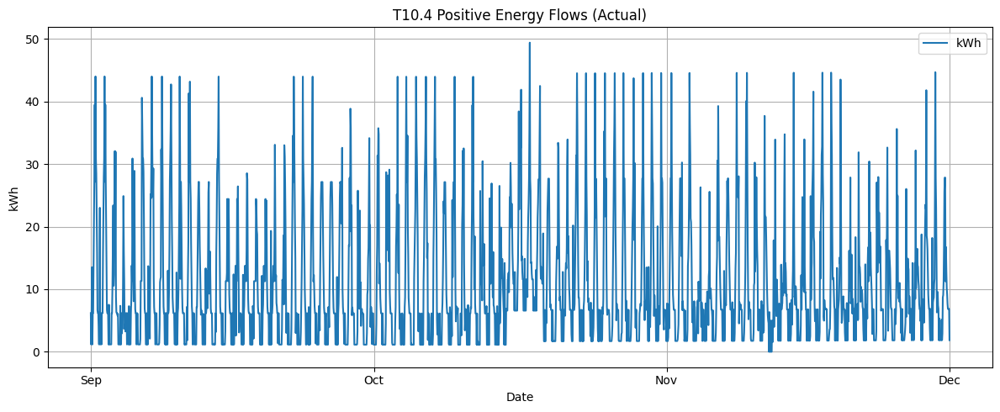

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

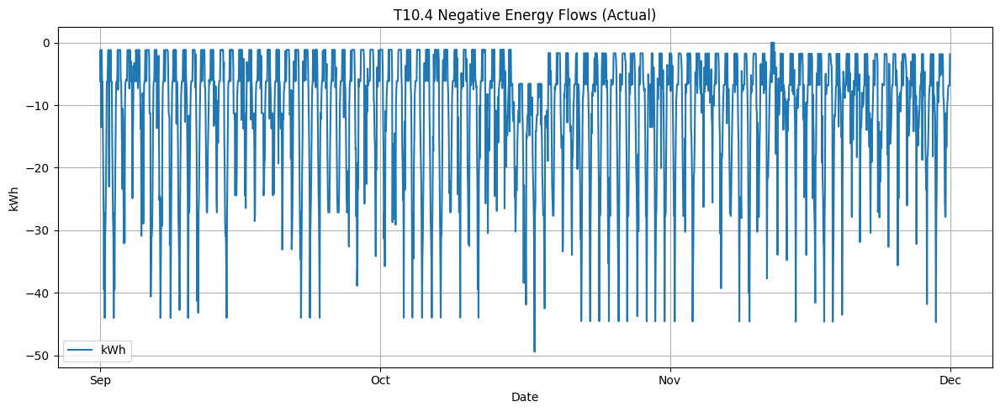

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

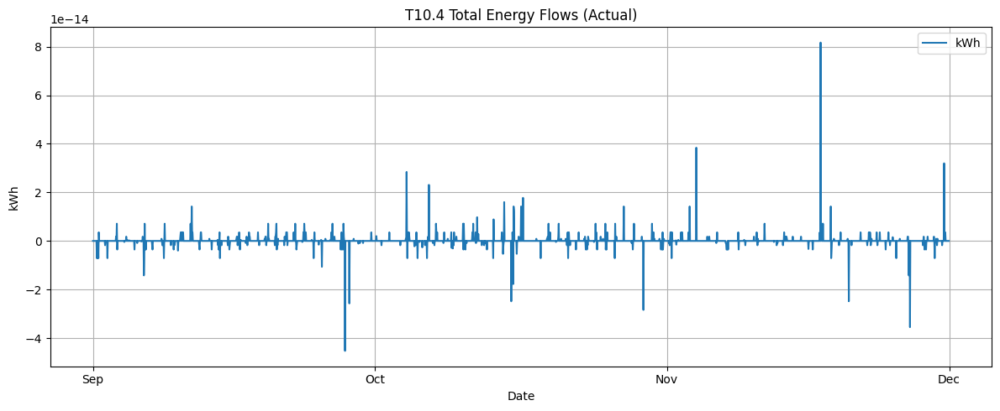

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [28]:
# Testing for V-10
for i in range(1, 5):
  if i == 1:
    months_to_plot = Summer
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 2:
    months_to_plot = Autumn
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 3:
    months_to_plot = Winter
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 4:
    months_to_plot = Spring
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]

  tractor_out_series = {}
  tractor_in_series = {}
  tractor_in_PV_series = {}
  for n in modelv1.N:
      tractor_out_series[f'tractor_out_{n}'] = np.array([value(modelv1.tractor_out[t,n]) for t in timesteps])[mask]
      tractor_in_series[f'tractor_in_{n}'] = np.array([value(modelv1.tractor_in[t,n]) for t in timesteps])[mask]
      tractor_in_PV_series[f'tractor_in_PV_{n}'] = np.array([value(modelv1.tractor_in_PV[t,n]) for t in timesteps])[mask]

  # T10.1.1
  grid_imp_w_vals = np.array([value(modelv1.grid_imp_W[t]) for t in timesteps])[mask]
  grid_imp_r_vals = np.array([value(modelv1.grid_imp_R[t]) for t in timesteps])[mask]
  pv_vals = np.array([value(modelv1.PV[t]) for t in timesteps])[mask]
  pv_curt_vals = np.array([value(modelv1.PV_curt[t]) for t in timesteps])[mask]
  bess_out_w_vals = np.array([value(modelv1.BESS_out_W[t]) for t in timesteps])[mask]
  bess_out_r_vals = np.array([value(modelv1.BESS_out_R[t]) for t in timesteps])[mask]
  extra_tractor_out_vals = np.array([value(modelv1.extra_battery_out[t]) for t in timesteps])[mask]


  positive = grid_imp_w_vals + grid_imp_r_vals + pv_vals - pv_curt_vals + bess_out_w_vals + bess_out_r_vals + tractor_out_series['tractor_out_1'] +extra_tractor_out_vals
  plot_series(filtered_dates, {'kWh': positive}, f'{name}.{i} Positive Energy Flows', window=None)

  farm_vals = np.array([value(modelv1.farm[t]) for t in timesteps])[mask]
  bess_in_r_vals = np.array([value(modelv1.BESS_in_R[t]) for t in timesteps])[mask]
  bess_in_w_vals = np.array([value(modelv1.BESS_in_W[t]) for t in timesteps])[mask]
  grid_exp_w_vals = np.array([value(modelv1.grid_exp_W[t]) for t in timesteps])[mask]
  extra_tractor_in_PV_vals = np.array([value(modelv1.extra_battery_in_PV[t]) for t in timesteps])[mask]
  extra_tractor_in_vals = np.array([value(modelv1.extra_battery_in[t]) for t in timesteps])[mask]


  negative = -(farm_vals + bess_in_r_vals + bess_in_w_vals + grid_exp_w_vals + tractor_in_series['tractor_in_1']+ tractor_in_PV_series['tractor_in_PV_1']+extra_tractor_in_PV_vals+extra_tractor_in_vals)
  plot_series(filtered_dates, {'kWh': negative}, f'{name}.{i} Negative Energy Flows', window=None)

  total = positive + negative
  plot_series(filtered_dates, {'kWh': total}, f'{name}.{i} Total Energy Flows', window=None)


# V-11

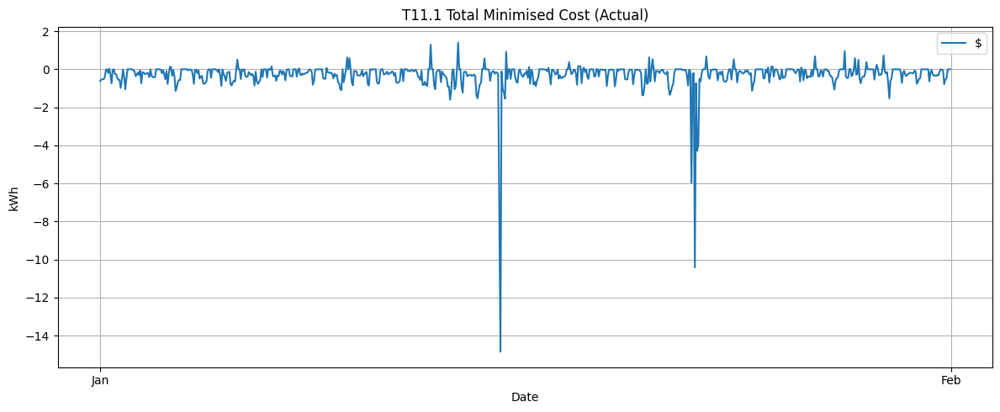

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

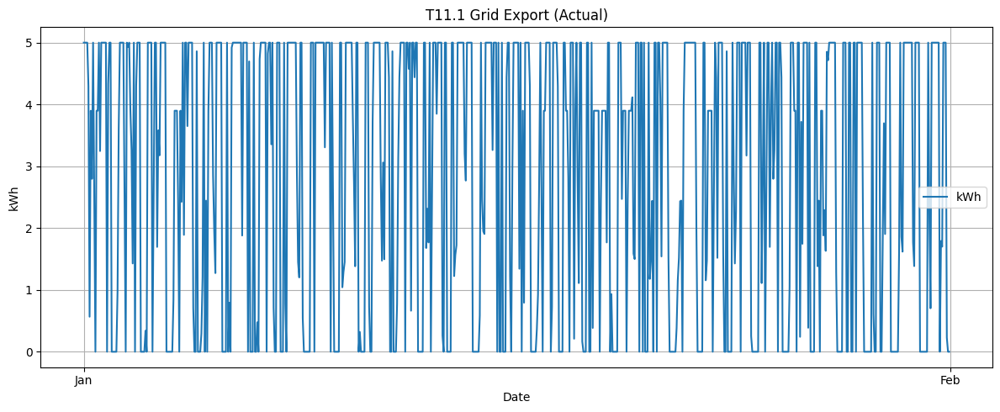

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

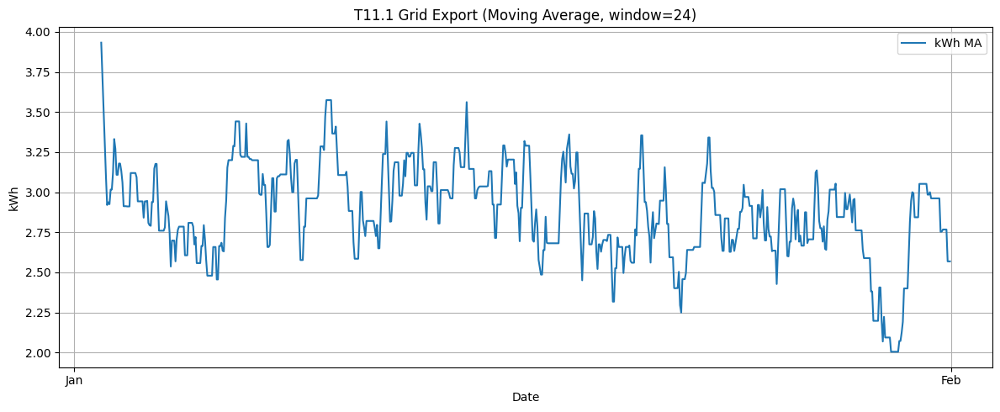

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

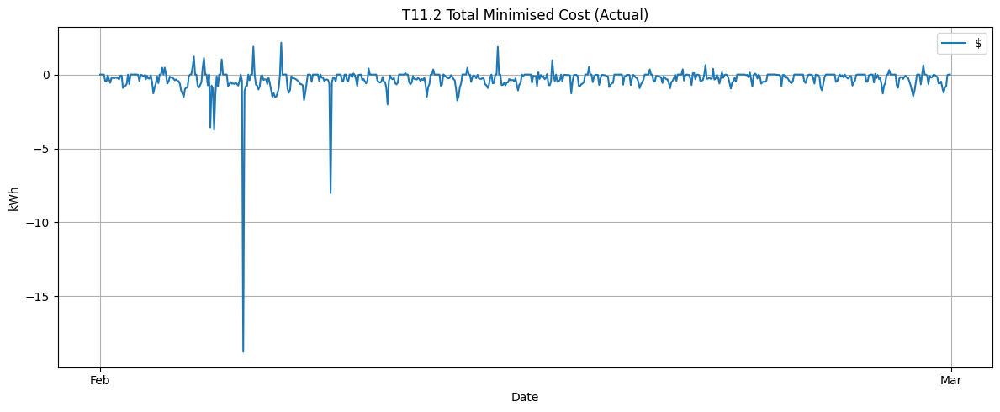

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

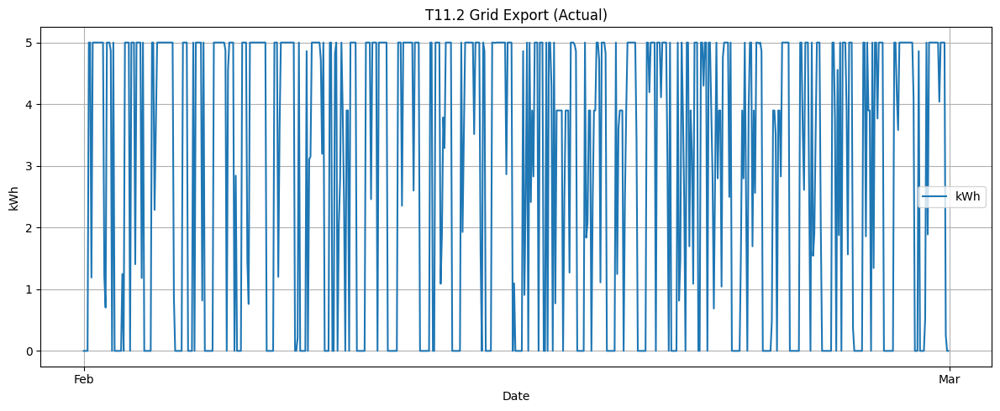

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

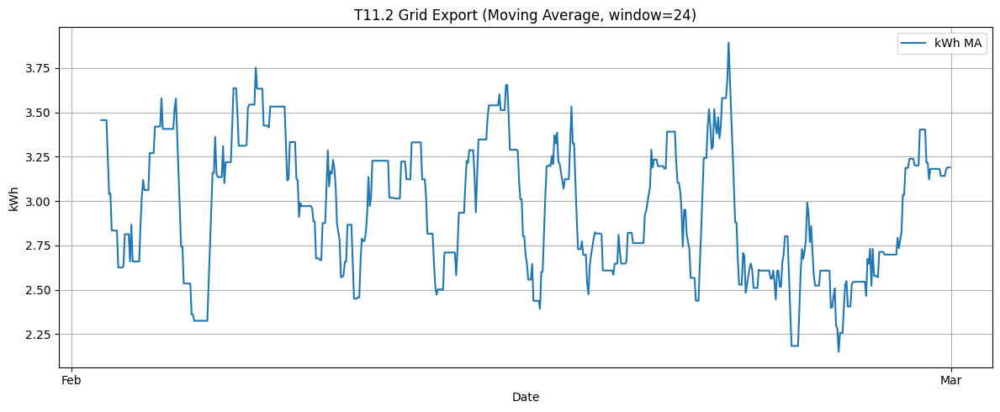

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

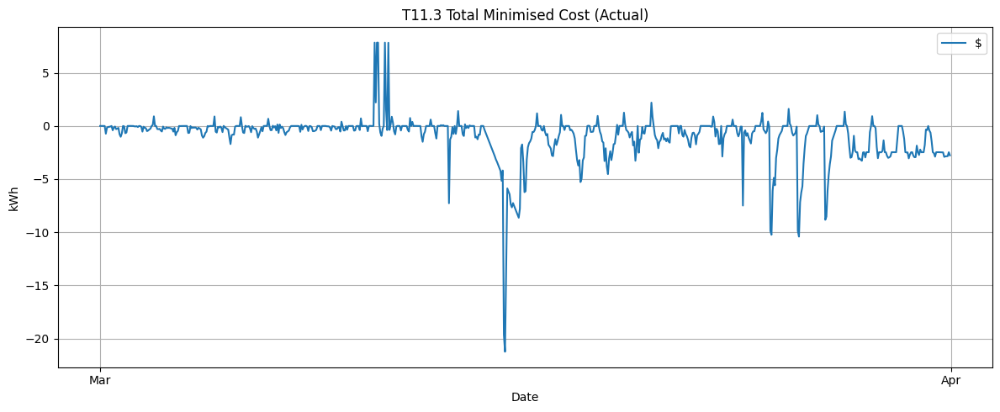

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

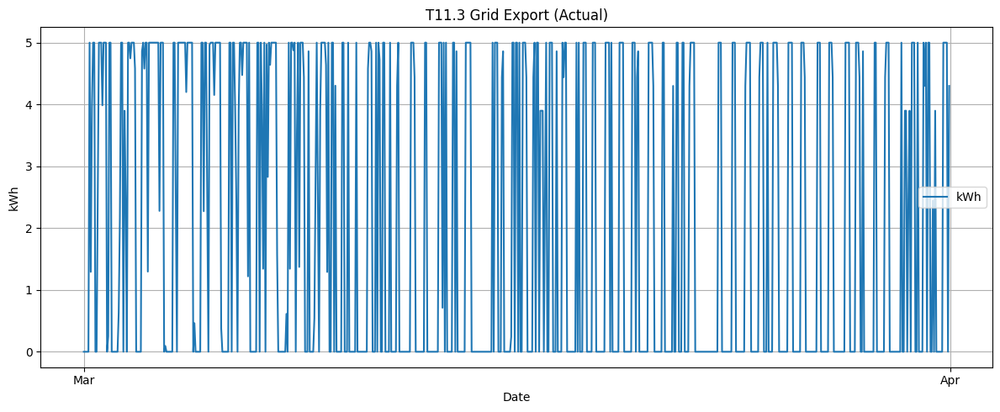

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

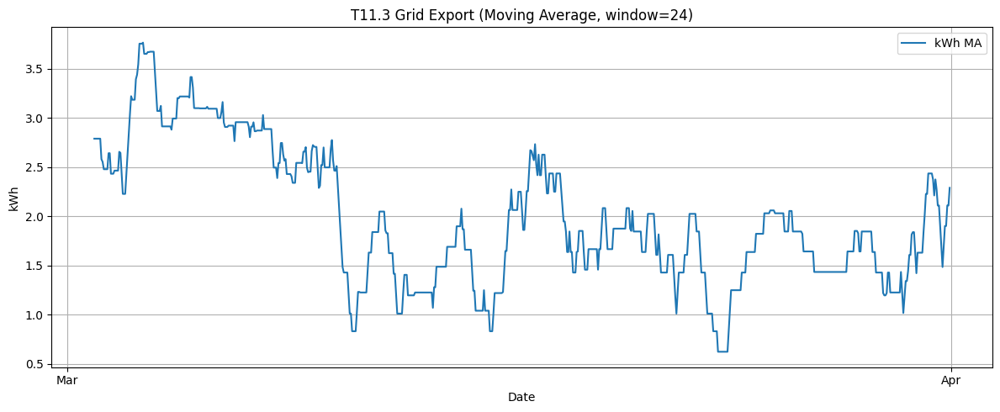

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

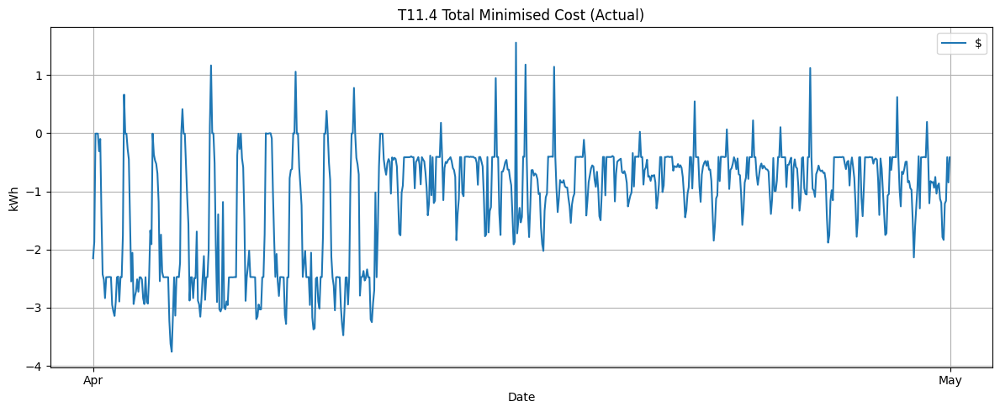

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

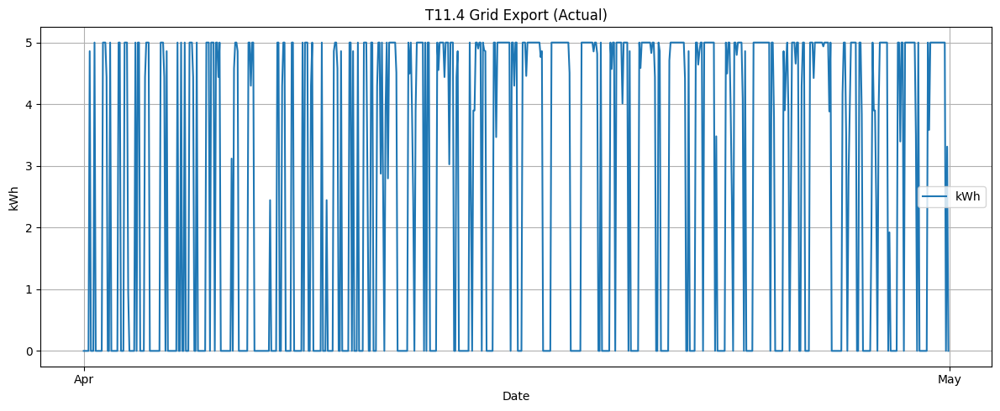

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

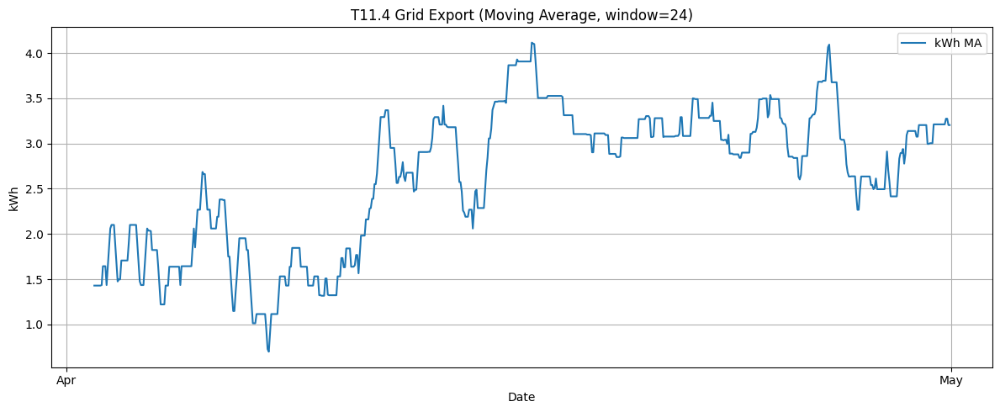

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

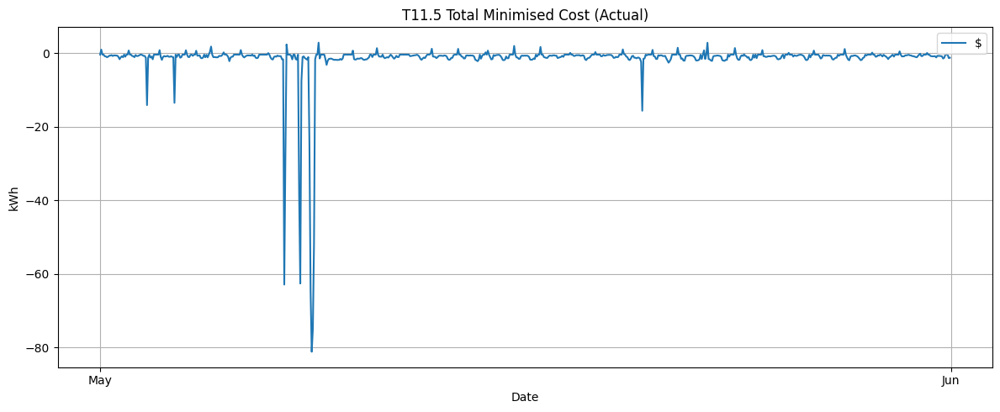

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

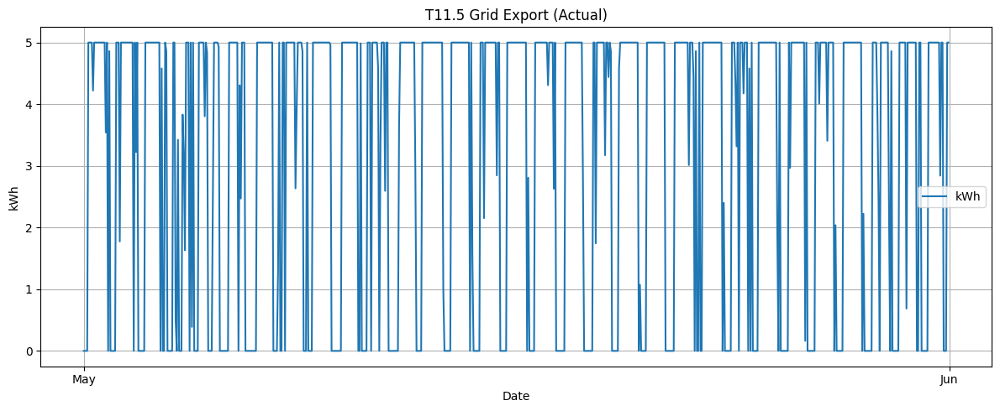

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

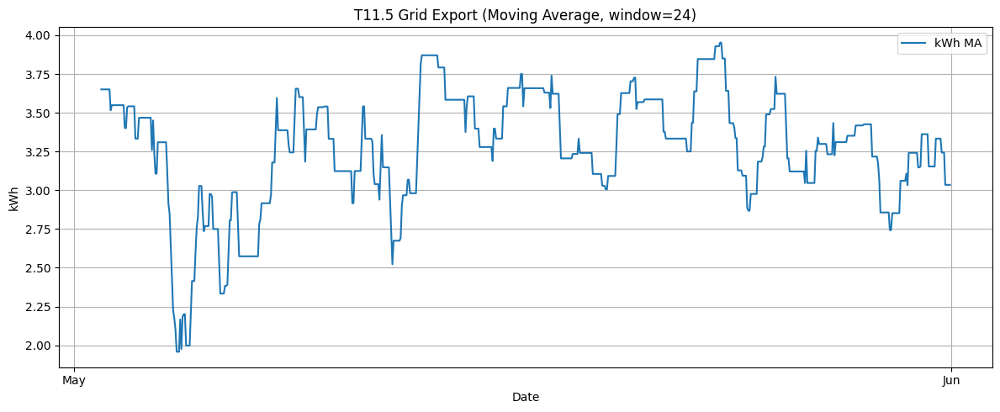

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

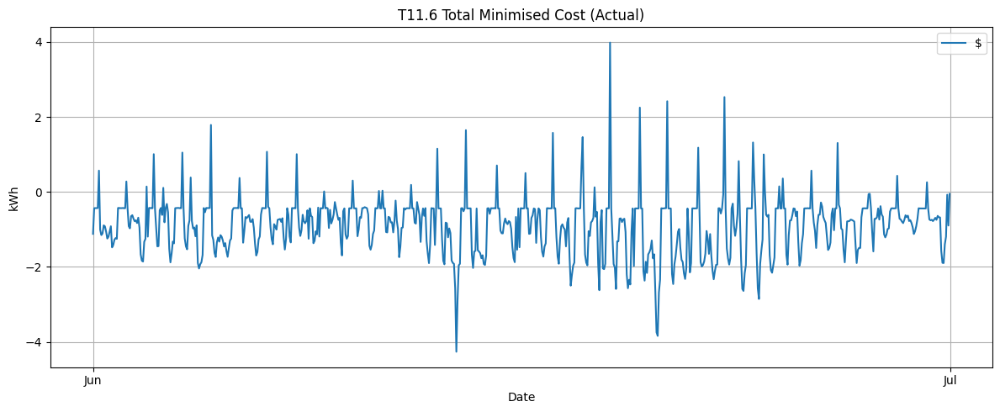

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

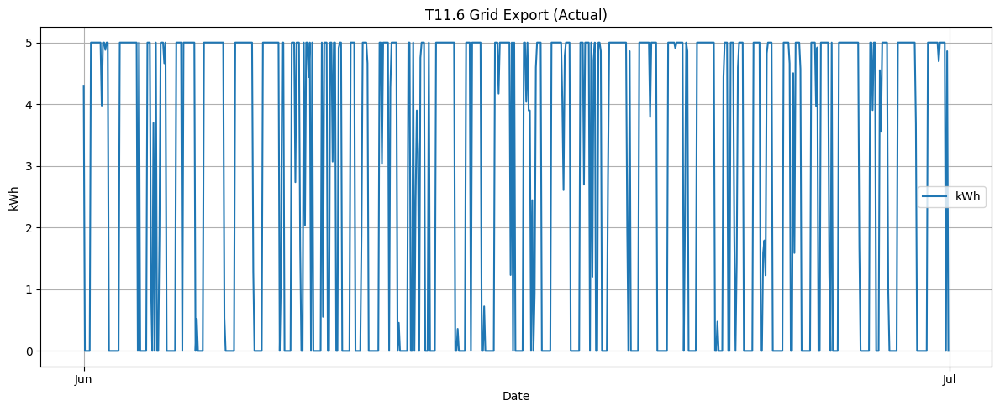

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

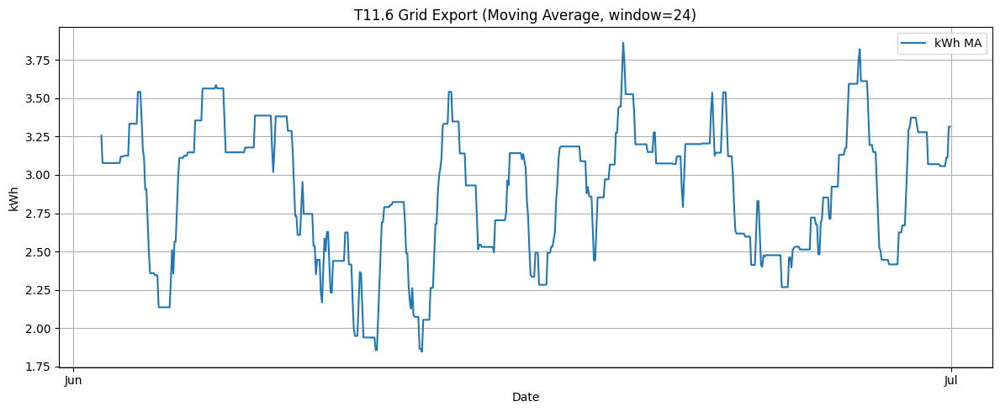

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

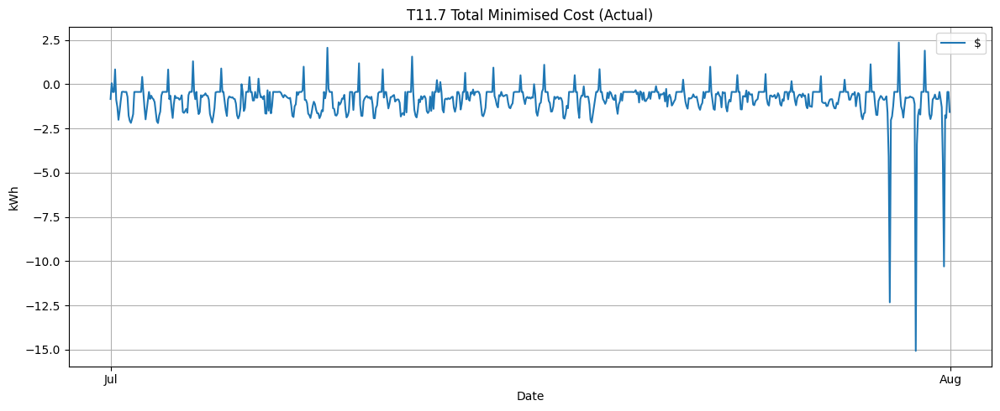

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

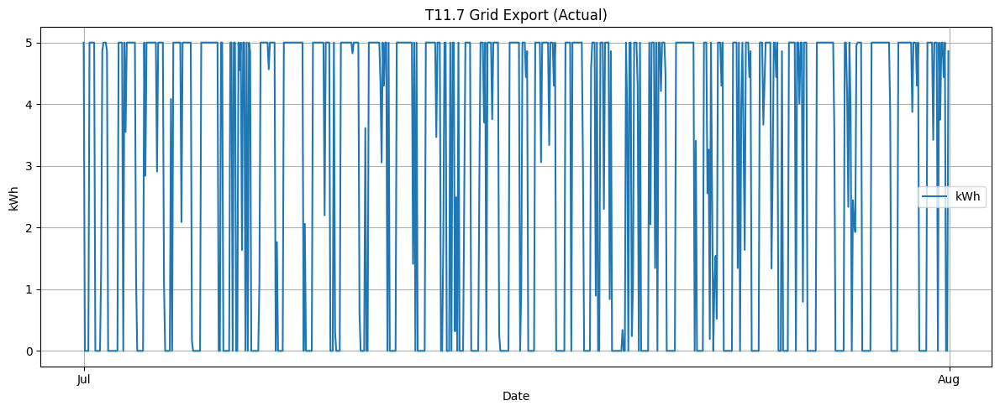

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

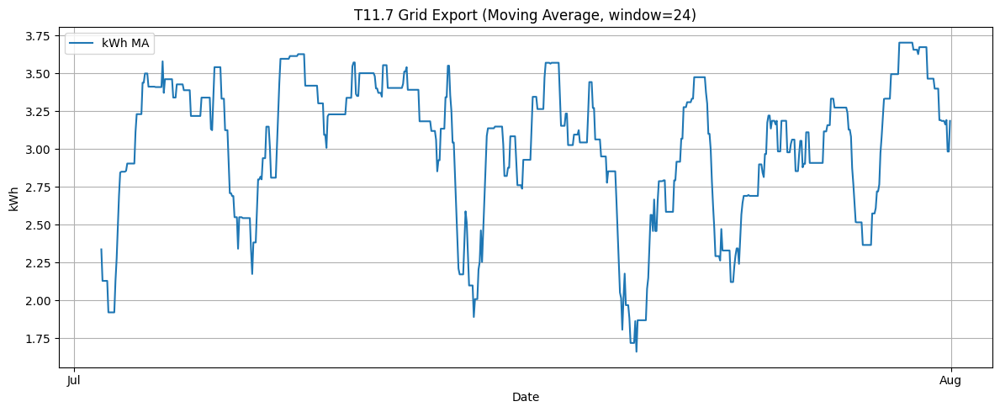

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

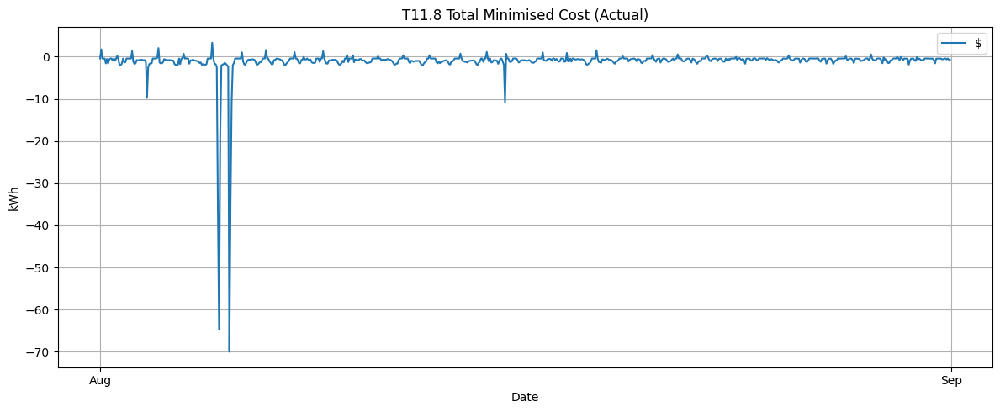

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

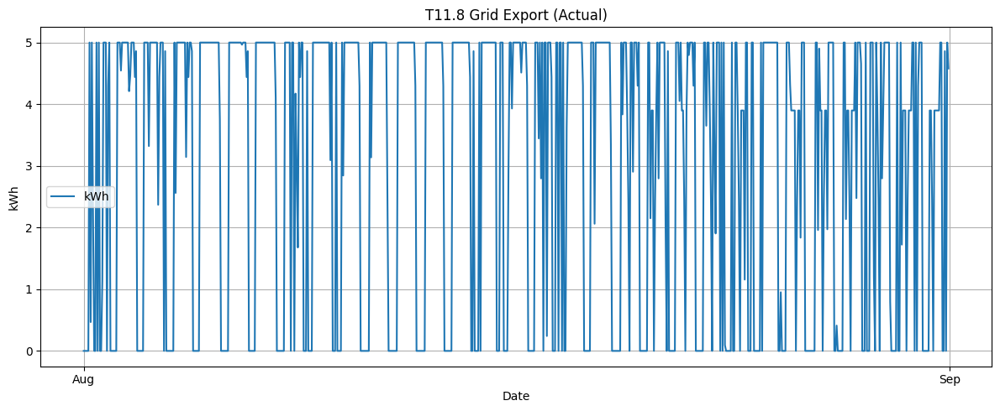

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

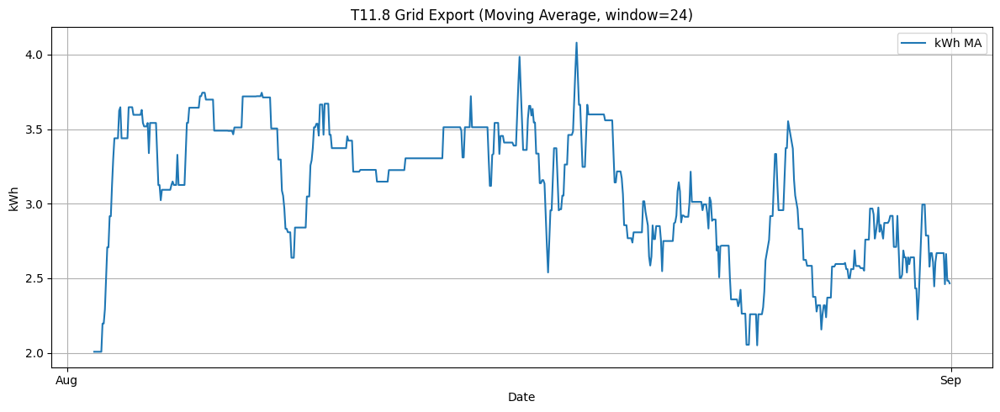

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

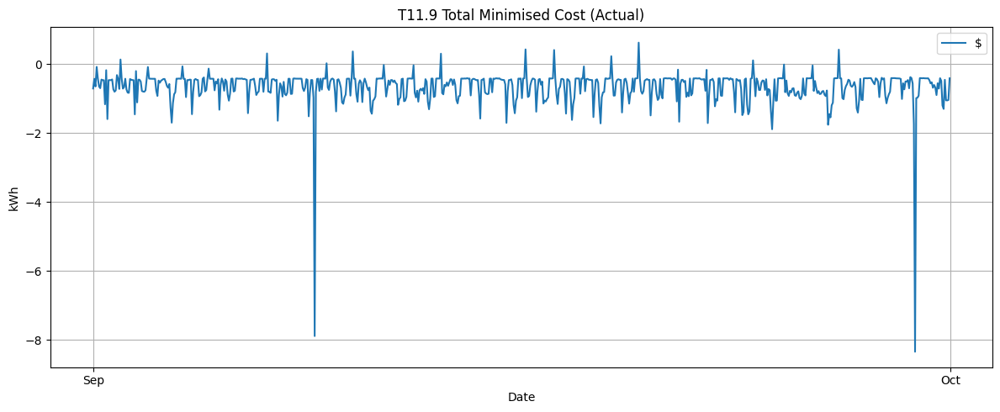

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

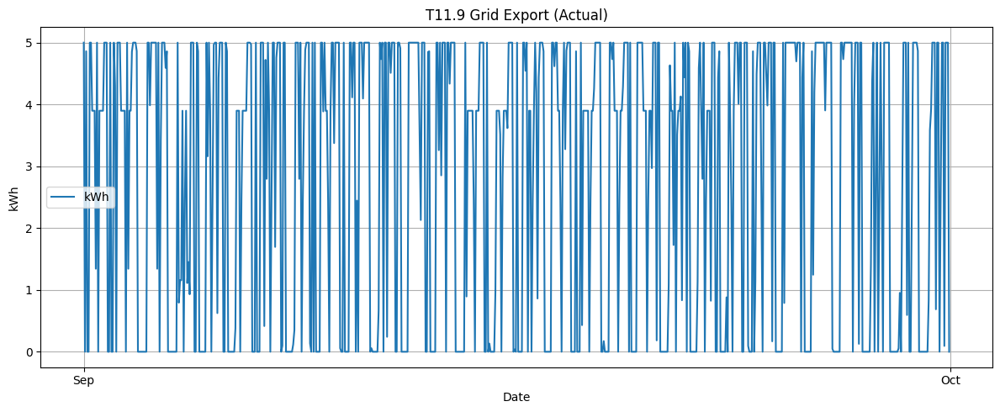

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

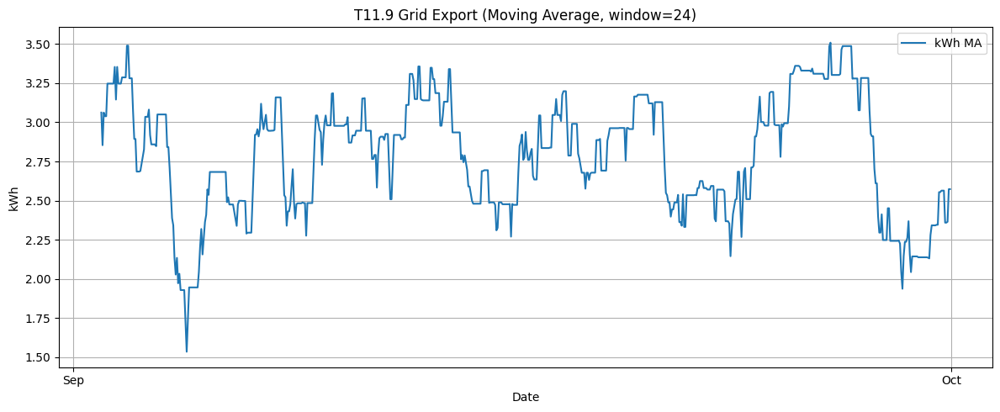

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

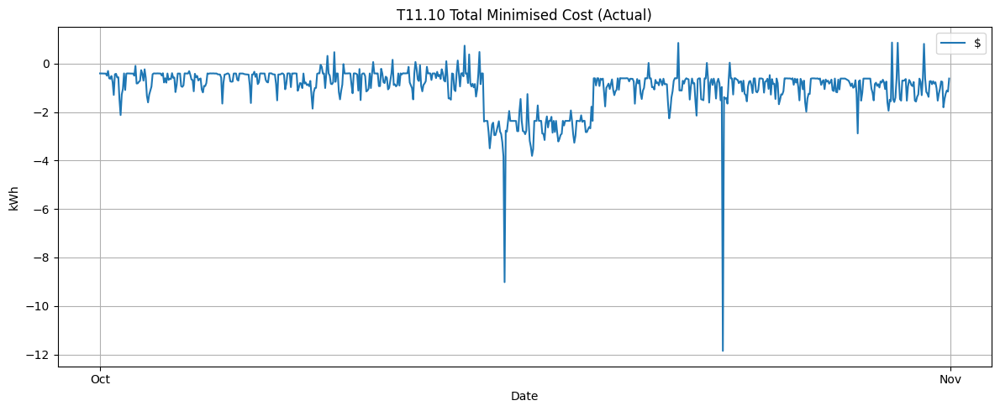

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

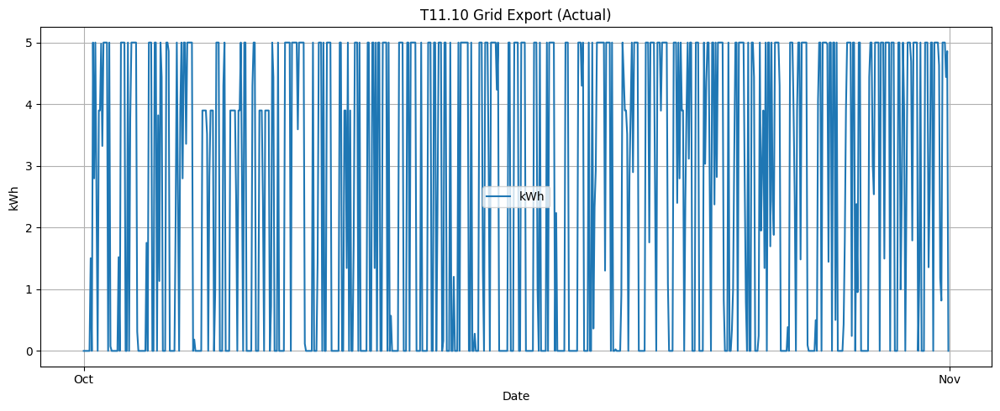

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

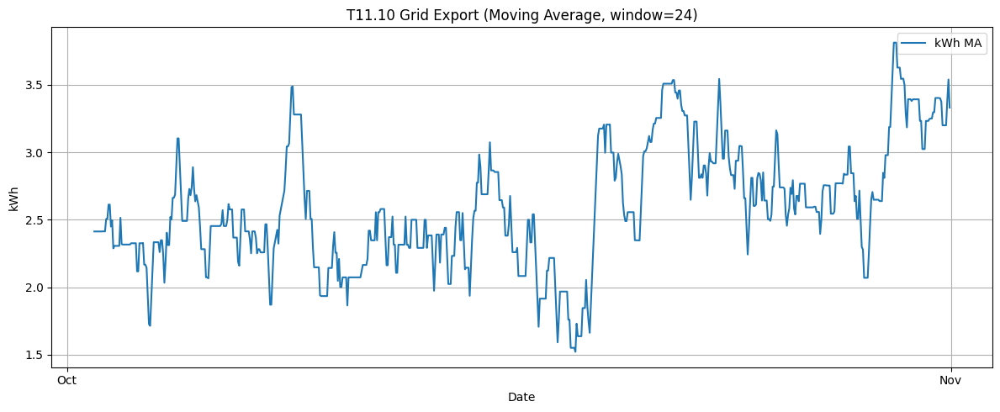

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

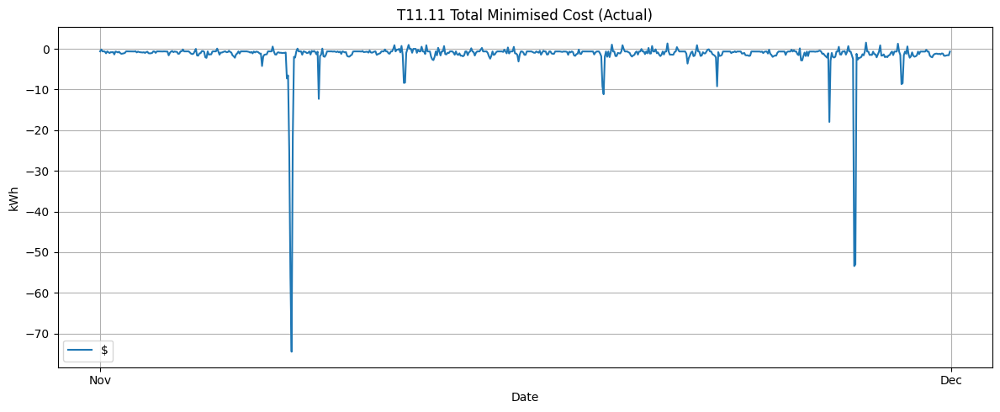

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

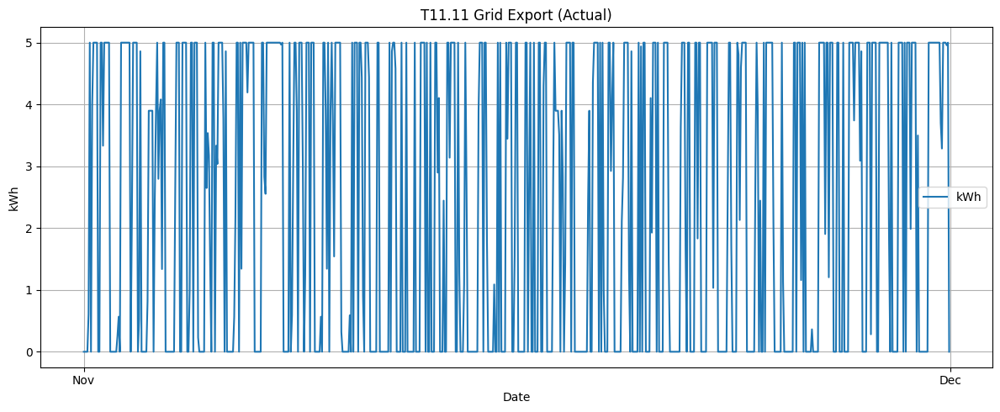

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

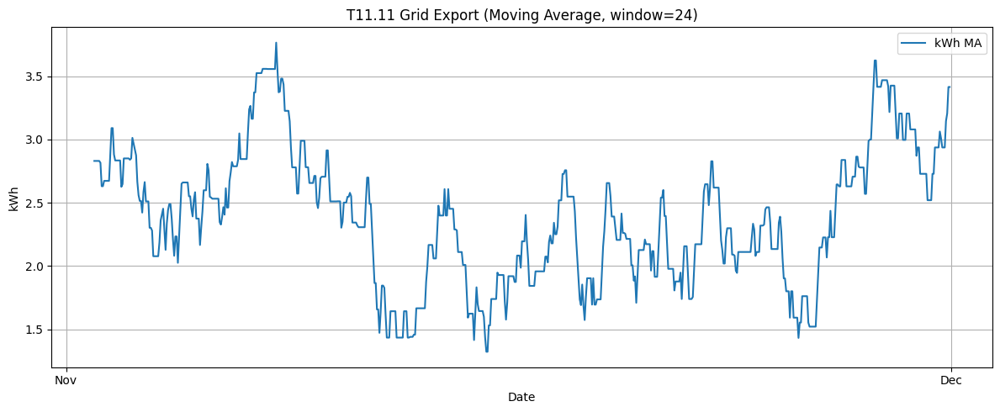

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

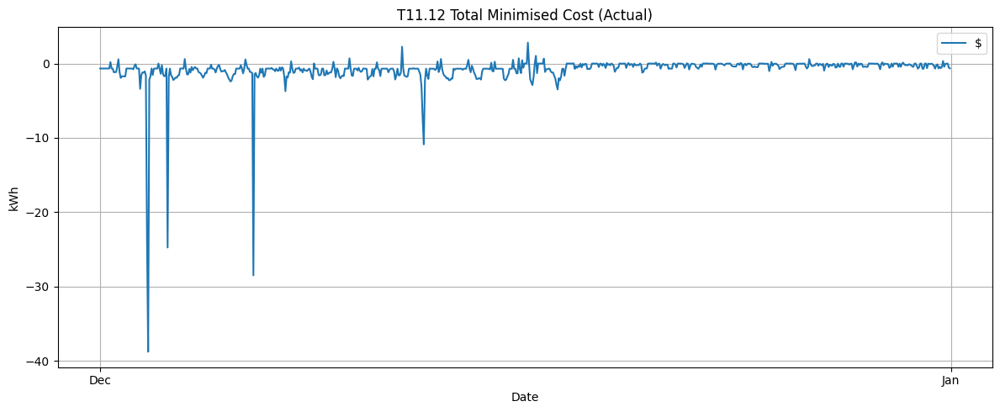

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

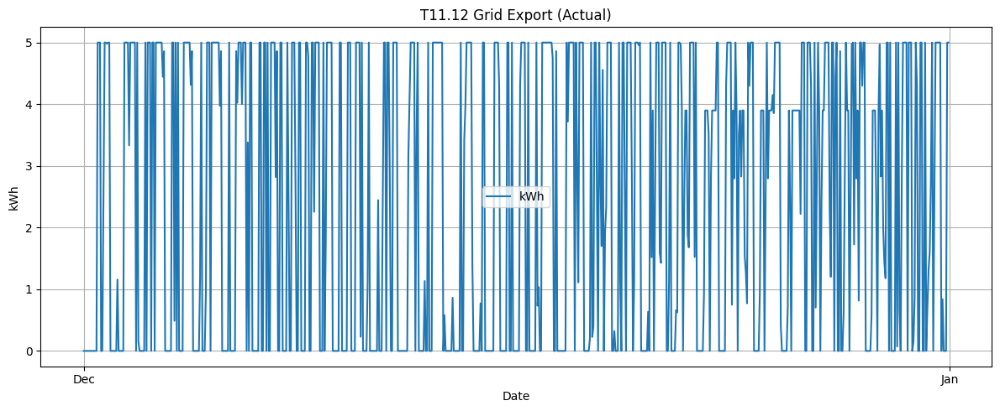

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

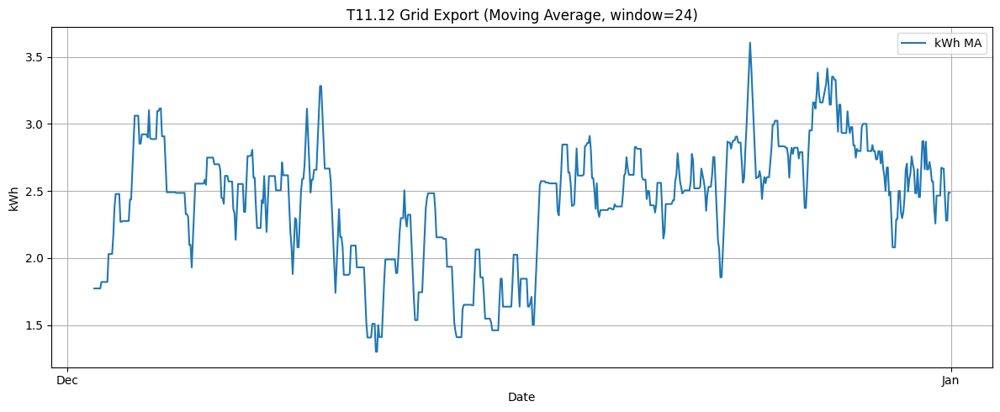

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [31]:
# Testing for V-11
for i in range(1, 13):
  months_to_plot = [i]
  mask = dates.month.isin(months_to_plot)
  filtered_dates = dates[mask]

  grid_cost_ts = np.array([
                  value(
                      modelv1.price_W[t] * (modelv1.grid_imp_W[t] - modelv1.grid_exp_W[t])
                      + modelv1.price_R[t] * (modelv1.grid_imp_R[t] - modelv1.farm[t])
                      - delta_FCAS * ((1 - modelv1.VPP) * (
                          (modelv1.e_R1s[t] * modelv1.price_R1s[t] * modelv1.f_R1s[t]) +
                          (modelv1.e_R6s[t] * modelv1.price_R6s[t] * modelv1.f_R6s[t]) +
                          (modelv1.e_R60s[t] * modelv1.price_R60s[t] * modelv1.f_R60s[t]) +
                          (modelv1.e_R5m[t] * modelv1.price_R5m[t] * modelv1.f_R5m[t]) +
                          (modelv1.e_L1s[t] * modelv1.price_L1s[t] * modelv1.f_L1s[t]) +
                          (modelv1.e_L6s[t] * modelv1.price_L6s[t] * modelv1.f_L6s[t]) +
                          (modelv1.e_L60s[t] * modelv1.price_L60s[t] * modelv1.f_L60s[t]) +
                          (modelv1.e_L5m[t] * modelv1.price_L5m[t] * modelv1.f_L5m[t])
                      ))
                  )
                  for t in modelv1.T
              ])
  grid_cost_ts = grid_cost_ts[mask]
  plot_series(filtered_dates, {'$': grid_cost_ts}, f'{name}.{i} Total Minimised Cost', window=None)
  grid_exp_w_vals = np.array([value(modelv1.grid_exp_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': grid_exp_w_vals}, f'{name}.{i} Grid Export', window=24)





# V-13

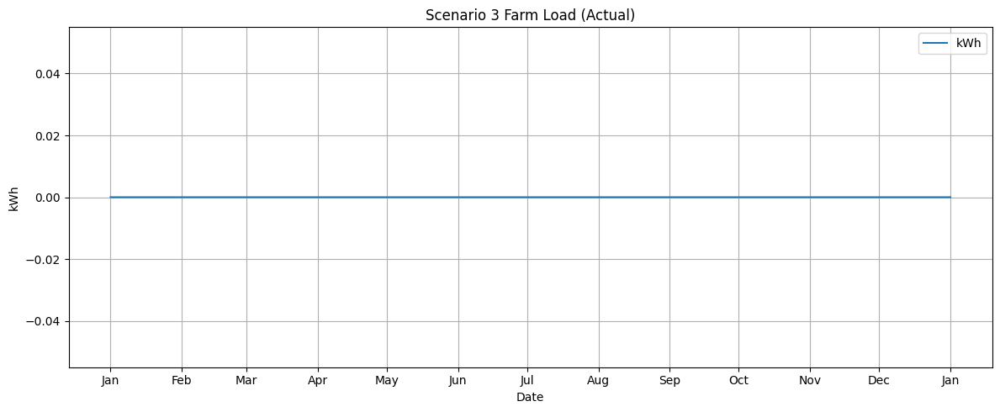

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

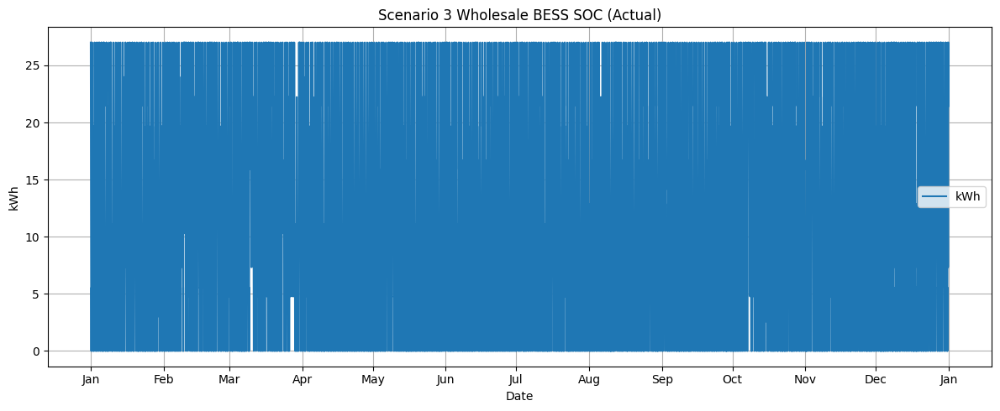

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [60]:
# Testing for V-13
months_to_plot = Year
mask = dates.month.isin(months_to_plot)
filtered_dates = dates[mask]

tractor_soc_series = {}
tractor_out_series = {}
tractor_in_series = {}
tractor_in_PV_series = {}
for n in modelv1.N:
    tractor_soc_series[f'SOC_tractor_{n}'] = np.array([value(modelv1.SOC_tractor[t,n]) for t in timesteps])[mask]
    tractor_out_series[f'tractor_out_{n}'] = np.array([value(modelv1.tractor_out[t,n]) for t in timesteps])[mask]
    tractor_in_series[f'tractor_in_{n}'] = np.array([value(modelv1.tractor_in[t,n]) for t in timesteps])[mask]
    tractor_in_PV_series[f'tractor_in_PV_{n}'] = np.array([value(modelv1.tractor_in_PV[t,n]) for t in timesteps])[mask]

grid_imp_W_vals = np.array([value(modelv1.grid_imp_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': grid_imp_W_vals}, f'{name} Wholesale Grid Import', window=None)
grid_imp_R_vals = np.array([value(modelv1.grid_imp_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': grid_imp_R_vals}, f'{name} Residential Grid Import', window=None)
grid_exp_W_vals = np.array([value(modelv1.grid_exp_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': grid_exp_W_vals}, f'{name} Wholesale Grid Export', window=None)

BESS_in_W_vals = np.array([value(modelv1.BESS_in_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_in_W_vals}, f'{name} Wholesale BESS Input', window=None)
BESS_out_W_vals = np.array([value(modelv1.BESS_out_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_out_W_vals}, f'{name} Wholesale BESS Output', window=None)

BESS_in_R_vals = np.array([value(modelv1.BESS_in_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_in_R_vals}, f'{name} Residential BESS Input', window=None)
BESS_out_R_vals = np.array([value(modelv1.BESS_out_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_out_R_vals}, f'{name} Residential BESS Output', window=None)

plot_series(filtered_dates, tractor_in_series, f'{name} Tractor Input', window=None)
plot_series(filtered_dates, tractor_out_series, f'{name} Tractor Output', window=None)
plot_series(filtered_dates, tractor_soc_series, f'{name} Tractor SOC', window=None)
plot_series(filtered_dates, tractor_in_PV_series, f'{name} Tractor PV Input', window=None)

PV_W_vals = np.array([value(modelv1.PV_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': PV_W_vals}, f'{name} Wholesale PV', window=None)
PV_R_vals = np.array([value(modelv1.PV_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': PV_R_vals}, f'{name} Residential PV', window=None)

farm_vals = np.array([value(modelv1.farm[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': farm_vals}, f'{name} Farm Load', window=None)

SOC_BESS_W_vals = np.array([value(modelv1.SOC_BESS_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': SOC_BESS_W_vals}, f'{name} Wholesale BESS SOC', window=None)
SOC_BESS_R_vals = np.array([value(modelv1.SOC_BESS_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': SOC_BESS_R_vals}, f'{name} Residential BESS SOC', window=None)

Raise_1s_vals = np.array([value(modelv1.f_R1s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': Raise_1s_vals}, f'{name} Raise 1s Income', window=None)
Raise_6s_vals = np.array([value(modelv1.f_R6s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': Raise_6s_vals}, f'{name} Raise 6s Income', window=None)
Raise_60s_vals = np.array([value(modelv1.f_R60s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': Raise_60s_vals}, f'{name} Raise 60s Income', window=None)
Raise_5m_vals = np.array([value(modelv1.f_R5m[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': Raise_5m_vals}, f'{name} Raise 5m Income', window=None)
Lower_1s_vals = np.array([value(modelv1.f_L1s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': Lower_1s_vals}, f'{name} Lower 1s Income', window=None)
Lower_6s_vals = np.array([value(modelv1.f_L6s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': Lower_6s_vals}, f'{name} Lower 6s Income', window=None)
Lower_60s_vals = np.array([value(modelv1.f_L60s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': Lower_60s_vals}, f'{name} Lower 60s Income', window=None)
Lower_5m_vals = np.array([value(modelv1.f_L5m[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': Lower_5m_vals}, f'{name} Lower 5m Income', window=None)
Raise_on_vals = np.array([value(modelv1.z_fcas[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': Raise_on_vals}, f'{name} Raise On', window=None)
Lower_on_vals = np.array([value((1 - modelv1.z_fcas[t])) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': Lower_on_vals}, f'{name} Lower On', window=None)

Grid_Direction_vals = np.array([value(modelv1.grid_dir[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': Grid_Direction_vals}, f'{name} Grid Direction', window=None)


# V-15

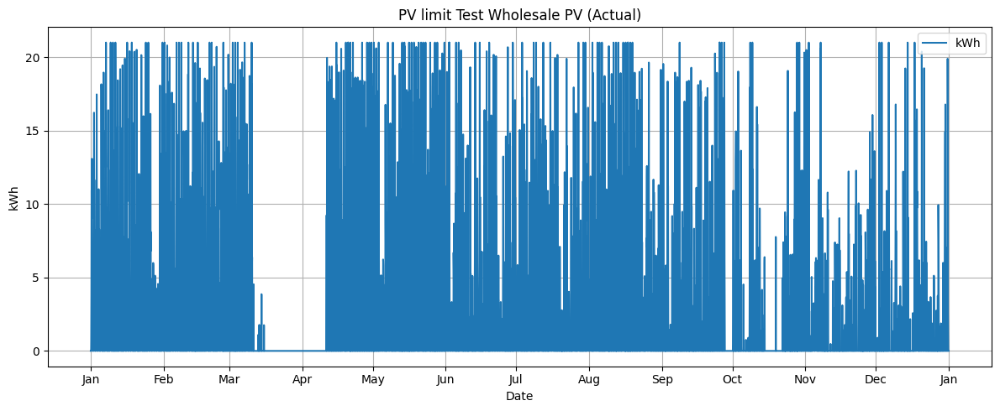

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

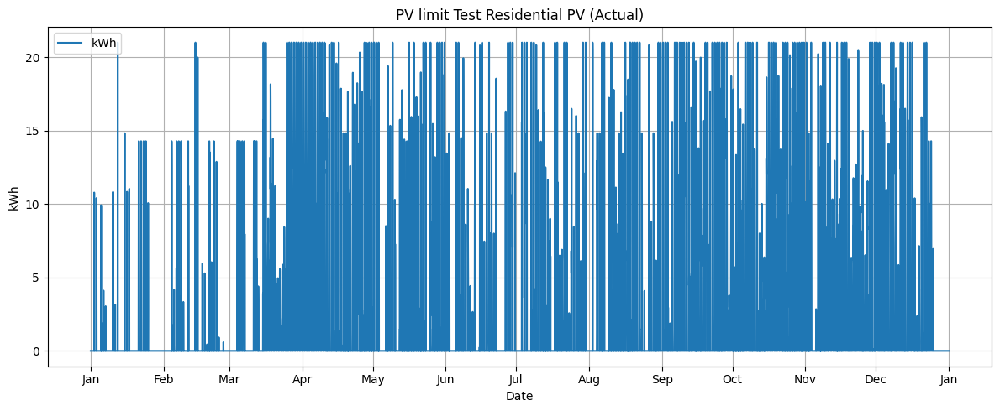

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

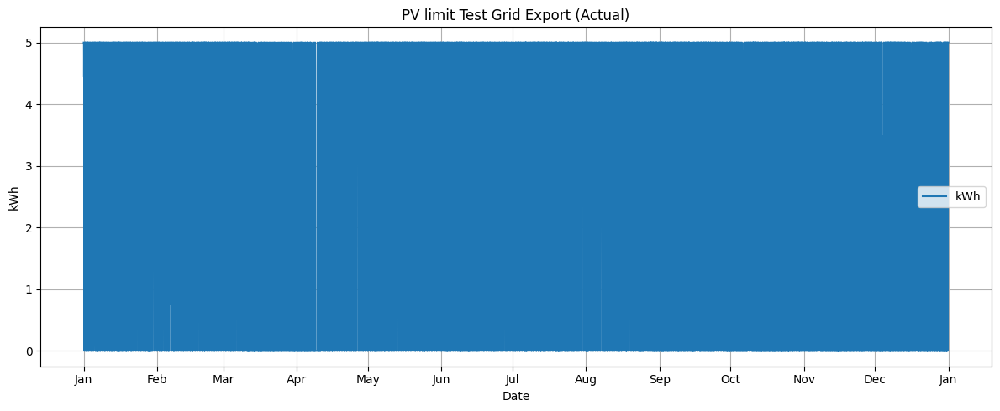

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

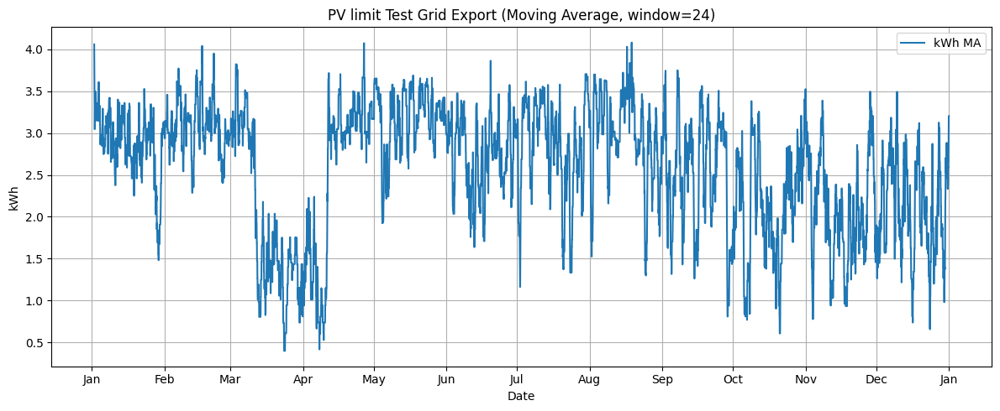

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

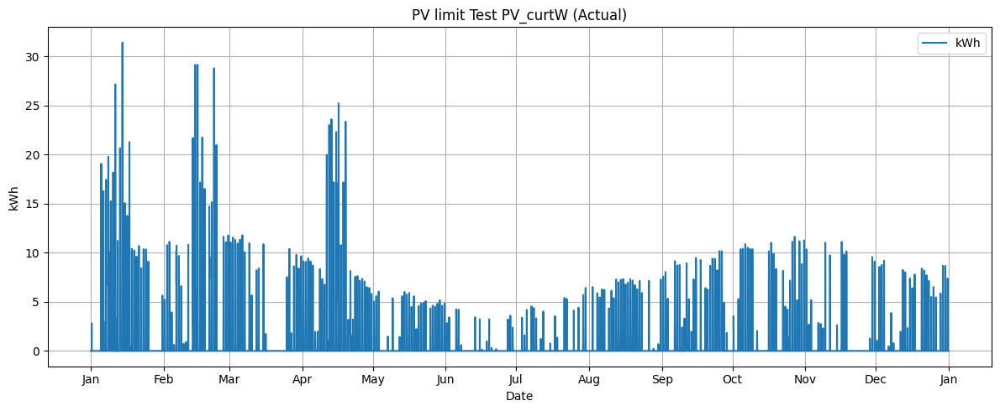

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

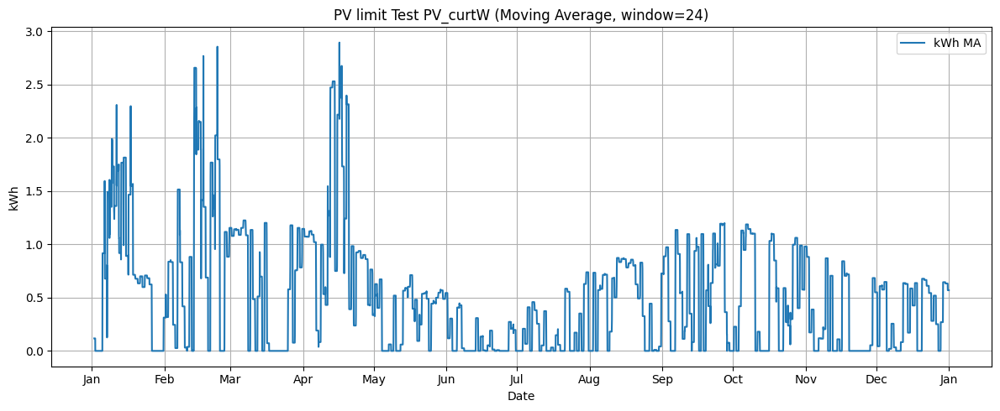

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

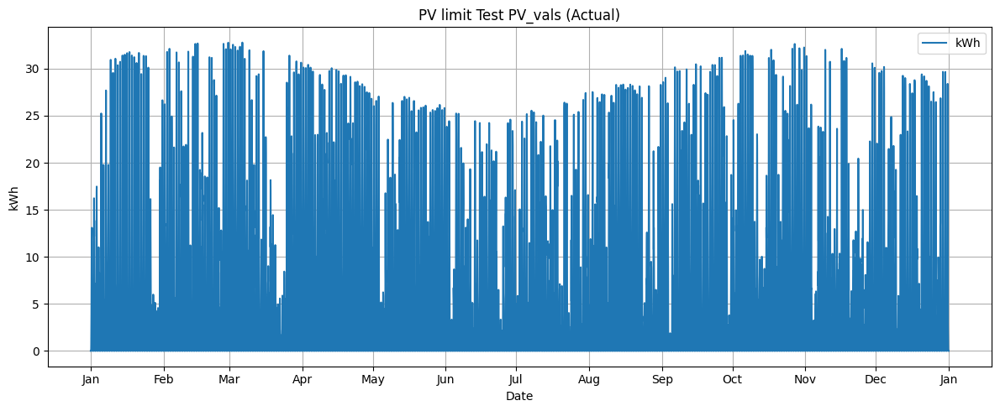

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

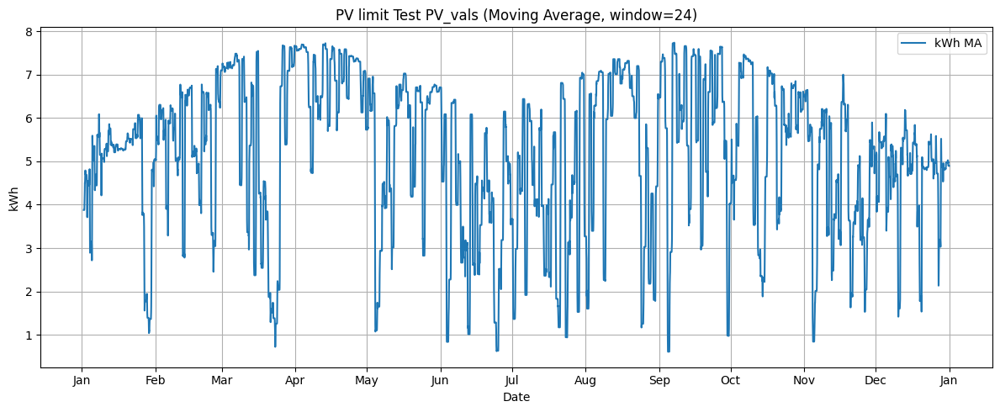

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Results exported to PV limit Test_results.xlsx


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Testing for V-15.2
for i in range(1, 13):
  months_to_plot = [i]
  mask = dates.month.isin(months_to_plot)
  filtered_dates = dates[mask]

  pv_vals = np.array([value(modelv1.PV[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': pv_vals}, f'{name}.{i} PV Generation', window=None)
  grid_exp_vals = np.array([value(modelv1.grid_exp_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': grid_exp_vals}, f'{name}.{i} Grid Export', window=24)

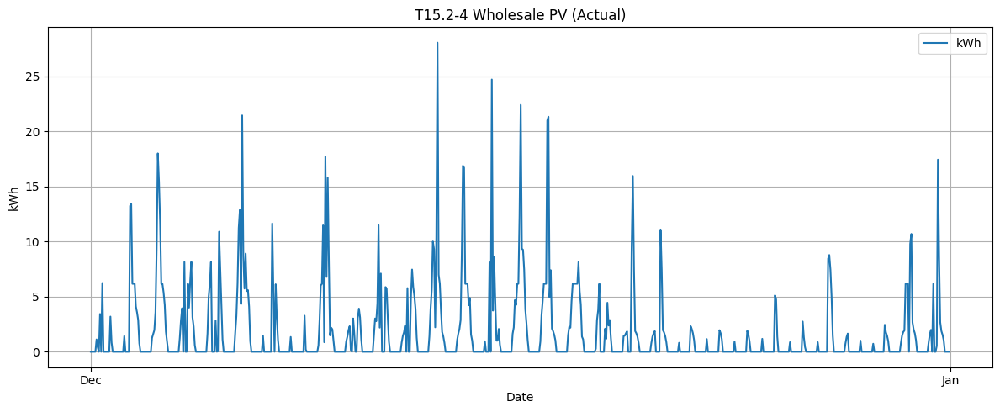

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

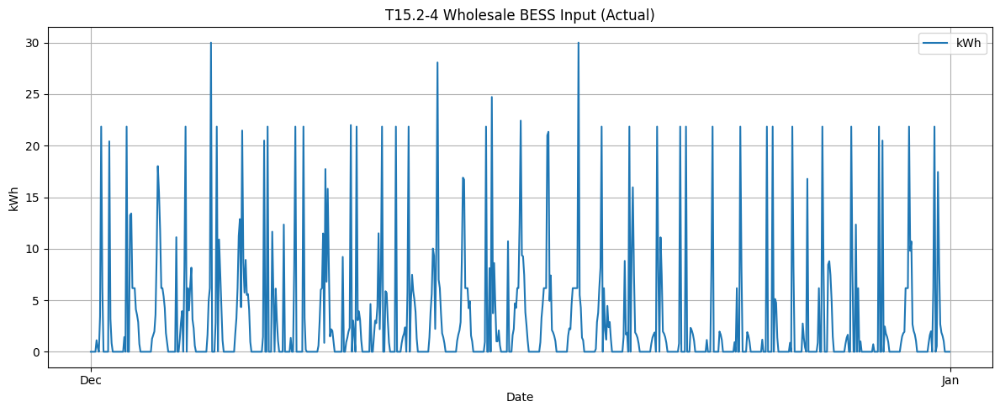

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

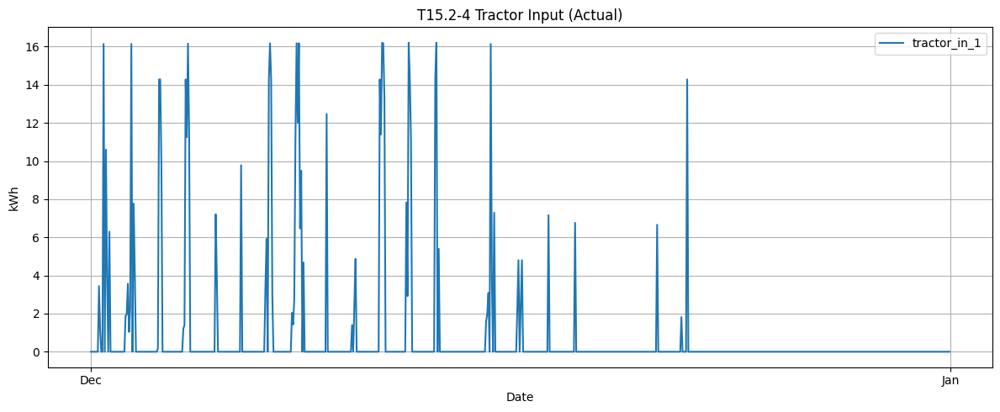

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Testing for V-15.3
for i in range(1, 13):
  months_to_plot = [i]
  mask = dates.month.isin(months_to_plot)
  filtered_dates = dates[mask]

  pv_vals = np.array([value(modelv1.PV[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': pv_vals}, f'{name}.{i} PV Generation', window=None)

  bess_in_w_vals = np.array([value(modelv1.BESS_in_W[t]) for t in timesteps])[mask]
  bess_in_r_vals = np.array([value(modelv1.BESS_in_R[t]) for t in timesteps])[mask]
  bess_in = bess_in_w_vals + bess_in_r_vals
  plot_series(filtered_dates, {'kWh': bess_in}, f'{name}.{i} BESS Input', window=None)

  tractor_in_series = {}
  tractor_in_PV_series = {}
  for n in modelv1.N:
      tractor_in_series[f'tractor_in_{n}'] = np.array([value(modelv1.tractor_in[t,n]) for t in timesteps])[mask]
      tractor_in_PV_series[f'tractor_in_PV_{n}'] = np.array([value(modelv1.tractor_in_PV[t,n]) for t in timesteps])[mask]
  tractor_in = {**tractor_in_series, **tractor_in_PV_series}
  plot_series(filtered_dates, tractor_in, f'{name}.{i} Tractor Input', window=None)


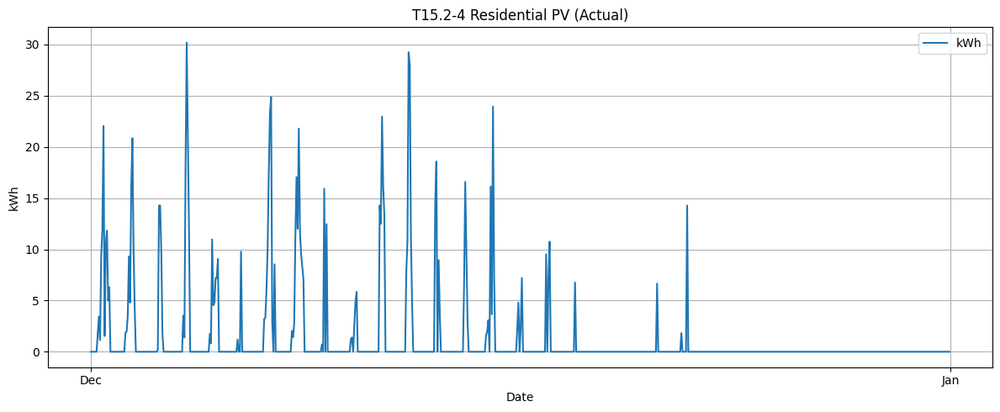

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

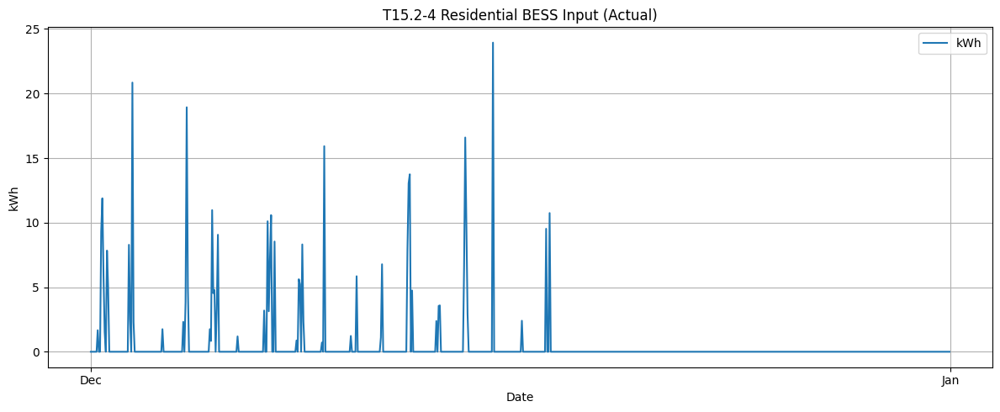

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

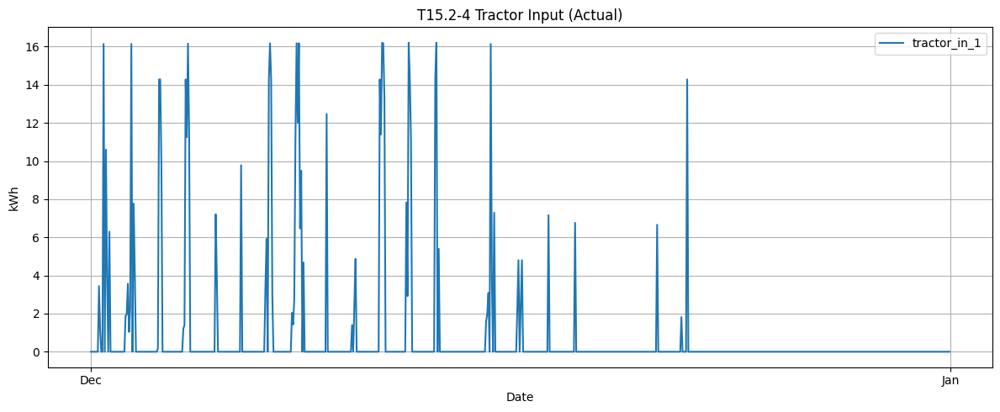

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Testing for V-15.4
months_to_plot = [i]
mask = dates.month.isin(months_to_plot)
filtered_dates = dates[mask]

pv_r_vals = np.array([value(modelv1.PV_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': pv_r_vals}, f'{name} Residential PV', window=None)
pv_w_vals = np.array([value(modelv1.PV_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': pv_w_vals}, f'{name} Wholesale PV', window=None)

# V-16

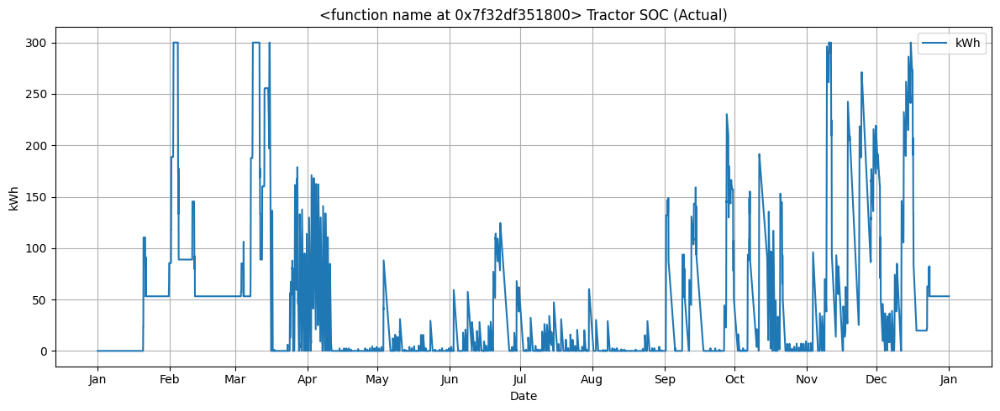

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

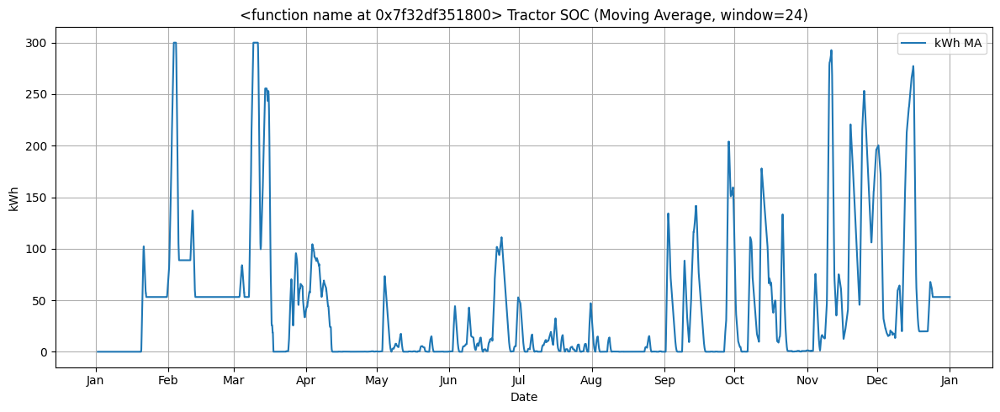

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

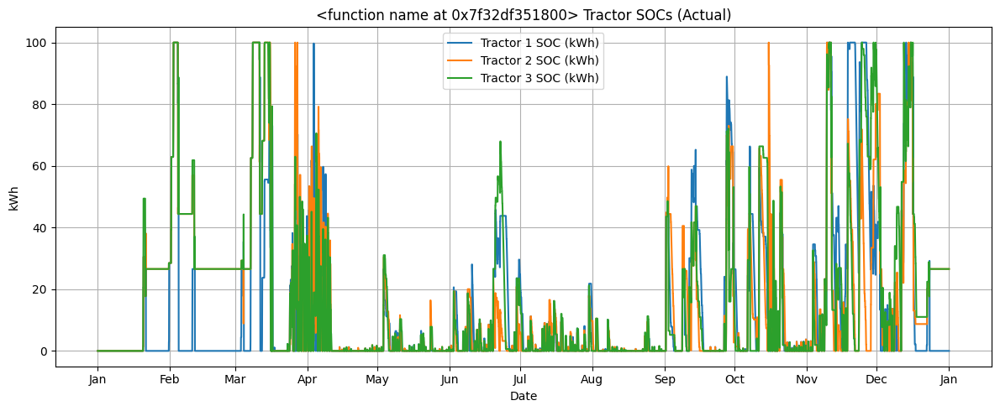

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

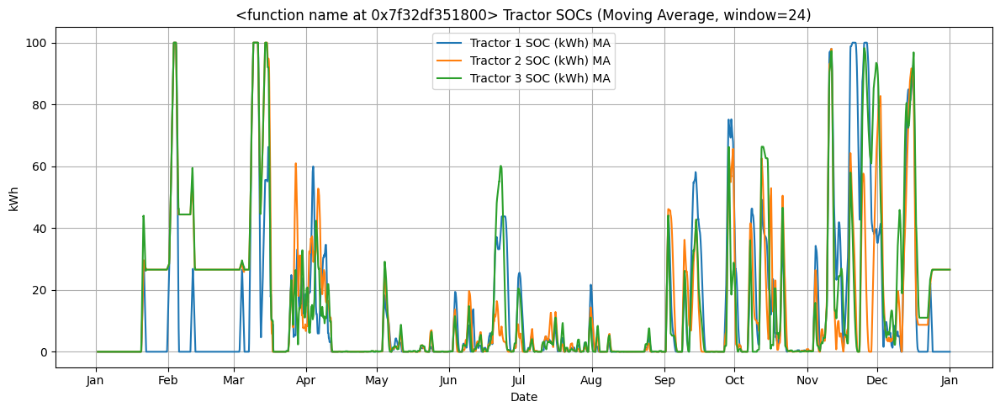

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

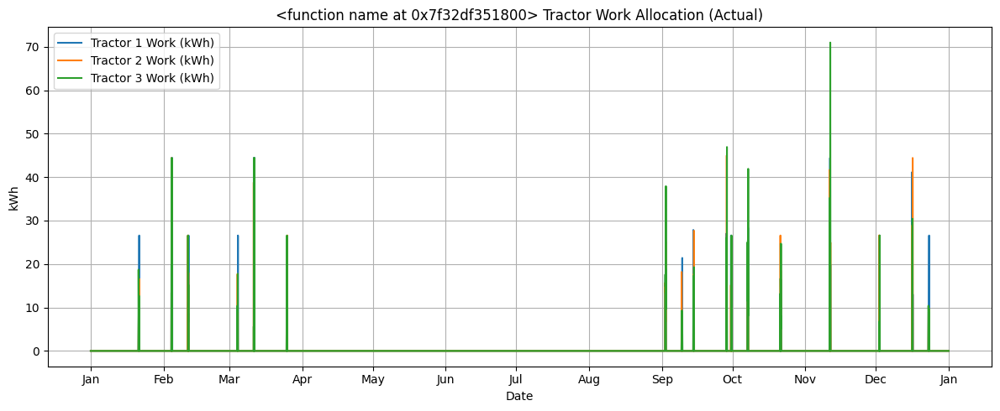

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

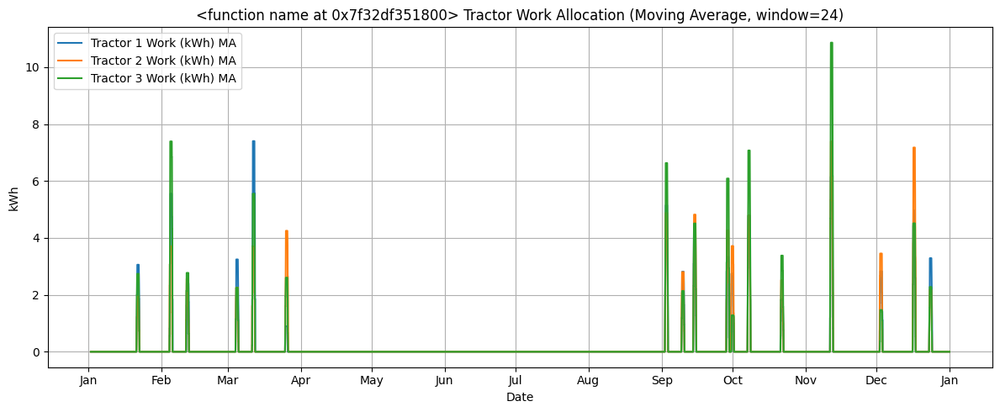

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

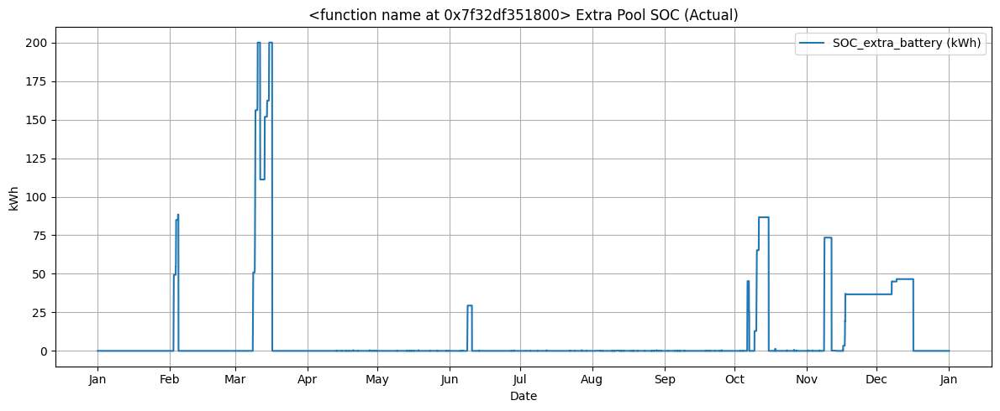

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

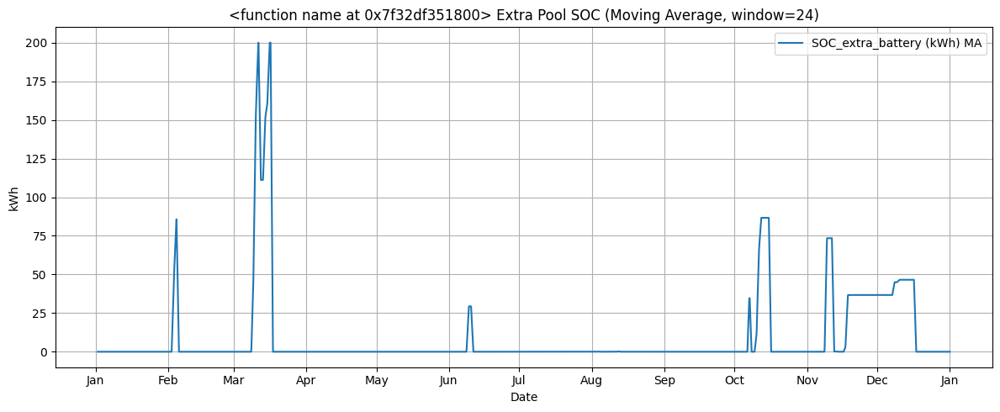

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

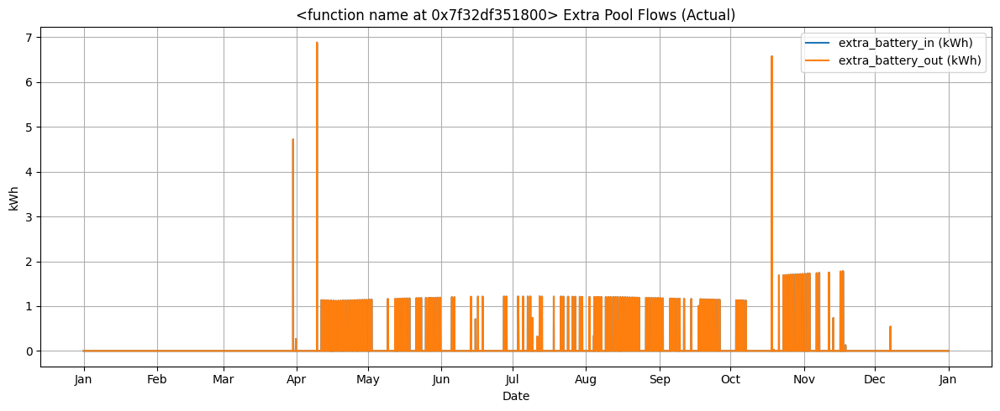

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

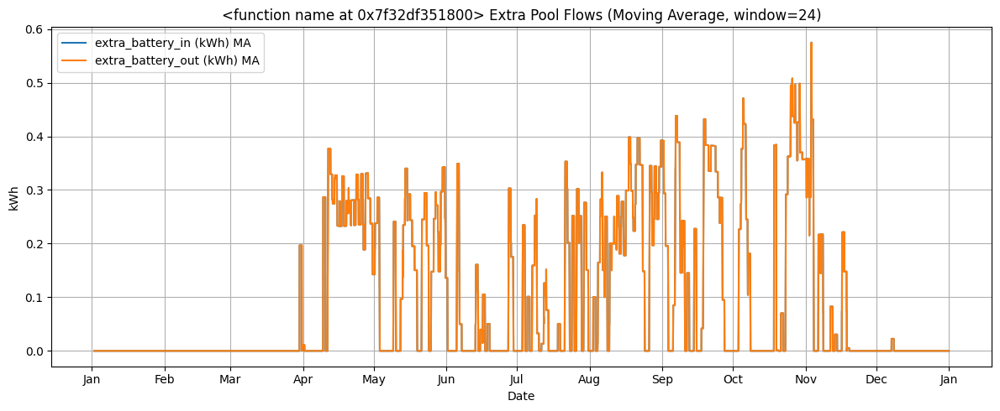

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

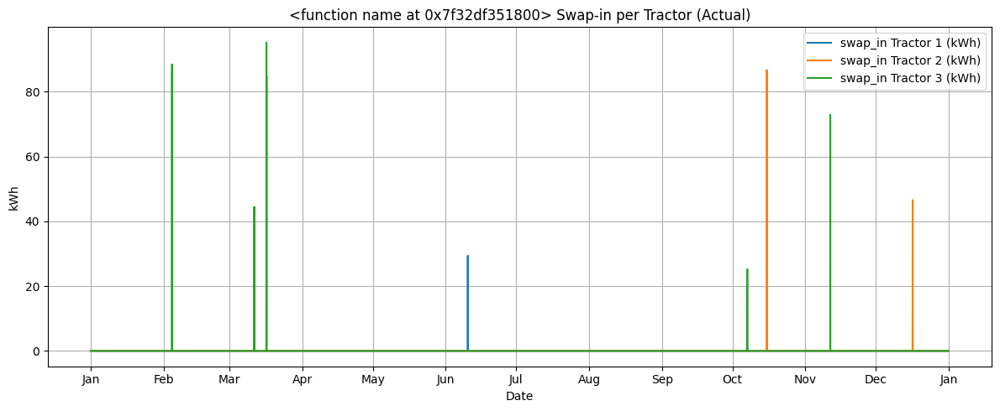

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

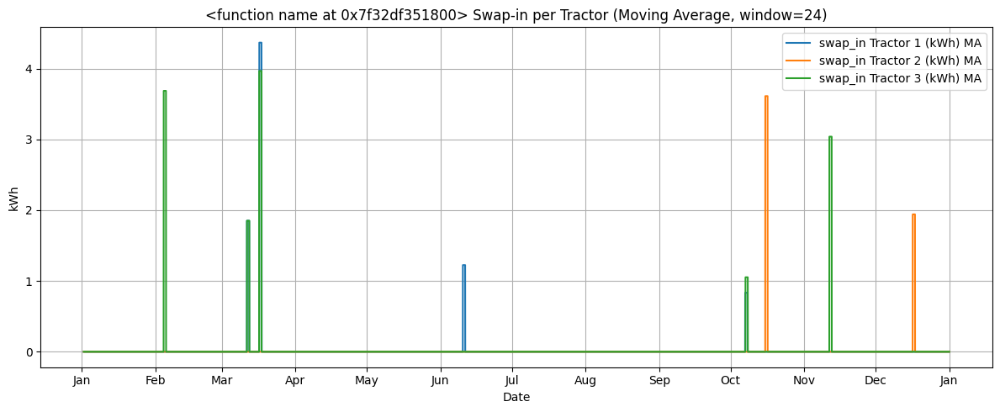

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
tractor_soc_series = {}
for n in modelv1.N:
    tractor_soc_series[f'SOC_tractor_{n}'] = np.array([value(modelv1.SOC_tractor[t,n]) for t in timesteps])[mask]
total_soc = np.sum(list(tractor_soc_series.values()), axis=0)
plot_series(filtered_dates, {"kWh": total_soc}, f'{name} Tractor SOC', window=24)

# V-17

In [ ]:
# Testing for V-17
# T17.2
for i in range(1, 13):
  months_to_plot = [i]
  mask = dates.month.isin(months_to_plot)
  filtered_dates = dates[mask]

  grid_exp_w_vals = np.array([value(modelv1.grid_exp_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': grid_exp_w_vals}, f'{name} Wholesale Export', window=24)
  price_w_vals = np.array([value(modelv1.price_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'$': price_w_vals}, f'{name} Wholesale Prices', window=24)

# T17.3
for i in range(1, 13):
  months_to_plot = [i]
  mask = dates.month.isin(months_to_plot)
  filtered_dates = dates[mask]

  soc_bess_r_vals = np.array([value(modelv1.SOC_BESS_R[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': soc_bess_r_vals}, f'{name} Residential BESS SOC', window=24)
  pv_r_vals = np.array([value(modelv1.PV_R[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': pv_r_vals}, f'{name} Residential PV', window=24)

# T17.4
for i in range(1, 13):
  months_to_plot = [i]
  mask = dates.month.isin(months_to_plot)
  filtered_dates = dates[mask]

  soc_bess_w_vals = np.array([value(modelv1.SOC_BESS_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': soc_bess_w_vals}, f'{name} Wholesale BESS SOC', window=24)
  pv_w_vals = np.array([value(modelv1.PV_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': pv_w_vals}, f'{name} Wholesale PV', window=24)

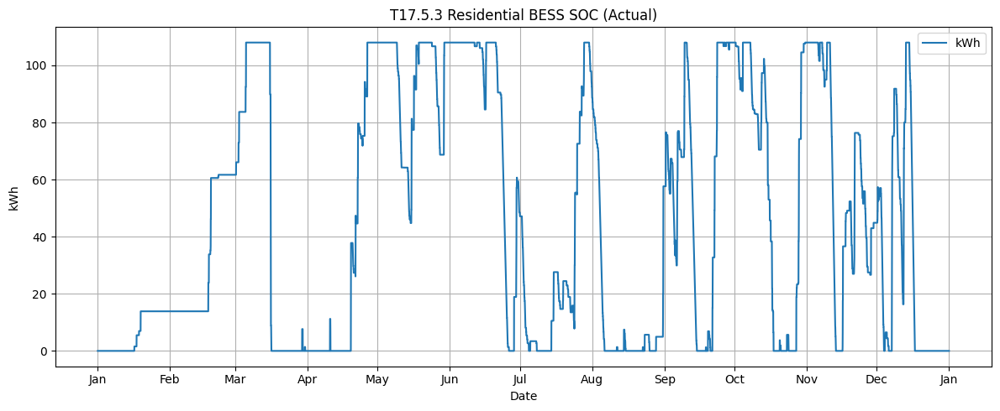

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

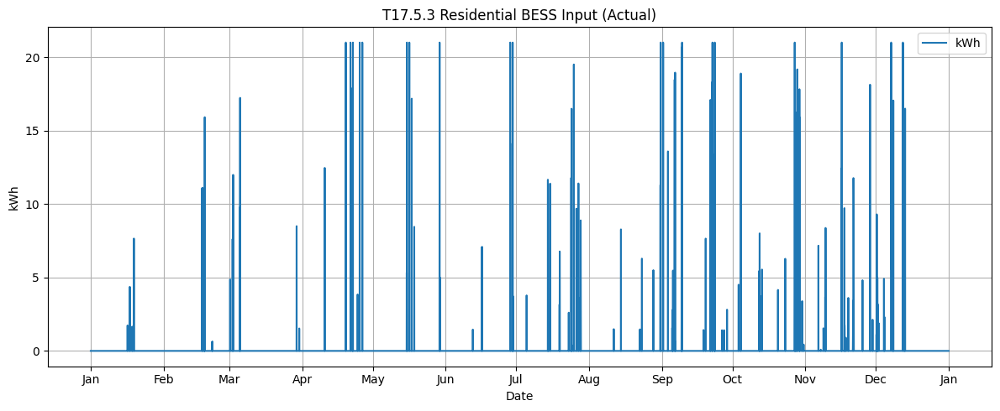

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

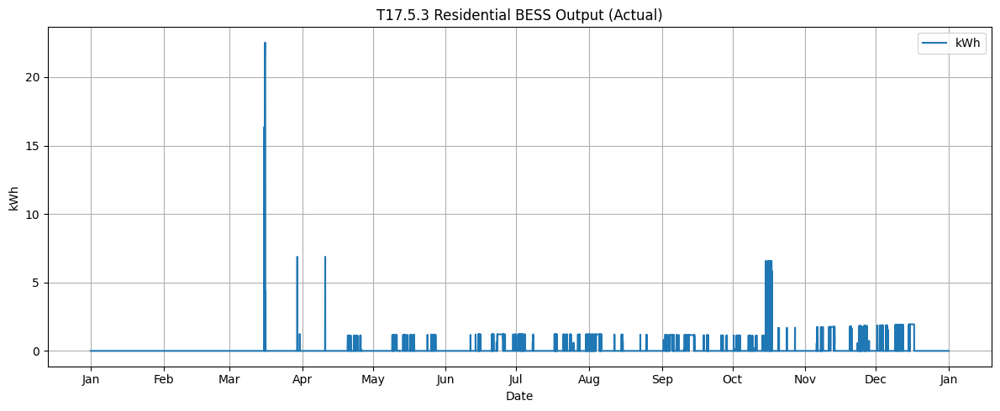

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

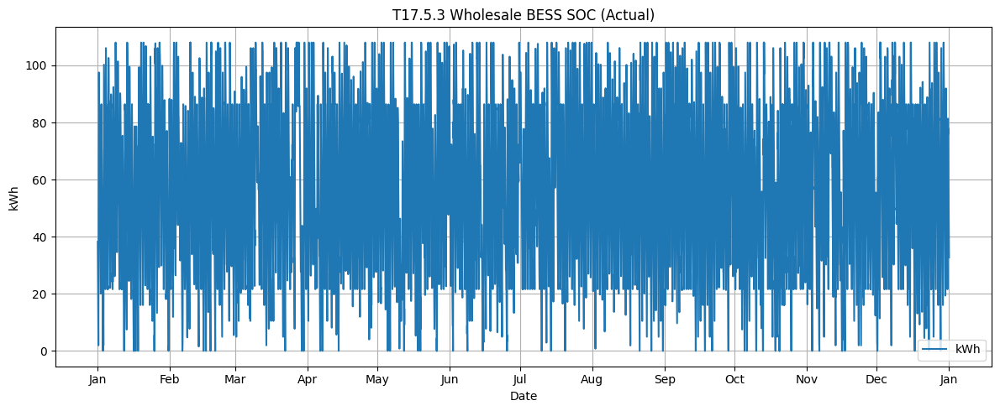

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

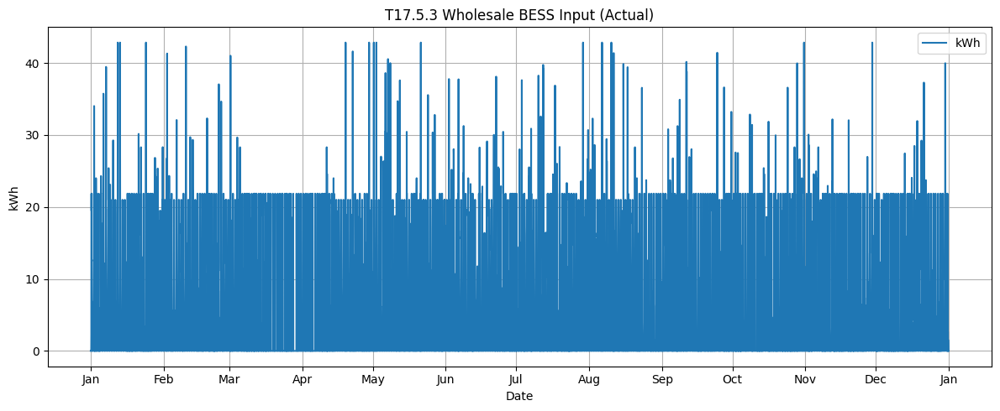

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

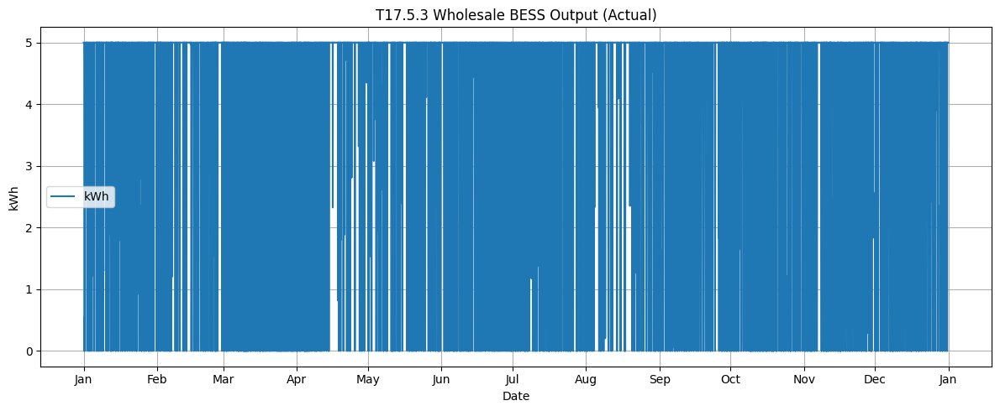

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [151]:
# T17.5
months_to_plot = Year
mask = dates.month.isin(months_to_plot)
filtered_dates = dates[mask]
soc_bess_r_vals = np.array([value(modelv1.SOC_BESS_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': soc_bess_r_vals}, f'{name} Residential BESS SOC', window=None)
bess_in_r_vals = np.array([value(modelv1.BESS_in_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': bess_in_r_vals}, f'{name} Residential BESS Input', window=None)
bess_out_r_vals = np.array([value(modelv1.BESS_out_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': bess_out_r_vals}, f'{name} Residential BESS Output', window=None)

soc_bess_w_vals = np.array([value(modelv1.SOC_BESS_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': soc_bess_w_vals}, f'{name} Wholesale BESS SOC', window=None)
bess_in_w_vals = np.array([value(modelv1.BESS_in_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': bess_in_w_vals}, f'{name} Wholesale BESS Input', window=None)
bess_out_w_vals = np.array([value(modelv1.BESS_out_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': bess_out_w_vals}, f'{name} Wholesale BESS Output', window=None)


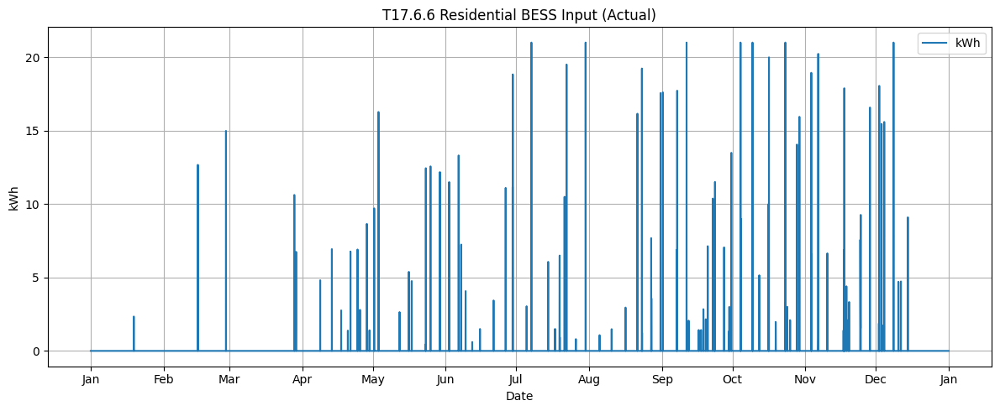

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

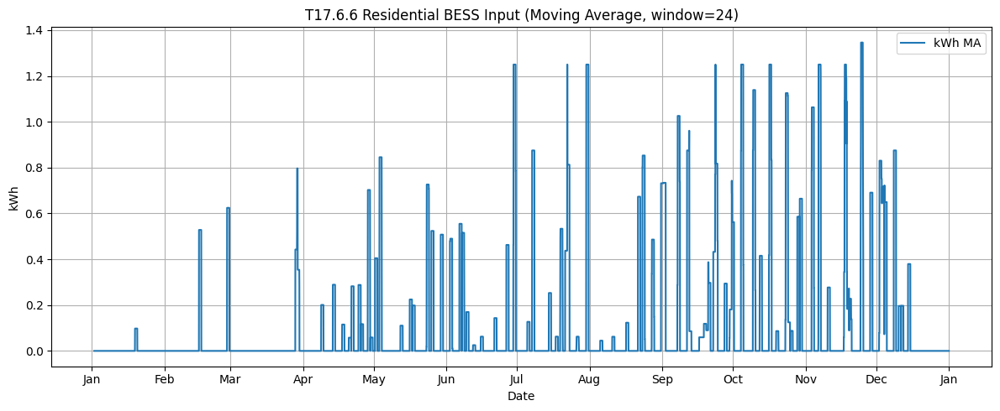

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

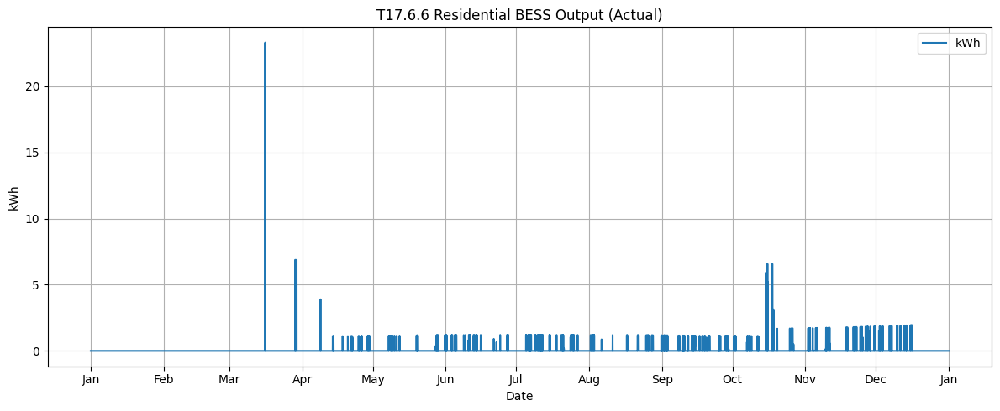

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

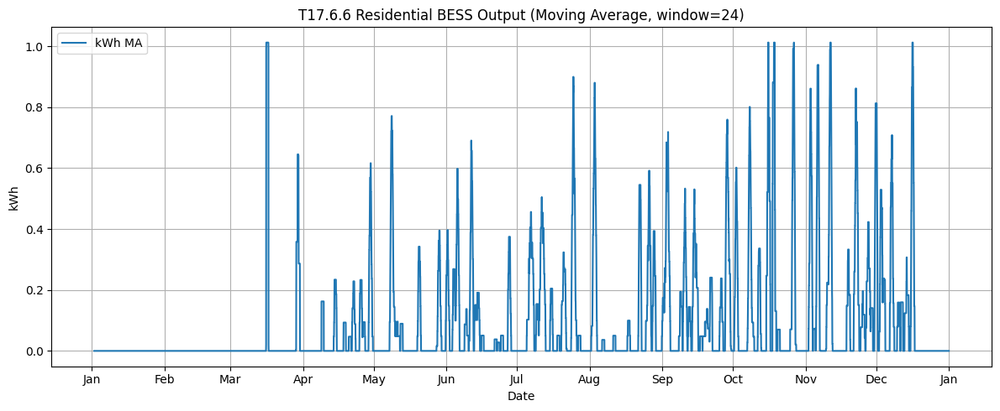

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

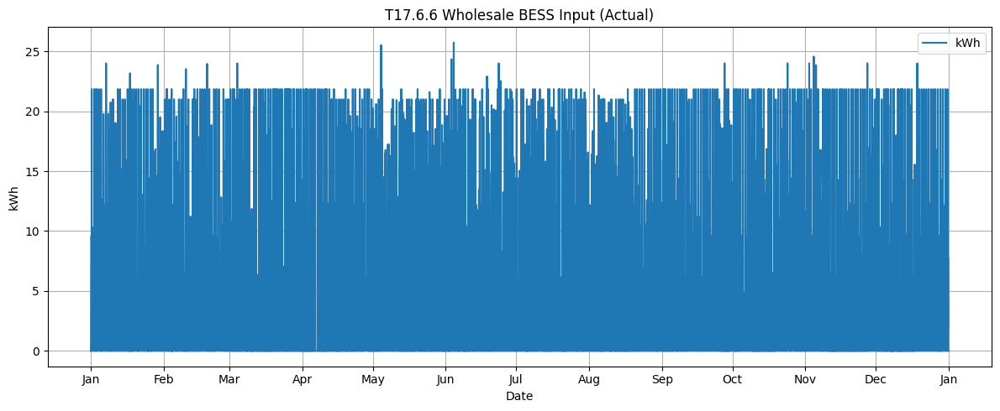

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

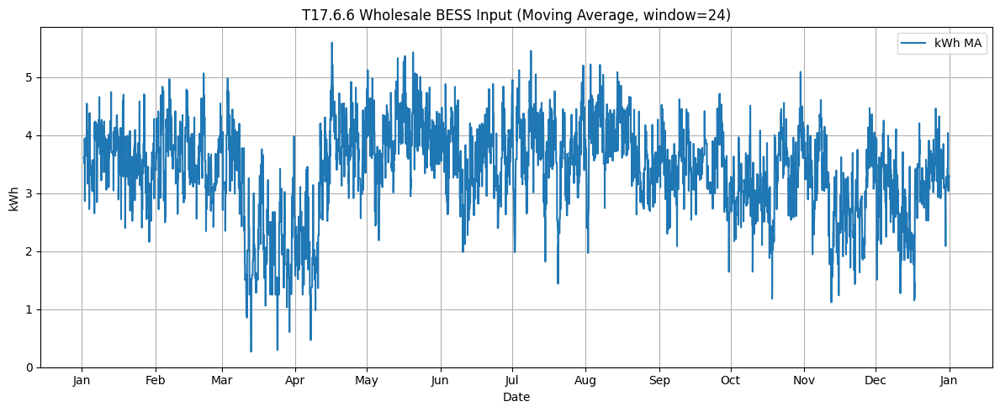

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

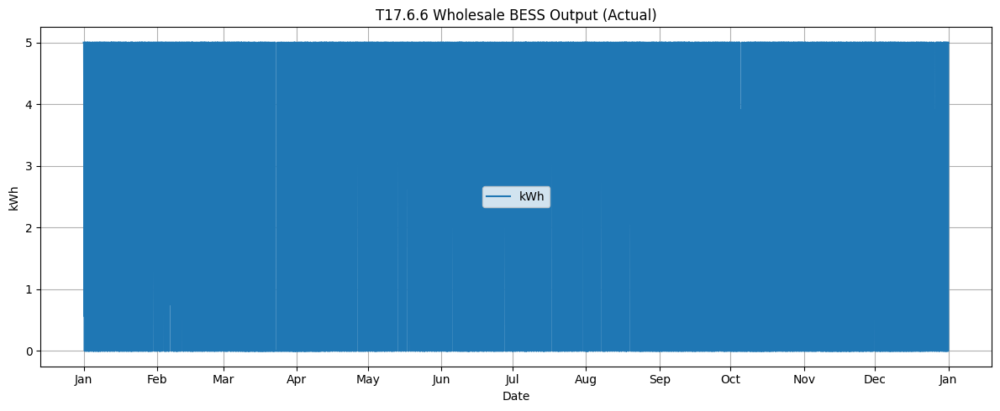

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

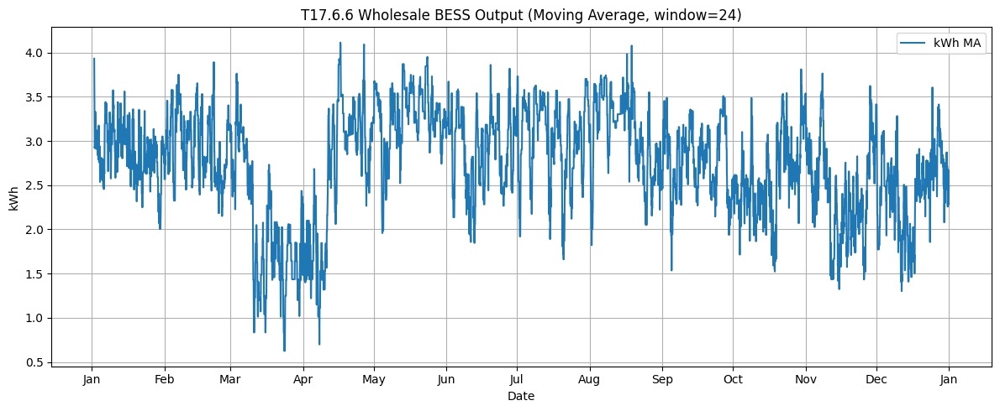

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

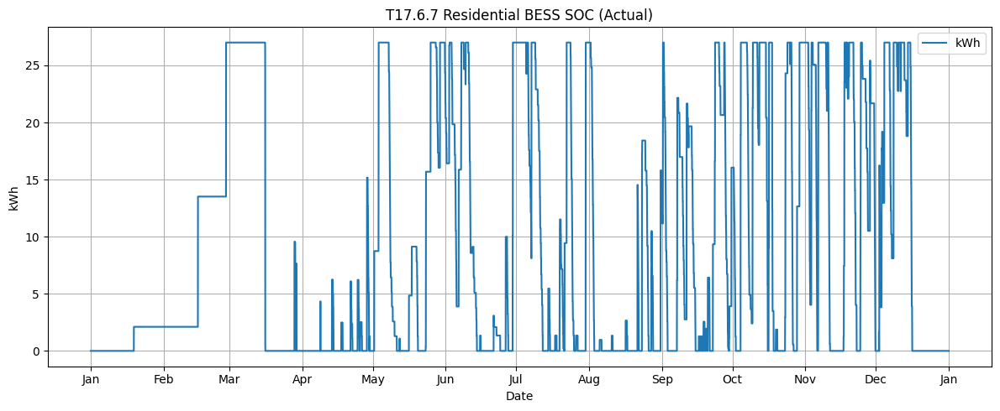

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

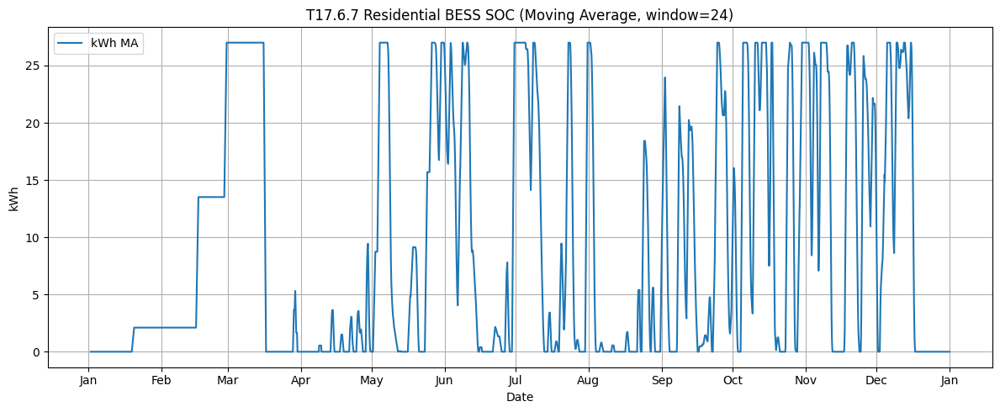

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

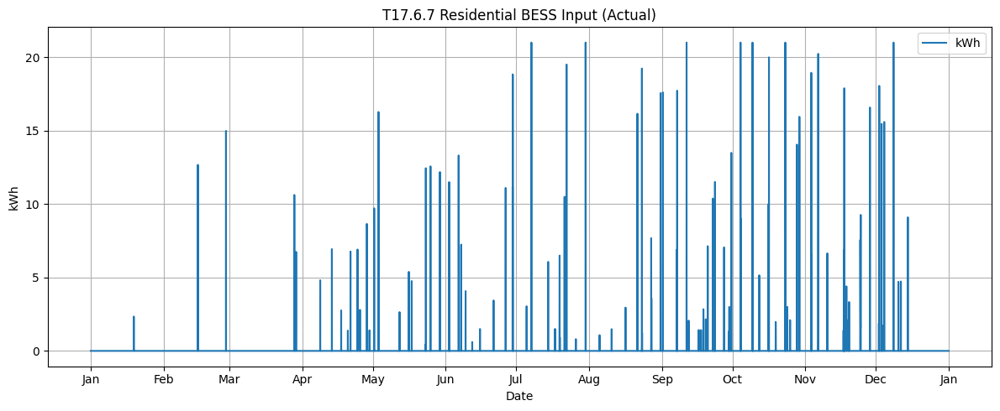

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

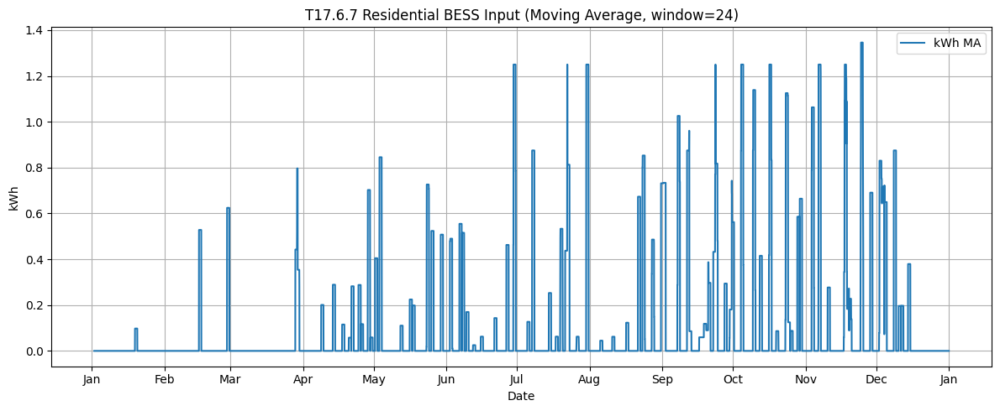

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

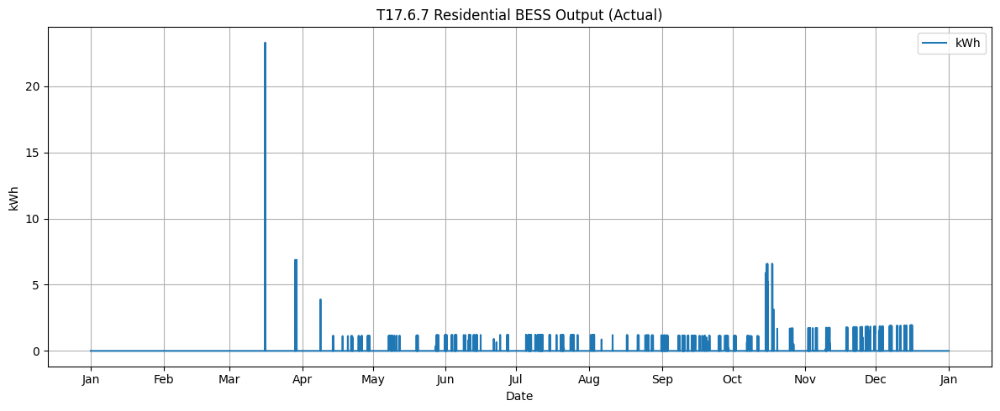

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

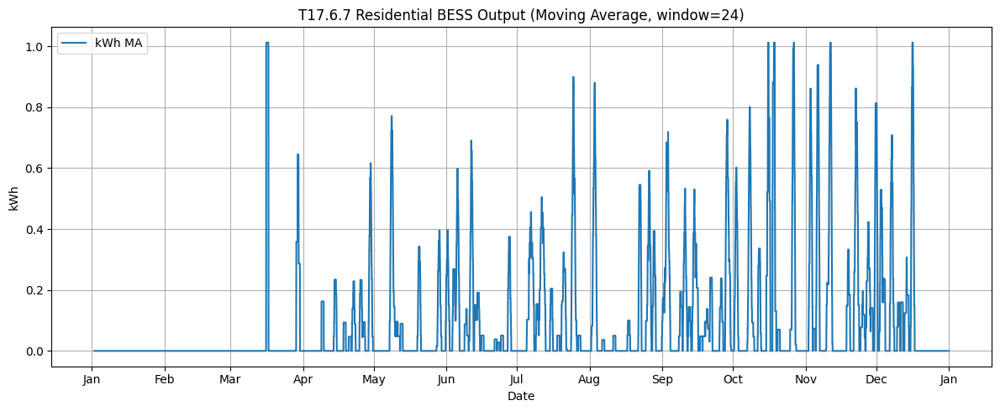

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

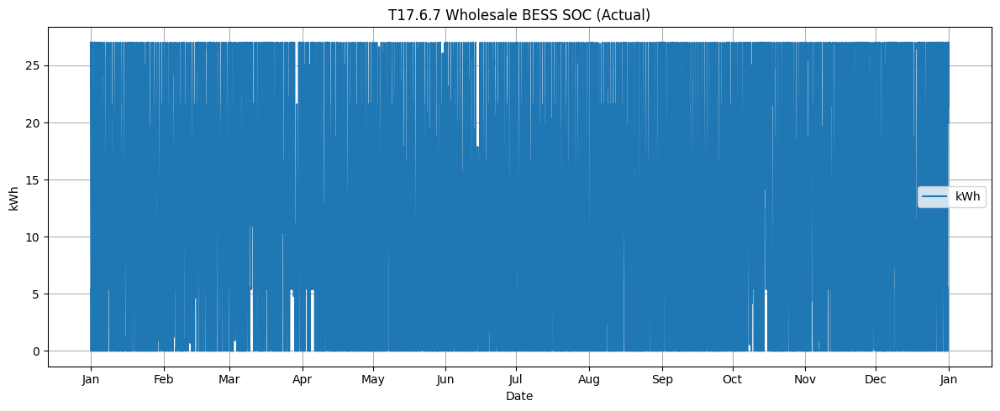

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

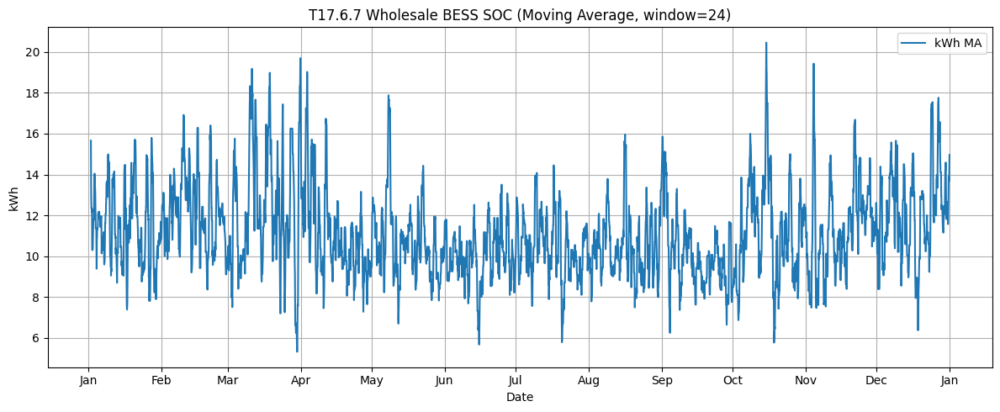

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

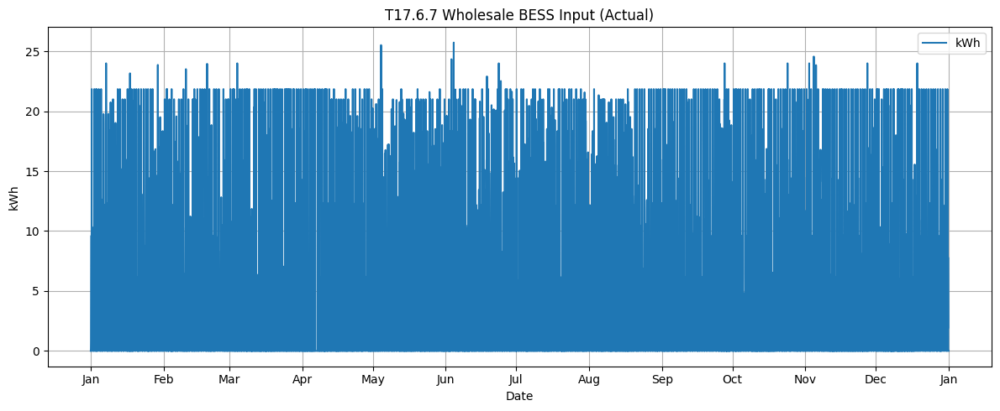

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

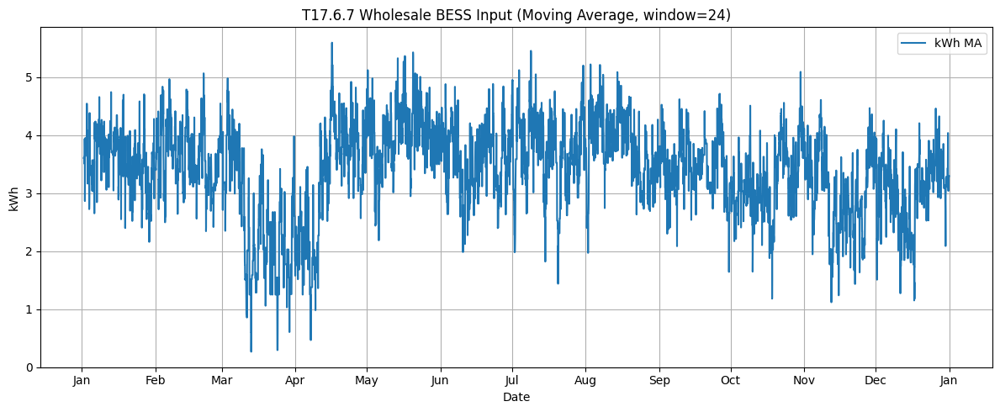

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

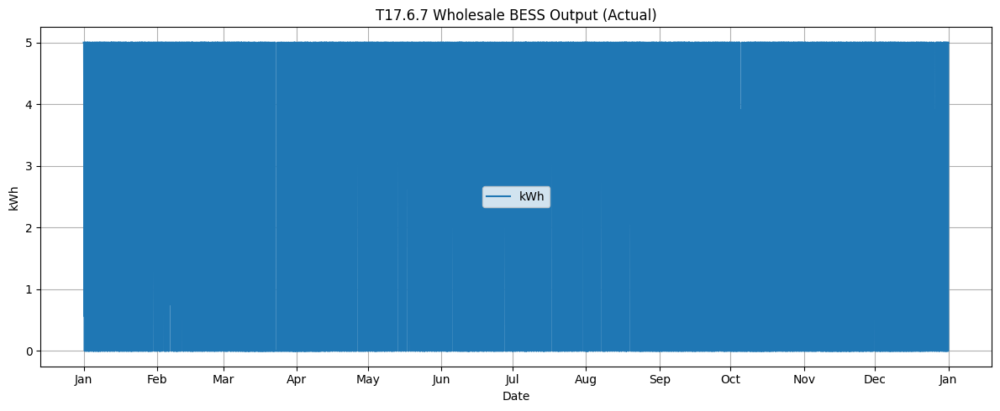

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

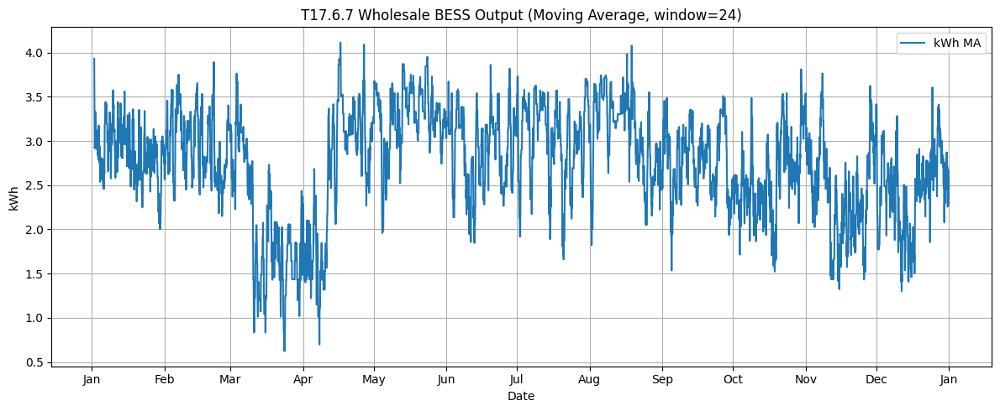

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

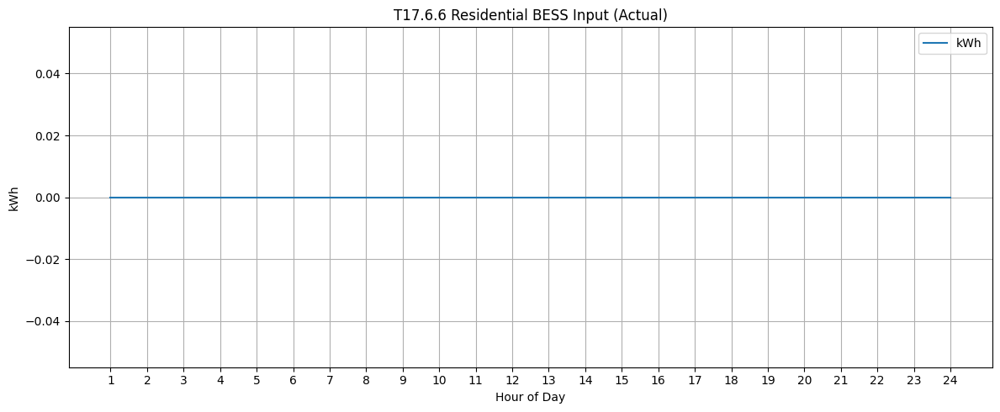

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

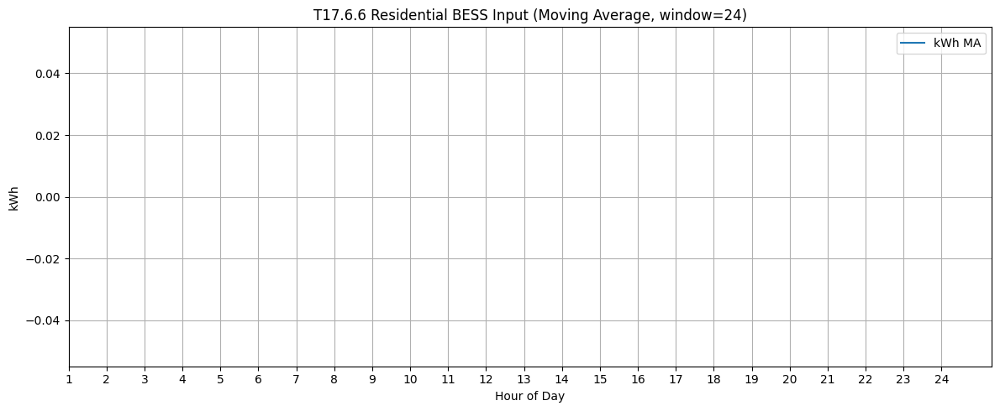

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

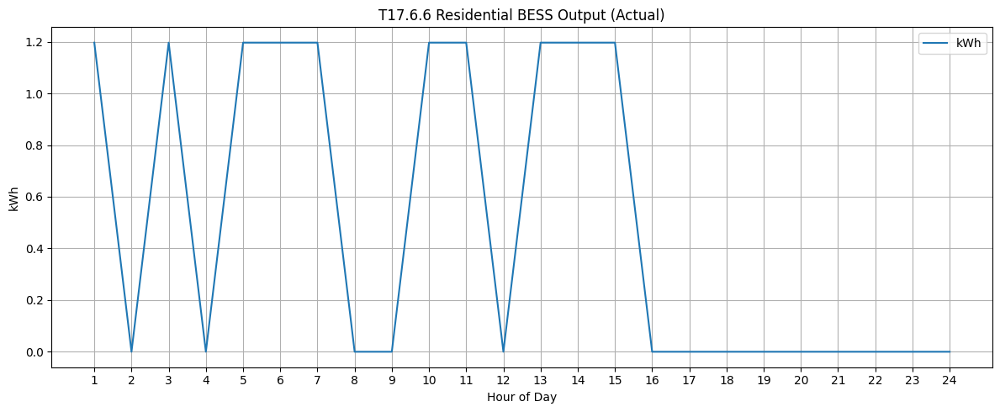

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

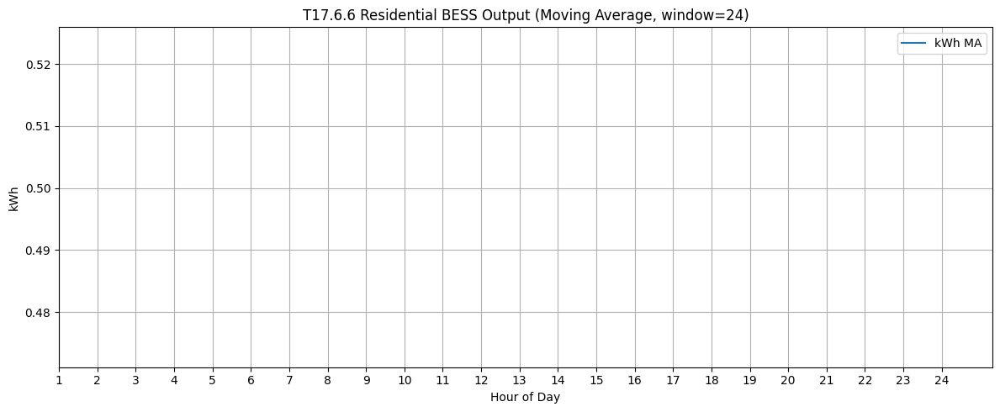

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

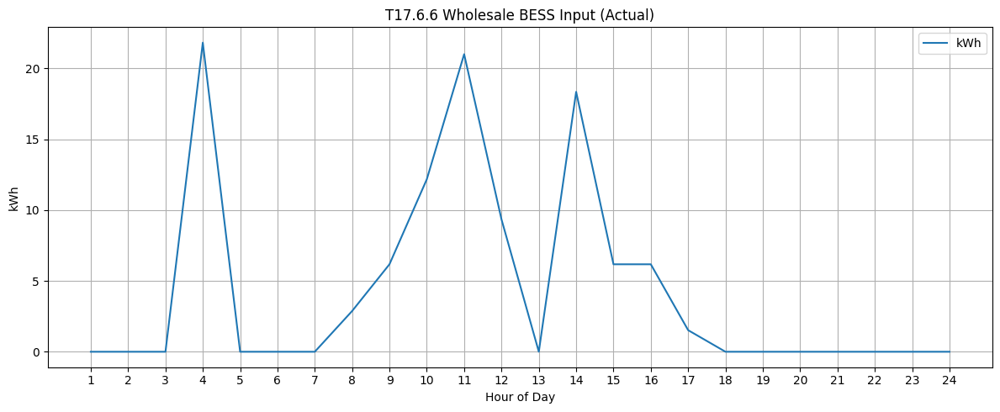

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

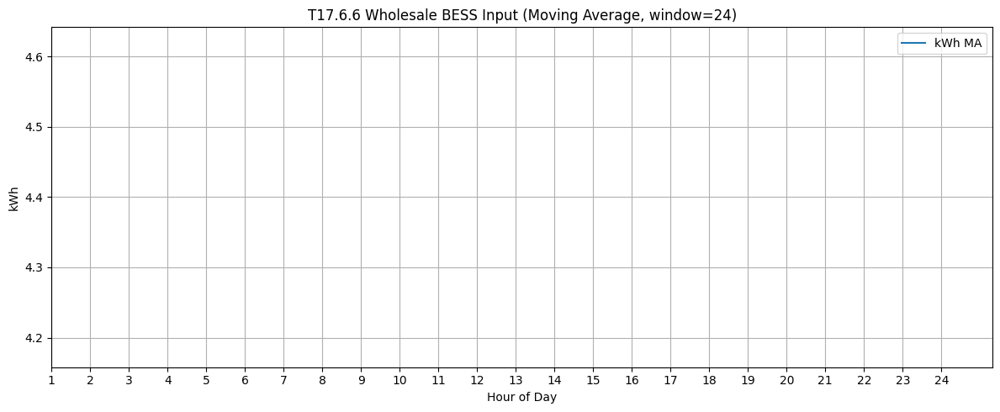

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

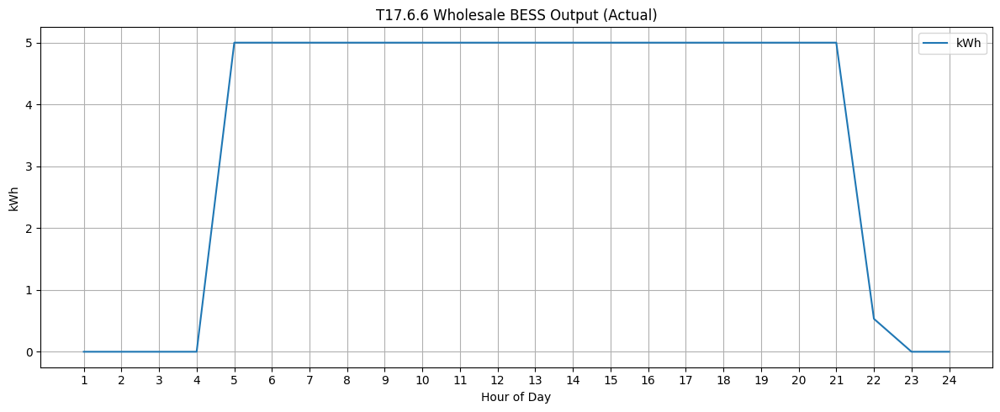

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

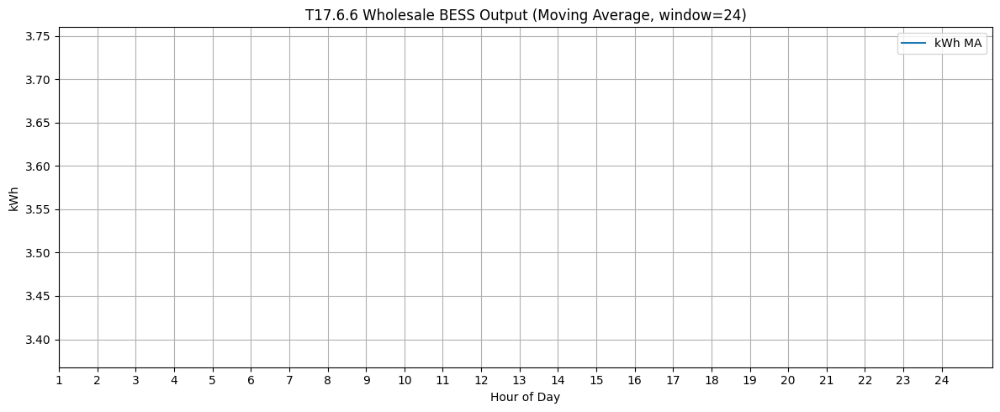

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

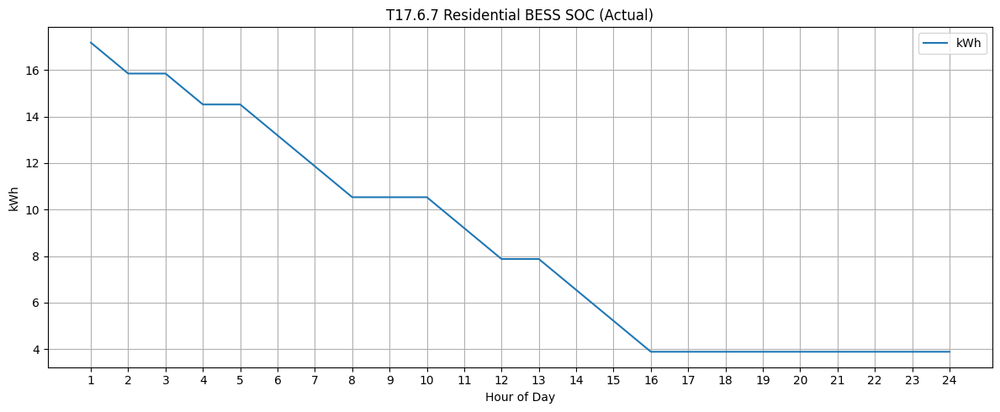

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

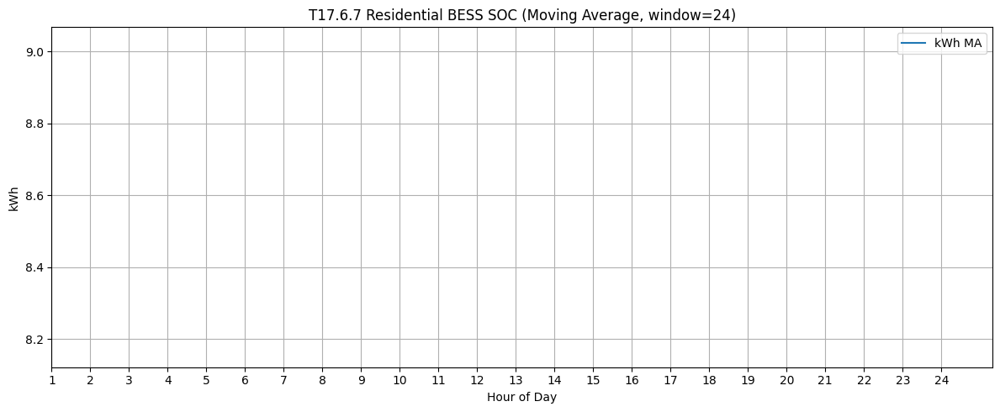

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

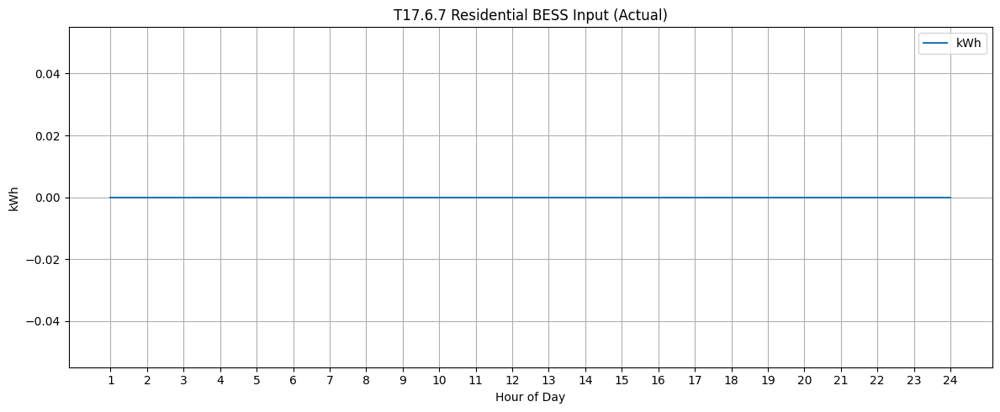

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

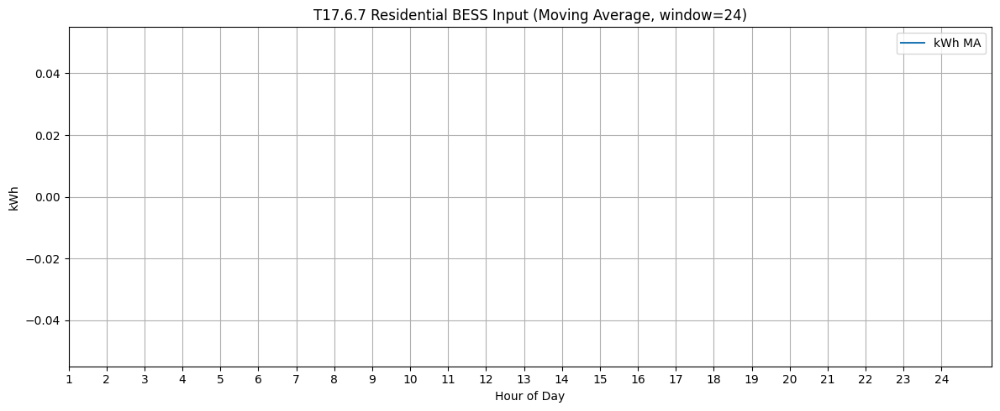

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

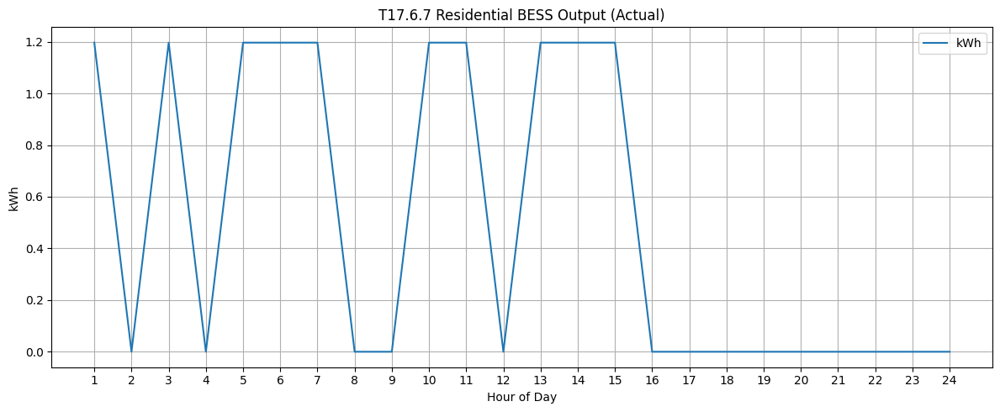

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

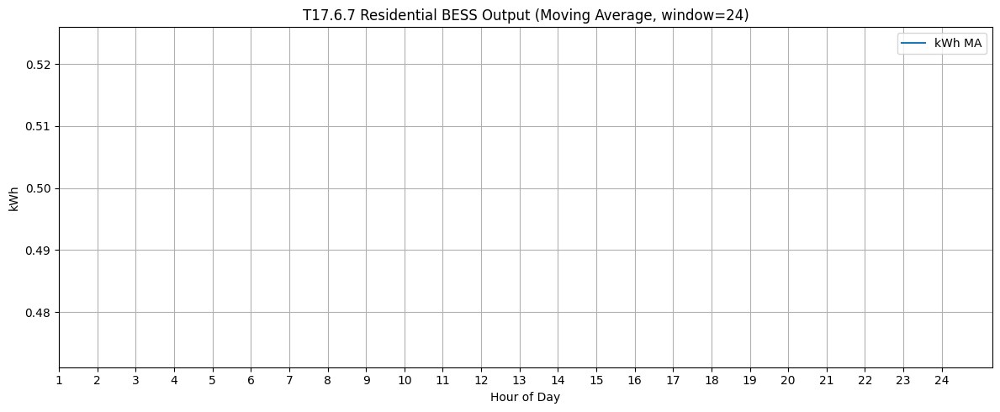

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

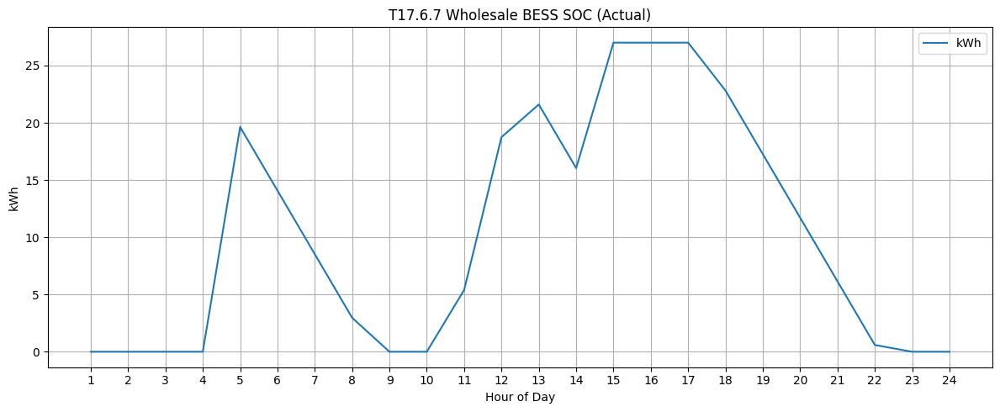

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

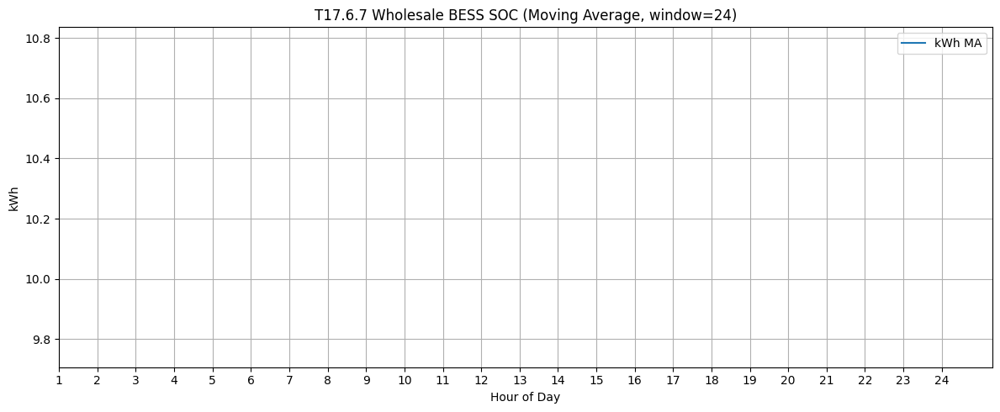

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

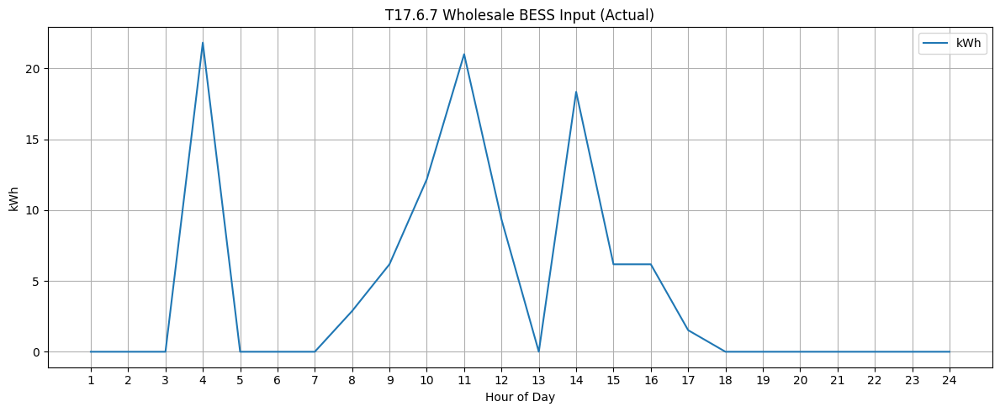

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

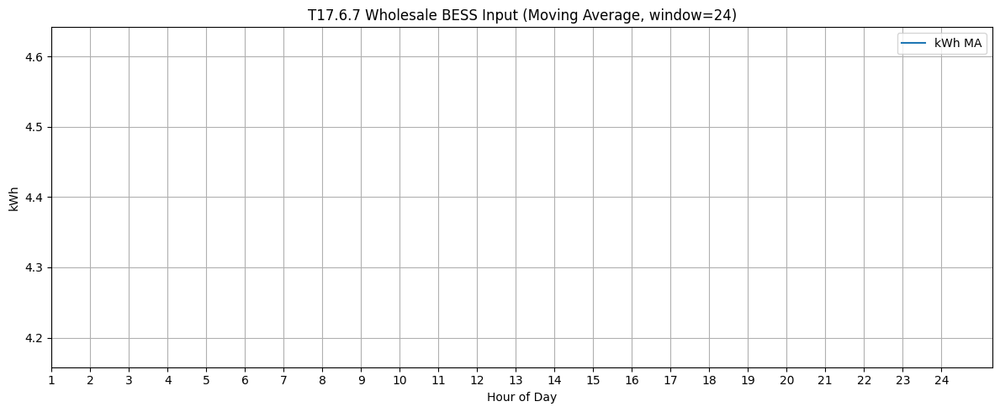

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

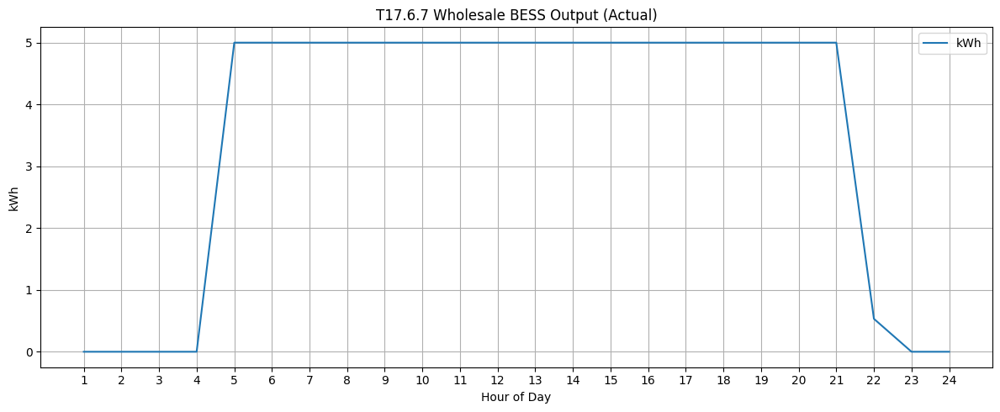

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

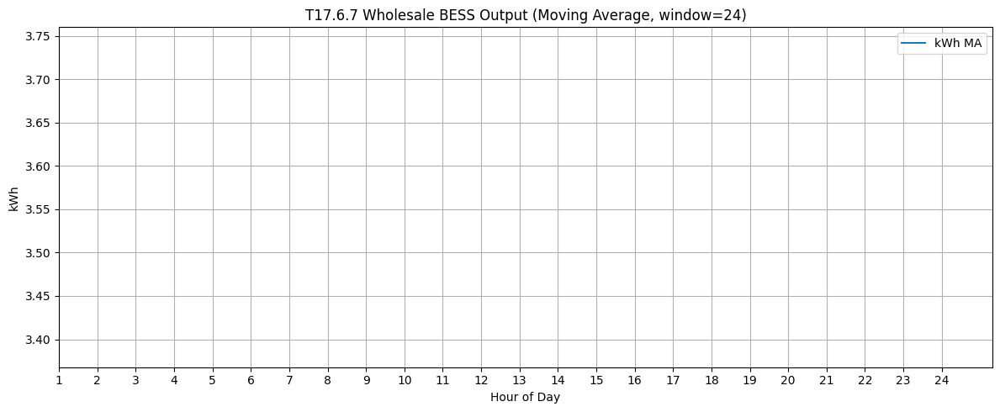

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [11]:
# T17.6
for i in range(1, 3):
  if i == 1:
    months_to_plot = Year
    mask = dates.month.isin(months_to_plot)
    filtered_dates = dates[mask]
  if i == 2:
    months_to_plot = [6]
    mask = dates.month.isin(months_to_plot) & (dates.day == 5)
    filtered_dates = dates[mask]

  # T17.6
  bess_in_r_vals = np.array([value(modelv1.BESS_in_R[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': bess_in_r_vals}, f'{name}.6 Residential BESS Input', window=24)
  bess_out_r_vals = np.array([value(modelv1.BESS_out_R[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': bess_out_r_vals}, f'{name}.6 Residential BESS Output', window=24)

  bess_in_w_vals = np.array([value(modelv1.BESS_in_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': bess_in_w_vals}, f'{name}.6 Wholesale BESS Input', window=24)
  bess_out_w_vals = np.array([value(modelv1.BESS_out_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': bess_out_w_vals}, f'{name}.6 Wholesale BESS Output', window=24)

  # T17.7
  soc_bess_r_vals = np.array([value(modelv1.SOC_BESS_R[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': soc_bess_r_vals}, f'{name}.7 Residential BESS SOC', window=24)
  bess_in_r_vals = np.array([value(modelv1.BESS_in_R[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': bess_in_r_vals}, f'{name}.7 Residential BESS Input', window=24)
  bess_out_r_vals = np.array([value(modelv1.BESS_out_R[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': bess_out_r_vals}, f'{name}.7 Residential BESS Output', window=24)

  soc_bess_w_vals = np.array([value(modelv1.SOC_BESS_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': soc_bess_w_vals}, f'{name}.7 Wholesale BESS SOC', window=24)
  bess_in_w_vals = np.array([value(modelv1.BESS_in_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': bess_in_w_vals}, f'{name}.7 Wholesale BESS Input', window=24)
  bess_out_w_vals = np.array([value(modelv1.BESS_out_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': bess_out_w_vals}, f'{name}.7 Wholesale BESS Output', window=24)

# V-18

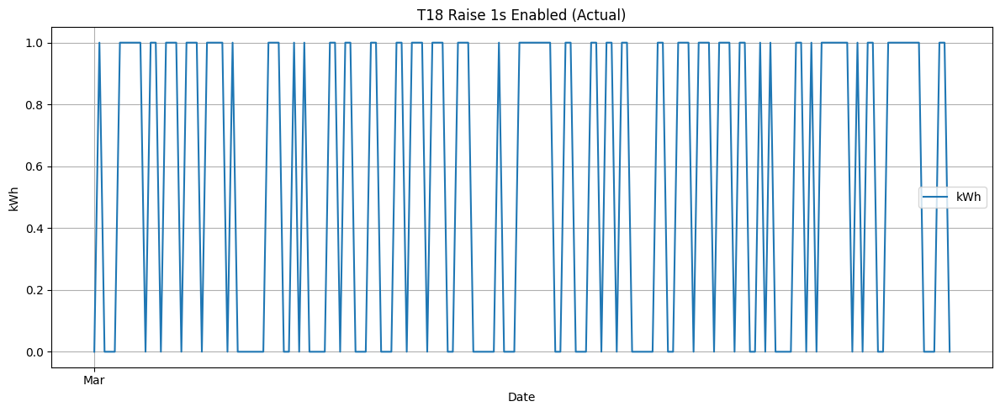

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

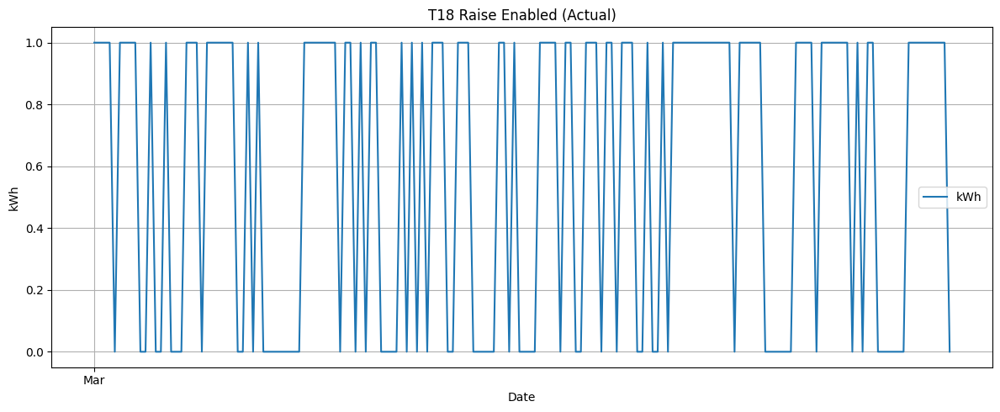

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

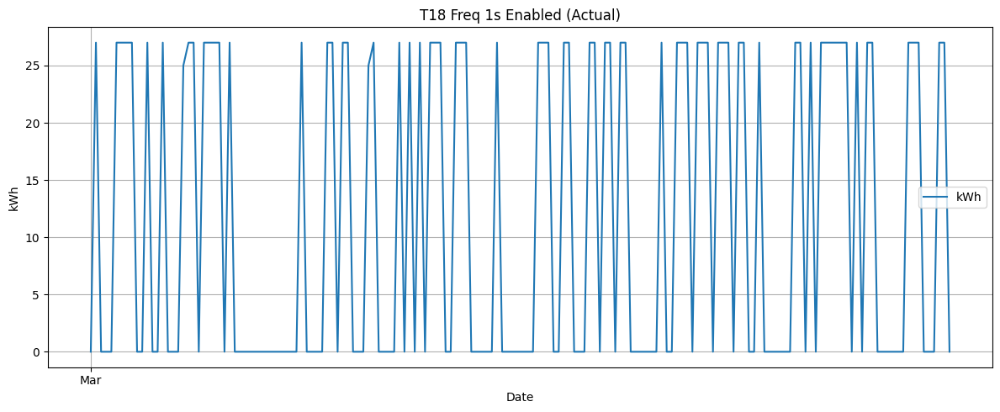

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

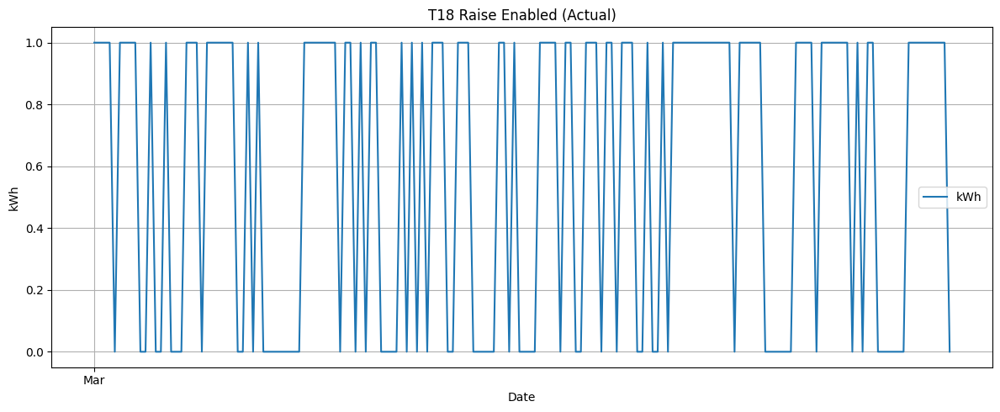

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

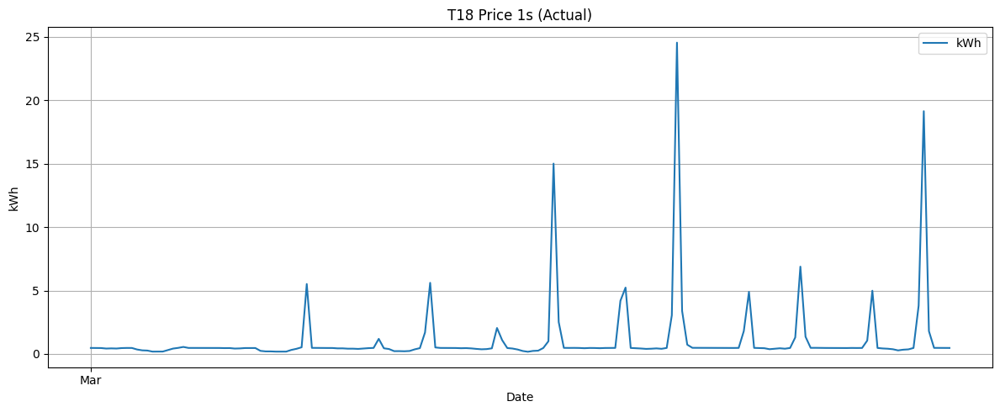

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

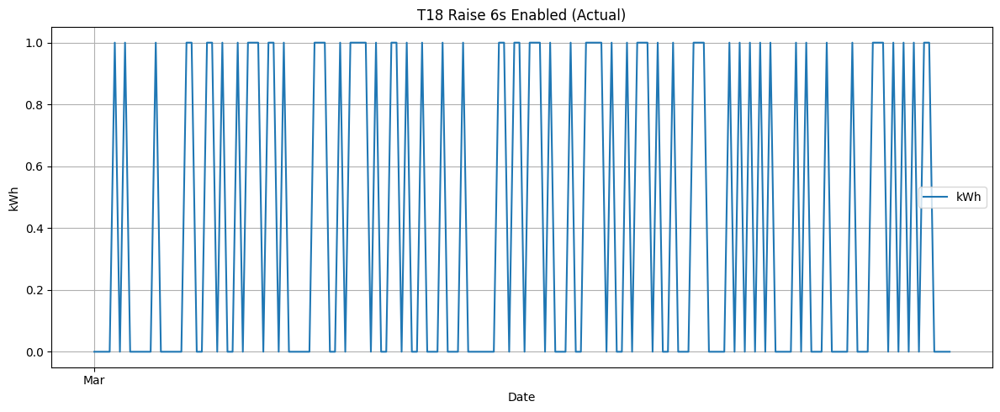

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

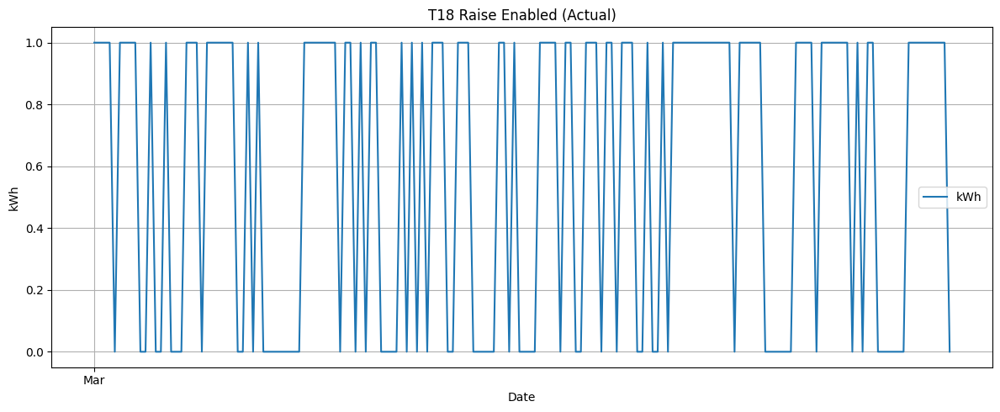

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

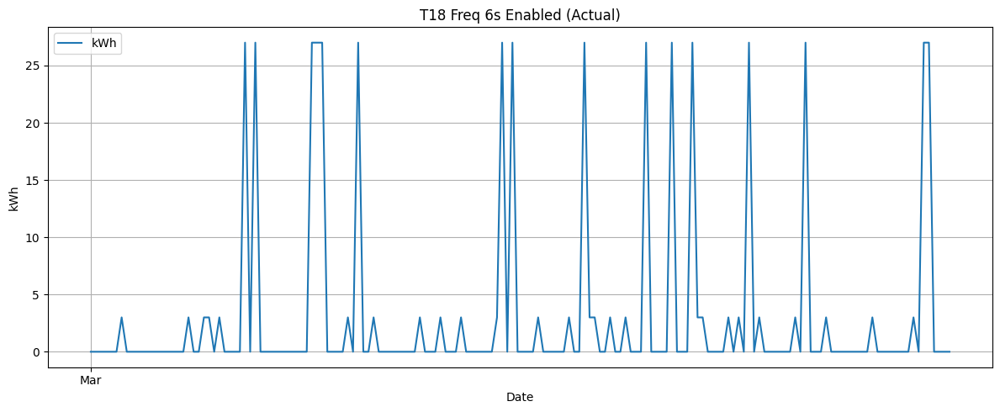

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

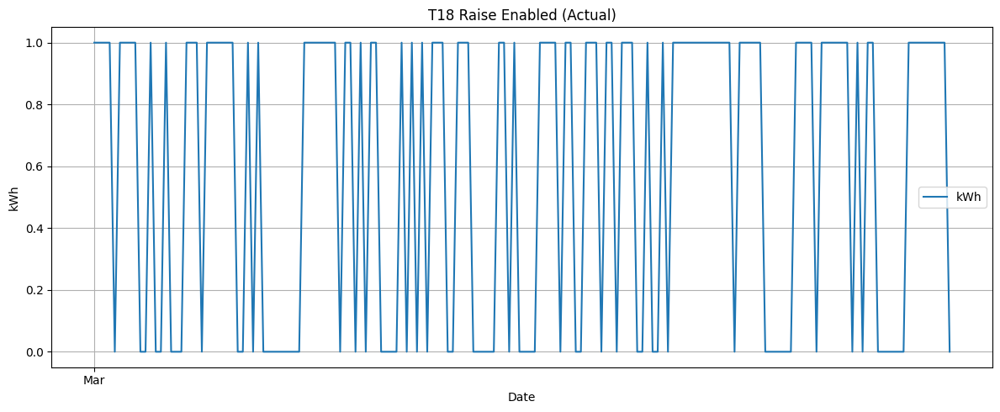

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

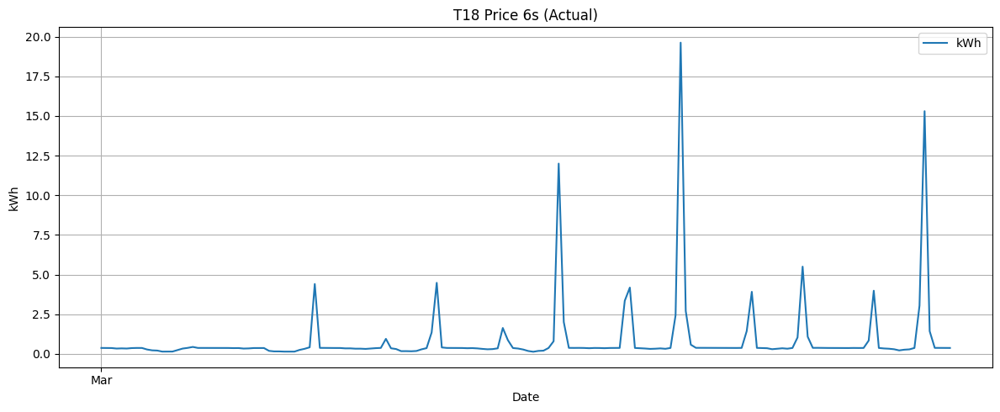

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

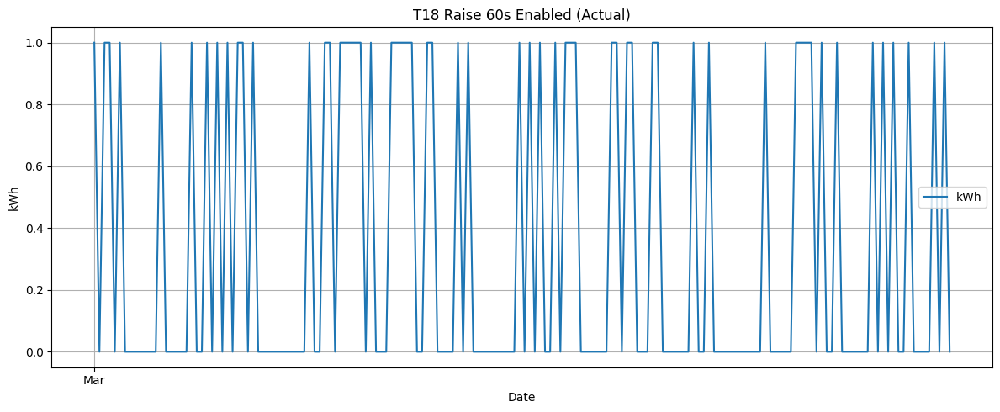

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

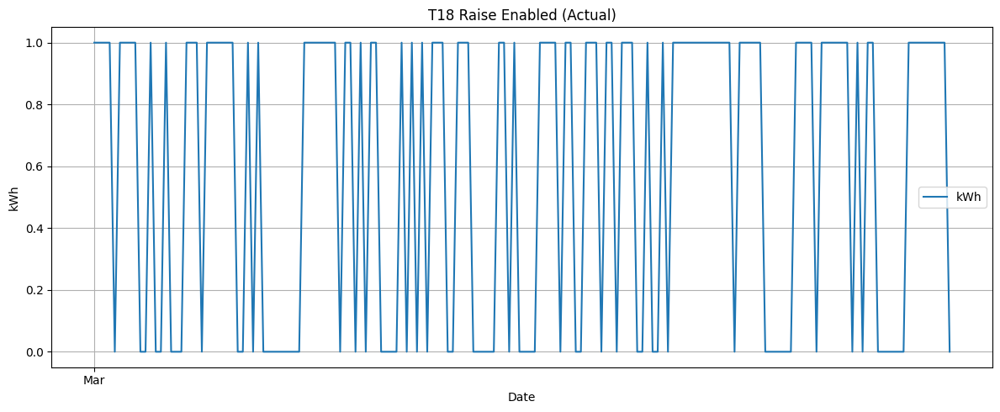

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

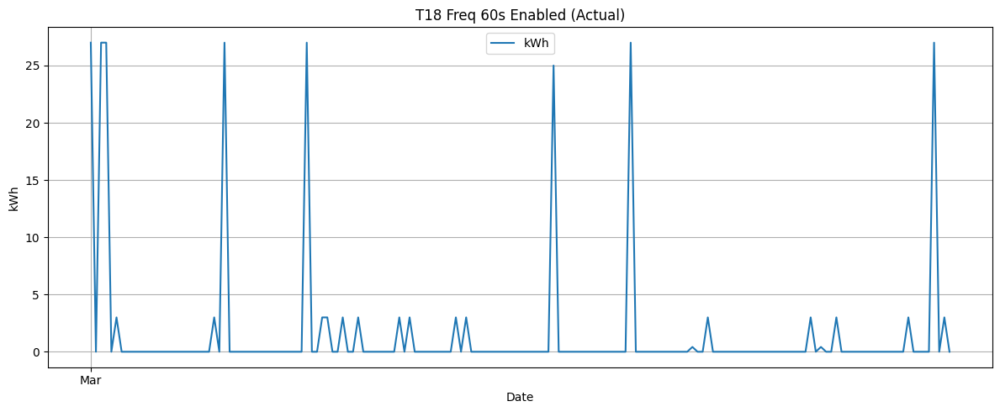

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

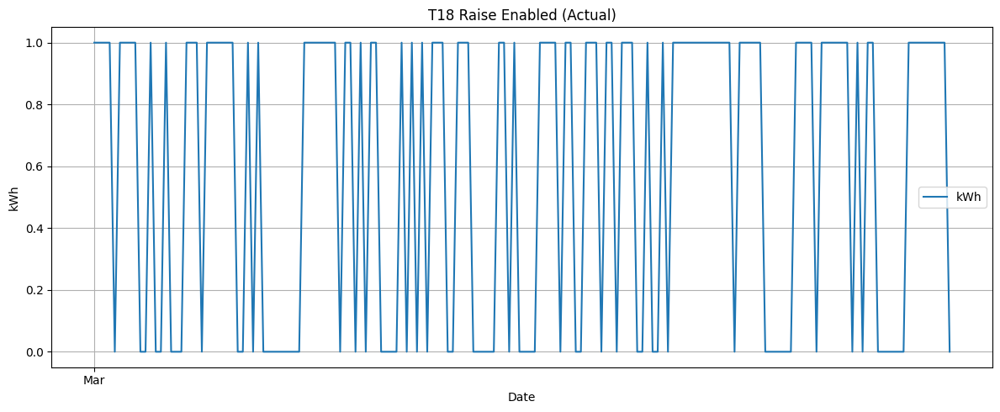

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

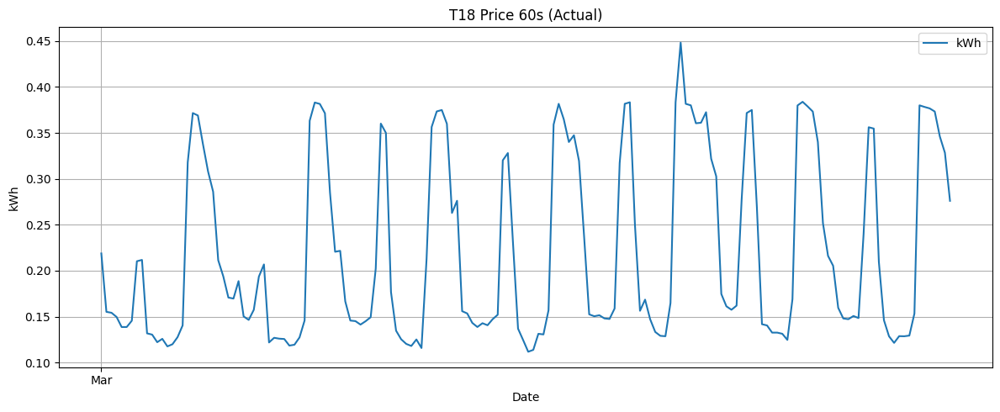

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

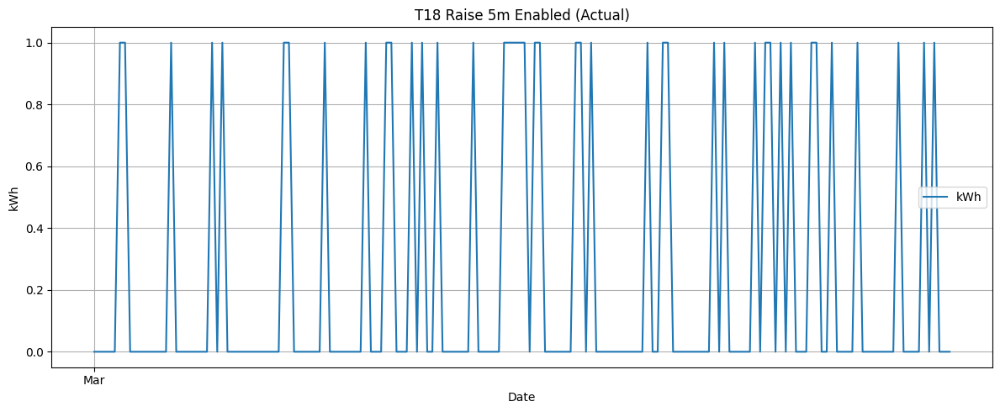

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

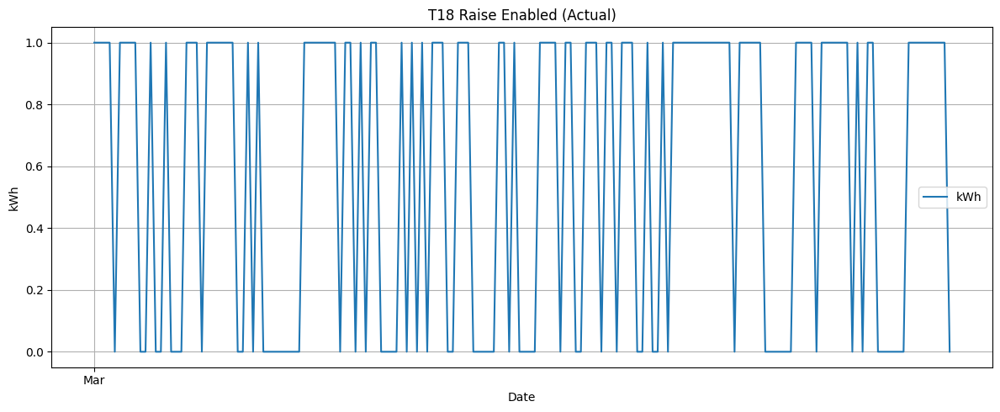

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

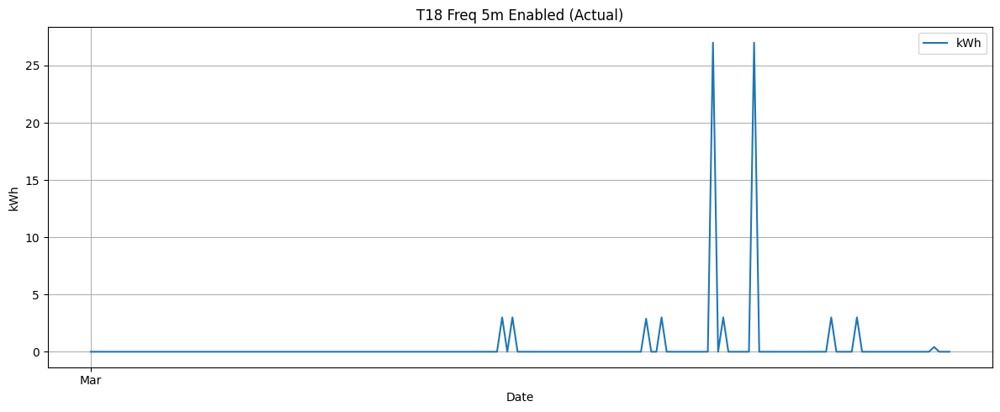

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

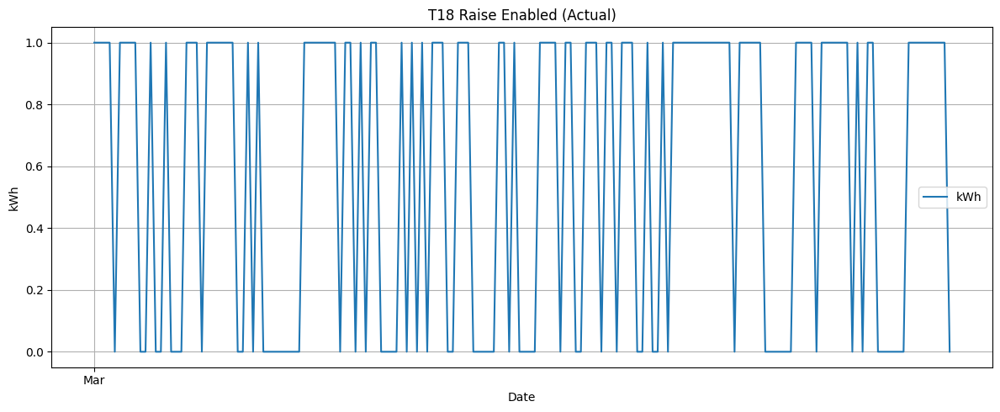

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

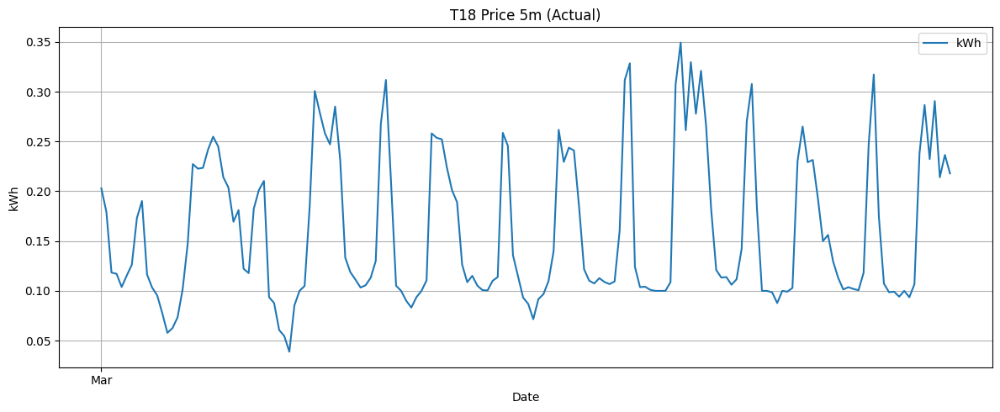

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

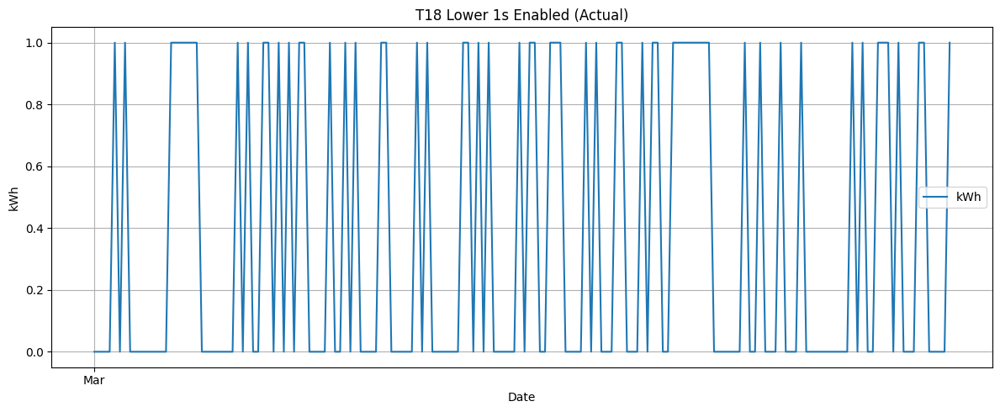

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

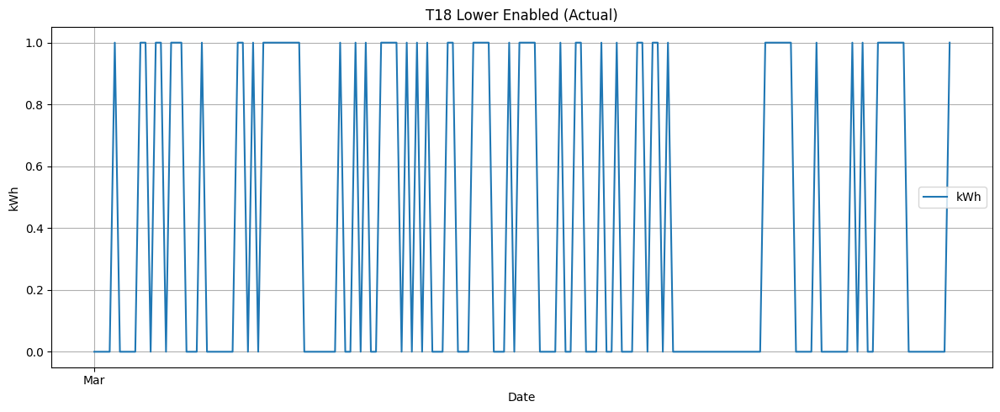

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

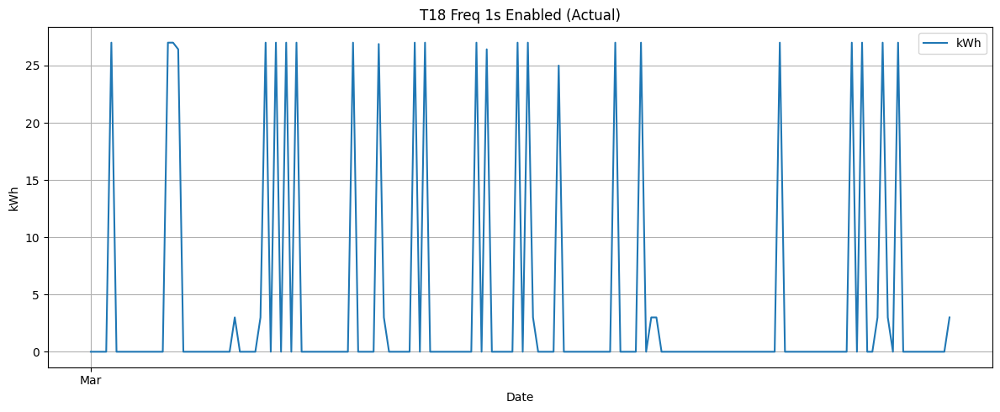

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

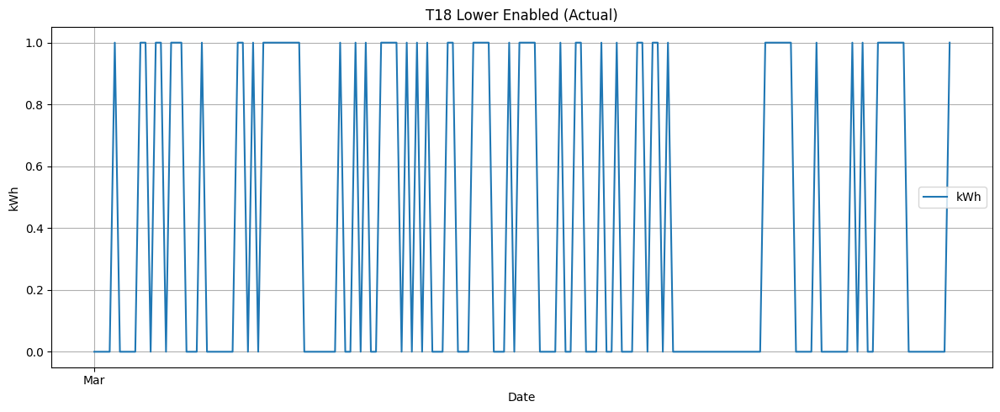

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

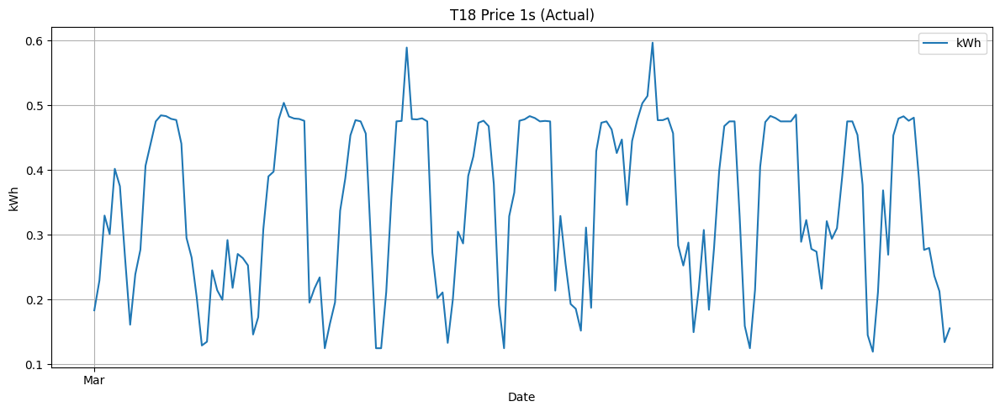

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

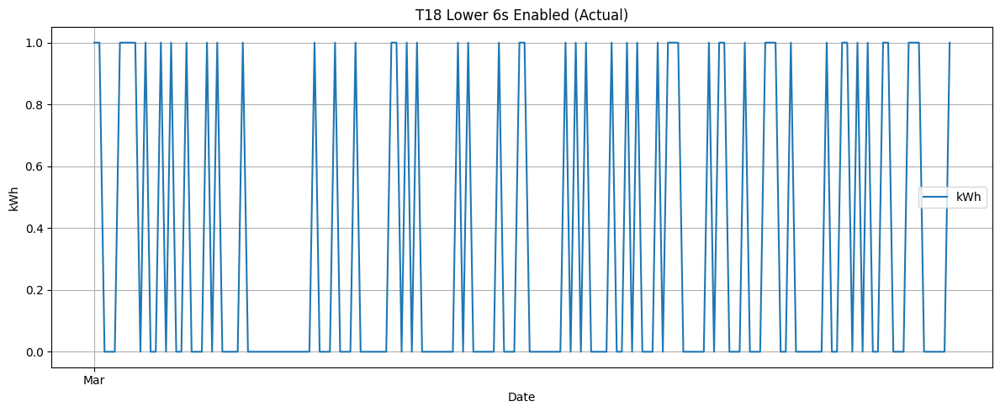

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

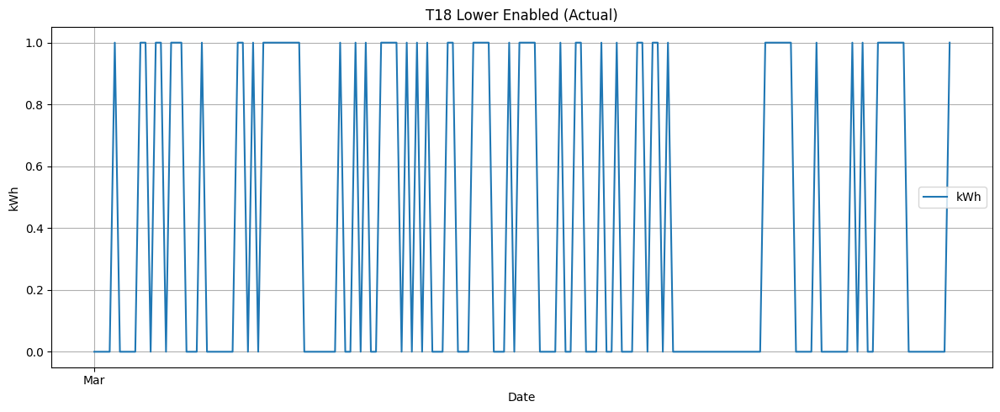

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

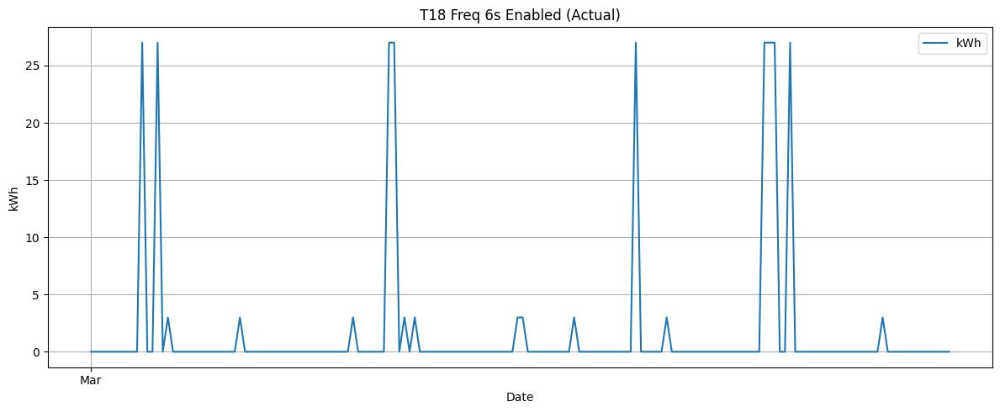

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

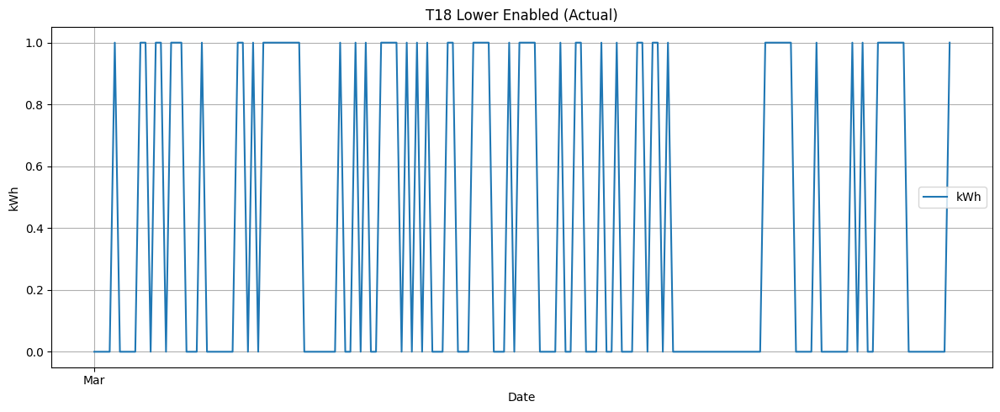

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

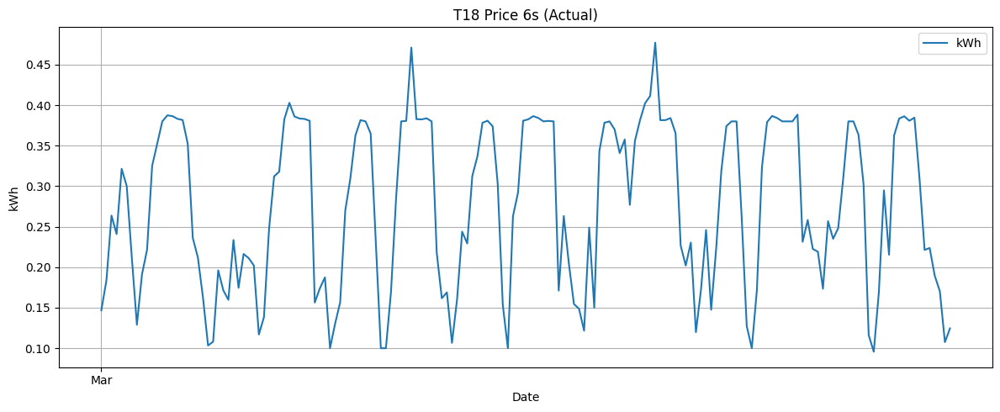

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

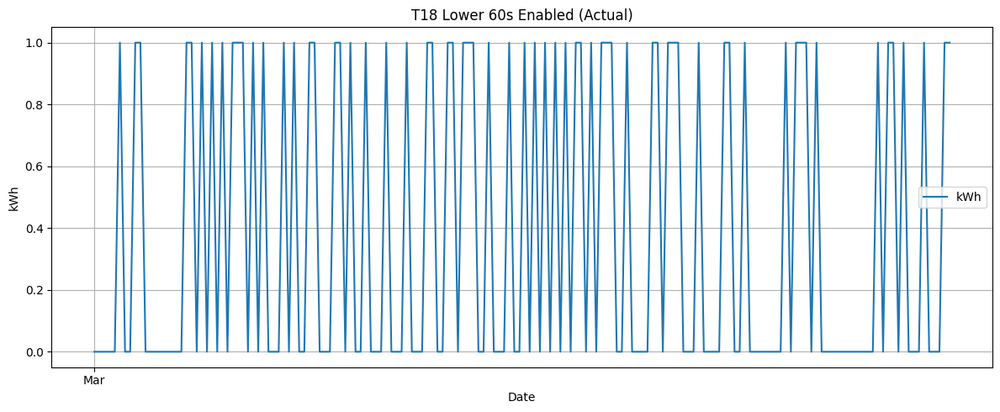

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

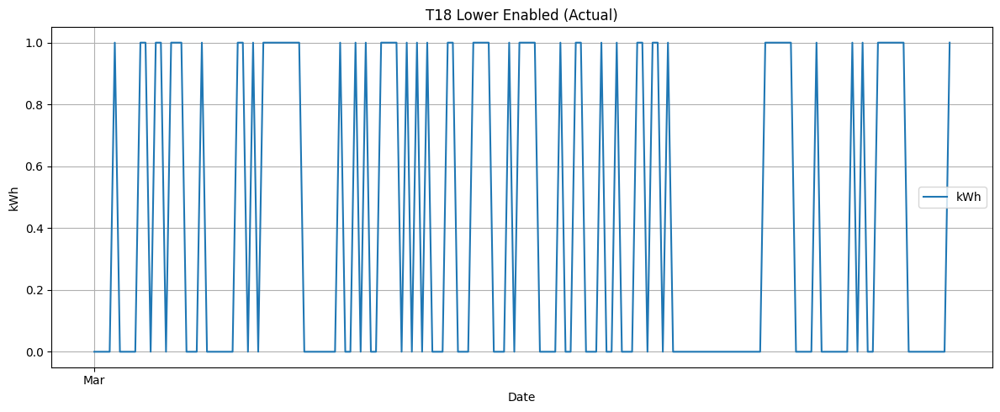

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

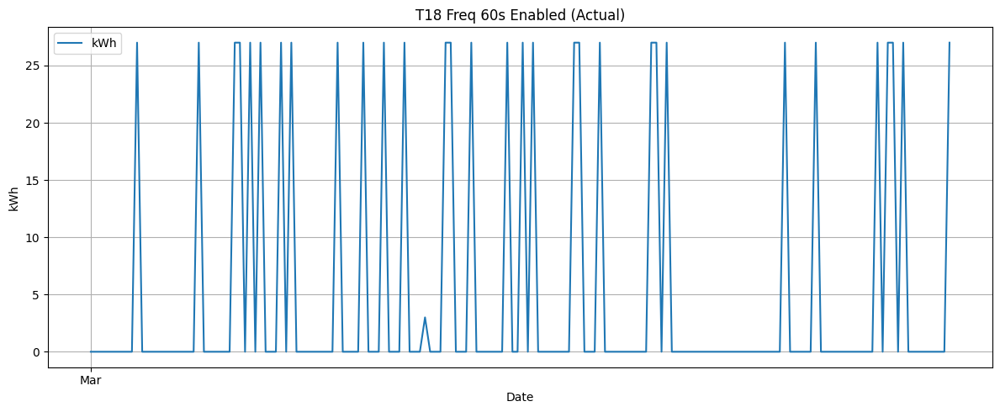

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

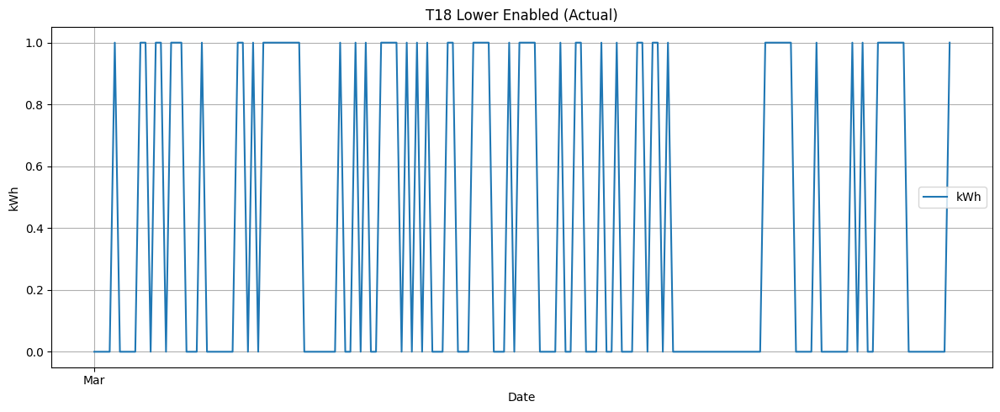

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

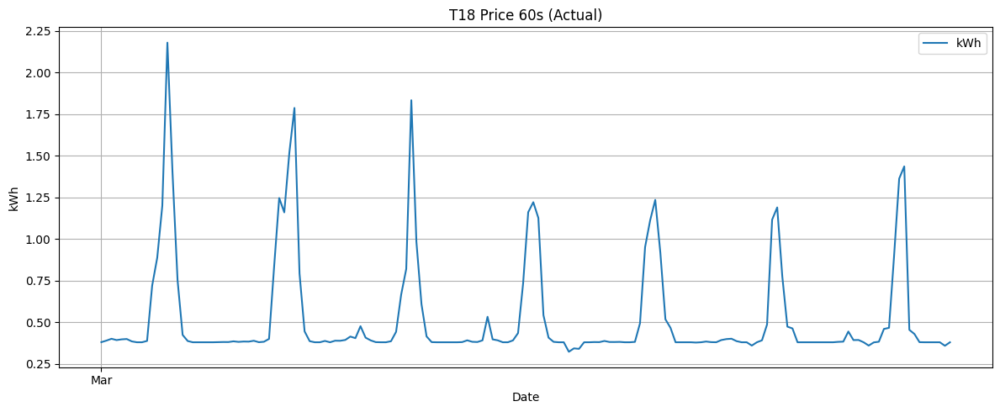

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

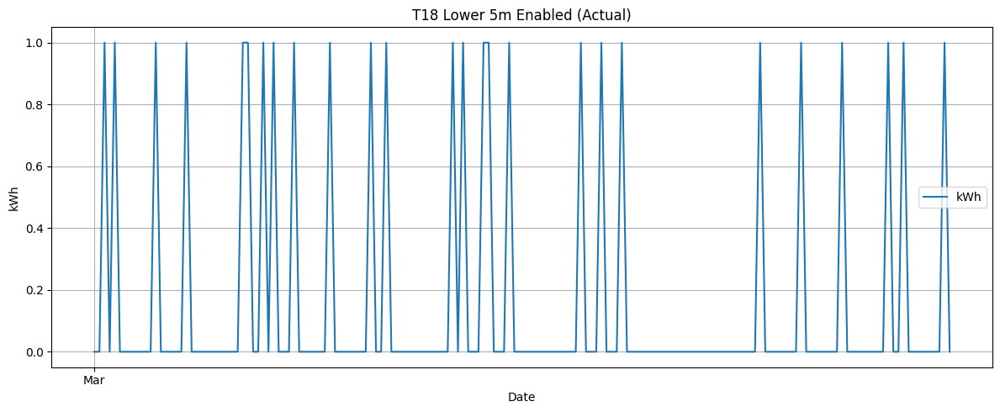

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

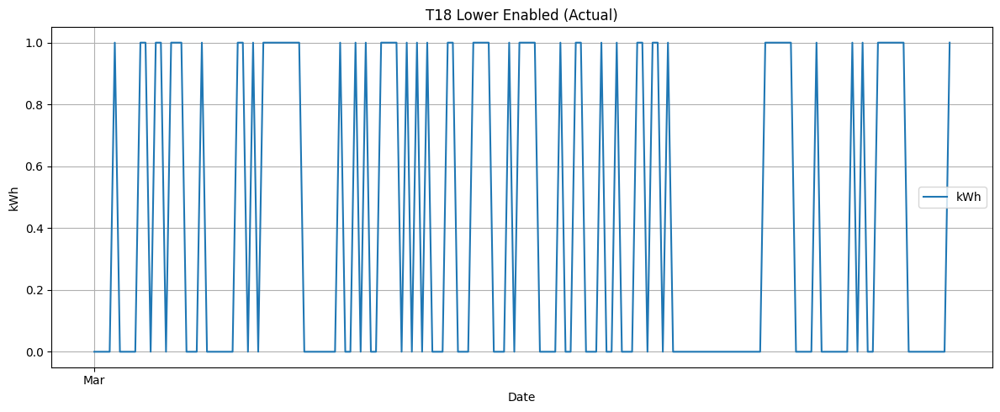

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

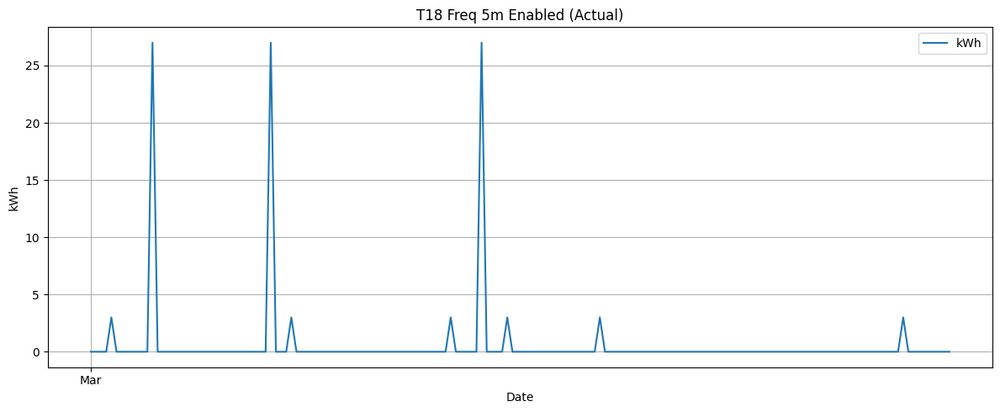

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

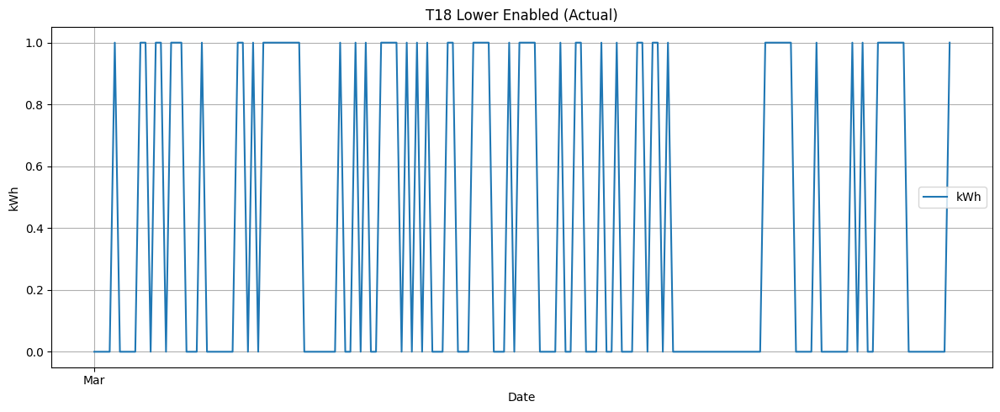

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

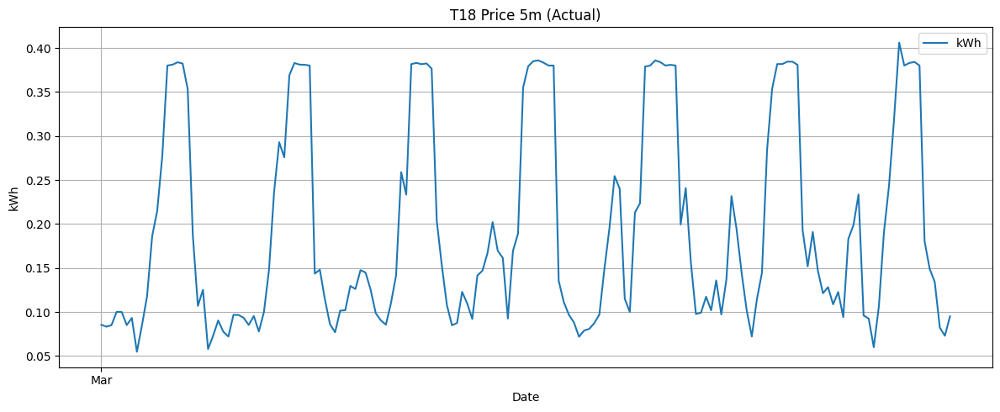

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Testing for V-18.2
e_R1s_vals = np.array([value(modelv1.e_R1s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': e_R1s_vals}, f'{name} Raise 1s Enabled', window=None)
raise_vals = np.array([value(modelv1.z_fcas[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': raise_vals}, f'{name} Raise Enabled', window=None)

f_R1s_vals = np.array([value(modelv1.f_R1s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_R1s_vals}, f'{name} Freq 1s Enabled', window=None)
plot_series(filtered_dates, {'kWh': raise_vals}, f'{name} Raise Enabled', window=None)
price_R1s_vals = np.array([value(modelv1.price_R1s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': price_R1s_vals}, f'{name} Price 1s', window=None)

e_R6s_vals = np.array([value(modelv1.e_R6s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': e_R6s_vals}, f'{name} Raise 6s Enabled', window=None)
raise_vals = np.array([value(modelv1.z_fcas[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': raise_vals}, f'{name} Raise Enabled', window=None)

f_R6s_vals = np.array([value(modelv1.f_R6s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_R6s_vals}, f'{name} Freq 6s Enabled', window=None)
plot_series(filtered_dates, {'kWh': raise_vals}, f'{name} Raise Enabled', window=None)
price_R6s_vals = np.array([value(modelv1.price_R6s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': price_R6s_vals}, f'{name} Price 6s', window=None)

e_R60s_vals = np.array([value(modelv1.e_R60s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': e_R60s_vals}, f'{name} Raise 60s Enabled', window=None)
raise_vals = np.array([value(modelv1.z_fcas[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': raise_vals}, f'{name} Raise Enabled', window=None)

f_R60s_vals = np.array([value(modelv1.f_R60s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_R60s_vals}, f'{name} Freq 60s Enabled', window=None)
plot_series(filtered_dates, {'kWh': raise_vals}, f'{name} Raise Enabled', window=None)
price_R60s_vals = np.array([value(modelv1.price_R60s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': price_R60s_vals}, f'{name} Price 60s', window=None)

e_R5m_vals = np.array([value(modelv1.e_R5m[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': e_R5m_vals}, f'{name} Raise 5m Enabled', window=None)
raise_vals = np.array([value(modelv1.z_fcas[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': raise_vals}, f'{name} Raise Enabled', window=None)

f_R5m_vals = np.array([value(modelv1.f_R5m[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_R5m_vals}, f'{name} Freq 5m Enabled', window=None)
plot_series(filtered_dates, {'kWh': raise_vals}, f'{name} Raise Enabled', window=None)
price_R5m_vals = np.array([value(modelv1.price_R5m[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': price_R5m_vals}, f'{name} Price 5m', window=None)

e_L1s_vals = np.array([value(modelv1.e_L1s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': e_L1s_vals}, f'{name} Lower 1s Enabled', window=None)
lower_vals = np.array([value((1 - modelv1.z_fcas[t])) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': lower_vals}, f'{name} Lower Enabled', window=None)

f_L1s_vals = np.array([value(modelv1.f_L1s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_L1s_vals}, f'{name} Freq 1s Enabled', window=None)
plot_series(filtered_dates, {'kWh': lower_vals}, f'{name} Lower Enabled', window=None)
price_L1s_vals = np.array([value(modelv1.price_L1s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': price_L1s_vals}, f'{name} Price 1s', window=None)

e_L6s_vals = np.array([value(modelv1.e_L6s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': e_L6s_vals}, f'{name} Lower 6s Enabled', window=None)
lower_vals = np.array([value((1 - modelv1.z_fcas[t])) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': lower_vals}, f'{name} Lower Enabled', window=None)

f_L6s_vals = np.array([value(modelv1.f_L6s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_L6s_vals}, f'{name} Freq 6s Enabled', window=None)
plot_series(filtered_dates, {'kWh': lower_vals}, f'{name} Lower Enabled', window=None)
price_L6s_vals = np.array([value(modelv1.price_L6s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': price_L6s_vals}, f'{name} Price 6s', window=None)

e_L60s_vals = np.array([value(modelv1.e_L60s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': e_L60s_vals}, f'{name} Lower 60s Enabled', window=None)
lower_vals = np.array([value((1 - modelv1.z_fcas[t])) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': lower_vals}, f'{name} Lower Enabled', window=None)

f_L60s_vals = np.array([value(modelv1.f_L60s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_L60s_vals}, f'{name} Freq 60s Enabled', window=None)
plot_series(filtered_dates, {'kWh': lower_vals}, f'{name} Lower Enabled', window=None)
price_L60s_vals = np.array([value(modelv1.price_L60s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': price_L60s_vals}, f'{name} Price 60s', window=None)

e_L5m_vals = np.array([value(modelv1.e_L5m[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': e_L5m_vals}, f'{name} Lower 5m Enabled', window=None)
lower_vals = np.array([value((1 - modelv1.z_fcas[t])) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': lower_vals}, f'{name} Lower Enabled', window=None)

f_L5m_vals = np.array([value(modelv1.f_L5m[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_L5m_vals}, f'{name} Freq 5m Enabled', window=None)
plot_series(filtered_dates, {'kWh': lower_vals}, f'{name} Lower Enabled', window=None)
price_L5m_vals = np.array([value(modelv1.price_L5m[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': price_L5m_vals}, f'{name} Price 5m', window=None)




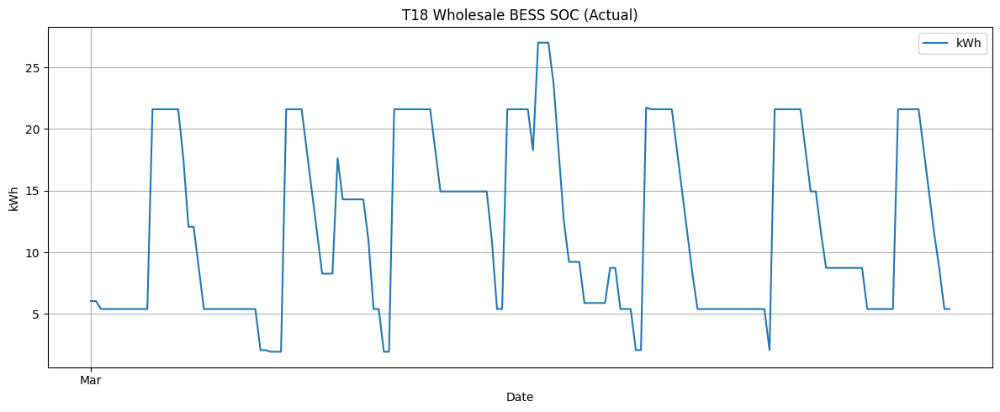

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

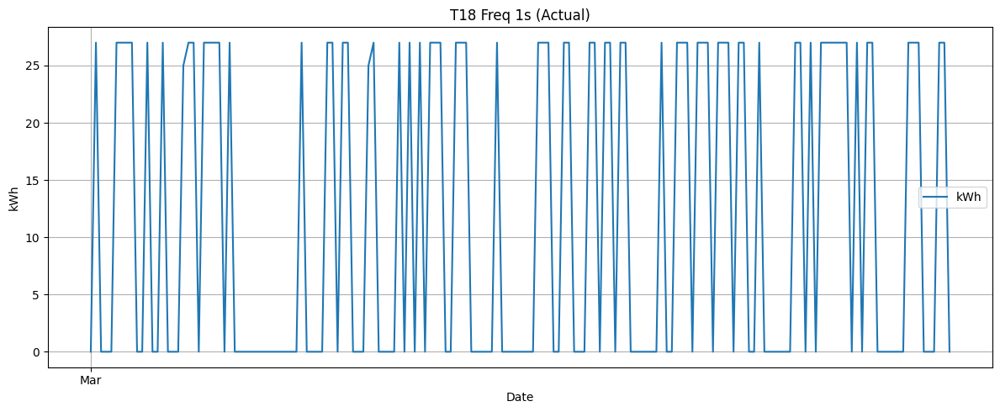

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

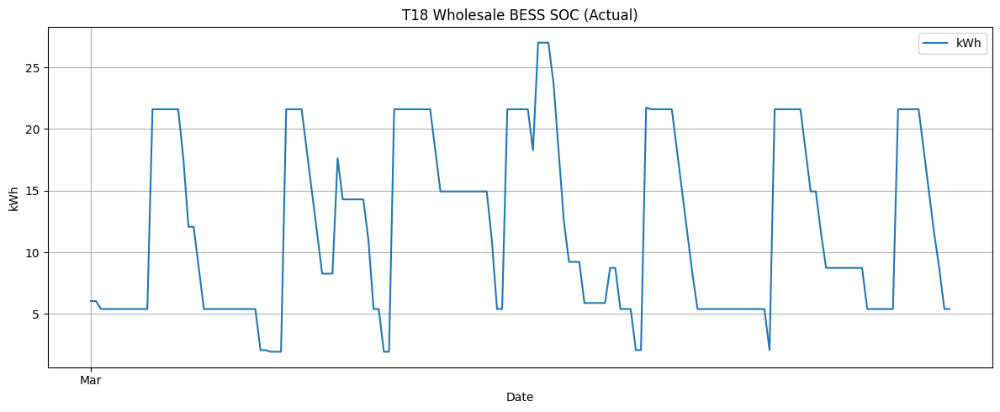

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

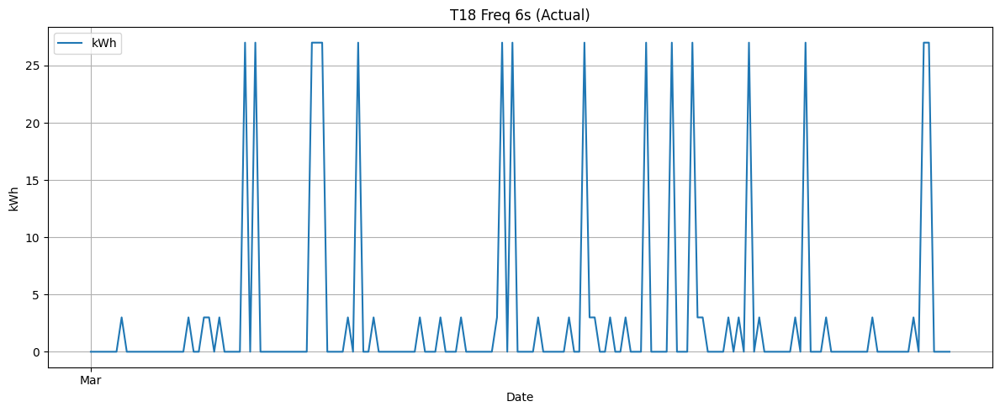

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

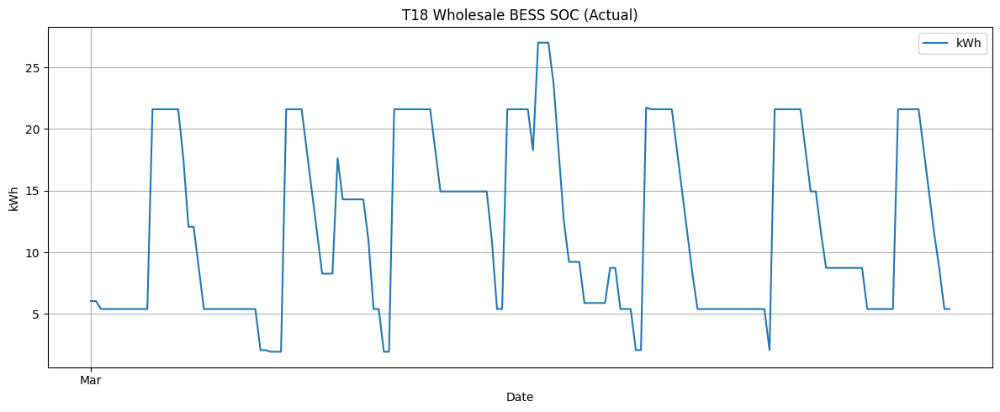

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

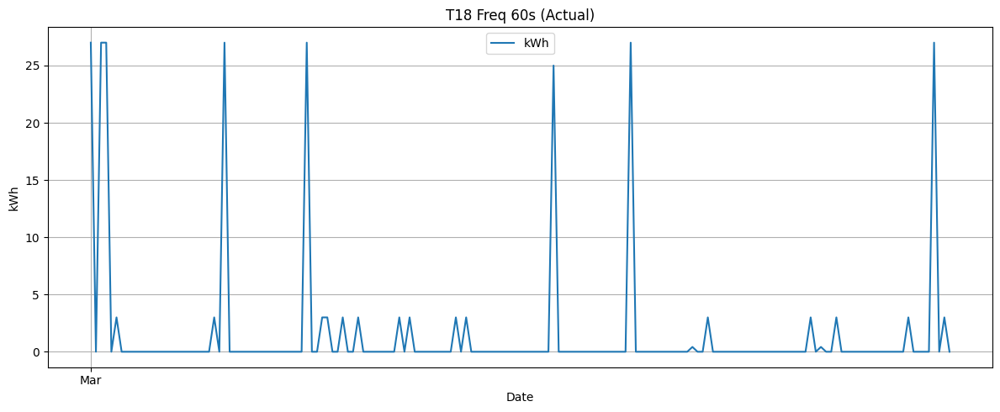

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

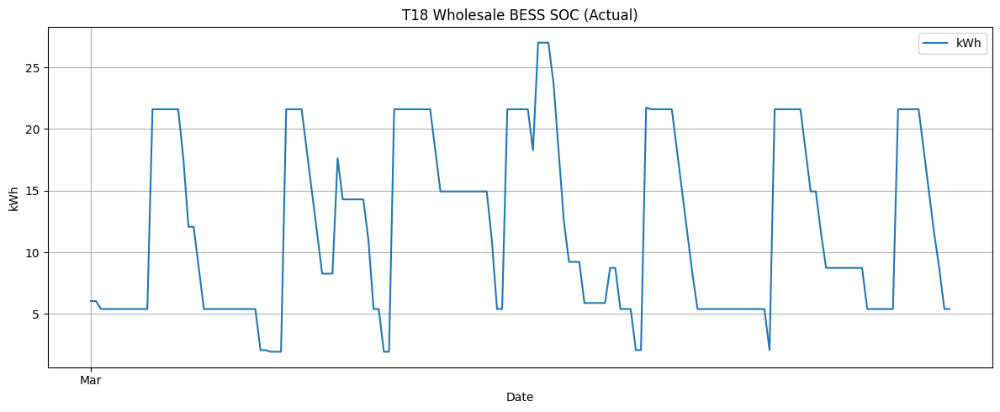

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

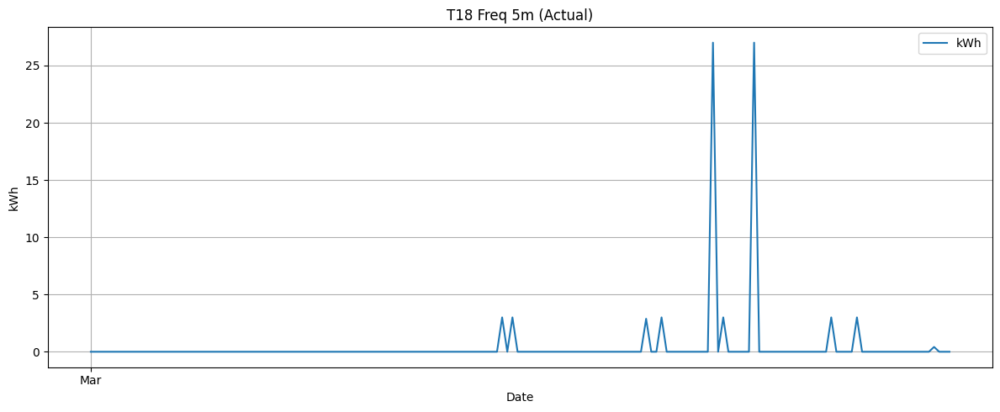

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Testing for V-18.3
BESS_SOC_W_vals = np.array([value(modelv1.SOC_BESS_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_SOC_W_vals}, f'{name} Wholesale BESS SOC', window=None)
f_R1s_vals = np.array([value(modelv1.f_R1s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_R1s_vals}, f'{name} Freq 1s', window=None)

BESS_SOC_W_vals = np.array([value(modelv1.SOC_BESS_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_SOC_W_vals}, f'{name} Wholesale BESS SOC', window=None)
f_R6s_vals = np.array([value(modelv1.f_R6s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_R6s_vals}, f'{name} Freq 6s', window=None)

BESS_SOC_W_vals = np.array([value(modelv1.SOC_BESS_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_SOC_W_vals}, f'{name} Wholesale BESS SOC', window=None)
f_R60s_vals = np.array([value(modelv1.f_R60s[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_R60s_vals}, f'{name} Freq 60s', window=None)

BESS_SOC_W_vals = np.array([value(modelv1.SOC_BESS_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_SOC_W_vals}, f'{name} Wholesale BESS SOC', window=None)
f_R5m_vals = np.array([value(modelv1.f_R5m[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': f_R5m_vals}, f'{name} Freq 5m', window=None)

# V-19

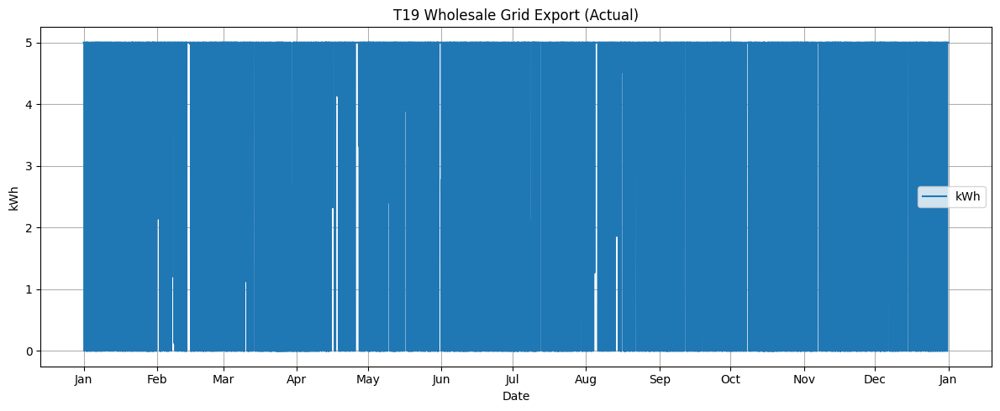

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

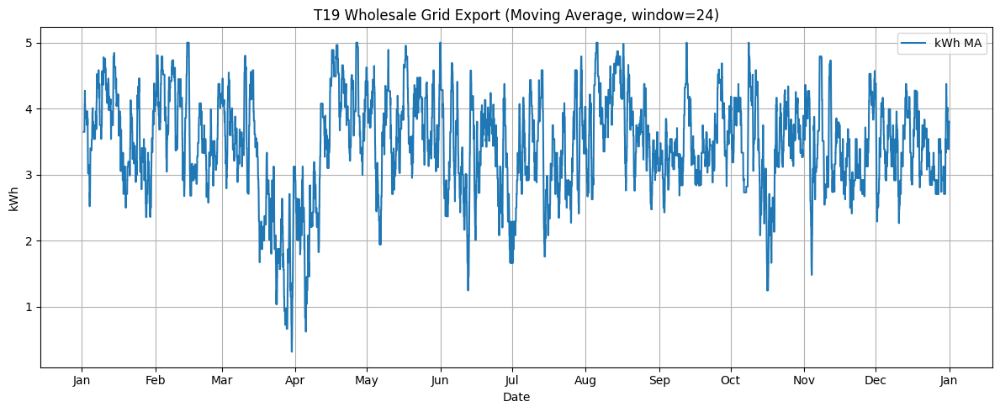

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

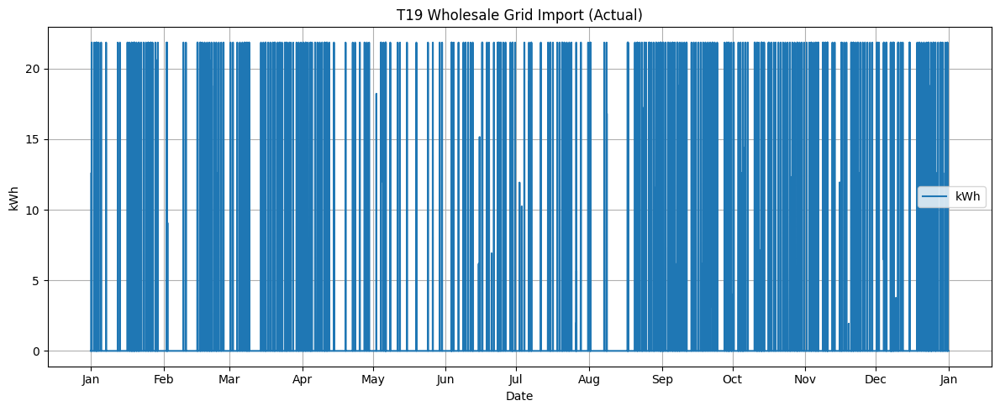

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

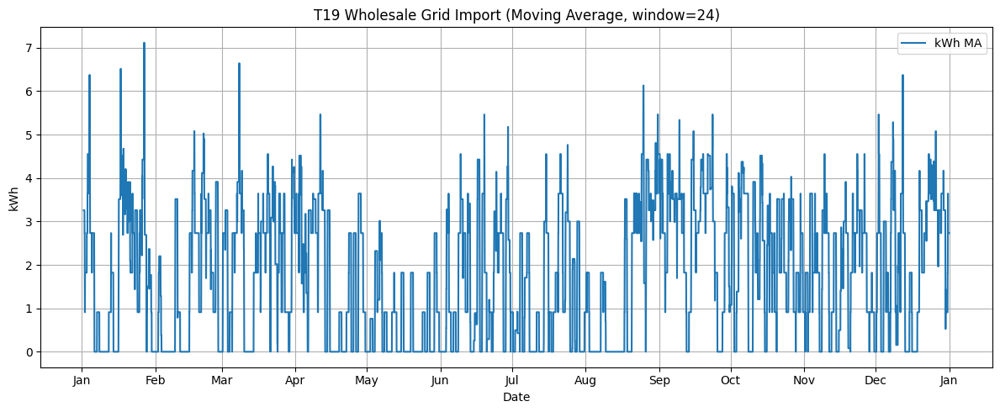

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

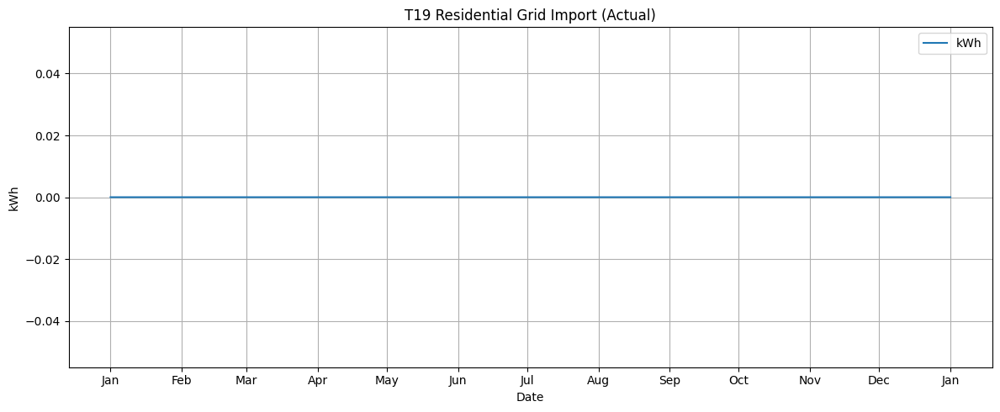

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

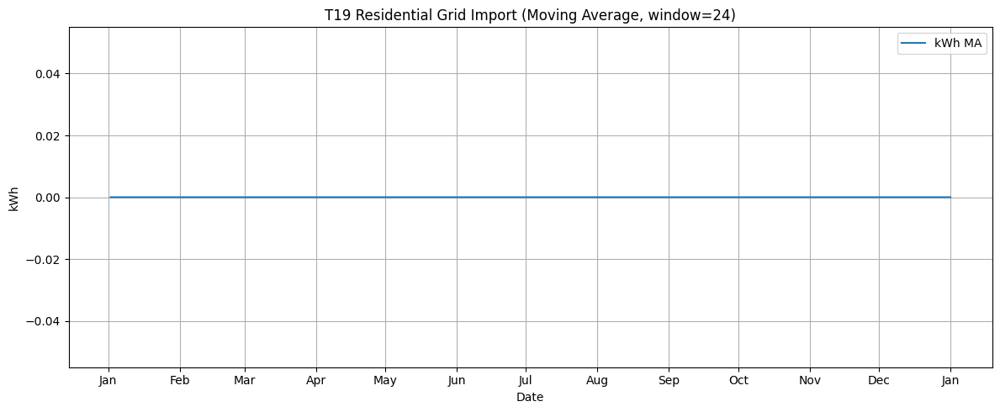

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

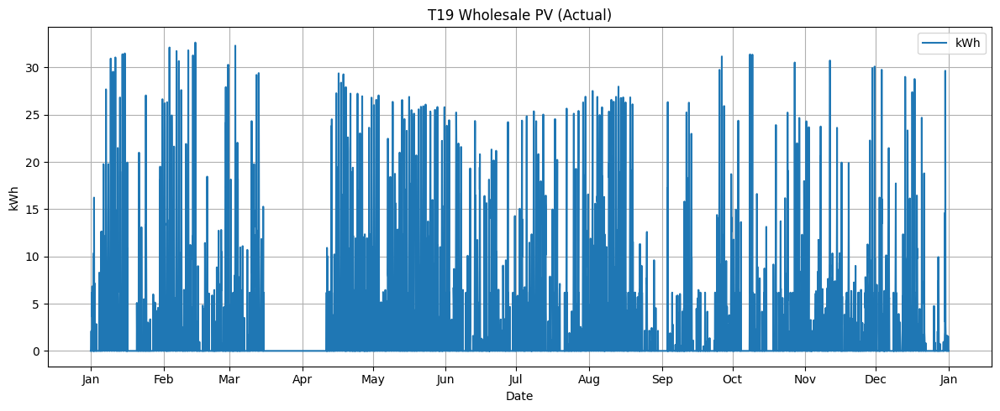

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

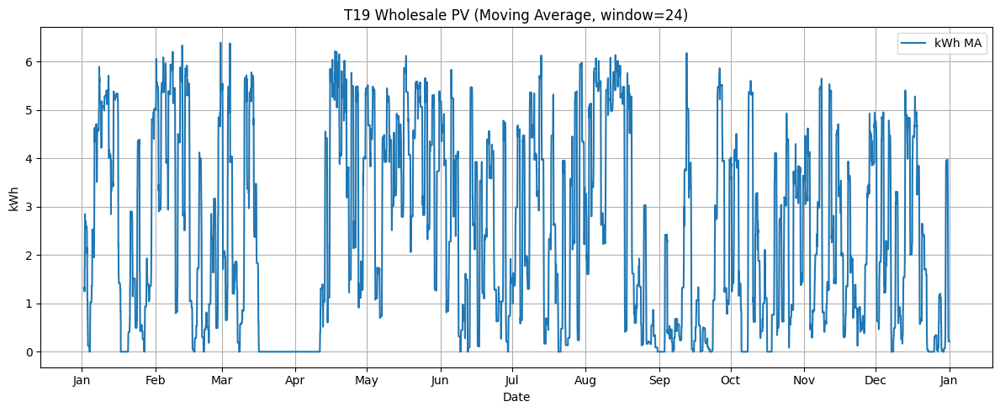

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

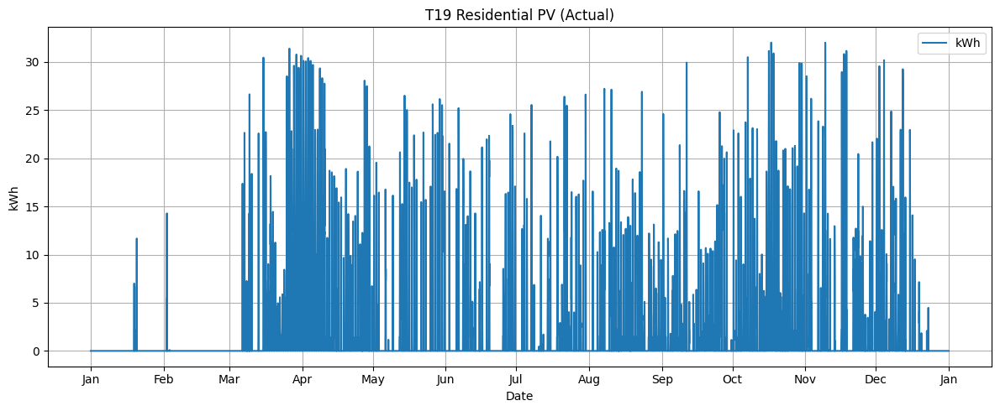

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

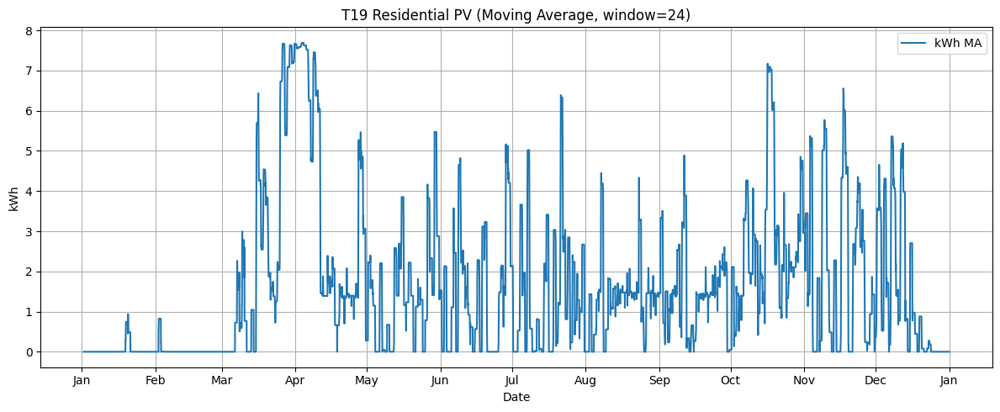

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

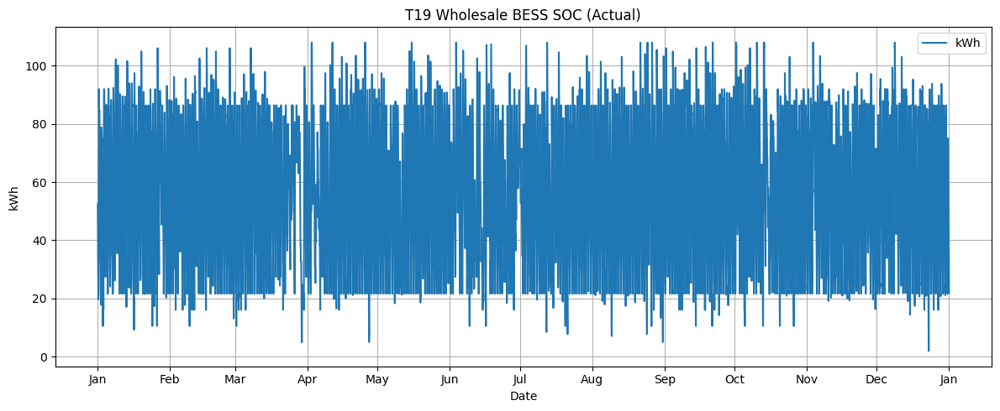

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

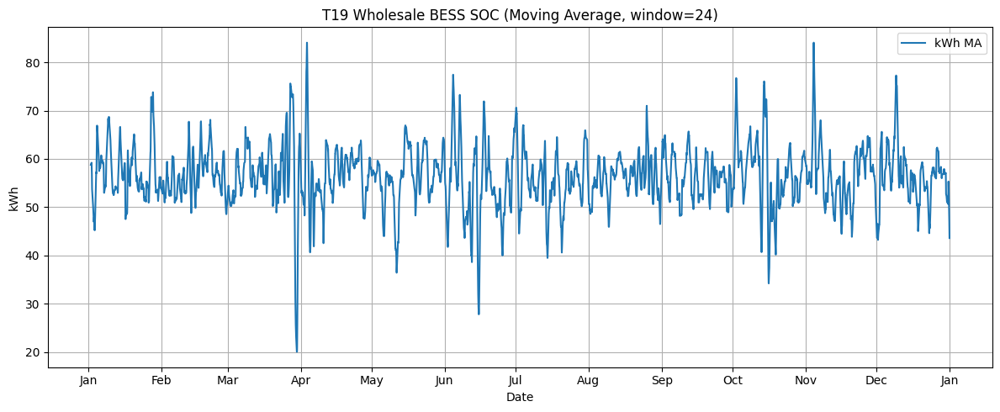

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

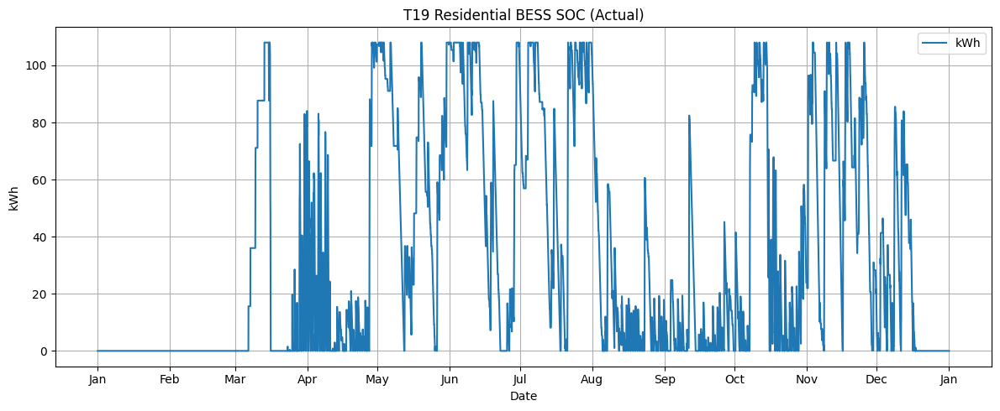

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

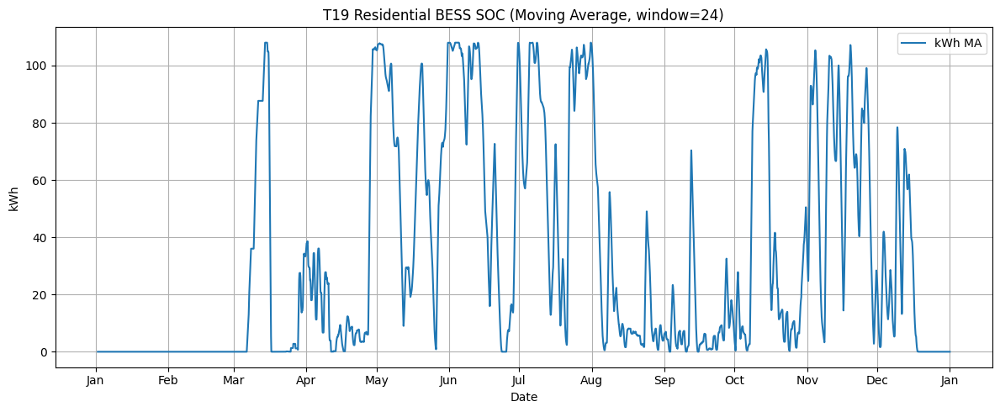

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

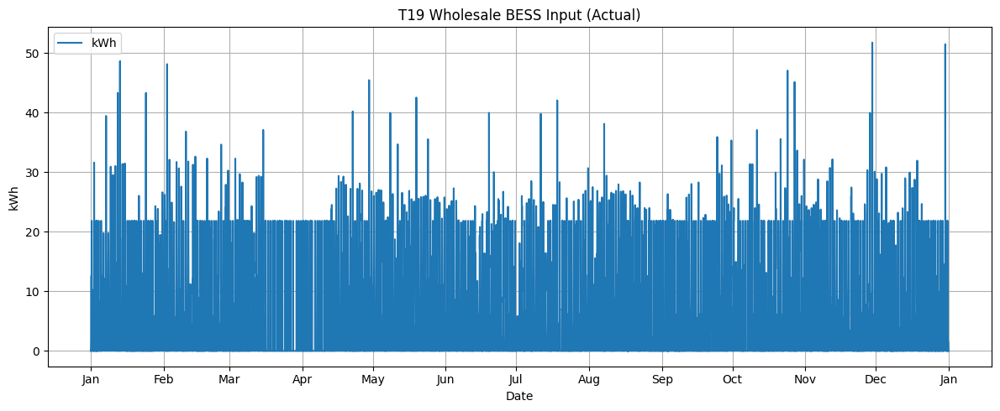

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

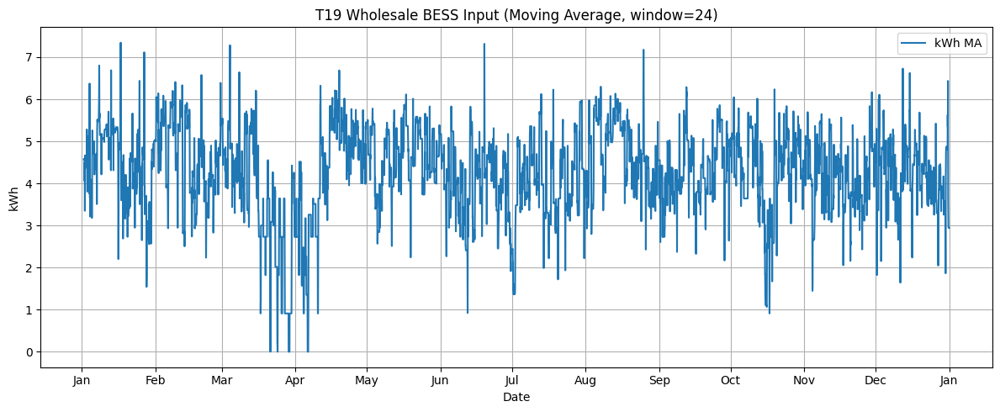

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

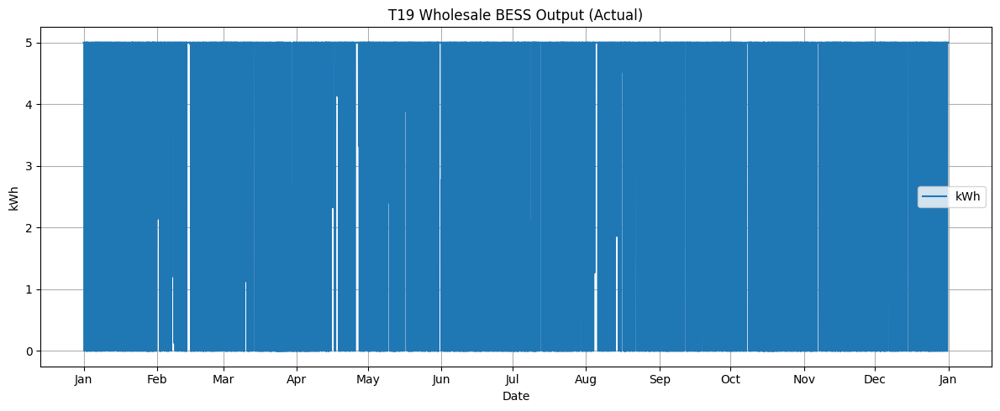

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

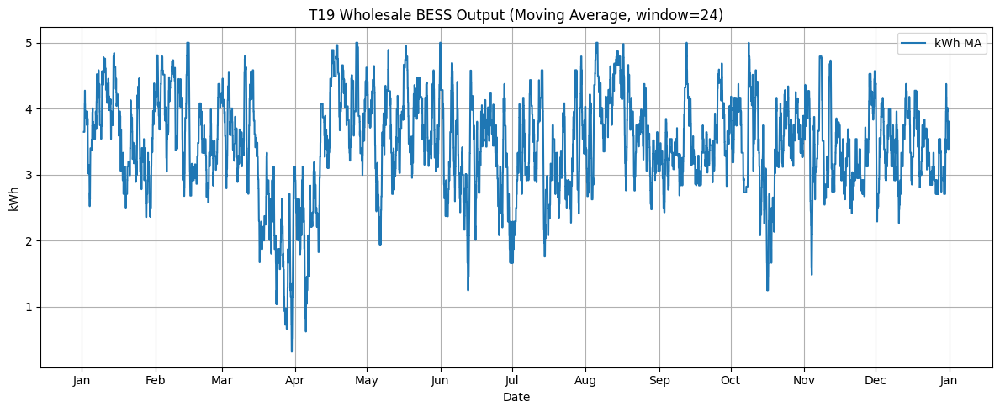

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

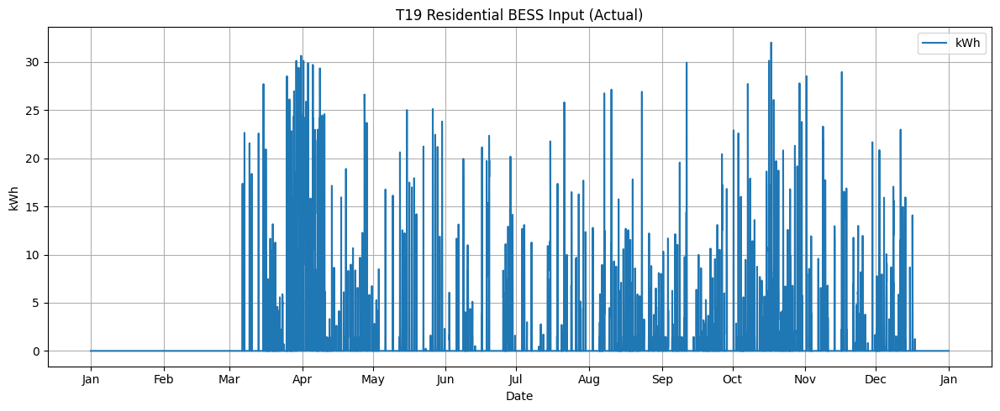

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

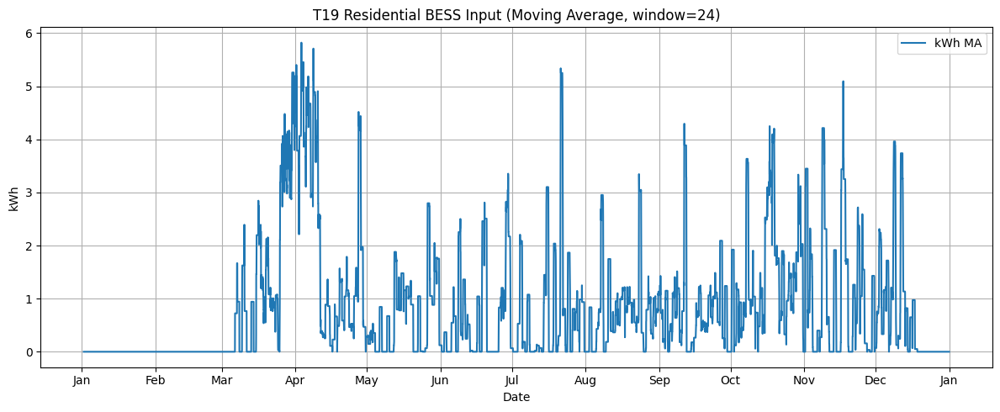

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

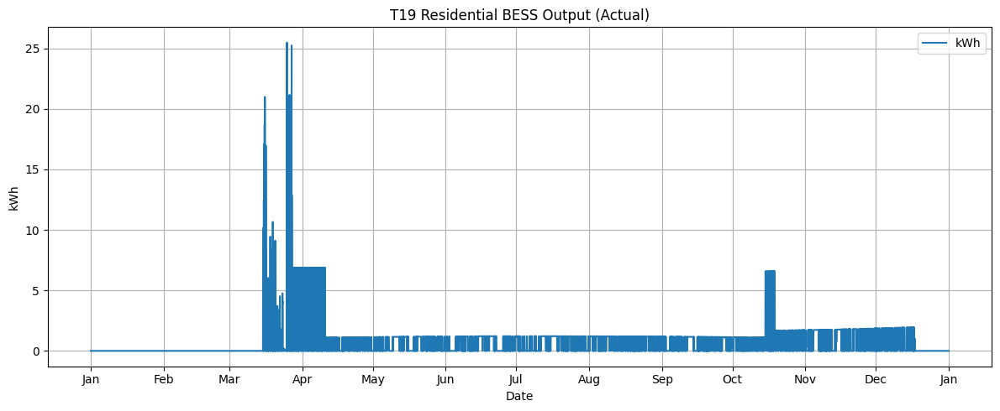

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

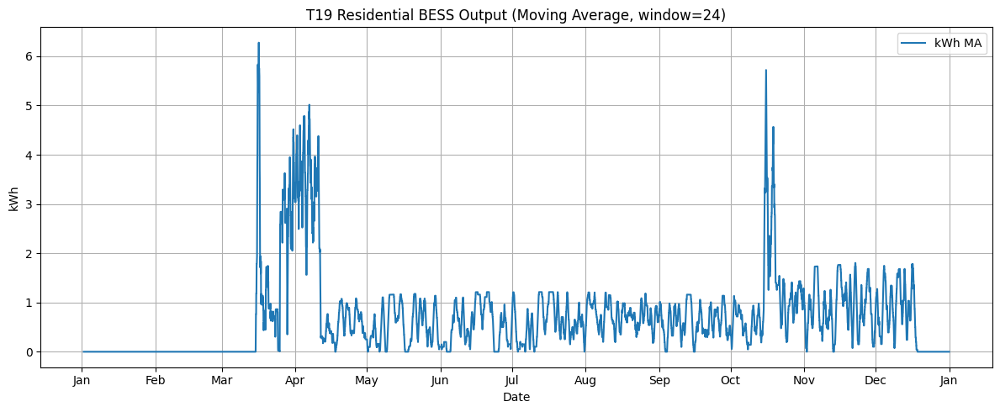

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Testing for V-19
# T.19.1
grid_exp_W_vals = np.array([value(modelv1.grid_exp_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': grid_exp_W_vals}, f'{name} Wholesale Grid Export', window=24)
grid_imp_W_vals = np.array([value(modelv1.grid_imp_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': grid_imp_W_vals}, f'{name} Wholesale Grid Import', window=24)
grid_imp_R_vals = np.array([value(modelv1.grid_imp_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': grid_imp_R_vals}, f'{name} Residential Grid Import', window=24)

# T.19.2
PV_W_vals = np.array([value(modelv1.PV_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': PV_W_vals}, f'{name} Wholesale PV', window=24)
PV_R_vals = np.array([value(modelv1.PV_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': PV_R_vals}, f'{name} Residential PV', window=24)

# T.19.3
SOC_BESS_W_vals = np.array([value(modelv1.SOC_BESS_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': SOC_BESS_W_vals}, f'{name} Wholesale BESS SOC', window=24)
SOC_BESS_R_vals = np.array([value(modelv1.SOC_BESS_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': SOC_BESS_R_vals}, f'{name} Residential BESS SOC', window=24)

# T.19.4
BESS_in_W_vals = np.array([value(modelv1.BESS_in_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_in_W_vals}, f'{name} Wholesale BESS Input', window=24)
BESS_out_W_vals = np.array([value(modelv1.BESS_out_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_out_W_vals}, f'{name} Wholesale BESS Output', window=24)
BESS_in_R_vals = np.array([value(modelv1.BESS_in_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_in_R_vals}, f'{name} Residential BESS Input', window=24)
BESS_out_R_vals = np.array([value(modelv1.BESS_out_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': BESS_out_R_vals}, f'{name} Residential BESS Output', window=24)

# V-20

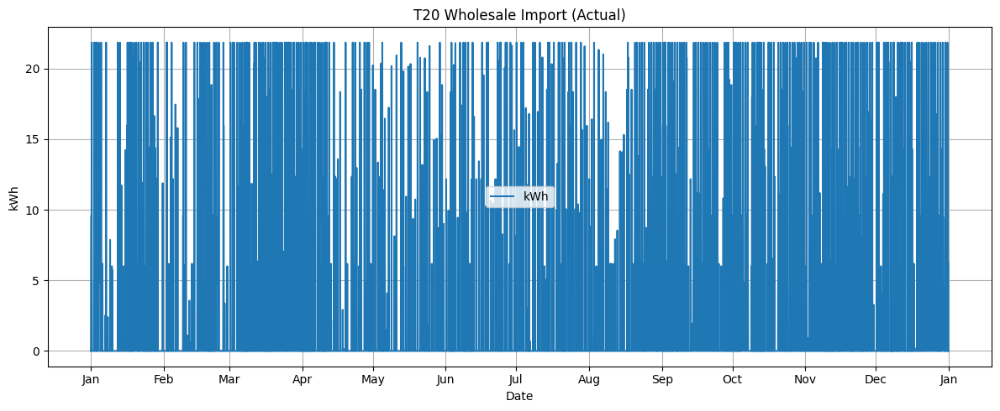

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

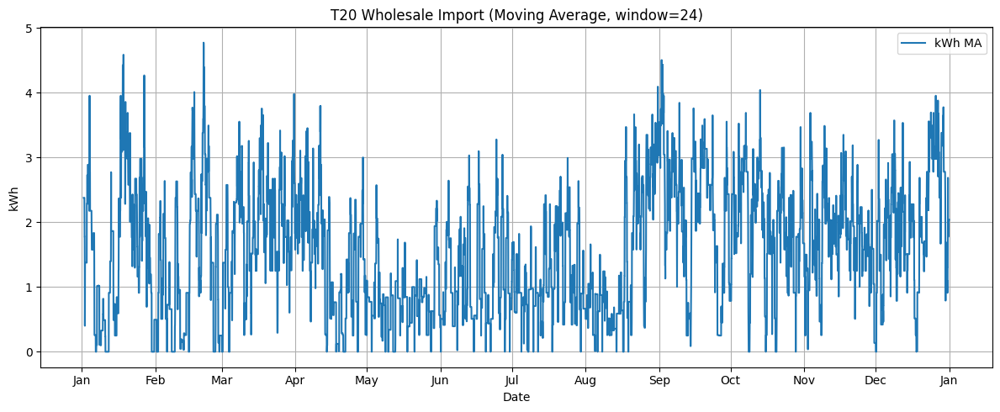

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

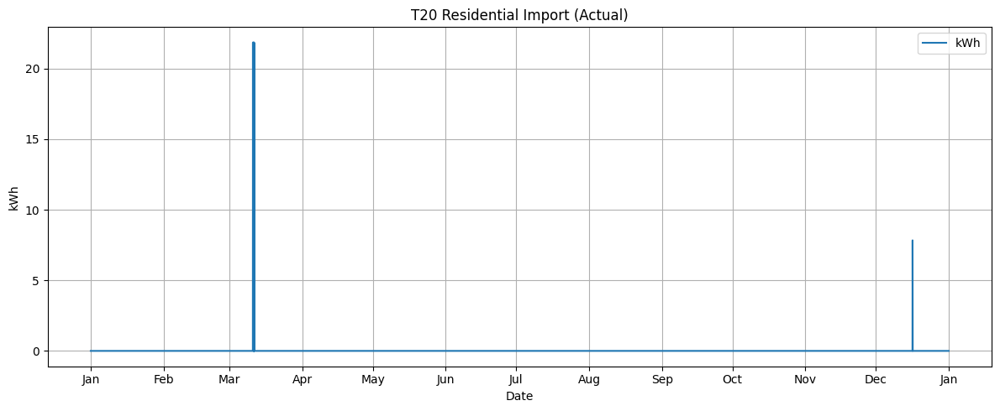

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

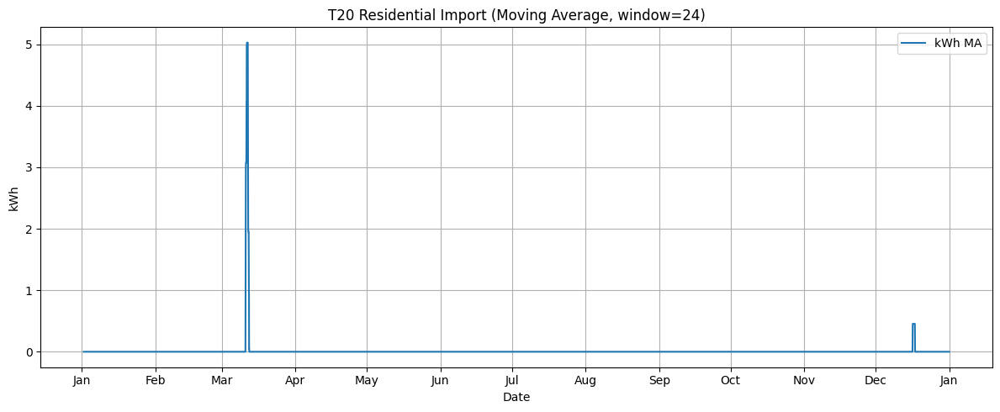

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

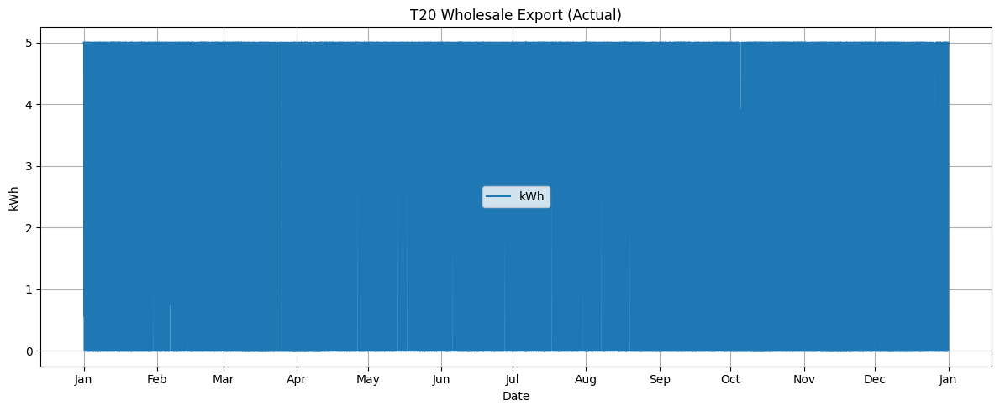

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

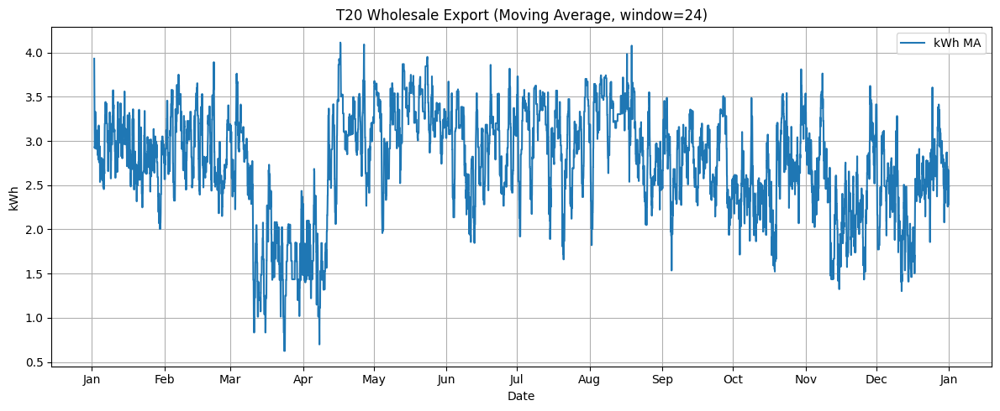

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [39]:
# Testing for V-20
# T20.1
months_to_plot = Year
mask = dates.month.isin(months_to_plot)
filtered_dates = dates[mask]
grid_imp_w_vals = np.array([value(modelv1.grid_imp_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': grid_imp_w_vals}, f'{name} Wholesale Import', window=24)
grid_imp_r_vals = np.array([value(modelv1.grid_imp_R[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': grid_imp_r_vals}, f'{name} Residential Import', window=24)
grid_exp_w_vals = np.array([value(modelv1.grid_exp_W[t]) for t in timesteps])[mask]
plot_series(filtered_dates, {'kWh': grid_exp_w_vals}, f'{name} Wholesale Export', window=24)

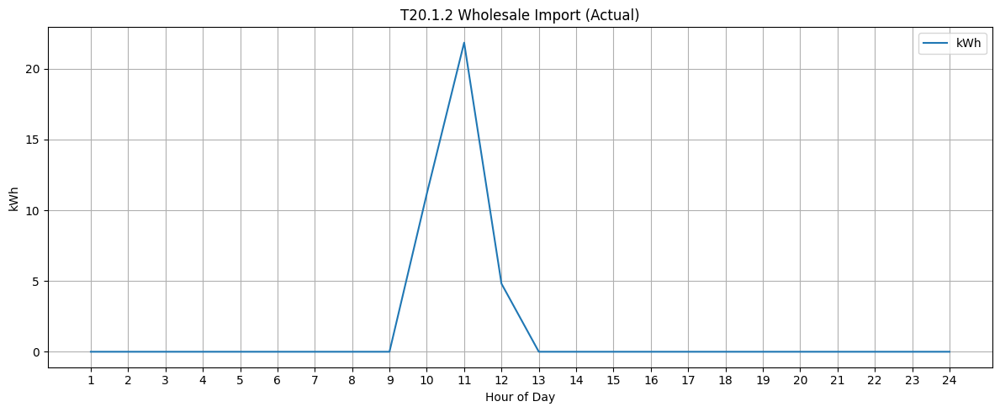

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

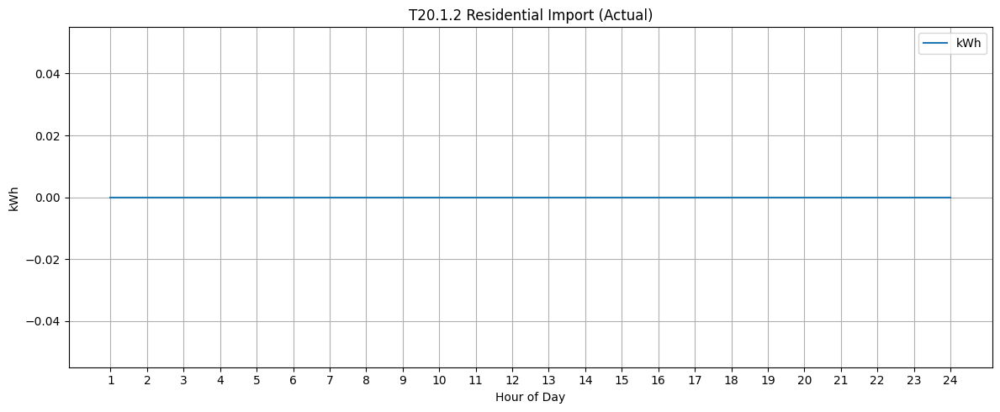

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

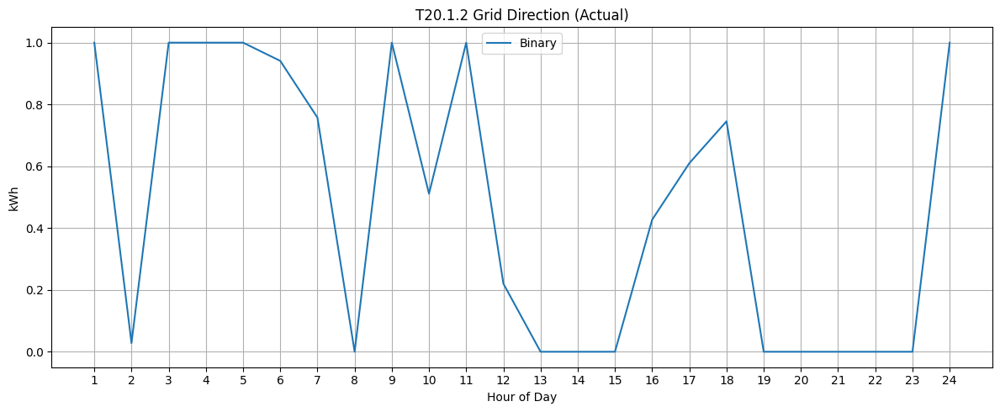

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

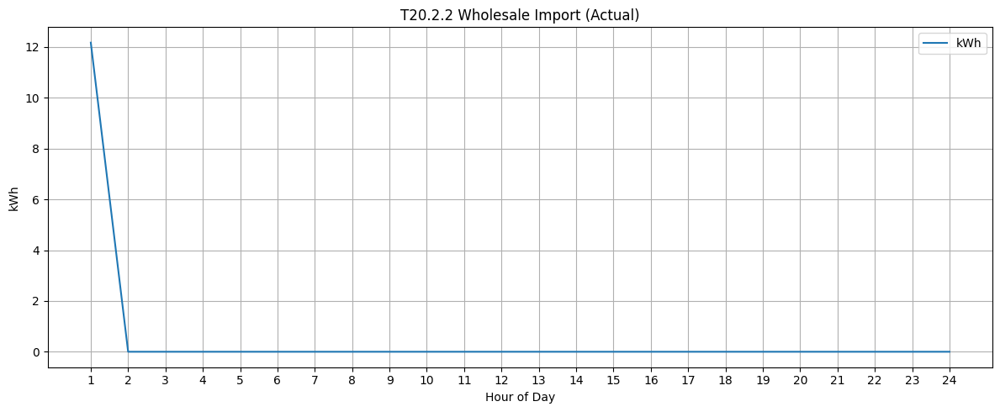

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

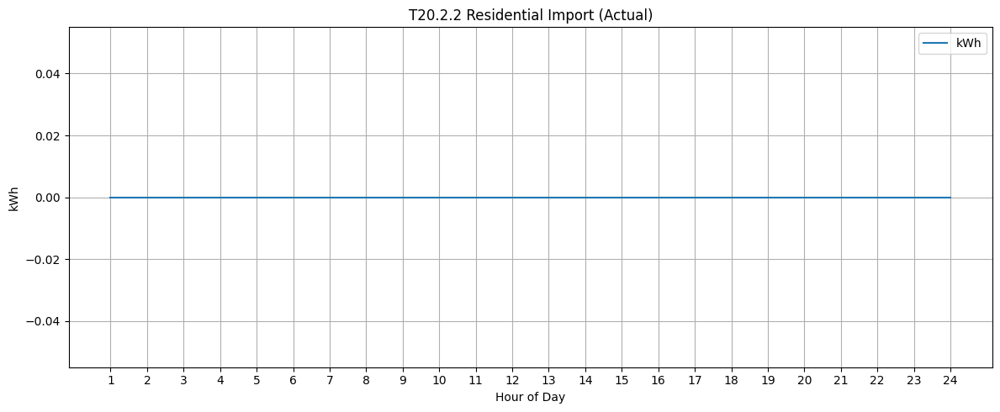

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

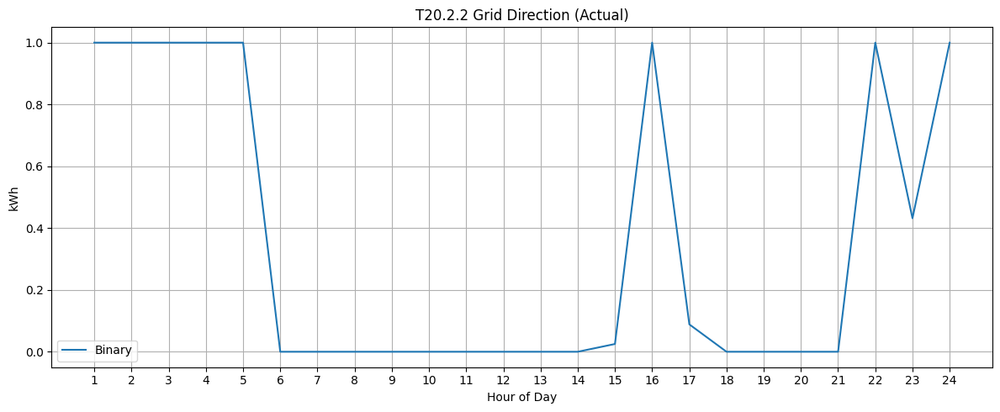

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

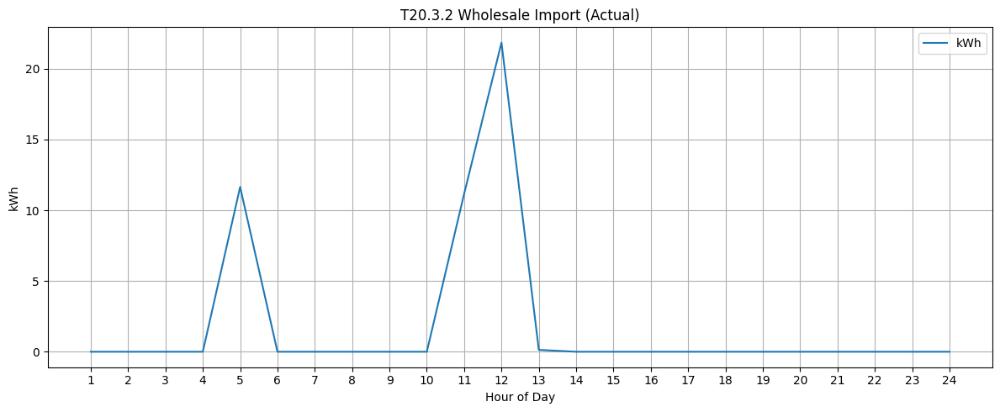

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

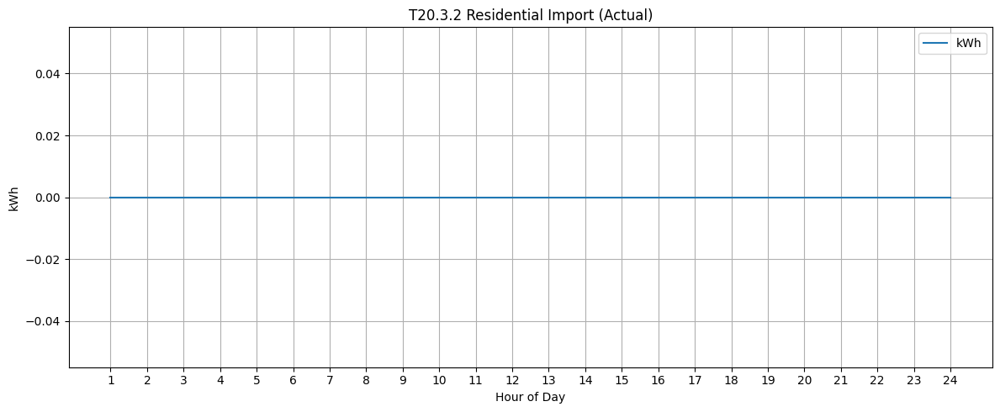

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

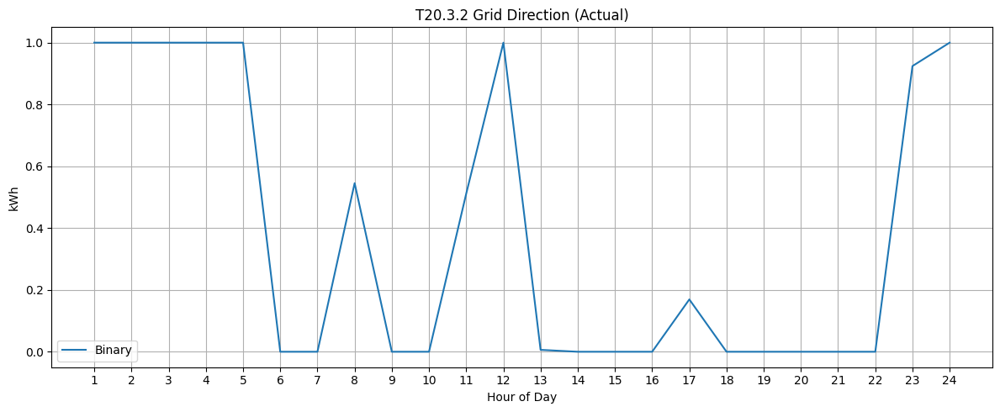

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

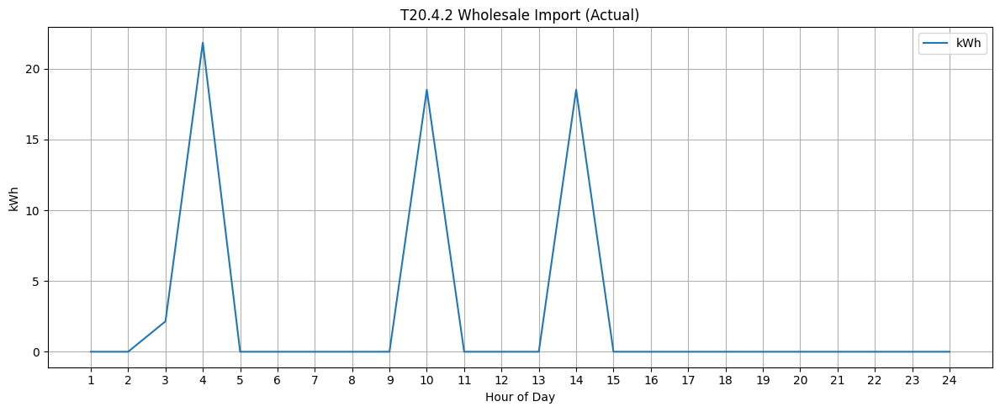

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

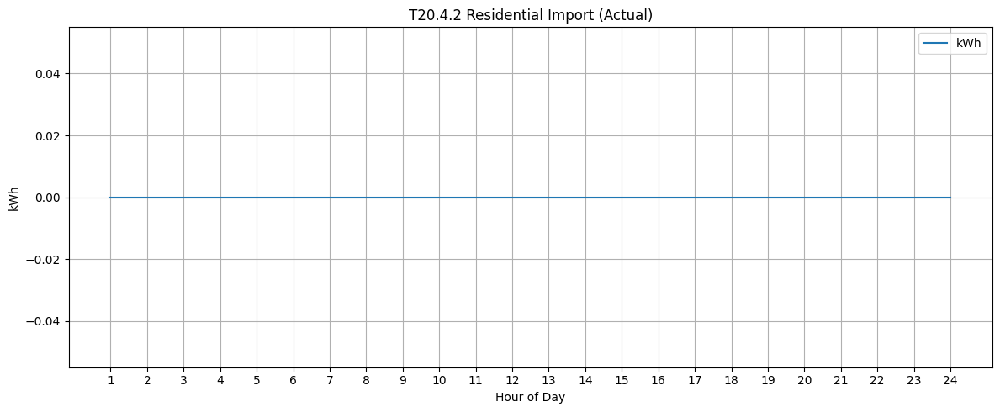

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

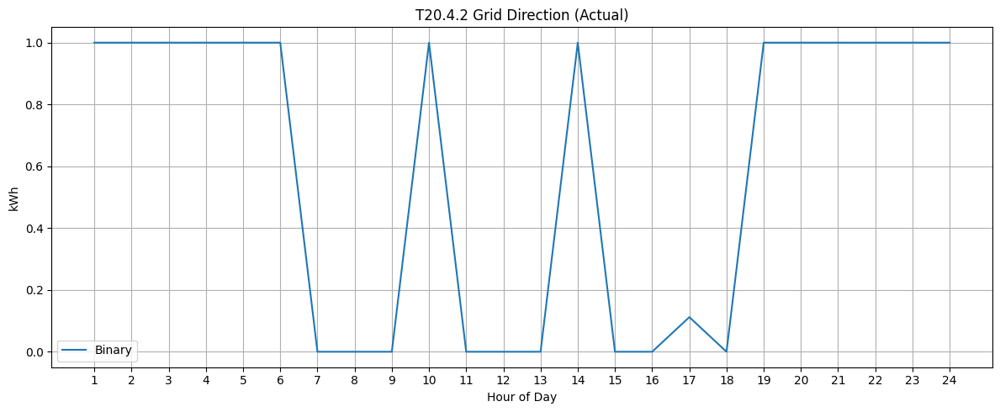

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

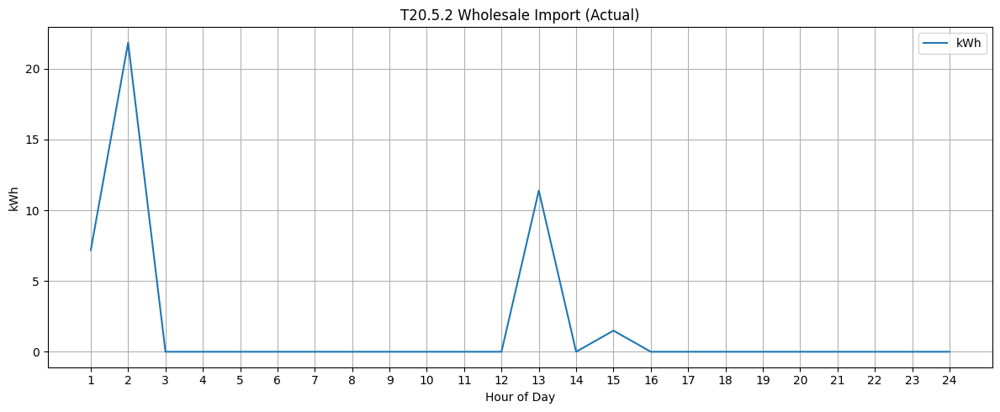

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

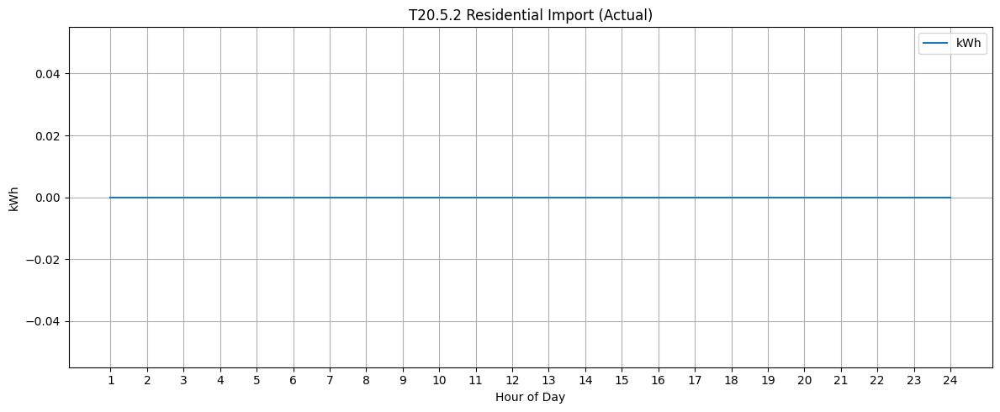

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

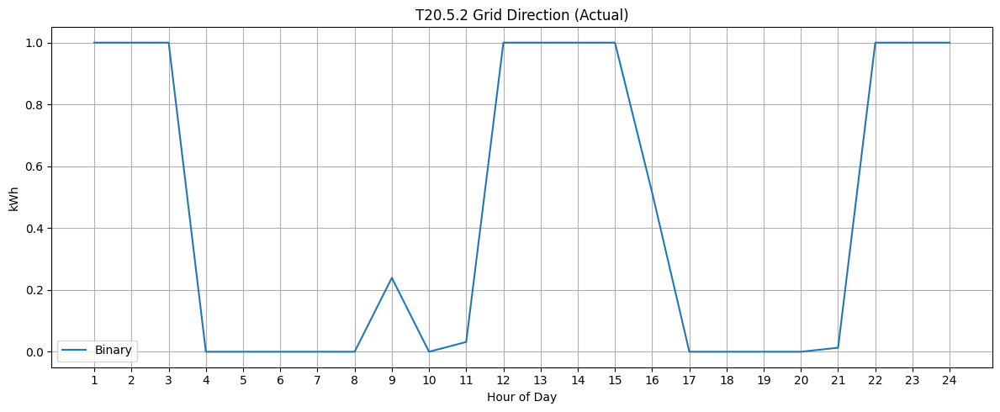

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

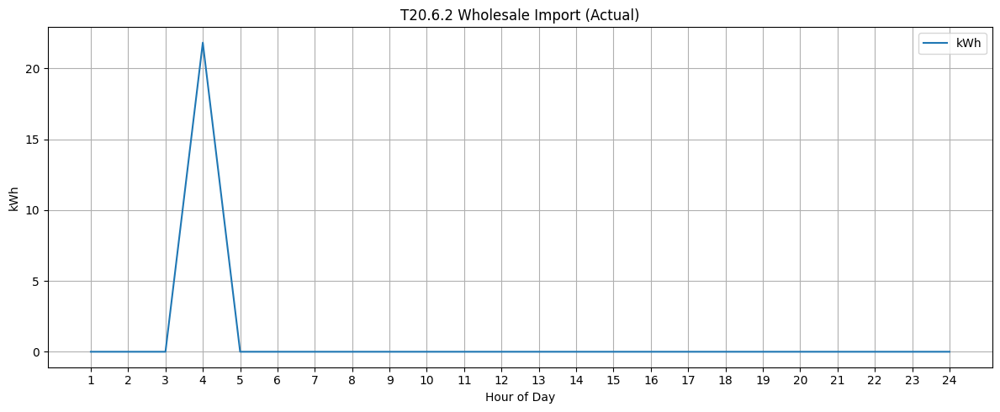

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

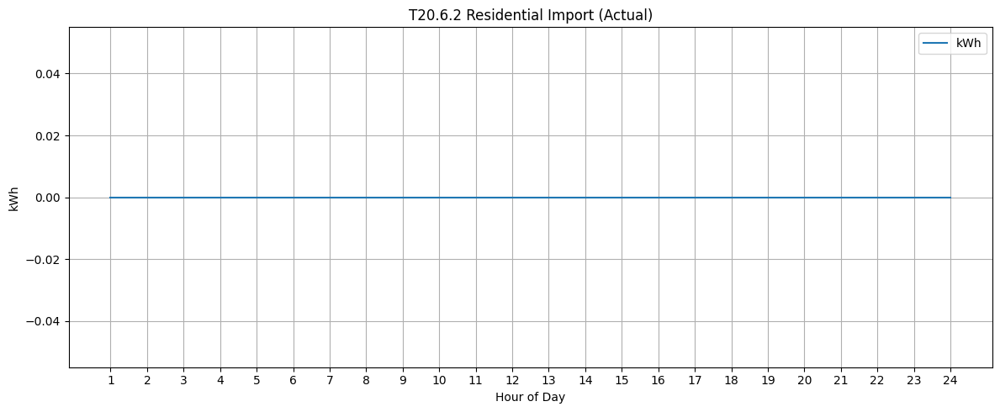

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

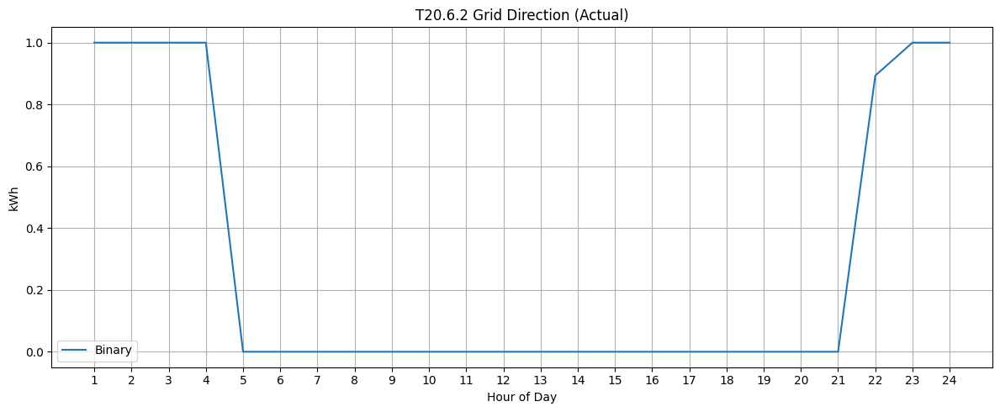

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

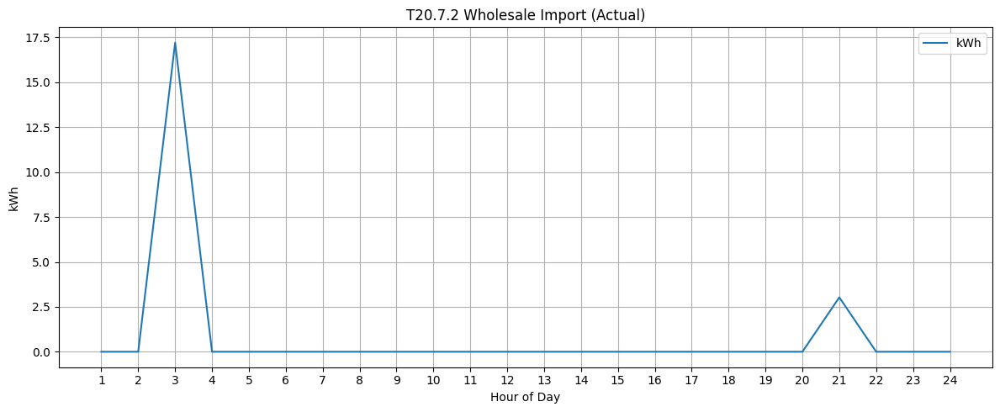

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

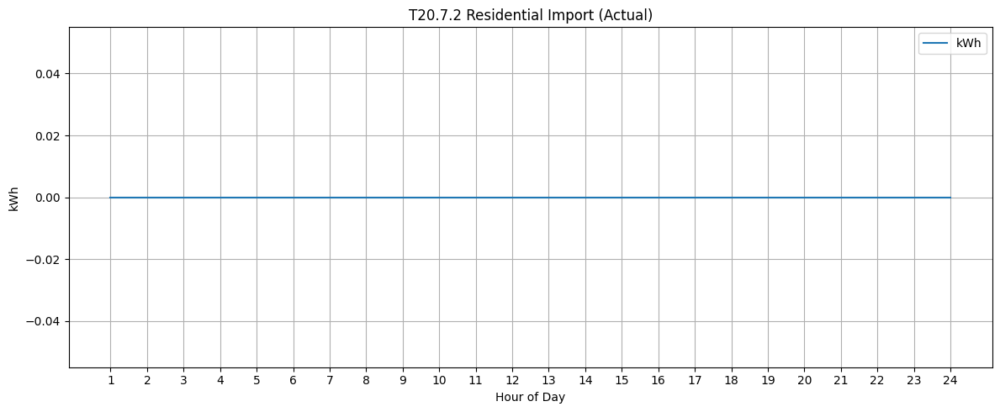

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

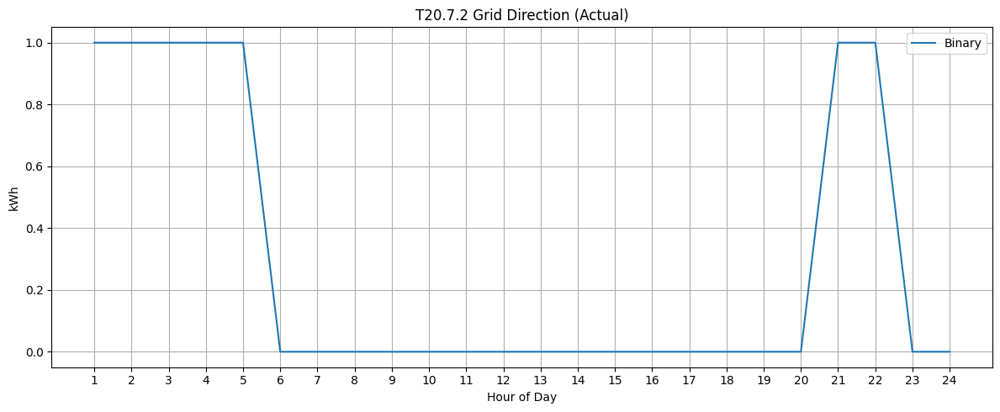

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

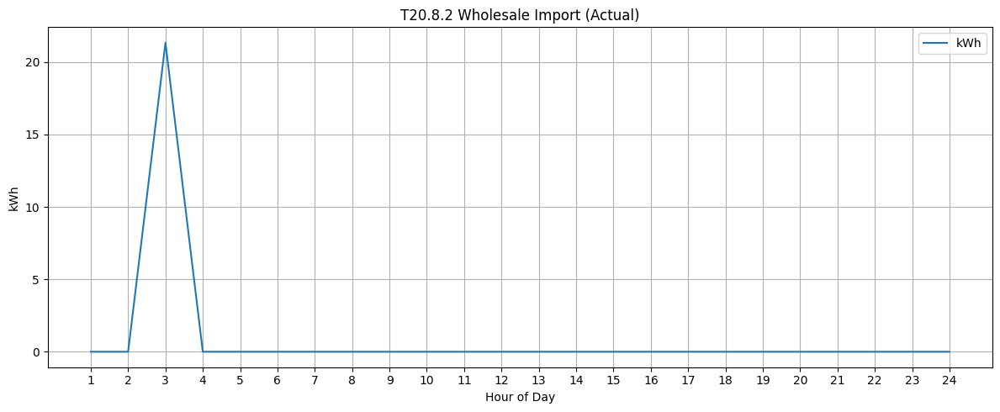

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

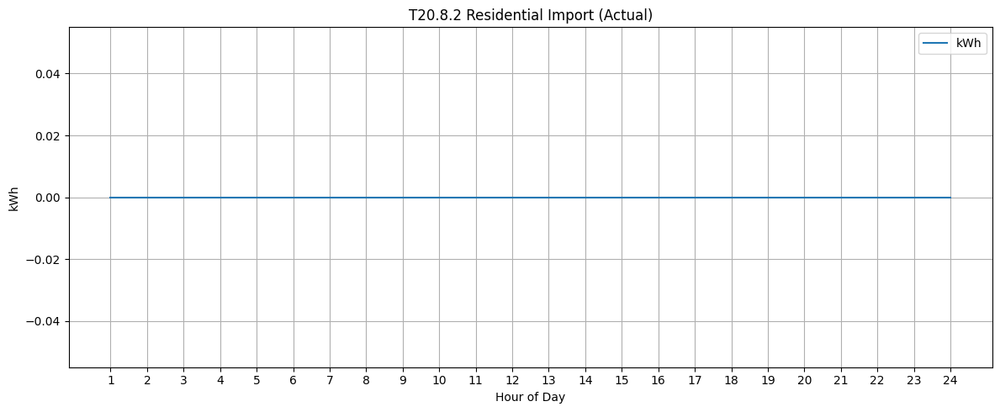

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

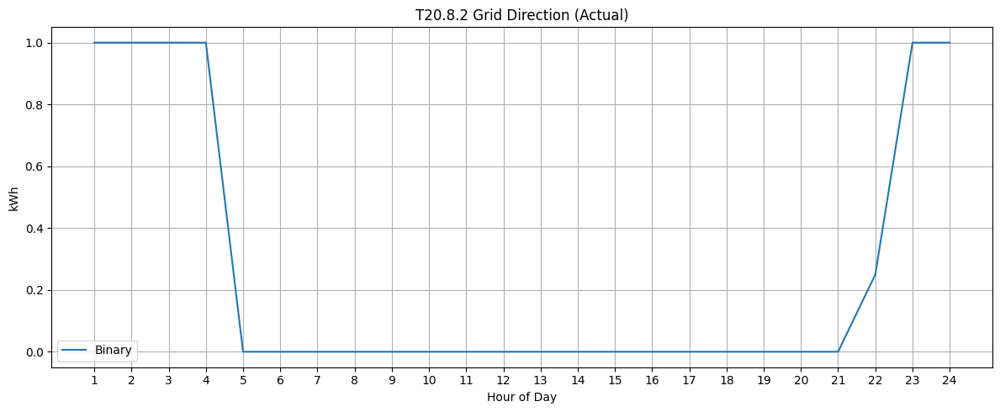

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

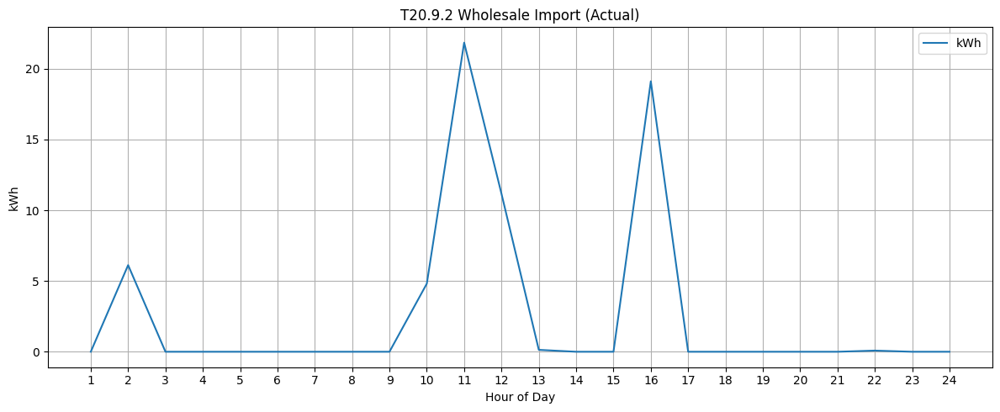

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

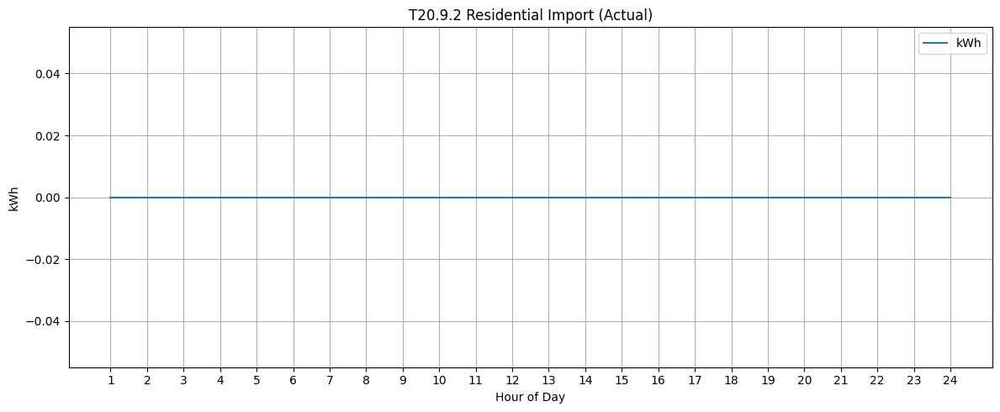

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

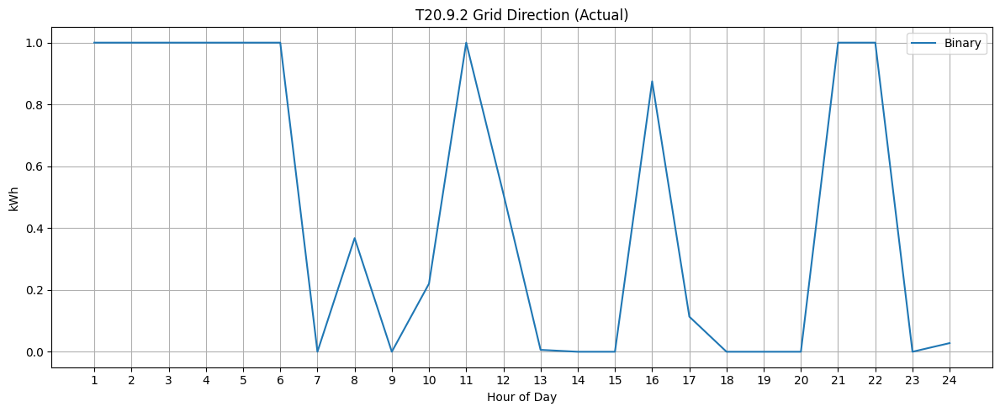

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

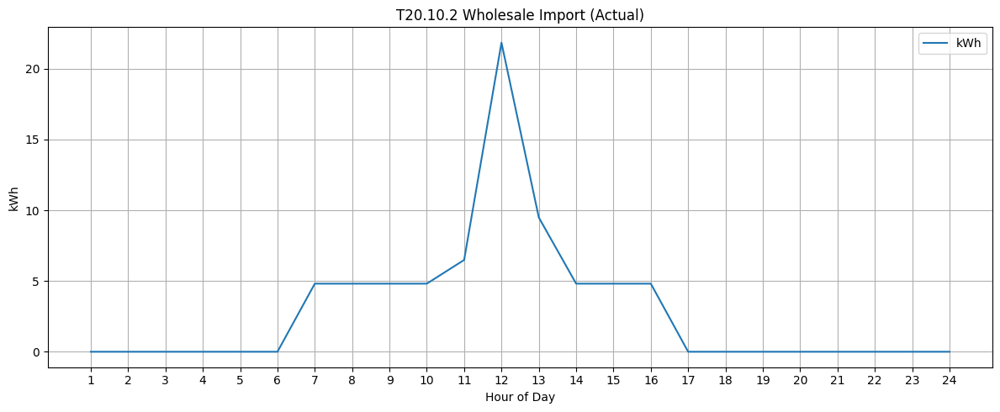

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

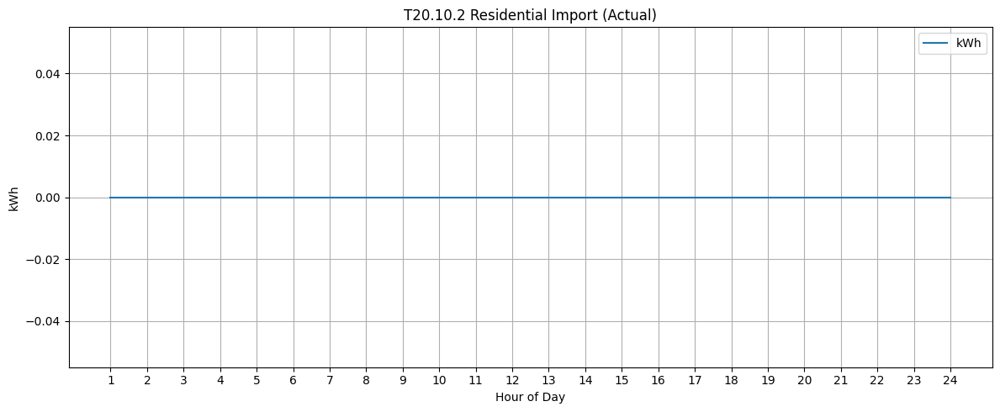

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

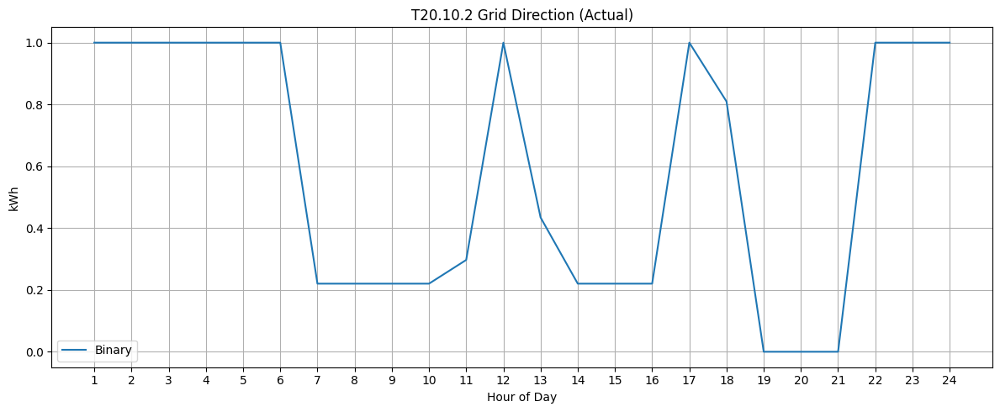

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

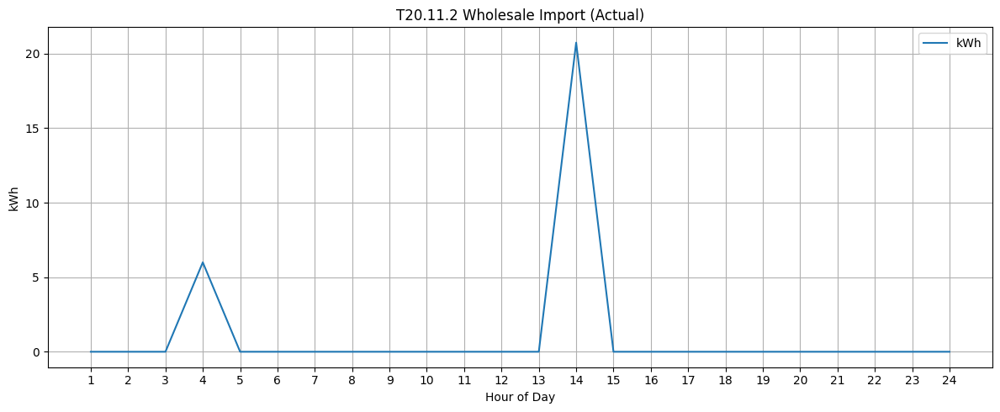

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

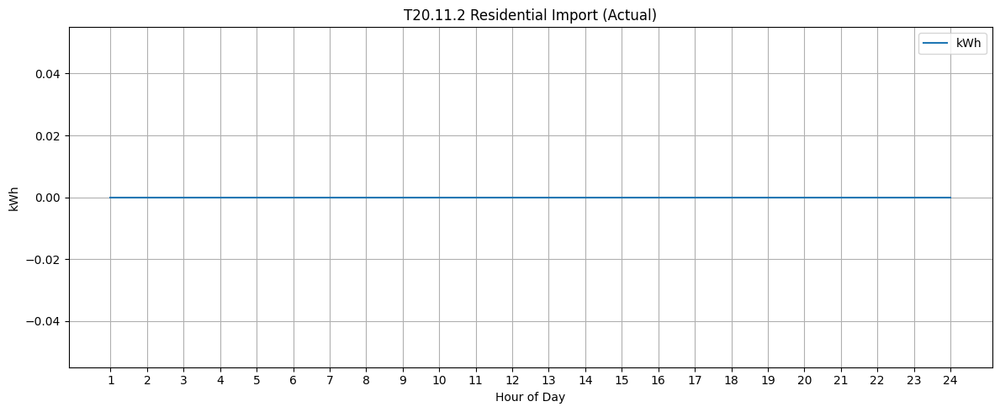

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

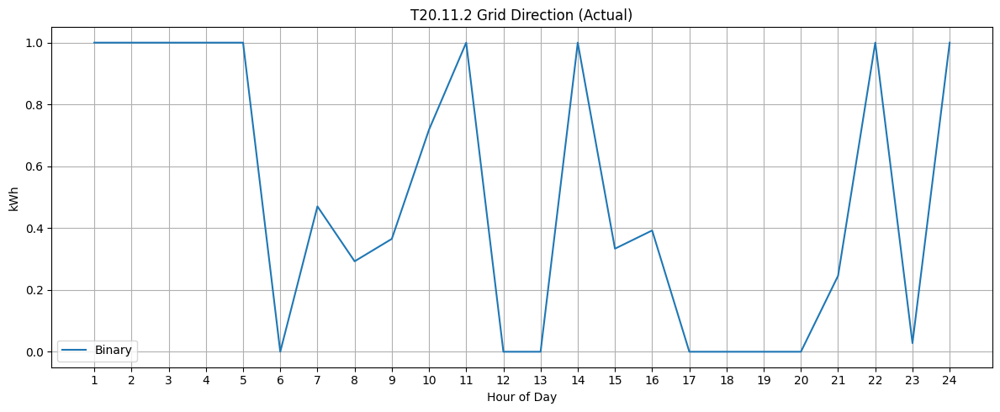

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

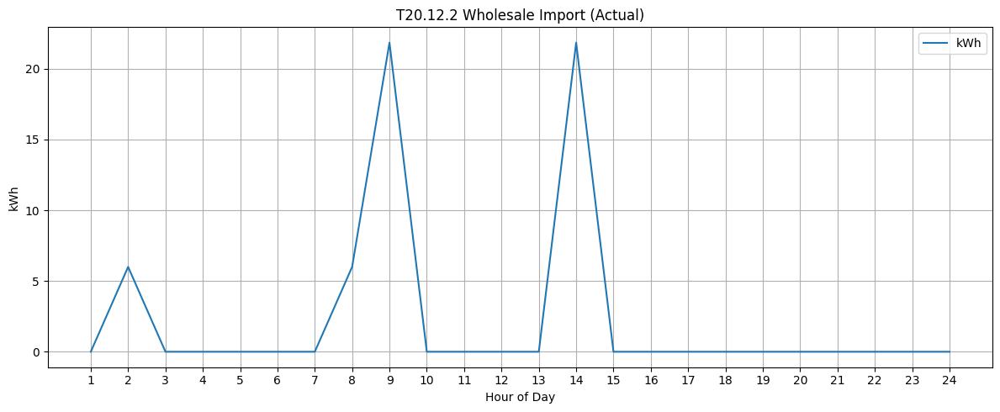

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

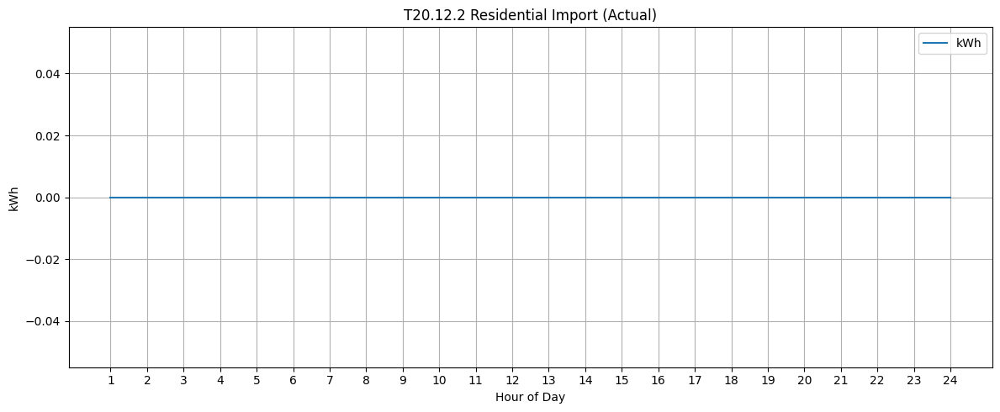

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

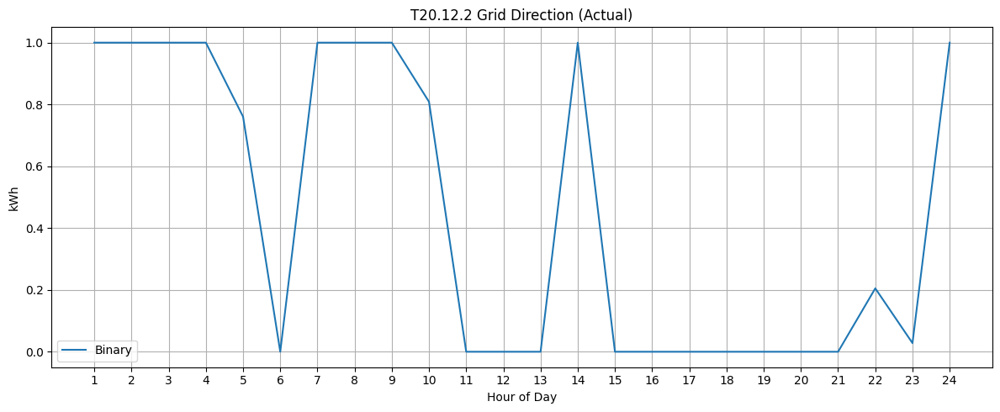

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

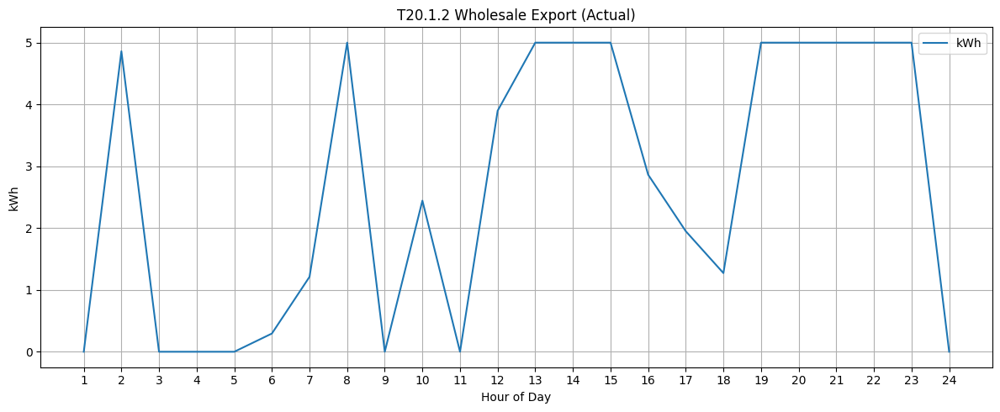

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

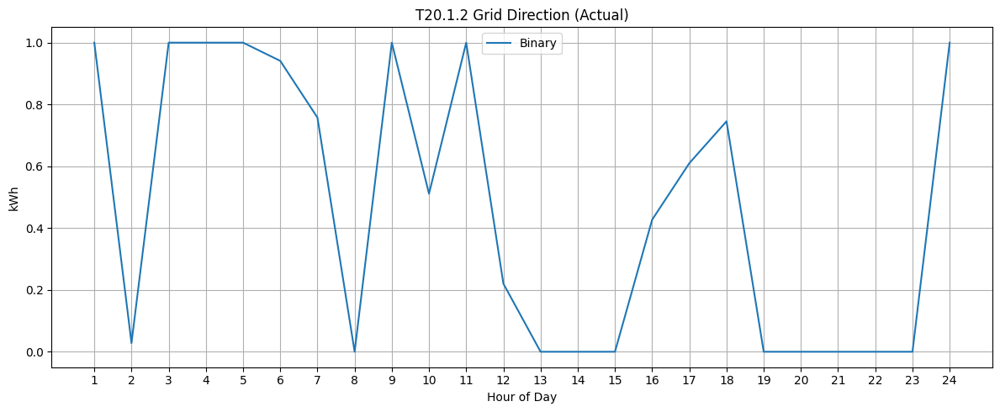

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

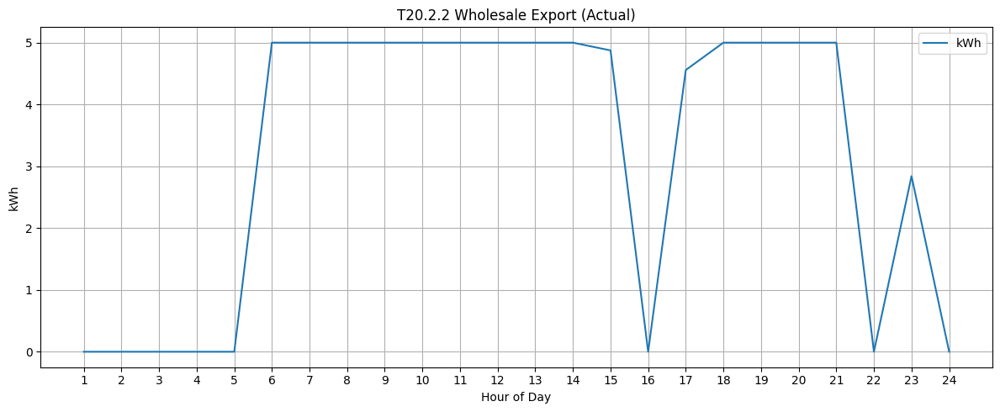

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

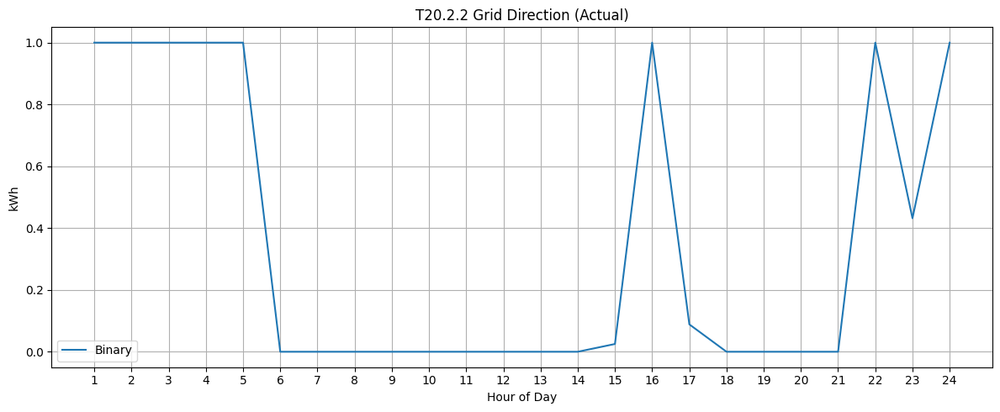

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

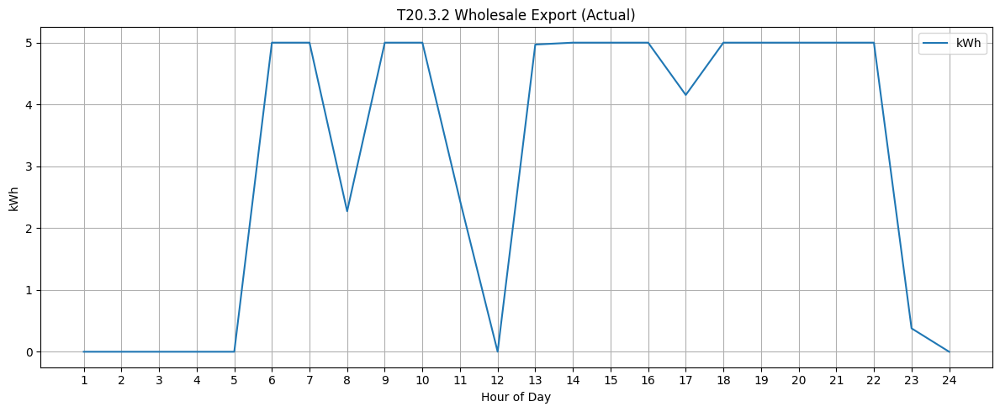

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

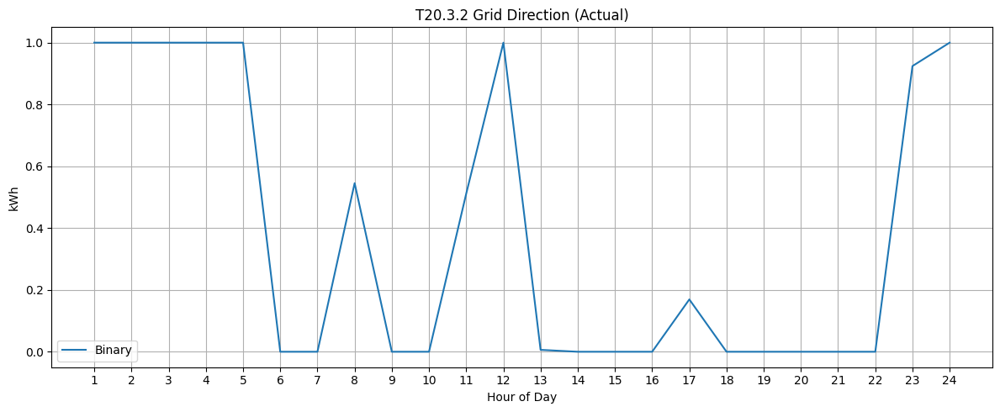

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

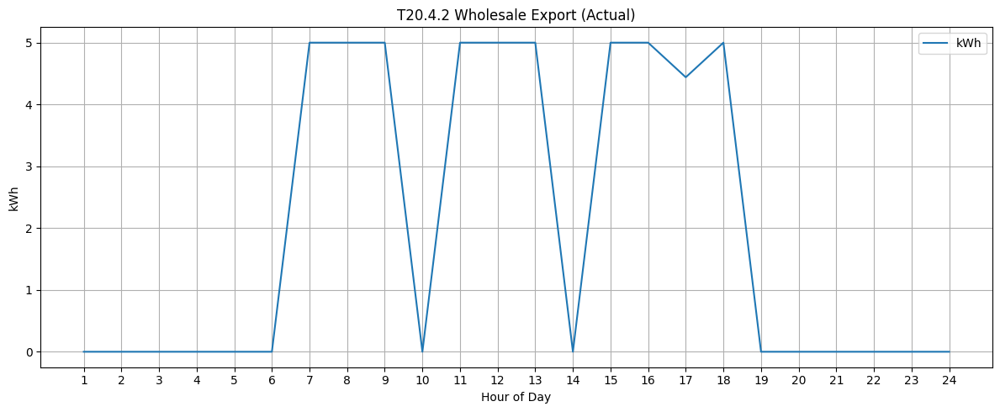

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

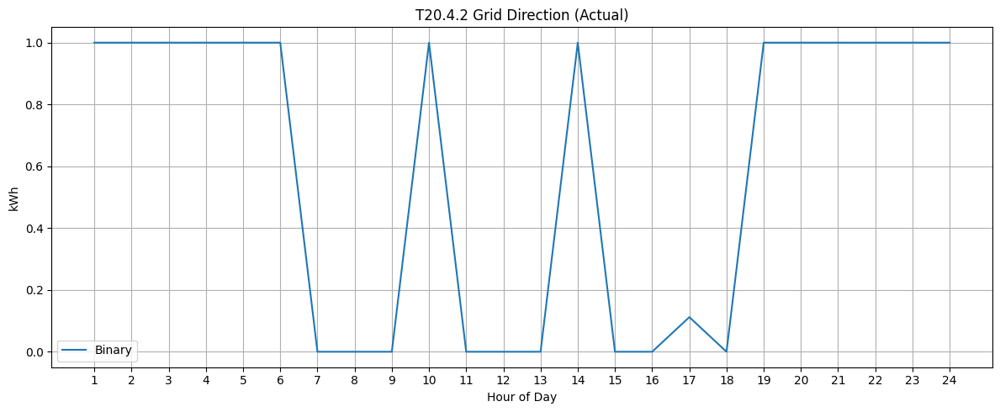

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

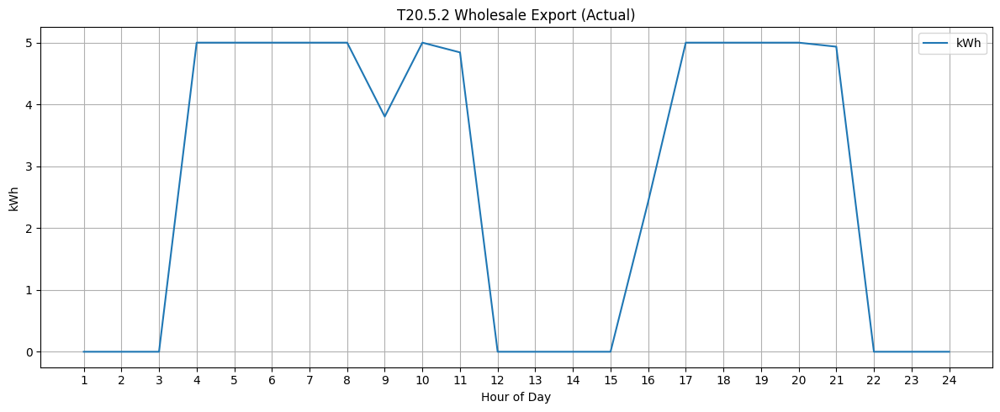

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

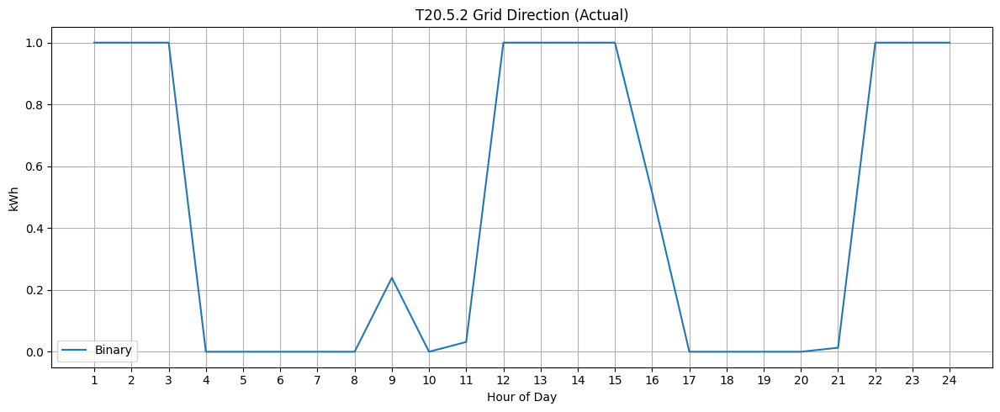

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

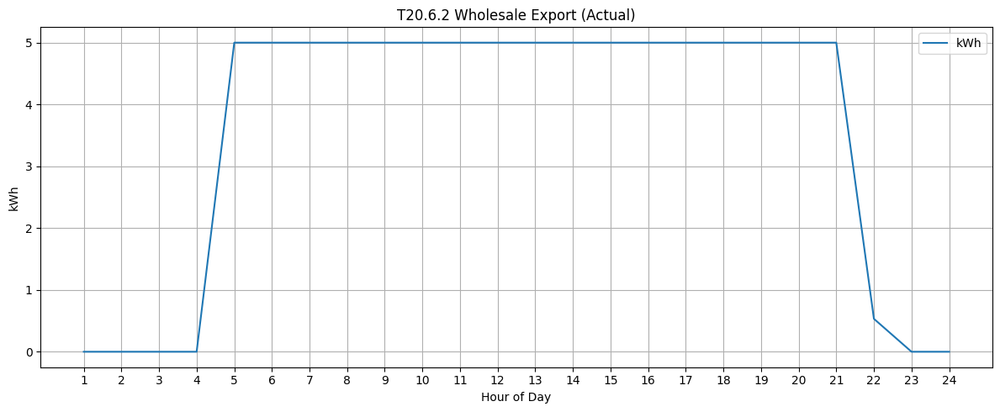

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

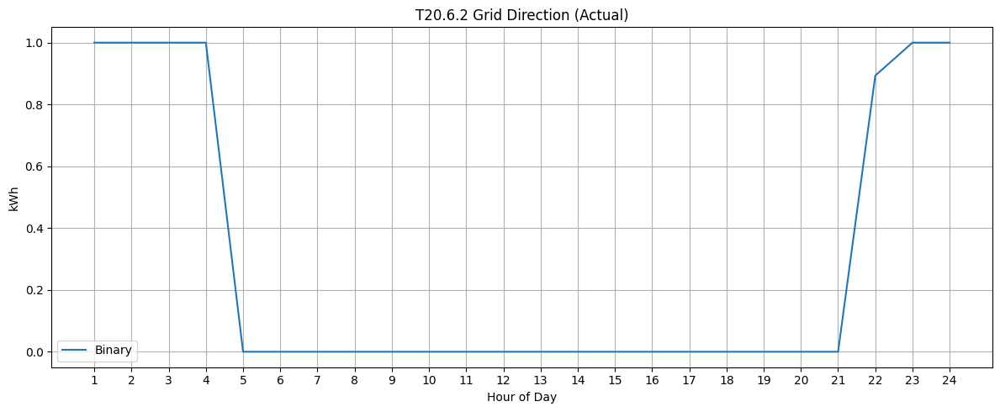

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

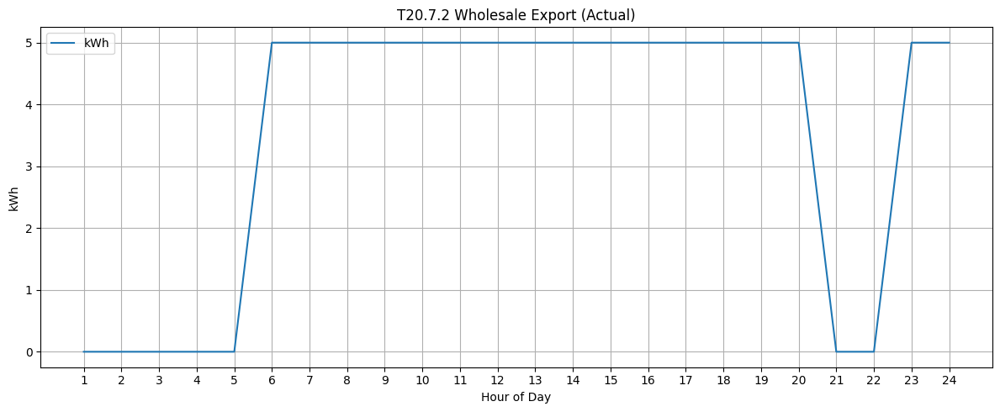

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

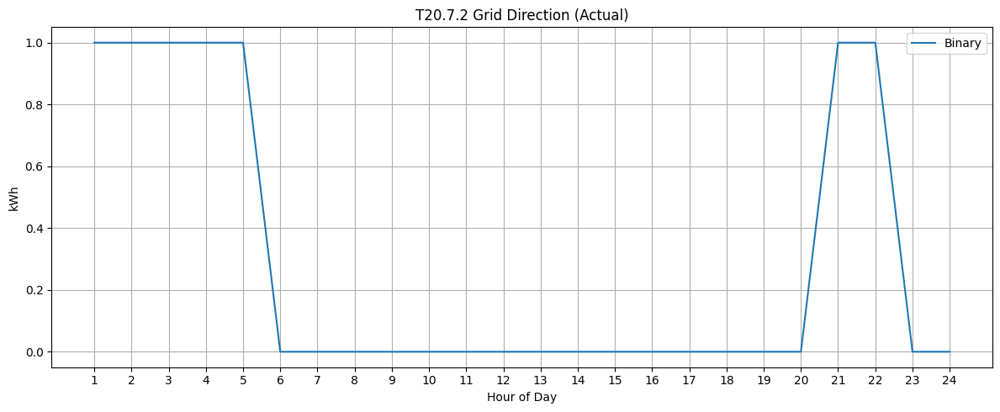

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

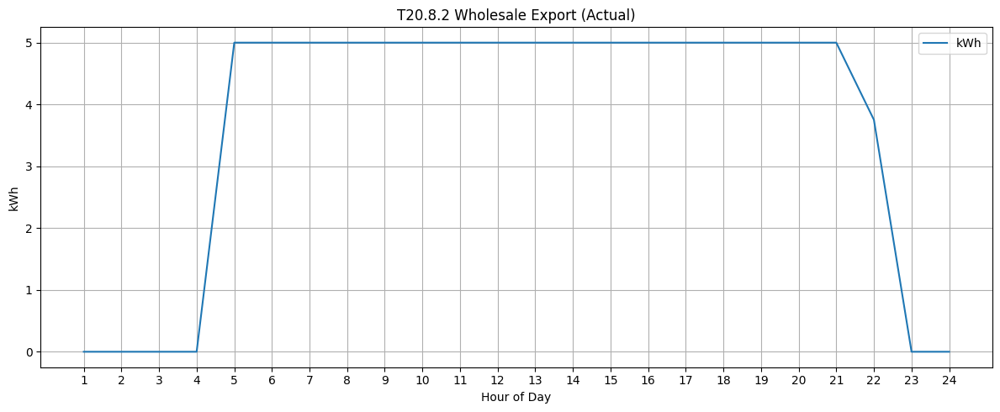

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

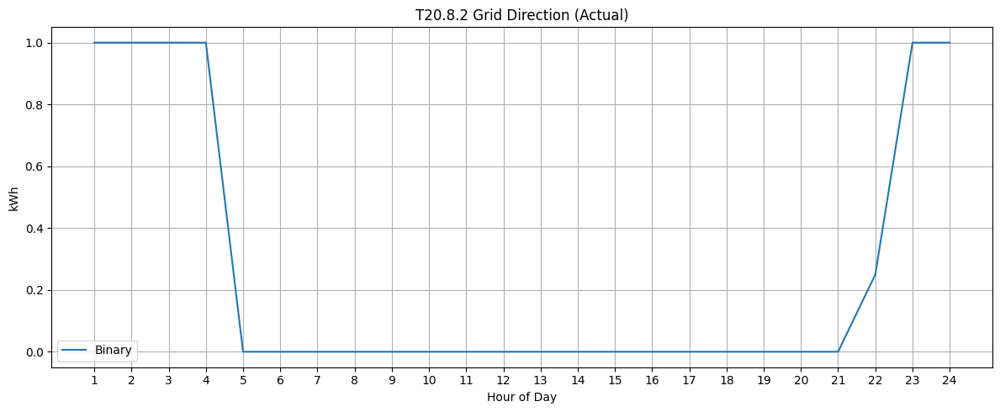

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

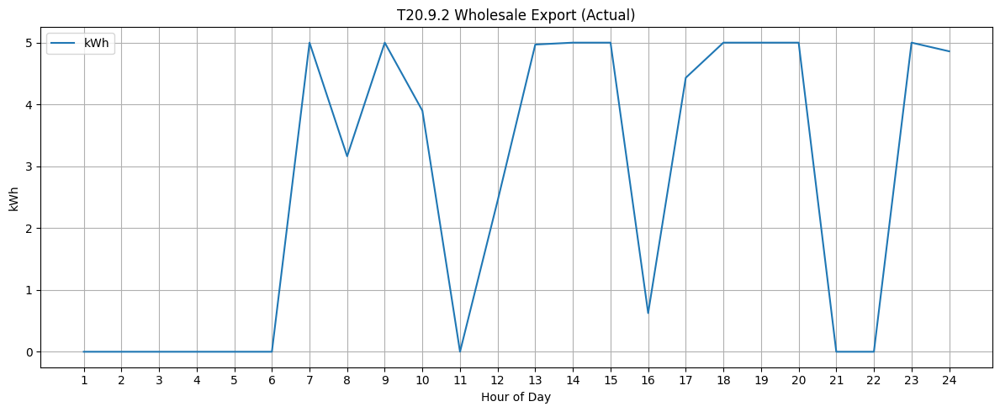

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

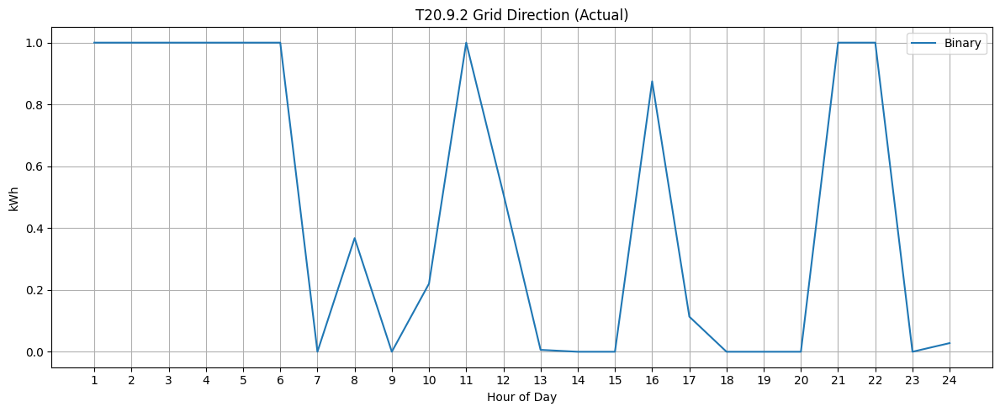

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

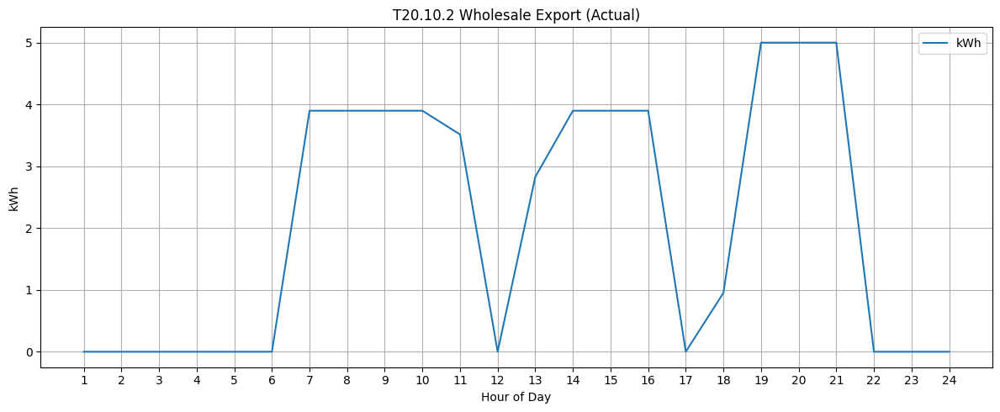

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

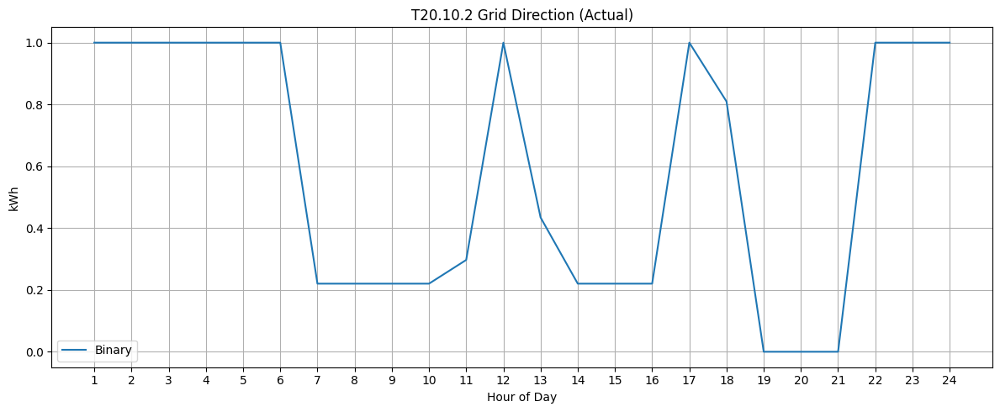

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

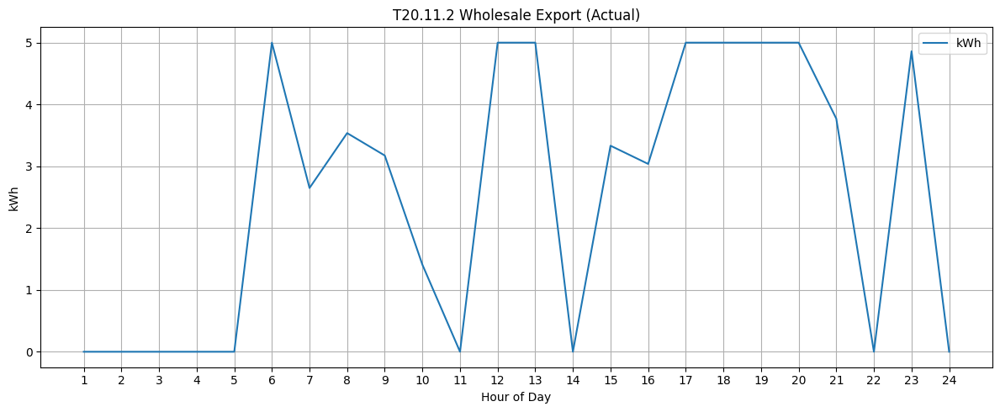

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

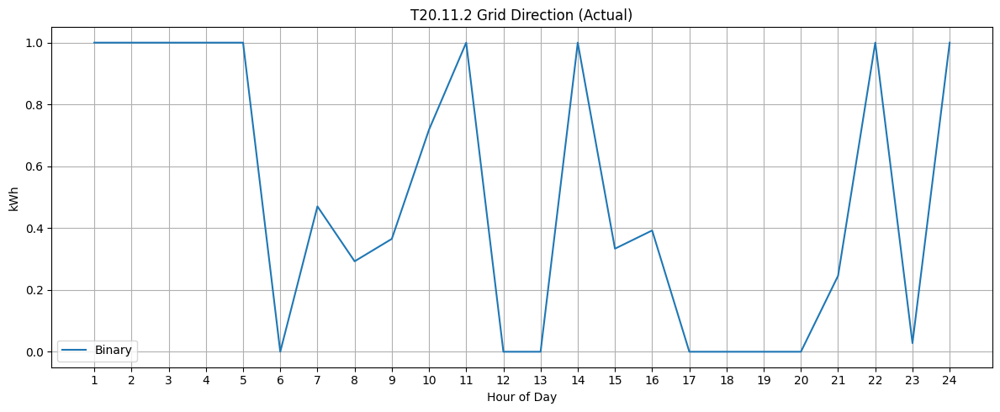

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

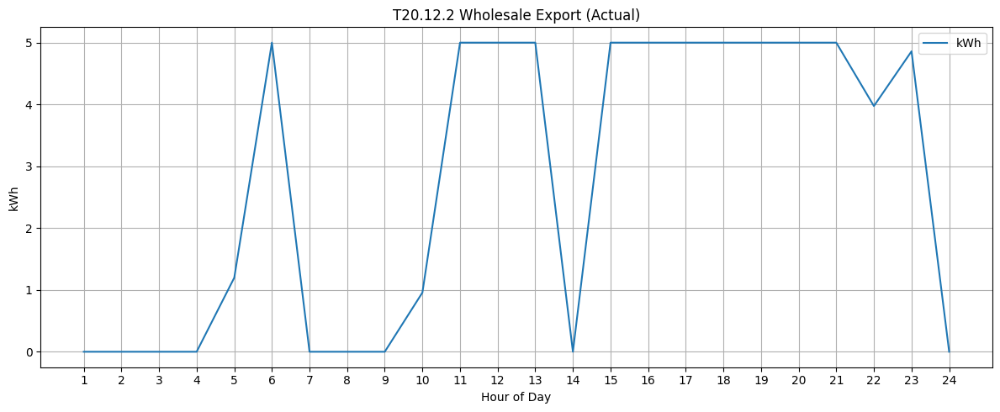

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

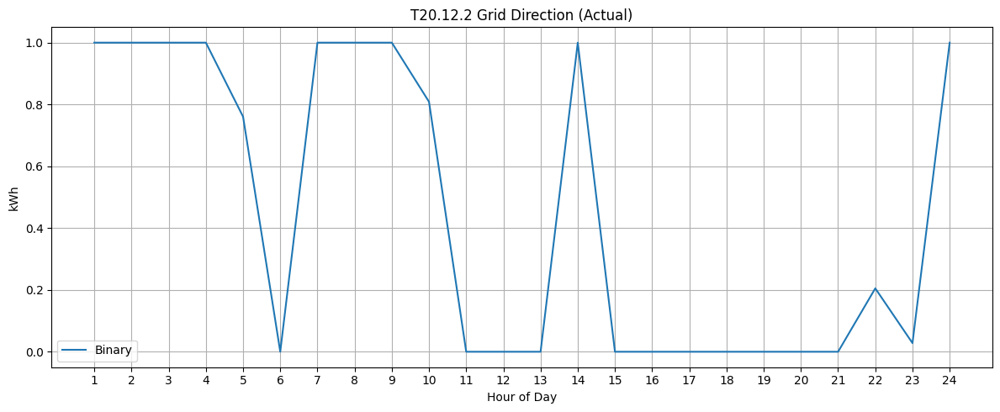

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [43]:
# T20.2
for i in range(1, 13):
  for j in range (1,3):
    if j == 1:
      months_to_plot = [i]
      mask = dates.month.isin(months_to_plot)
      filtered_dates = dates[mask]
    if j == 2:
      months_to_plot = [i]
      mask = dates.month.isin(months_to_plot) & (dates.day == 5)
      filtered_dates = dates[mask]

  grid_imp_w_vals = np.array([value(modelv1.grid_imp_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': grid_imp_w_vals}, f'{name}.{i}.{j} Wholesale Import', window=None)
  grid_imp_r_vals = np.array([value(modelv1.grid_imp_R[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': grid_imp_r_vals}, f'{name}.{i}.{j} Residential Import', window=None)
  grid_dir_vals = np.array([value(modelv1.grid_dir[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'Binary': grid_dir_vals}, f'{name}.{i}.{j} Grid Direction', window=None)

# T20.3
for i in range(1, 13):
  for j in range (1,3):
    if j == 1:
      months_to_plot = [i]
      mask = dates.month.isin(months_to_plot)
      filtered_dates = dates[mask]
    if j == 2:
      months_to_plot = [i]
      mask = dates.month.isin(months_to_plot) & (dates.day == 5)
      filtered_dates = dates[mask]

  grid_exp_w_vals = np.array([value(modelv1.grid_exp_W[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'kWh': grid_exp_w_vals}, f'{name}.{i}.{j} Wholesale Export', window=None)
  grid_dir_vals = np.array([value(modelv1.grid_dir[t]) for t in timesteps])[mask]
  plot_series(filtered_dates, {'Binary': grid_dir_vals}, f'{name}.{i}.{j} Grid Direction', window=None)

# SOCs

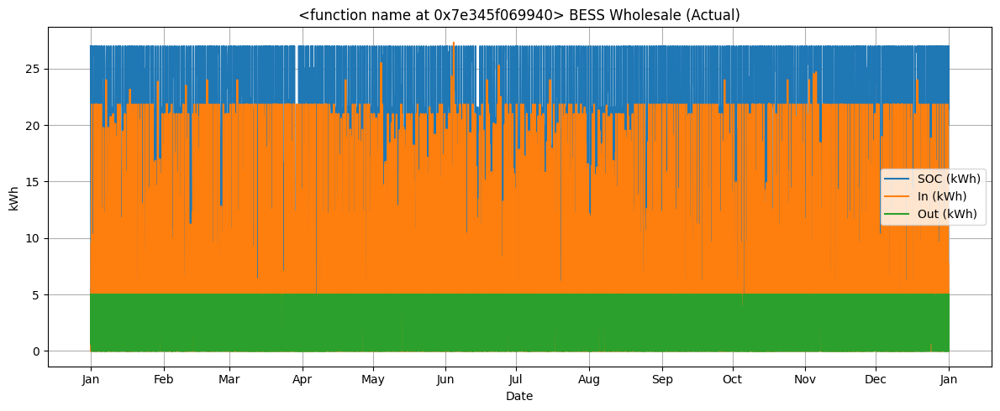

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

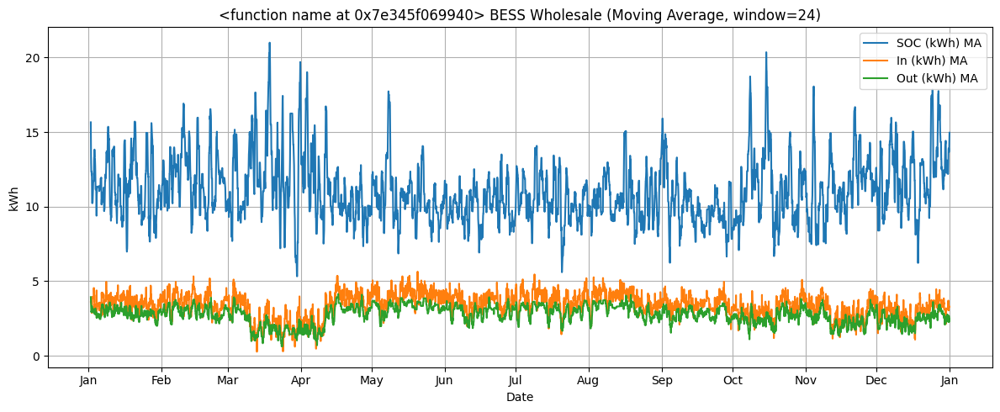

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

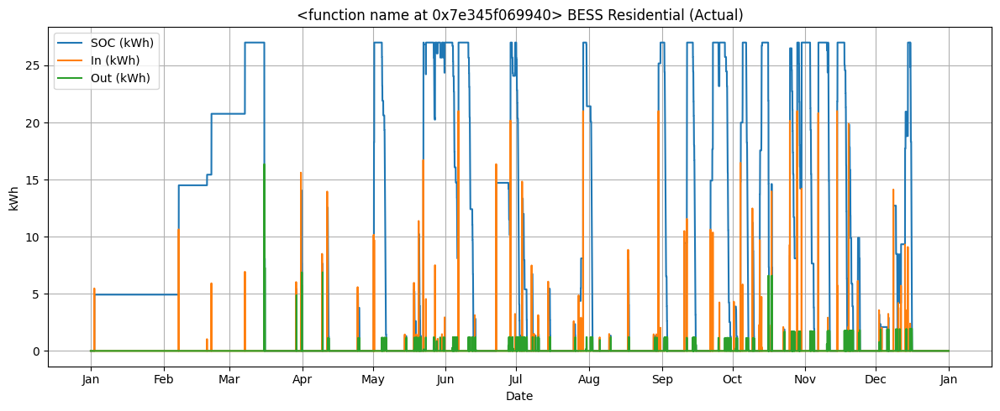

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

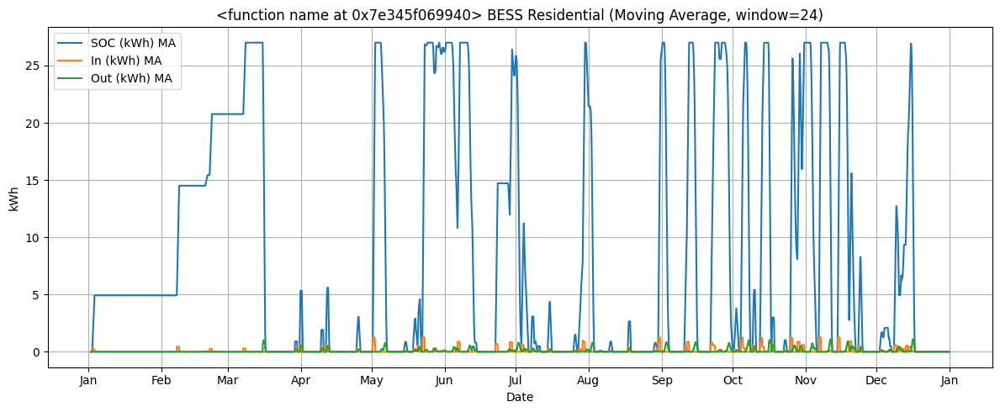

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

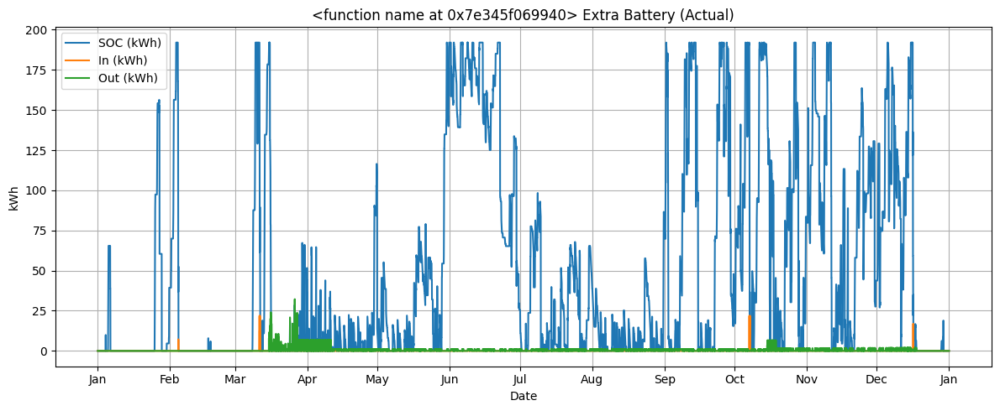

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

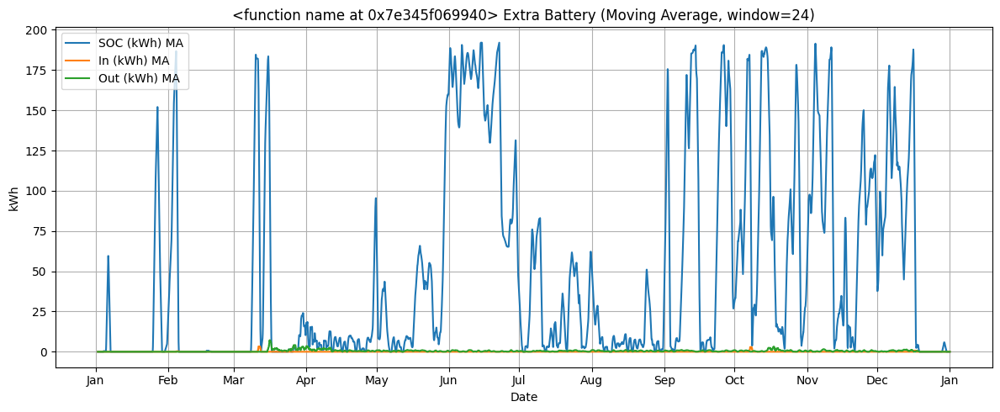

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

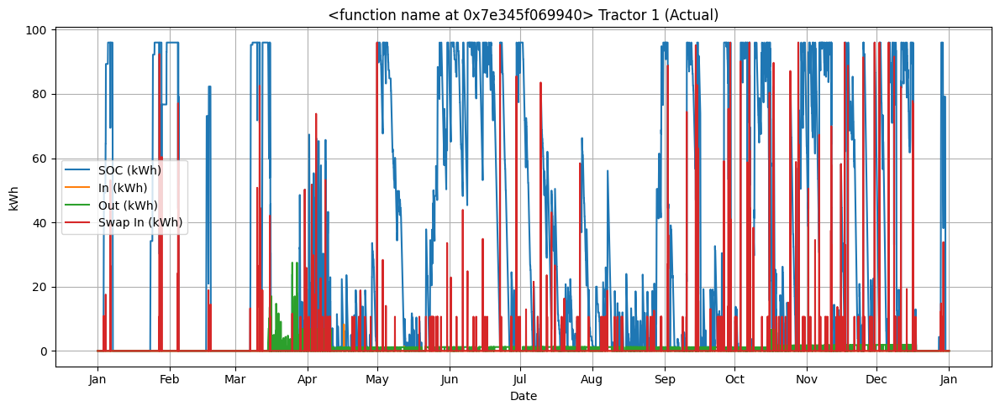

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

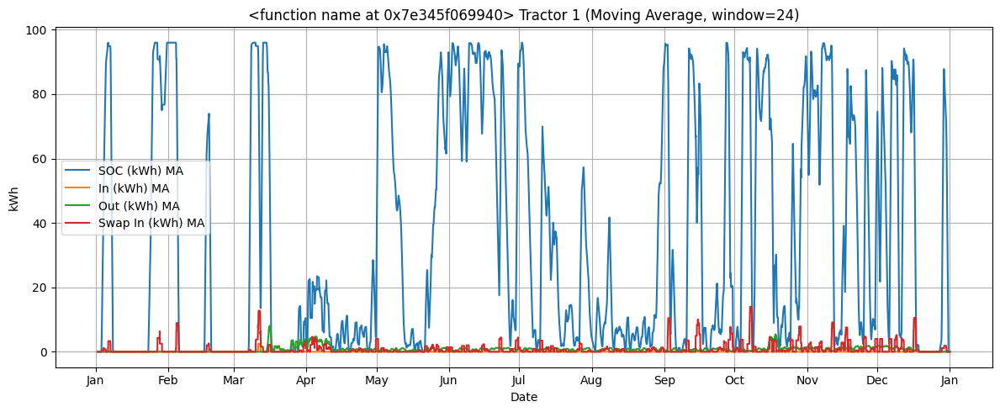

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Results exported to <function name at 0x7e345f069940>_SOC_results.xlsx
BESS Wholesale:
  Max SOC (kWh): 27.00
  Max In  (kWh): 27.32
  Max Out (kWh): 5.00
BESS Residential:
  Max SOC (kWh): 27.00
  Max In  (kWh): 21.00
  Max Out (kWh): 16.36
Extra Battery:
  Max SOC (kWh): 192.00
  Max In  (kWh): 21.85
  Max Out (kWh): 32.21
Tractor 1:
  Max SOC (kWh): 96.00
  Max In  (kWh): 21.30
  Max Out (kWh): 27.50
  Max Swap In (kWh): 96.00


In [ ]:
import numpy as np
import pandas as pd
from pyomo.environ import value

# Dates as index
dates = pd.to_datetime(filtered_dates)

# Create dict of DataFrames for Excel
results = {}

# --- BESS Wholesale ---
SOC_BESS_W_vals = np.array([value(modelv1.SOC_BESS_W[t]) for t in timesteps])[mask]
BESS_in_W_vals  = np.array([value(modelv1.BESS_in_W[t])  for t in timesteps])[mask]
BESS_out_W_vals = np.array([value(modelv1.BESS_out_W[t]) for t in timesteps])[mask]

plot_series(filtered_dates,
            {'SOC (kWh)': SOC_BESS_W_vals,
             'In (kWh)': BESS_in_W_vals,
             'Out (kWh)': BESS_out_W_vals},
            f'{name} BESS Wholesale', window=24)

results["BESS_Wholesale"] = pd.DataFrame({
    "Date": dates[mask],
    "SOC (kWh)": SOC_BESS_W_vals,
    "In (kWh)": BESS_in_W_vals,
    "Out (kWh)": BESS_out_W_vals
})

# --- BESS Residential ---
SOC_BESS_R_vals = np.array([value(modelv1.SOC_BESS_R[t]) for t in timesteps])[mask]
BESS_in_R_vals  = np.array([value(modelv1.BESS_in_R[t])  for t in timesteps])[mask]
BESS_out_R_vals = np.array([value(modelv1.BESS_out_R[t]) for t in timesteps])[mask]

plot_series(filtered_dates,
            {'SOC (kWh)': SOC_BESS_R_vals,
             'In (kWh)': BESS_in_R_vals,
             'Out (kWh)': BESS_out_R_vals},
            f'{name} BESS Residential', window=24)

results["BESS_Residential"] = pd.DataFrame({
    "Date": dates[mask],
    "SOC (kWh)": SOC_BESS_R_vals,
    "In (kWh)": BESS_in_R_vals,
    "Out (kWh)": BESS_out_R_vals
})

# --- Extra Battery ---
SOC_extra_vals = np.array([value(modelv1.SOC_extra_battery[t]) for t in timesteps])[mask]
extra_in_vals  = np.array([value(modelv1.extra_battery_in[t]) for t in timesteps])[mask]
extra_out_vals = np.array([value(modelv1.extra_battery_out[t]) for t in timesteps])[mask]

plot_series(filtered_dates,
            {'SOC (kWh)': SOC_extra_vals,
             'In (kWh)': extra_in_vals,
             'Out (kWh)': extra_out_vals},
            f'{name} Extra Battery', window=24)

results["Extra_Battery"] = pd.DataFrame({
    "Date": dates[mask],
    "SOC (kWh)": SOC_extra_vals,
    "In (kWh)": extra_in_vals,
    "Out (kWh)": extra_out_vals
})

# --- Tractors ---
for n in modelv1.N:
    SOC_tractor_vals  = np.array([value(modelv1.SOC_tractor[t, n]) for t in timesteps])[mask]
    tractor_in_vals   = np.array([value(modelv1.tractor_in[t, n])  for t in timesteps])[mask]
    tractor_out_vals  = np.array([value(modelv1.tractor_out[t, n]) for t in timesteps])[mask]
    swap_in_vals      = np.array([value(modelv1.swap_in[t, n])     for t in timesteps])[mask]

    plot_series(filtered_dates,
                {'SOC (kWh)': SOC_tractor_vals,
                 'In (kWh)': tractor_in_vals,
                 'Out (kWh)': tractor_out_vals,
                 'Swap In (kWh)': swap_in_vals},
                f'{name} Tractor {n}', window=24)

    results[f"Tractor_{n}"] = pd.DataFrame({
        "Date": dates[mask],
        "SOC (kWh)": SOC_tractor_vals,
        "In (kWh)": tractor_in_vals,
        "Out (kWh)": tractor_out_vals,
        "Swap In (kWh)": swap_in_vals
    })


# --- Write everything to Excel ---
output_file = f"{name}_SOC_results.xlsx"
with pd.ExcelWriter(output_file, engine="openpyxl") as writer:
    for sheet, df in results.items():
        df.to_excel(writer, sheet_name=sheet, index=False)

# Download in Colab
from google.colab import files
files.download(output_file)

print(f"Results exported to {output_file}")

# --- BESS Wholesale ---
print("BESS Wholesale:")
print(f"  Max SOC (kWh): {SOC_BESS_W_vals.max():.2f}")
print(f"  Max In  (kWh): {BESS_in_W_vals.max():.2f}")
print(f"  Max Out (kWh): {BESS_out_W_vals.max():.2f}")

# --- BESS Residential ---
print("BESS Residential:")
print(f"  Max SOC (kWh): {SOC_BESS_R_vals.max():.2f}")
print(f"  Max In  (kWh): {BESS_in_R_vals.max():.2f}")
print(f"  Max Out (kWh): {BESS_out_R_vals.max():.2f}")

# --- Extra Battery ---
print("Extra Battery:")
print(f"  Max SOC (kWh): {SOC_extra_vals.max():.2f}")
print(f"  Max In  (kWh): {extra_in_vals.max():.2f}")
print(f"  Max Out (kWh): {extra_out_vals.max():.2f}")

# --- Tractors ---
for n in modelv1.N:
    SOC_tractor_vals = np.array([value(modelv1.SOC_tractor[t, n]) for t in timesteps])[mask]
    tractor_in_vals  = np.array([value(modelv1.tractor_in[t, n])  for t in timesteps])[mask]
    tractor_out_vals = np.array([value(modelv1.tractor_out[t, n]) for t in timesteps])[mask]
    swap_in_vals     = np.array([value(modelv1.swap_in[t, n])     for t in timesteps])[mask]

    print(f"Tractor {n}:")
    print(f"  Max SOC (kWh): {SOC_tractor_vals.max():.2f}")
    print(f"  Max In  (kWh): {tractor_in_vals.max():.2f}")
    print(f"  Max Out (kWh): {tractor_out_vals.max():.2f}")
    print(f"  Max Swap In (kWh): {swap_in_vals.max():.2f}")

